In [81]:
import torch 
import torch.nn as nn
import torchvision.datasets as dsets
import torchvision.transforms as transforms
import numpy as np
import math
from torch.autograd import Variable
from sklearn.model_selection import train_test_split

# Hyper Parameters
num_epochs = 3
batch_size = 100
batch_size_test = 1
learning_rate1 = 0.001
learning_rate2 = 0.005
EPSILON = 3.0

# MNIST Dataset
transform = transforms.Compose([transforms.Resize((32, 32)),
                                transforms.ToTensor(),
                                transforms.Normalize(mean = [0.5],std = [0.5])
                               ])

# Download training dataset
train_dataset = dsets.MNIST(root = './data/',
                            train = True, 
                            transform = transform,
                            download = True)

# Partition training dataset
# train_set1, train_set2 = train_test_split(train_dataset, test_size = 0.2, random_state = 42)

train_set3, train_set4 = train_test_split(train_dataset, test_size = 0.95, random_state = 42)

test_dataset = dsets.MNIST(root = './data/',
                           train = False, 
                           transform = transform)

# Data Loader (Input Pipeline)
# The first training dataset for target model
train_loader1 = torch.utils.data.DataLoader(dataset = train_dataset,
                                           batch_size = batch_size, 
                                           shuffle = True)

# The second training dataset for inversion model
train_loader2 = torch.utils.data.DataLoader(dataset = train_dataset,
                                           batch_size = batch_size, 
                                           shuffle = True)

# The original test dataset
test_loader = torch.utils.data.DataLoader(dataset = train_set3,
                                          shuffle = False)

classes = ["zero", "one", "two", "three", "four", "five", "six", "seven", "eight", "nine"]

In [82]:
class CNNencoder(nn.Module):
    def __init__(self):
        super(CNNencoder, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Conv2d(1, 128, kernel_size = (3, 3), stride = (1, 1), padding = (1, 1)),
            nn.BatchNorm2d(128, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0, dilation = 1, ceil_mode = False),
            nn.ReLU(inplace = True)
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size = (3, 3), stride = (1, 1), padding = (1, 1)),
            nn.BatchNorm2d(256, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0, dilation = 1, ceil_mode = False),
            nn.ReLU(inplace = True)
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size = (3, 3), stride = (1, 1), padding = (1, 1)),             
            nn.BatchNorm2d(512, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0, dilation = 1, ceil_mode = False),
            nn.ReLU(inplace = True)
        )
        self.fc = nn.Sequential(
            nn.Linear(in_features = 8192, out_features = 50, bias = True),
            nn.Dropout(p = 0.5),
            nn.Linear(in_features = 50, out_features = 10, bias = True)
        )
        
    def forward(self, x):
        out = self.layer1(x)
        out = self.layer2(out)
        out = self.layer3(out)
        out = out.view(out.size(0), -1)
        out = self.fc(out)
        return out
    
class CNNdecoder(nn.Module):
    def __init__(self):
        super(CNNdecoder, self).__init__()
        self.layer1 = nn.Sequential(
            nn.ConvTranspose2d(10, 512, kernel_size = (4, 4), stride = (1, 1)),
            nn.BatchNorm2d(512, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.Tanh()
        )
        self.layer2 = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size = (4, 4), stride = (2, 2), padding = (1, 1)),
            nn.BatchNorm2d(256, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.Tanh()
        )
        self.layer3 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size = (4, 4), stride = (2, 2), padding = (1, 1)),
            nn.BatchNorm2d(128, eps = 1e-05, momentum = 0.1, affine = True, track_running_stats = True),
            nn.Tanh()
        )
        self.layer4 = nn.Sequential(
            nn.ConvTranspose2d(128, 1, kernel_size = (4, 4), stride = (2, 2), padding = (1, 1)),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        out = self.layer1(x)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        return out

# Define a model cnn belongs to CNN class
cnnEncoder = CNNencoder()
cnnDecoder = CNNdecoder()


# Loss and Optimizer
criterion1 = nn.CrossEntropyLoss()
criterion2 = nn.L1Loss()


optimizer1 = torch.optim.Adam(cnnEncoder.parameters(), lr = learning_rate1)
optimizer2 = torch.optim.SGD(cnnDecoder.parameters(), lr = learning_rate2, momentum = 0.9)

In [83]:
def truncation(outputs, num):
    for i in range(0, num):
        outputs[outputs.index(min(outputs))] = 100
    for i in range(0, len(outputs)):
        if (outputs[i] == 100):
            outputs[i] = 0
    return outputs

def defense(outputs, eps):
    sumExp = 0.0
    for i in range(0, len(outputs)):
        sumExp = sumExp + math.exp(eps / 2 * outputs[i])
    for i in range(0, len(outputs)):
        outputs[i] = math.exp(eps / 2 * outputs[i]) / sumExp   
    return outputs

In [84]:
# Train the Model
for epoch in range(num_epochs):
    for i, (images, labels) in enumerate(train_loader1):
      
        images = Variable(images)
        labels = Variable(labels)
        
        # Forward + Backward + Optimize
        optimizer1.zero_grad()
        outputs = cnnEncoder(images)
        
        loss = criterion1(outputs, labels)
        loss.backward()
        optimizer1.step()
        
        if (i + 1) % 100 == 0:
            print ('Epoch [%d/%d], Iter [%d/%d] Loss: %.4f' 
                   %(epoch + 1, num_epochs, i + 1, len(train_dataset)//batch_size, loss.data))

Epoch [1/3], Iter [100/600] Loss: 0.2283
Epoch [1/3], Iter [200/600] Loss: 0.0950
Epoch [1/3], Iter [300/600] Loss: 0.1734
Epoch [1/3], Iter [400/600] Loss: 0.1345
Epoch [1/3], Iter [500/600] Loss: 0.0229
Epoch [1/3], Iter [600/600] Loss: 0.1289
Epoch [2/3], Iter [100/600] Loss: 0.0271
Epoch [2/3], Iter [200/600] Loss: 0.1383
Epoch [2/3], Iter [300/600] Loss: 0.0149
Epoch [2/3], Iter [400/600] Loss: 0.0724
Epoch [2/3], Iter [500/600] Loss: 0.1067
Epoch [2/3], Iter [600/600] Loss: 0.0876
Epoch [3/3], Iter [100/600] Loss: 0.0790
Epoch [3/3], Iter [200/600] Loss: 0.0035
Epoch [3/3], Iter [300/600] Loss: 0.0377
Epoch [3/3], Iter [400/600] Loss: 0.1077
Epoch [3/3], Iter [500/600] Loss: 0.0735
Epoch [3/3], Iter [600/600] Loss: 0.0575


In [1]:
#有BN层或drop层时需加上cnn.eval(),因为计算方式不一样，可以参考caffe源码。
# Test the Model
cnnEncoder.eval()  # Change model to 'eval' mode (BN uses moving mean/var).
correct = 0
total = 0
accuracy0 = 0
accuracy1 = 0
accuracy2 = 0
accuracy3 = 0
accuracy4 = 0
accuracy5 = 0
accuracy6 = 0
accuracy7 = 0
accuracy8 = 0
accuracy9 = 0
total0 = 0
total1 = 0
total2 = 0
total3 = 0
total4 = 0
total5 = 0
total6 = 0
total7 = 0
total8 = 0
total9 = 0

for images, labels in test_loader:
    images = Variable(images)
    outputs = cnnEncoder(images)
    softMax = nn.Softmax(dim = 1)        
    outputs = softMax(outputs)
    
    _, predicted = torch.max(outputs.data, 1)
    total += labels.size(0)

    if (predicted == labels):
        correct += 1
        
    if labels == 0:
        total0 += 1
        if (predicted == labels):
            accuracy0 += 1
    elif labels == 1:
        total1 += 1
        if (predicted == labels):
            accuracy1 += 1
    elif labels == 2:
        total2 += 1
        if (predicted == labels):
            accuracy2 += 1
    elif labels == 3:
        total3 += 1
        if (predicted == labels):
            accuracy3 += 1
    elif labels == 4:
        total4 += 1
        if (predicted == labels):
            accuracy4 += 1
    elif labels == 5:
        total5 += 1
        if (predicted == labels):
            accuracy5 += 1
    elif labels == 6:
        total6 += 1
        if (predicted == labels):
            accuracy6 += 1
    elif labels == 7:
        total7 += 1
        if (predicted == labels):
            accuracy7 += 1
    elif labels == 8:
        total8 += 1
        if (predicted == labels):
            accuracy8 += 1
    elif labels == 9:
        total9 += 1
        if (predicted == labels):
            accuracy9 += 1

print('Test Accuracy of the model on all images: %d %%' % (100 * correct // total))
print('Test Accuracy of the model on "0" images: %d %%' % (100 * accuracy0 // total0))
print('Test Accuracy of the model on "1" images: %d %%' % (100 * accuracy1 // total1))
print('Test Accuracy of the model on "2" images: %d %%' % (100 * accuracy2 // total2))
print('Test Accuracy of the model on "3" images: %d %%' % (100 * accuracy3 // total3))
print('Test Accuracy of the model on "4" images: %d %%' % (100 * accuracy4 // total4))
print('Test Accuracy of the model on "5" images: %d %%' % (100 * accuracy5 // total5))
print('Test Accuracy of the model on "6" images: %d %%' % (100 * accuracy6 // total6))
print('Test Accuracy of the model on "7" images: %d %%' % (100 * accuracy7 // total7))
print('Test Accuracy of the model on "8" images: %d %%' % (100 * accuracy8 // total8))
print('Test Accuracy of the model on "9" images: %d %%' % (100 * accuracy9 // total9))

IndentationError: unexpected indent (<ipython-input-1-d0e0f3a11099>, line 31)

In [86]:
cnnEncoder.eval()
inversionData = list()
imagesData = list()

for i, (images, labels) in enumerate(train_loader2):
    images = Variable(images)
    labels = Variable(labels)

    # Forward + Backward + Optimize
    outputs = cnnEncoder(images)
    softMax = nn.Softmax(dim = 1)        
    outputs = softMax(outputs)
    outputs = outputs.tolist()
    outputs[0] = defense(outputs[0], EPSILON)
    outputs[0] = truncation(outputs[0], 5)

    inversionData.append(outputs)
    imagesData.append(images.tolist())
print("----------------------finish----------------------")

----------------------finish----------------------


In [87]:
imagesData = np.array(imagesData)
imagesData = torch.from_numpy(imagesData)

inversionData = np.array(inversionData)
inversionData = torch.from_numpy(inversionData)
inversionData = inversionData.unsqueeze(-1)
inversionData = inversionData.unsqueeze(-1)

In [88]:
for j in range(0, num_epochs):
    for i, data in enumerate(inversionData):
        print("---------This is the ",i,"th time----------")
        images = imagesData[i]
        images = images.type(torch.DoubleTensor) 
        images = images.squeeze(0)
        images = torch.tensor(images, dtype = torch.float32)
        images = Variable(images)
#         print("images: ", images)

        data = torch.tensor(data, dtype = torch.float32)
        data = Variable(data)

        optimizer2.zero_grad()
        outputs = cnnDecoder(data)
#         print("outputs: ", outputs)
#         print("outputs.shape: ", outputs.shape)

        loss = criterion2(outputs, images)
        print("loss = ", loss)
        loss.backward()
        optimizer2.step()

---------This is the  0 th time----------
loss =  tensor(1.3052, grad_fn=<L1LossBackward>)


/home/csp-uts/.local/lib/python3.6/site-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/home/csp-uts/.local/lib/python3.6/site-packages/ipykernel_launcher.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  # This is added back by InteractiveShellApp.init_path()


---------This is the  1 th time----------
loss =  tensor(1.2945, grad_fn=<L1LossBackward>)
---------This is the  2 th time----------
loss =  tensor(1.2991, grad_fn=<L1LossBackward>)
---------This is the  3 th time----------
loss =  tensor(1.2902, grad_fn=<L1LossBackward>)
---------This is the  4 th time----------
loss =  tensor(1.2815, grad_fn=<L1LossBackward>)
---------This is the  5 th time----------
loss =  tensor(1.2690, grad_fn=<L1LossBackward>)
---------This is the  6 th time----------
loss =  tensor(1.2706, grad_fn=<L1LossBackward>)
---------This is the  7 th time----------
loss =  tensor(1.2686, grad_fn=<L1LossBackward>)
---------This is the  8 th time----------
loss =  tensor(1.2623, grad_fn=<L1LossBackward>)
---------This is the  9 th time----------
loss =  tensor(1.2548, grad_fn=<L1LossBackward>)
---------This is the  10 th time----------
loss =  tensor(1.2524, grad_fn=<L1LossBackward>)
---------This is the  11 th time----------
loss =  tensor(1.2373, grad_fn=<L1LossBackward

---------This is the  91 th time----------
loss =  tensor(1.0080, grad_fn=<L1LossBackward>)
---------This is the  92 th time----------
loss =  tensor(1.0118, grad_fn=<L1LossBackward>)
---------This is the  93 th time----------
loss =  tensor(1.0111, grad_fn=<L1LossBackward>)
---------This is the  94 th time----------
loss =  tensor(1.0090, grad_fn=<L1LossBackward>)
---------This is the  95 th time----------
loss =  tensor(1.0086, grad_fn=<L1LossBackward>)
---------This is the  96 th time----------
loss =  tensor(1.0058, grad_fn=<L1LossBackward>)
---------This is the  97 th time----------
loss =  tensor(1.0156, grad_fn=<L1LossBackward>)
---------This is the  98 th time----------
loss =  tensor(1.0077, grad_fn=<L1LossBackward>)
---------This is the  99 th time----------
loss =  tensor(1.0135, grad_fn=<L1LossBackward>)
---------This is the  100 th time----------
loss =  tensor(1.0077, grad_fn=<L1LossBackward>)
---------This is the  101 th time----------
loss =  tensor(1.0147, grad_fn=<L1L

loss =  tensor(0.9751, grad_fn=<L1LossBackward>)
---------This is the  180 th time----------
loss =  tensor(0.9692, grad_fn=<L1LossBackward>)
---------This is the  181 th time----------
loss =  tensor(0.9690, grad_fn=<L1LossBackward>)
---------This is the  182 th time----------
loss =  tensor(0.9718, grad_fn=<L1LossBackward>)
---------This is the  183 th time----------
loss =  tensor(0.9739, grad_fn=<L1LossBackward>)
---------This is the  184 th time----------
loss =  tensor(0.9794, grad_fn=<L1LossBackward>)
---------This is the  185 th time----------
loss =  tensor(0.9813, grad_fn=<L1LossBackward>)
---------This is the  186 th time----------
loss =  tensor(0.9737, grad_fn=<L1LossBackward>)
---------This is the  187 th time----------
loss =  tensor(0.9687, grad_fn=<L1LossBackward>)
---------This is the  188 th time----------
loss =  tensor(0.9806, grad_fn=<L1LossBackward>)
---------This is the  189 th time----------
loss =  tensor(0.9713, grad_fn=<L1LossBackward>)
---------This is the 

---------This is the  268 th time----------
loss =  tensor(0.9637, grad_fn=<L1LossBackward>)
---------This is the  269 th time----------
loss =  tensor(0.9633, grad_fn=<L1LossBackward>)
---------This is the  270 th time----------
loss =  tensor(0.9625, grad_fn=<L1LossBackward>)
---------This is the  271 th time----------
loss =  tensor(0.9603, grad_fn=<L1LossBackward>)
---------This is the  272 th time----------
loss =  tensor(0.9652, grad_fn=<L1LossBackward>)
---------This is the  273 th time----------
loss =  tensor(0.9690, grad_fn=<L1LossBackward>)
---------This is the  274 th time----------
loss =  tensor(0.9567, grad_fn=<L1LossBackward>)
---------This is the  275 th time----------
loss =  tensor(0.9630, grad_fn=<L1LossBackward>)
---------This is the  276 th time----------
loss =  tensor(0.9608, grad_fn=<L1LossBackward>)
---------This is the  277 th time----------
loss =  tensor(0.9643, grad_fn=<L1LossBackward>)
---------This is the  278 th time----------
loss =  tensor(0.9646, gra

loss =  tensor(0.9566, grad_fn=<L1LossBackward>)
---------This is the  357 th time----------
loss =  tensor(0.9527, grad_fn=<L1LossBackward>)
---------This is the  358 th time----------
loss =  tensor(0.9560, grad_fn=<L1LossBackward>)
---------This is the  359 th time----------
loss =  tensor(0.9548, grad_fn=<L1LossBackward>)
---------This is the  360 th time----------
loss =  tensor(0.9550, grad_fn=<L1LossBackward>)
---------This is the  361 th time----------
loss =  tensor(0.9594, grad_fn=<L1LossBackward>)
---------This is the  362 th time----------
loss =  tensor(0.9596, grad_fn=<L1LossBackward>)
---------This is the  363 th time----------
loss =  tensor(0.9597, grad_fn=<L1LossBackward>)
---------This is the  364 th time----------
loss =  tensor(0.9494, grad_fn=<L1LossBackward>)
---------This is the  365 th time----------
loss =  tensor(0.9536, grad_fn=<L1LossBackward>)
---------This is the  366 th time----------
loss =  tensor(0.9558, grad_fn=<L1LossBackward>)
---------This is the 

---------This is the  445 th time----------
loss =  tensor(0.9524, grad_fn=<L1LossBackward>)
---------This is the  446 th time----------
loss =  tensor(0.9487, grad_fn=<L1LossBackward>)
---------This is the  447 th time----------
loss =  tensor(0.9508, grad_fn=<L1LossBackward>)
---------This is the  448 th time----------
loss =  tensor(0.9482, grad_fn=<L1LossBackward>)
---------This is the  449 th time----------
loss =  tensor(0.9501, grad_fn=<L1LossBackward>)
---------This is the  450 th time----------
loss =  tensor(0.9507, grad_fn=<L1LossBackward>)
---------This is the  451 th time----------
loss =  tensor(0.9554, grad_fn=<L1LossBackward>)
---------This is the  452 th time----------
loss =  tensor(0.9538, grad_fn=<L1LossBackward>)
---------This is the  453 th time----------
loss =  tensor(0.9444, grad_fn=<L1LossBackward>)
---------This is the  454 th time----------
loss =  tensor(0.9523, grad_fn=<L1LossBackward>)
---------This is the  455 th time----------
loss =  tensor(0.9481, gra

loss =  tensor(0.9409, grad_fn=<L1LossBackward>)
---------This is the  534 th time----------
loss =  tensor(0.9479, grad_fn=<L1LossBackward>)
---------This is the  535 th time----------
loss =  tensor(0.9404, grad_fn=<L1LossBackward>)
---------This is the  536 th time----------
loss =  tensor(0.9463, grad_fn=<L1LossBackward>)
---------This is the  537 th time----------
loss =  tensor(0.9437, grad_fn=<L1LossBackward>)
---------This is the  538 th time----------
loss =  tensor(0.9467, grad_fn=<L1LossBackward>)
---------This is the  539 th time----------
loss =  tensor(0.9425, grad_fn=<L1LossBackward>)
---------This is the  540 th time----------
loss =  tensor(0.9431, grad_fn=<L1LossBackward>)
---------This is the  541 th time----------
loss =  tensor(0.9537, grad_fn=<L1LossBackward>)
---------This is the  542 th time----------
loss =  tensor(0.9471, grad_fn=<L1LossBackward>)
---------This is the  543 th time----------
loss =  tensor(0.9457, grad_fn=<L1LossBackward>)
---------This is the 

loss =  tensor(0.9479, grad_fn=<L1LossBackward>)
---------This is the  23 th time----------
loss =  tensor(0.9460, grad_fn=<L1LossBackward>)
---------This is the  24 th time----------
loss =  tensor(0.9470, grad_fn=<L1LossBackward>)
---------This is the  25 th time----------
loss =  tensor(0.9447, grad_fn=<L1LossBackward>)
---------This is the  26 th time----------
loss =  tensor(0.9486, grad_fn=<L1LossBackward>)
---------This is the  27 th time----------
loss =  tensor(0.9471, grad_fn=<L1LossBackward>)
---------This is the  28 th time----------
loss =  tensor(0.9382, grad_fn=<L1LossBackward>)
---------This is the  29 th time----------
loss =  tensor(0.9452, grad_fn=<L1LossBackward>)
---------This is the  30 th time----------
loss =  tensor(0.9421, grad_fn=<L1LossBackward>)
---------This is the  31 th time----------
loss =  tensor(0.9429, grad_fn=<L1LossBackward>)
---------This is the  32 th time----------
loss =  tensor(0.9477, grad_fn=<L1LossBackward>)
---------This is the  33 th tim

---------This is the  112 th time----------
loss =  tensor(0.9432, grad_fn=<L1LossBackward>)
---------This is the  113 th time----------
loss =  tensor(0.9425, grad_fn=<L1LossBackward>)
---------This is the  114 th time----------
loss =  tensor(0.9380, grad_fn=<L1LossBackward>)
---------This is the  115 th time----------
loss =  tensor(0.9376, grad_fn=<L1LossBackward>)
---------This is the  116 th time----------
loss =  tensor(0.9401, grad_fn=<L1LossBackward>)
---------This is the  117 th time----------
loss =  tensor(0.9362, grad_fn=<L1LossBackward>)
---------This is the  118 th time----------
loss =  tensor(0.9422, grad_fn=<L1LossBackward>)
---------This is the  119 th time----------
loss =  tensor(0.9394, grad_fn=<L1LossBackward>)
---------This is the  120 th time----------
loss =  tensor(0.9386, grad_fn=<L1LossBackward>)
---------This is the  121 th time----------
loss =  tensor(0.9402, grad_fn=<L1LossBackward>)
---------This is the  122 th time----------
loss =  tensor(0.9367, gra

---------This is the  201 th time----------
loss =  tensor(0.9362, grad_fn=<L1LossBackward>)
---------This is the  202 th time----------
loss =  tensor(0.9394, grad_fn=<L1LossBackward>)
---------This is the  203 th time----------
loss =  tensor(0.9433, grad_fn=<L1LossBackward>)
---------This is the  204 th time----------
loss =  tensor(0.9371, grad_fn=<L1LossBackward>)
---------This is the  205 th time----------
loss =  tensor(0.9371, grad_fn=<L1LossBackward>)
---------This is the  206 th time----------
loss =  tensor(0.9367, grad_fn=<L1LossBackward>)
---------This is the  207 th time----------
loss =  tensor(0.9451, grad_fn=<L1LossBackward>)
---------This is the  208 th time----------
loss =  tensor(0.9401, grad_fn=<L1LossBackward>)
---------This is the  209 th time----------
loss =  tensor(0.9427, grad_fn=<L1LossBackward>)
---------This is the  210 th time----------
loss =  tensor(0.9367, grad_fn=<L1LossBackward>)
---------This is the  211 th time----------
loss =  tensor(0.9435, gra

loss =  tensor(0.9391, grad_fn=<L1LossBackward>)
---------This is the  290 th time----------
loss =  tensor(0.9421, grad_fn=<L1LossBackward>)
---------This is the  291 th time----------
loss =  tensor(0.9373, grad_fn=<L1LossBackward>)
---------This is the  292 th time----------
loss =  tensor(0.9370, grad_fn=<L1LossBackward>)
---------This is the  293 th time----------
loss =  tensor(0.9316, grad_fn=<L1LossBackward>)
---------This is the  294 th time----------
loss =  tensor(0.9345, grad_fn=<L1LossBackward>)
---------This is the  295 th time----------
loss =  tensor(0.9343, grad_fn=<L1LossBackward>)
---------This is the  296 th time----------
loss =  tensor(0.9355, grad_fn=<L1LossBackward>)
---------This is the  297 th time----------
loss =  tensor(0.9363, grad_fn=<L1LossBackward>)
---------This is the  298 th time----------
loss =  tensor(0.9364, grad_fn=<L1LossBackward>)
---------This is the  299 th time----------
loss =  tensor(0.9324, grad_fn=<L1LossBackward>)
---------This is the 

---------This is the  378 th time----------
loss =  tensor(0.9351, grad_fn=<L1LossBackward>)
---------This is the  379 th time----------
loss =  tensor(0.9338, grad_fn=<L1LossBackward>)
---------This is the  380 th time----------
loss =  tensor(0.9329, grad_fn=<L1LossBackward>)
---------This is the  381 th time----------
loss =  tensor(0.9386, grad_fn=<L1LossBackward>)
---------This is the  382 th time----------
loss =  tensor(0.9332, grad_fn=<L1LossBackward>)
---------This is the  383 th time----------
loss =  tensor(0.9343, grad_fn=<L1LossBackward>)
---------This is the  384 th time----------
loss =  tensor(0.9369, grad_fn=<L1LossBackward>)
---------This is the  385 th time----------
loss =  tensor(0.9345, grad_fn=<L1LossBackward>)
---------This is the  386 th time----------
loss =  tensor(0.9382, grad_fn=<L1LossBackward>)
---------This is the  387 th time----------
loss =  tensor(0.9299, grad_fn=<L1LossBackward>)
---------This is the  388 th time----------
loss =  tensor(0.9361, gra

---------This is the  467 th time----------
loss =  tensor(0.9328, grad_fn=<L1LossBackward>)
---------This is the  468 th time----------
loss =  tensor(0.9342, grad_fn=<L1LossBackward>)
---------This is the  469 th time----------
loss =  tensor(0.9340, grad_fn=<L1LossBackward>)
---------This is the  470 th time----------
loss =  tensor(0.9322, grad_fn=<L1LossBackward>)
---------This is the  471 th time----------
loss =  tensor(0.9340, grad_fn=<L1LossBackward>)
---------This is the  472 th time----------
loss =  tensor(0.9398, grad_fn=<L1LossBackward>)
---------This is the  473 th time----------
loss =  tensor(0.9373, grad_fn=<L1LossBackward>)
---------This is the  474 th time----------
loss =  tensor(0.9343, grad_fn=<L1LossBackward>)
---------This is the  475 th time----------
loss =  tensor(0.9350, grad_fn=<L1LossBackward>)
---------This is the  476 th time----------
loss =  tensor(0.9295, grad_fn=<L1LossBackward>)
---------This is the  477 th time----------
loss =  tensor(0.9333, gra

loss =  tensor(0.9329, grad_fn=<L1LossBackward>)
---------This is the  556 th time----------
loss =  tensor(0.9280, grad_fn=<L1LossBackward>)
---------This is the  557 th time----------
loss =  tensor(0.9306, grad_fn=<L1LossBackward>)
---------This is the  558 th time----------
loss =  tensor(0.9270, grad_fn=<L1LossBackward>)
---------This is the  559 th time----------
loss =  tensor(0.9339, grad_fn=<L1LossBackward>)
---------This is the  560 th time----------
loss =  tensor(0.9309, grad_fn=<L1LossBackward>)
---------This is the  561 th time----------
loss =  tensor(0.9279, grad_fn=<L1LossBackward>)
---------This is the  562 th time----------
loss =  tensor(0.9289, grad_fn=<L1LossBackward>)
---------This is the  563 th time----------
loss =  tensor(0.9356, grad_fn=<L1LossBackward>)
---------This is the  564 th time----------
loss =  tensor(0.9318, grad_fn=<L1LossBackward>)
---------This is the  565 th time----------
loss =  tensor(0.9298, grad_fn=<L1LossBackward>)
---------This is the 

---------This is the  45 th time----------
loss =  tensor(0.9297, grad_fn=<L1LossBackward>)
---------This is the  46 th time----------
loss =  tensor(0.9309, grad_fn=<L1LossBackward>)
---------This is the  47 th time----------
loss =  tensor(0.9341, grad_fn=<L1LossBackward>)
---------This is the  48 th time----------
loss =  tensor(0.9255, grad_fn=<L1LossBackward>)
---------This is the  49 th time----------
loss =  tensor(0.9300, grad_fn=<L1LossBackward>)
---------This is the  50 th time----------
loss =  tensor(0.9312, grad_fn=<L1LossBackward>)
---------This is the  51 th time----------
loss =  tensor(0.9299, grad_fn=<L1LossBackward>)
---------This is the  52 th time----------
loss =  tensor(0.9300, grad_fn=<L1LossBackward>)
---------This is the  53 th time----------
loss =  tensor(0.9300, grad_fn=<L1LossBackward>)
---------This is the  54 th time----------
loss =  tensor(0.9248, grad_fn=<L1LossBackward>)
---------This is the  55 th time----------
loss =  tensor(0.9281, grad_fn=<L1Los

loss =  tensor(0.9254, grad_fn=<L1LossBackward>)
---------This is the  135 th time----------
loss =  tensor(0.9302, grad_fn=<L1LossBackward>)
---------This is the  136 th time----------
loss =  tensor(0.9324, grad_fn=<L1LossBackward>)
---------This is the  137 th time----------
loss =  tensor(0.9292, grad_fn=<L1LossBackward>)
---------This is the  138 th time----------
loss =  tensor(0.9301, grad_fn=<L1LossBackward>)
---------This is the  139 th time----------
loss =  tensor(0.9268, grad_fn=<L1LossBackward>)
---------This is the  140 th time----------
loss =  tensor(0.9267, grad_fn=<L1LossBackward>)
---------This is the  141 th time----------
loss =  tensor(0.9276, grad_fn=<L1LossBackward>)
---------This is the  142 th time----------
loss =  tensor(0.9331, grad_fn=<L1LossBackward>)
---------This is the  143 th time----------
loss =  tensor(0.9256, grad_fn=<L1LossBackward>)
---------This is the  144 th time----------
loss =  tensor(0.9267, grad_fn=<L1LossBackward>)
---------This is the 

---------This is the  223 th time----------
loss =  tensor(0.9259, grad_fn=<L1LossBackward>)
---------This is the  224 th time----------
loss =  tensor(0.9253, grad_fn=<L1LossBackward>)
---------This is the  225 th time----------
loss =  tensor(0.9277, grad_fn=<L1LossBackward>)
---------This is the  226 th time----------
loss =  tensor(0.9295, grad_fn=<L1LossBackward>)
---------This is the  227 th time----------
loss =  tensor(0.9236, grad_fn=<L1LossBackward>)
---------This is the  228 th time----------
loss =  tensor(0.9317, grad_fn=<L1LossBackward>)
---------This is the  229 th time----------
loss =  tensor(0.9319, grad_fn=<L1LossBackward>)
---------This is the  230 th time----------
loss =  tensor(0.9347, grad_fn=<L1LossBackward>)
---------This is the  231 th time----------
loss =  tensor(0.9274, grad_fn=<L1LossBackward>)
---------This is the  232 th time----------
loss =  tensor(0.9281, grad_fn=<L1LossBackward>)
---------This is the  233 th time----------
loss =  tensor(0.9257, gra

loss =  tensor(0.9315, grad_fn=<L1LossBackward>)
---------This is the  312 th time----------
loss =  tensor(0.9233, grad_fn=<L1LossBackward>)
---------This is the  313 th time----------
loss =  tensor(0.9270, grad_fn=<L1LossBackward>)
---------This is the  314 th time----------
loss =  tensor(0.9263, grad_fn=<L1LossBackward>)
---------This is the  315 th time----------
loss =  tensor(0.9269, grad_fn=<L1LossBackward>)
---------This is the  316 th time----------
loss =  tensor(0.9286, grad_fn=<L1LossBackward>)
---------This is the  317 th time----------
loss =  tensor(0.9268, grad_fn=<L1LossBackward>)
---------This is the  318 th time----------
loss =  tensor(0.9307, grad_fn=<L1LossBackward>)
---------This is the  319 th time----------
loss =  tensor(0.9314, grad_fn=<L1LossBackward>)
---------This is the  320 th time----------
loss =  tensor(0.9341, grad_fn=<L1LossBackward>)
---------This is the  321 th time----------
loss =  tensor(0.9260, grad_fn=<L1LossBackward>)
---------This is the 

loss =  tensor(0.9313, grad_fn=<L1LossBackward>)
---------This is the  401 th time----------
loss =  tensor(0.9308, grad_fn=<L1LossBackward>)
---------This is the  402 th time----------
loss =  tensor(0.9209, grad_fn=<L1LossBackward>)
---------This is the  403 th time----------
loss =  tensor(0.9243, grad_fn=<L1LossBackward>)
---------This is the  404 th time----------
loss =  tensor(0.9219, grad_fn=<L1LossBackward>)
---------This is the  405 th time----------
loss =  tensor(0.9205, grad_fn=<L1LossBackward>)
---------This is the  406 th time----------
loss =  tensor(0.9226, grad_fn=<L1LossBackward>)
---------This is the  407 th time----------
loss =  tensor(0.9256, grad_fn=<L1LossBackward>)
---------This is the  408 th time----------
loss =  tensor(0.9273, grad_fn=<L1LossBackward>)
---------This is the  409 th time----------
loss =  tensor(0.9180, grad_fn=<L1LossBackward>)
---------This is the  410 th time----------
loss =  tensor(0.9338, grad_fn=<L1LossBackward>)
---------This is the 

loss =  tensor(0.9251, grad_fn=<L1LossBackward>)
---------This is the  490 th time----------
loss =  tensor(0.9259, grad_fn=<L1LossBackward>)
---------This is the  491 th time----------
loss =  tensor(0.9279, grad_fn=<L1LossBackward>)
---------This is the  492 th time----------
loss =  tensor(0.9296, grad_fn=<L1LossBackward>)
---------This is the  493 th time----------
loss =  tensor(0.9228, grad_fn=<L1LossBackward>)
---------This is the  494 th time----------
loss =  tensor(0.9253, grad_fn=<L1LossBackward>)
---------This is the  495 th time----------
loss =  tensor(0.9260, grad_fn=<L1LossBackward>)
---------This is the  496 th time----------
loss =  tensor(0.9308, grad_fn=<L1LossBackward>)
---------This is the  497 th time----------
loss =  tensor(0.9289, grad_fn=<L1LossBackward>)
---------This is the  498 th time----------
loss =  tensor(0.9259, grad_fn=<L1LossBackward>)
---------This is the  499 th time----------
loss =  tensor(0.9316, grad_fn=<L1LossBackward>)
---------This is the 

loss =  tensor(0.9239, grad_fn=<L1LossBackward>)
---------This is the  579 th time----------
loss =  tensor(0.9247, grad_fn=<L1LossBackward>)
---------This is the  580 th time----------
loss =  tensor(0.9239, grad_fn=<L1LossBackward>)
---------This is the  581 th time----------
loss =  tensor(0.9269, grad_fn=<L1LossBackward>)
---------This is the  582 th time----------
loss =  tensor(0.9198, grad_fn=<L1LossBackward>)
---------This is the  583 th time----------
loss =  tensor(0.9212, grad_fn=<L1LossBackward>)
---------This is the  584 th time----------
loss =  tensor(0.9211, grad_fn=<L1LossBackward>)
---------This is the  585 th time----------
loss =  tensor(0.9152, grad_fn=<L1LossBackward>)
---------This is the  586 th time----------
loss =  tensor(0.9234, grad_fn=<L1LossBackward>)
---------This is the  587 th time----------
loss =  tensor(0.9268, grad_fn=<L1LossBackward>)
---------This is the  588 th time----------
loss =  tensor(0.9244, grad_fn=<L1LossBackward>)
---------This is the 

In [89]:
testData = list()
cnnEncoder.eval()
labelsList = list()

for images, labels in test_loader:
    images = Variable(images)
    outputs = cnnEncoder(images)
    softMax = nn.Softmax(dim = 1)        
    outputs = softMax(outputs)
    outputs = outputs.tolist()
    outputs[0] = defense(outputs[0], EPSILON)
    outputs[0] = truncation(outputs[0], 5) 
    testData.append(outputs)
    labelsList.append(labels.item())  
    
testData = np.array(testData)
testData1 = torch.from_numpy(testData).type(torch.DoubleTensor)
testData1 = testData1.unsqueeze(-1)
testData1 = testData1.unsqueeze(-1)
print("-------------------finish--------------------")

-------------------finish--------------------


/home/csp-uts/.local/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  This is separate from the ipykernel package so we can avoid doing imports until


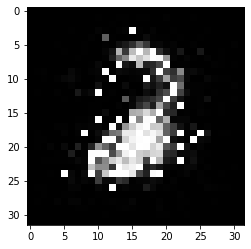

-------------------------------------


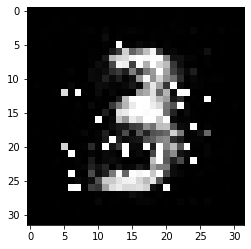

-------------------------------------


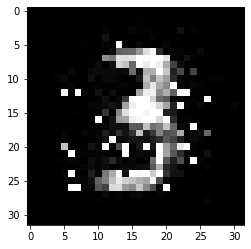

-------------------------------------


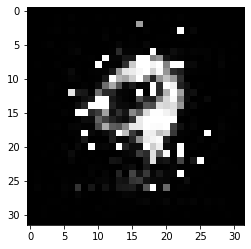

-------------------------------------


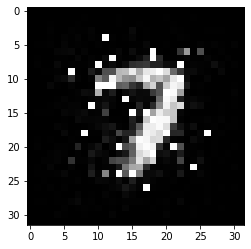

-------------------------------------


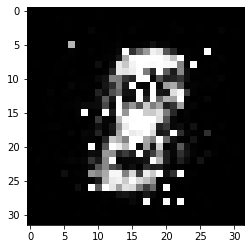

-------------------------------------


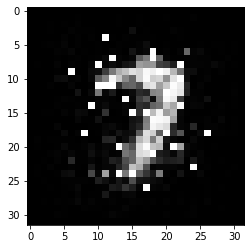

-------------------------------------


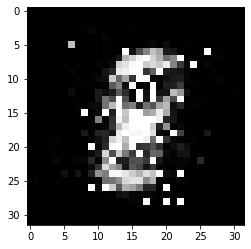

-------------------------------------


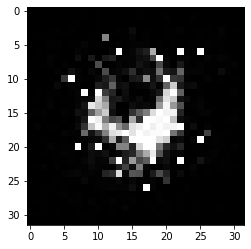

-------------------------------------


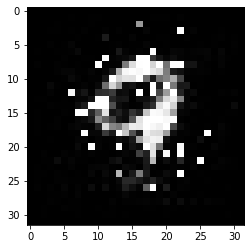

-------------------------------------


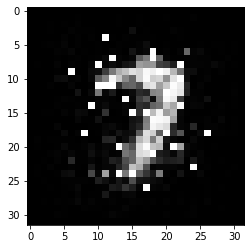

-------------------------------------


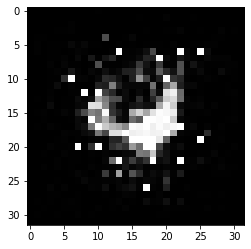

-------------------------------------


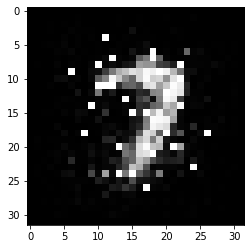

-------------------------------------


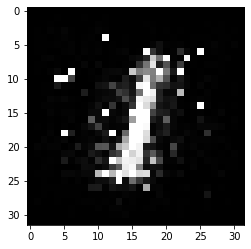

-------------------------------------


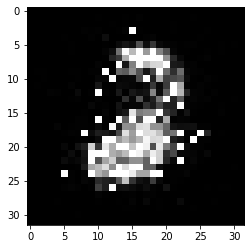

-------------------------------------


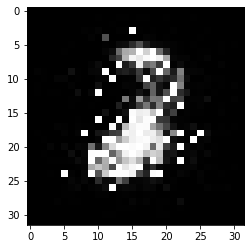

-------------------------------------


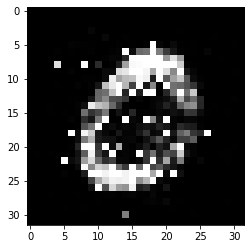

-------------------------------------


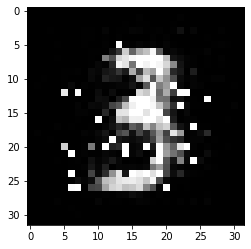

-------------------------------------


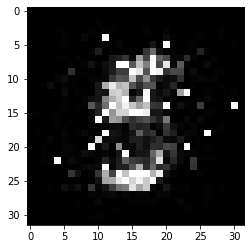

-------------------------------------


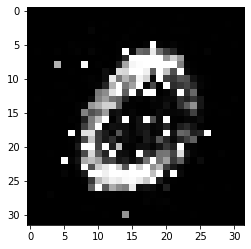

-------------------------------------


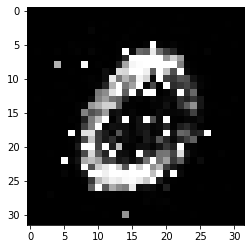

-------------------------------------


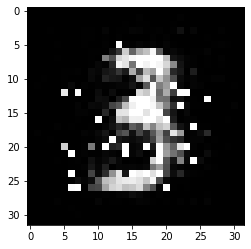

-------------------------------------


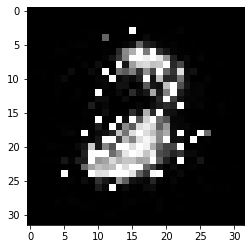

-------------------------------------


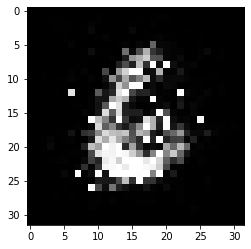

-------------------------------------


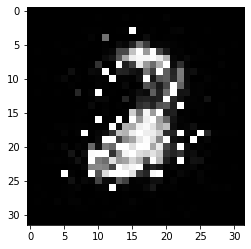

-------------------------------------


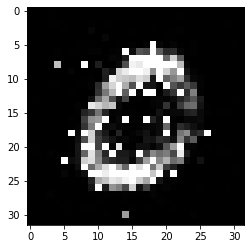

-------------------------------------


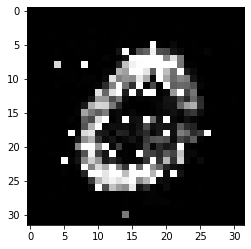

-------------------------------------


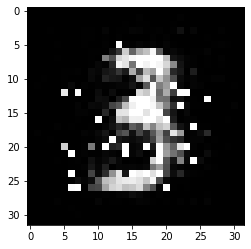

-------------------------------------


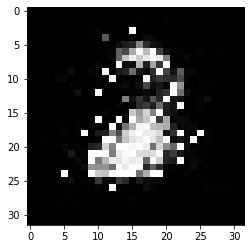

-------------------------------------


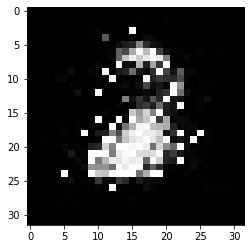

-------------------------------------


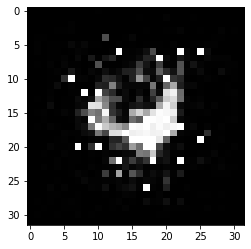

-------------------------------------


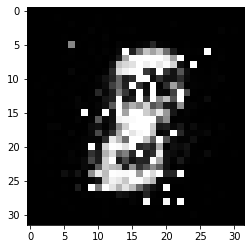

-------------------------------------


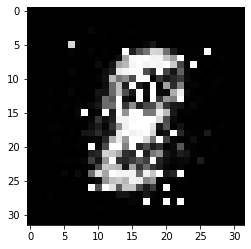

-------------------------------------


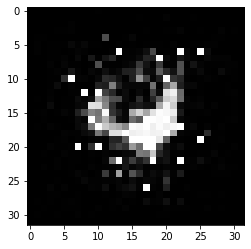

-------------------------------------


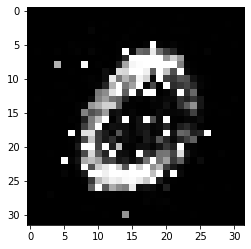

-------------------------------------


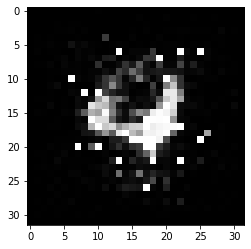

-------------------------------------


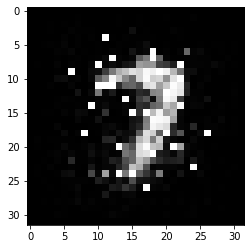

-------------------------------------


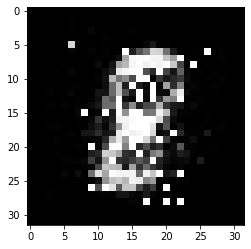

-------------------------------------


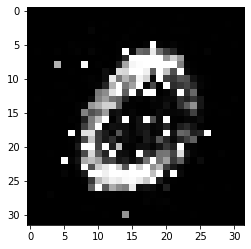

-------------------------------------


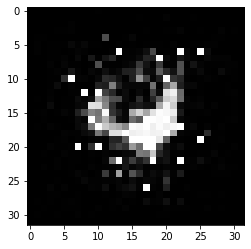

-------------------------------------


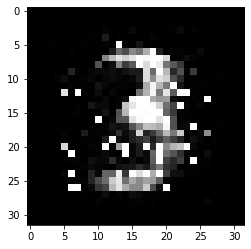

-------------------------------------


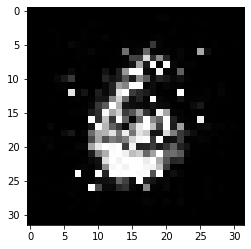

-------------------------------------


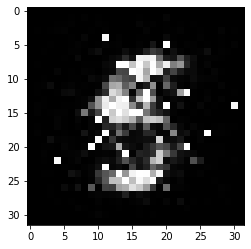

-------------------------------------


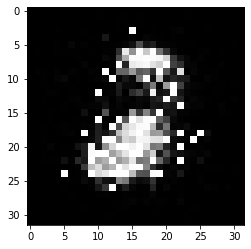

-------------------------------------


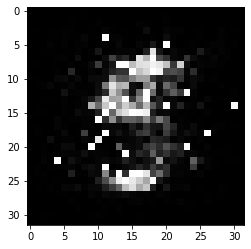

-------------------------------------


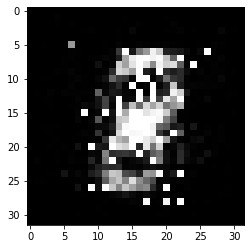

-------------------------------------


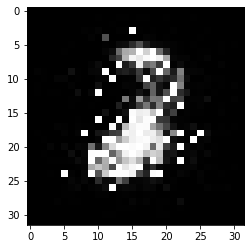

-------------------------------------


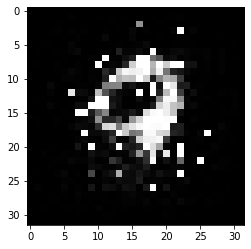

-------------------------------------


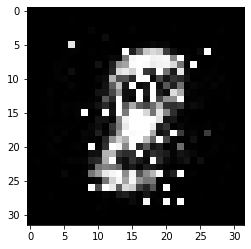

-------------------------------------


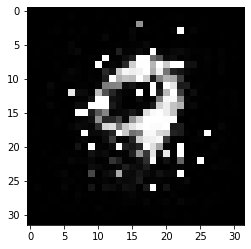

-------------------------------------


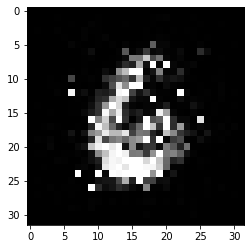

-------------------------------------


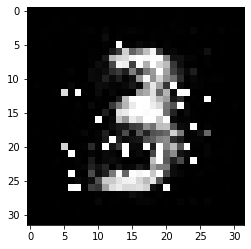

-------------------------------------


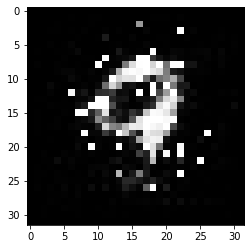

-------------------------------------


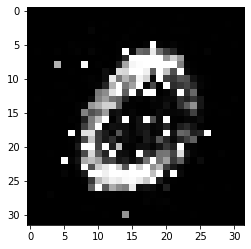

-------------------------------------


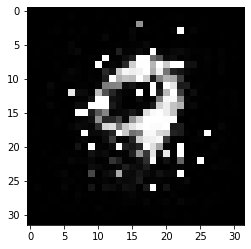

-------------------------------------


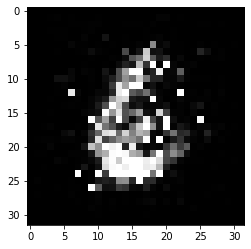

-------------------------------------


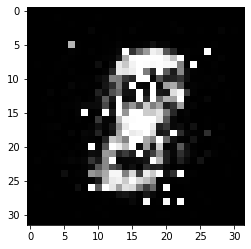

-------------------------------------


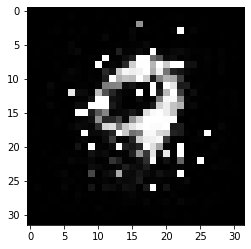

-------------------------------------


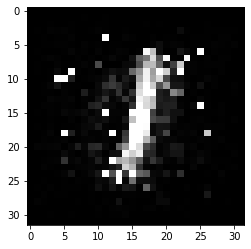

-------------------------------------


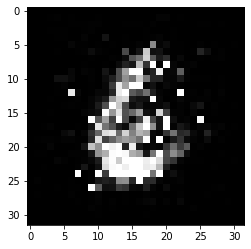

-------------------------------------


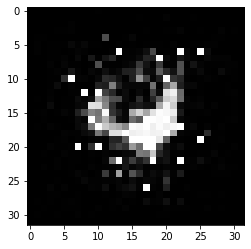

-------------------------------------


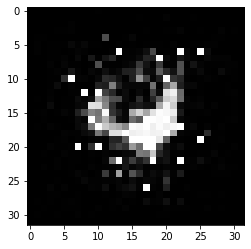

-------------------------------------


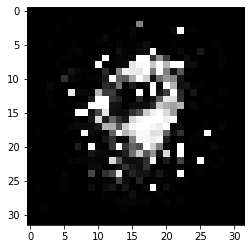

-------------------------------------


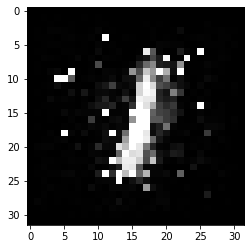

-------------------------------------


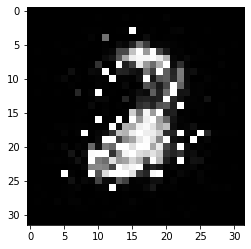

-------------------------------------


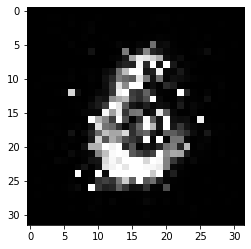

-------------------------------------


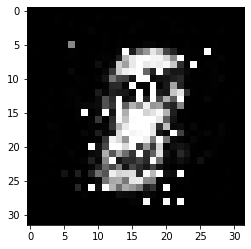

-------------------------------------


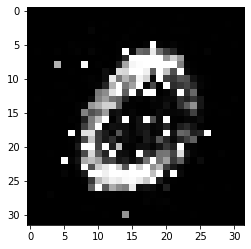

-------------------------------------


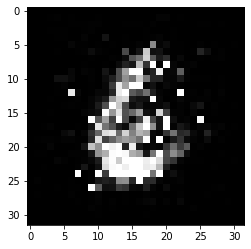

-------------------------------------


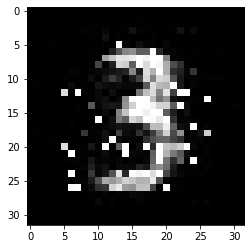

-------------------------------------


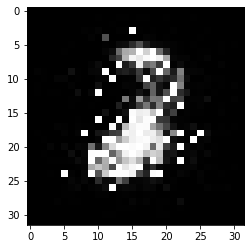

-------------------------------------


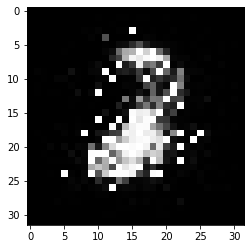

-------------------------------------


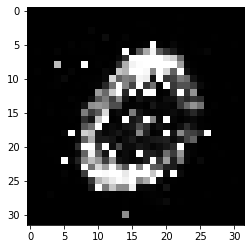

-------------------------------------


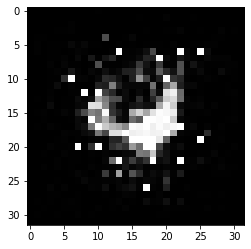

-------------------------------------


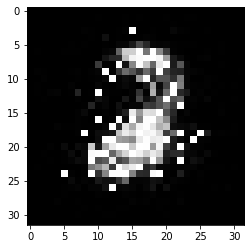

-------------------------------------


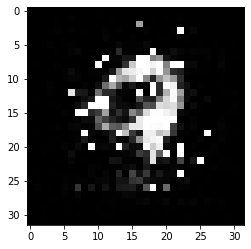

-------------------------------------


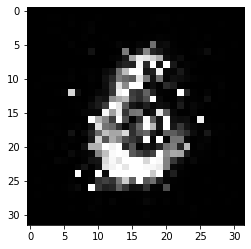

-------------------------------------


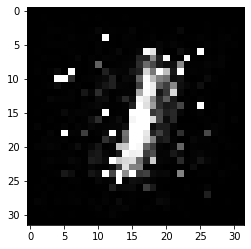

-------------------------------------


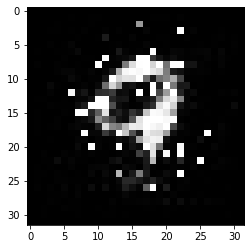

-------------------------------------


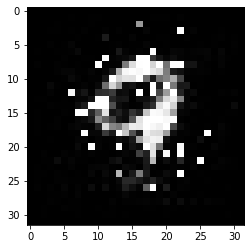

-------------------------------------


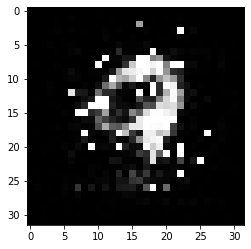

-------------------------------------


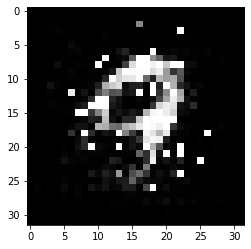

-------------------------------------


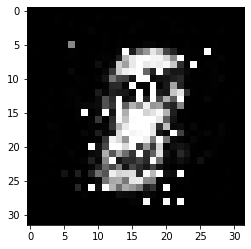

-------------------------------------


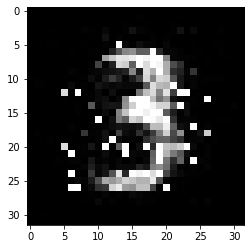

-------------------------------------


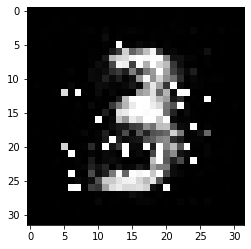

-------------------------------------


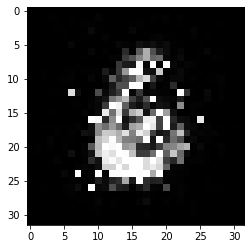

-------------------------------------


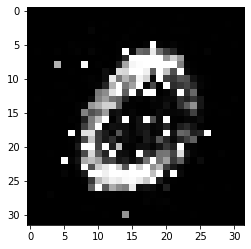

-------------------------------------


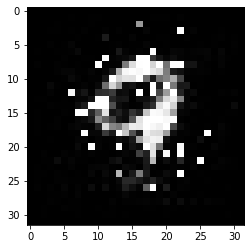

-------------------------------------


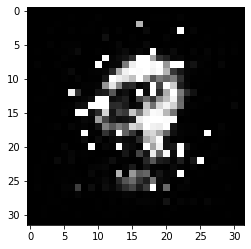

-------------------------------------


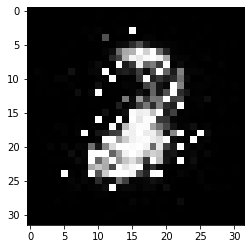

-------------------------------------


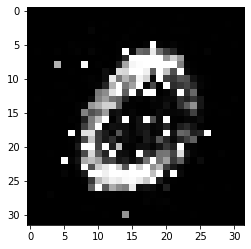

-------------------------------------


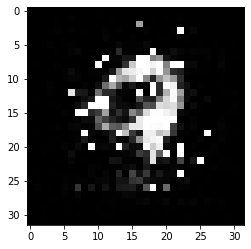

-------------------------------------


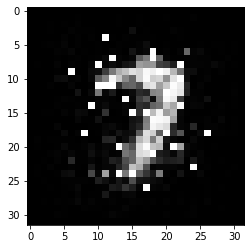

-------------------------------------


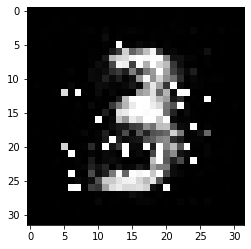

-------------------------------------


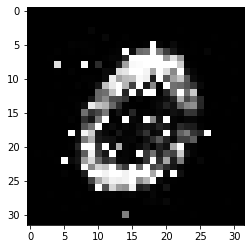

-------------------------------------


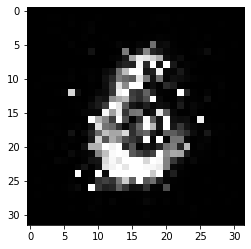

-------------------------------------


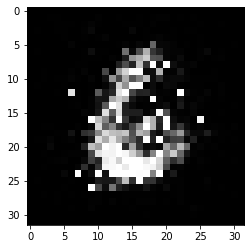

-------------------------------------


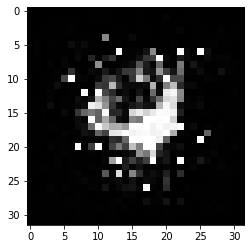

-------------------------------------


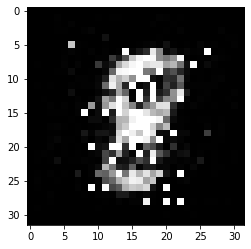

-------------------------------------


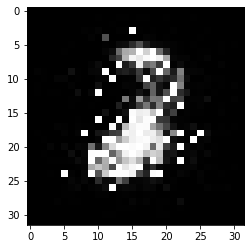

-------------------------------------


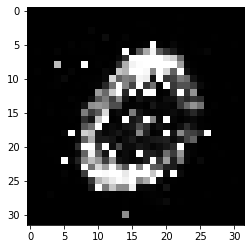

-------------------------------------


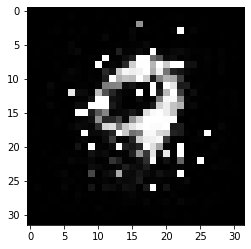

-------------------------------------


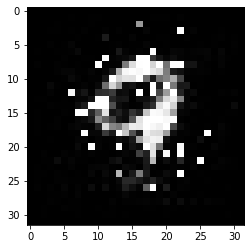

-------------------------------------


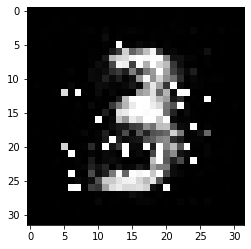

-------------------------------------


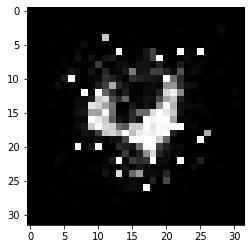

-------------------------------------


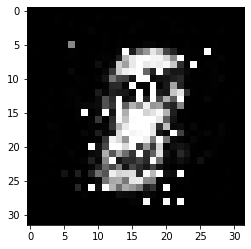

-------------------------------------


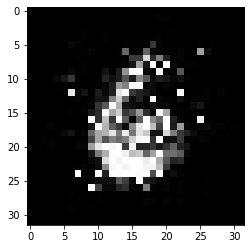

-------------------------------------


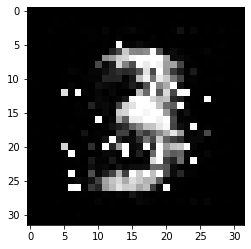

-------------------------------------


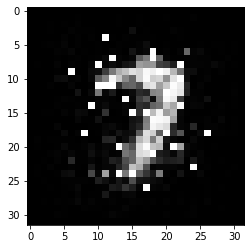

-------------------------------------


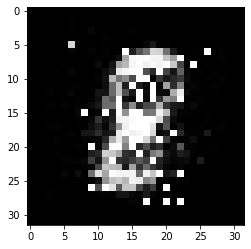

-------------------------------------


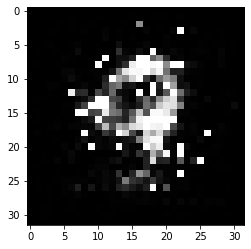

-------------------------------------


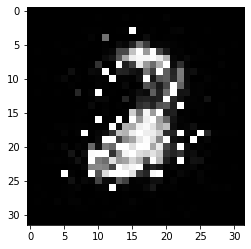

-------------------------------------


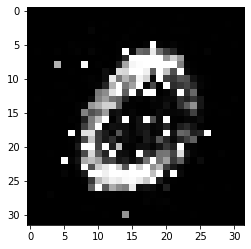

-------------------------------------


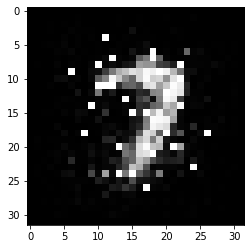

-------------------------------------


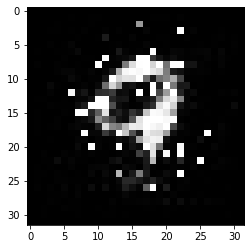

-------------------------------------


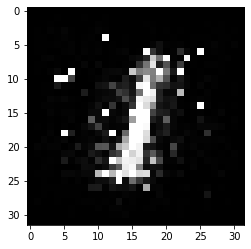

-------------------------------------


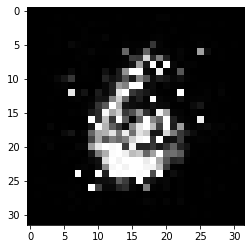

-------------------------------------


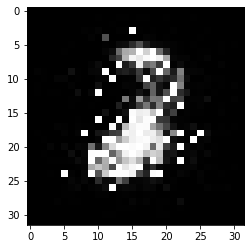

-------------------------------------


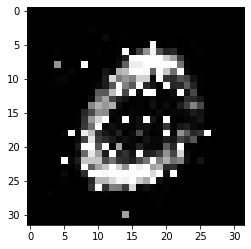

-------------------------------------


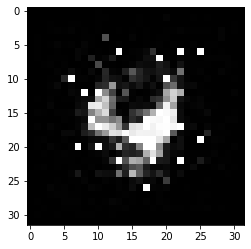

-------------------------------------


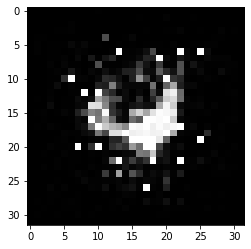

-------------------------------------


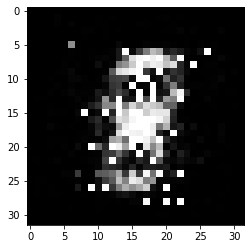

-------------------------------------


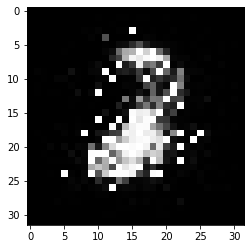

-------------------------------------


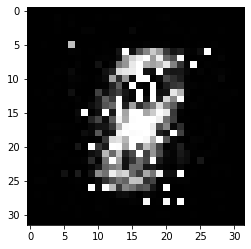

-------------------------------------


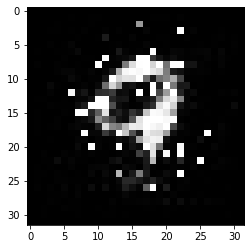

-------------------------------------


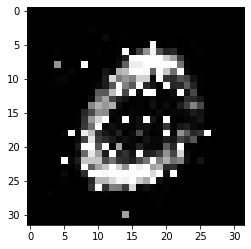

-------------------------------------


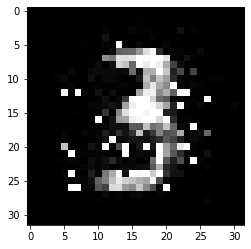

-------------------------------------


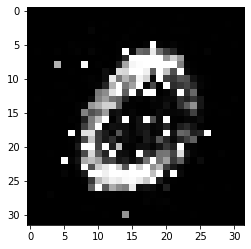

-------------------------------------


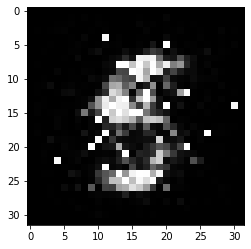

-------------------------------------


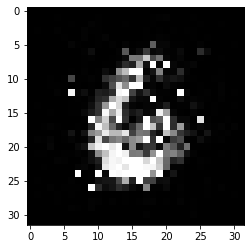

-------------------------------------


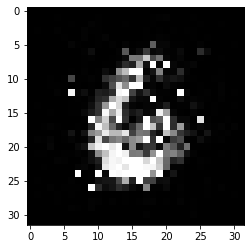

-------------------------------------


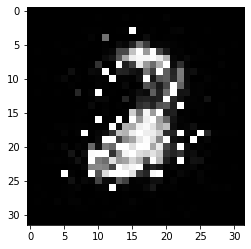

-------------------------------------


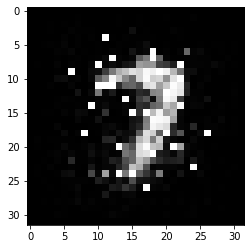

-------------------------------------


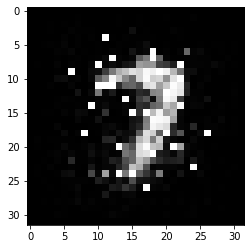

-------------------------------------


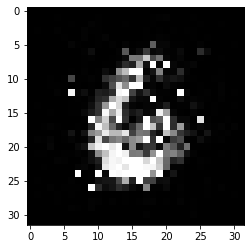

-------------------------------------


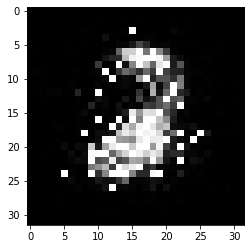

-------------------------------------


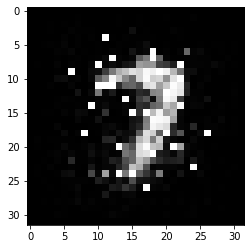

-------------------------------------


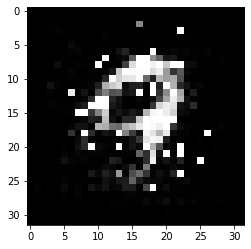

-------------------------------------


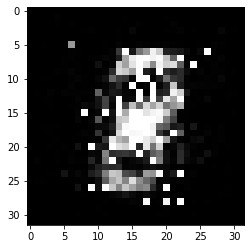

-------------------------------------


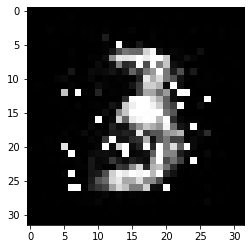

-------------------------------------


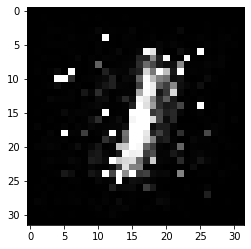

-------------------------------------


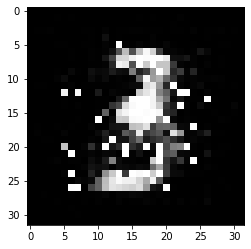

-------------------------------------


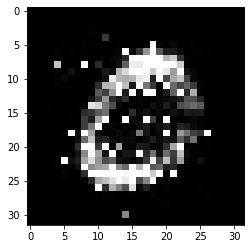

-------------------------------------


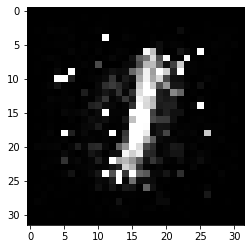

-------------------------------------


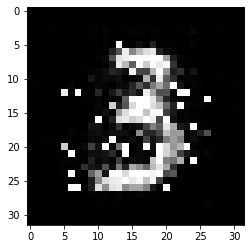

-------------------------------------


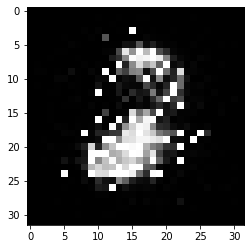

-------------------------------------


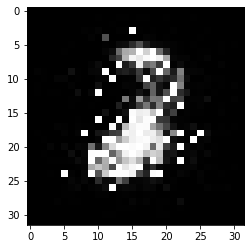

-------------------------------------


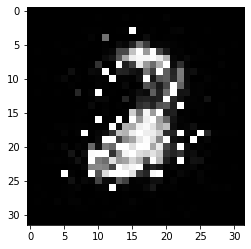

-------------------------------------


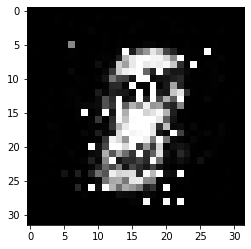

-------------------------------------


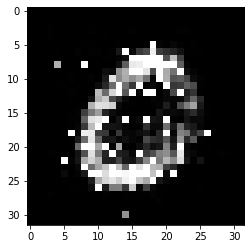

-------------------------------------


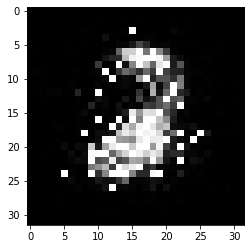

-------------------------------------


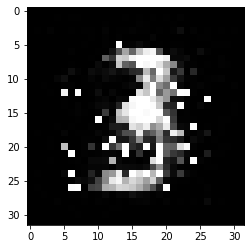

-------------------------------------


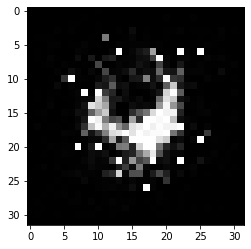

-------------------------------------


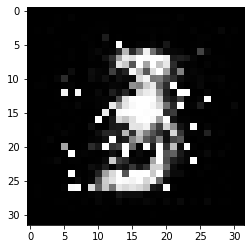

-------------------------------------


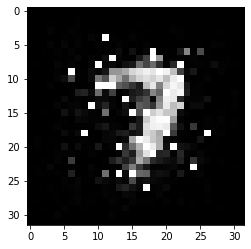

-------------------------------------


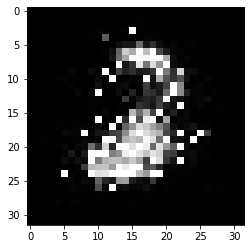

-------------------------------------


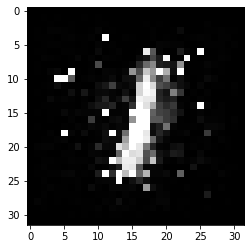

-------------------------------------


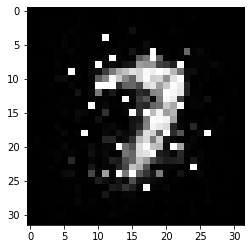

-------------------------------------


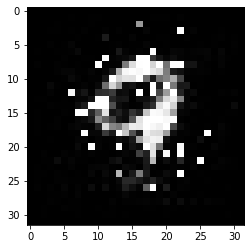

-------------------------------------


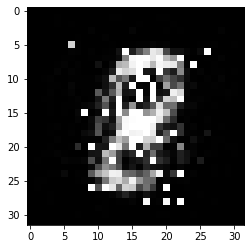

-------------------------------------


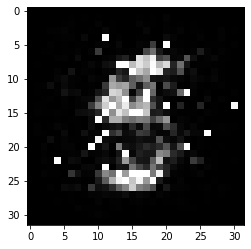

-------------------------------------


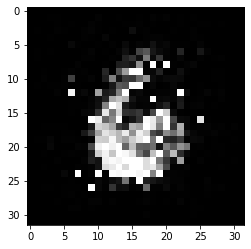

-------------------------------------


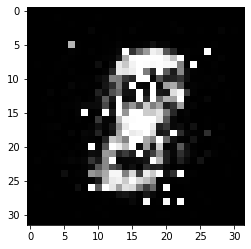

-------------------------------------


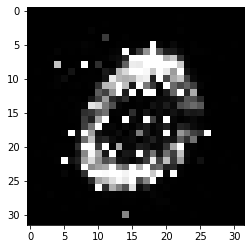

-------------------------------------


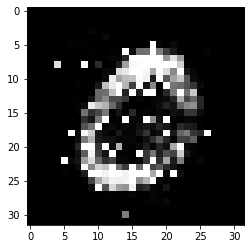

-------------------------------------


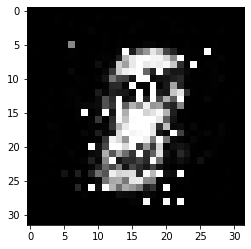

-------------------------------------


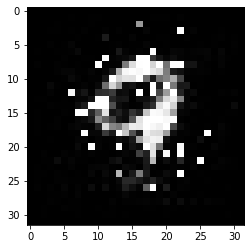

-------------------------------------


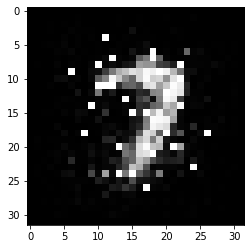

-------------------------------------


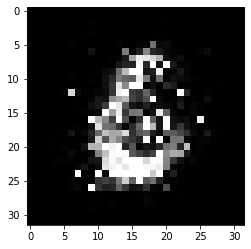

-------------------------------------


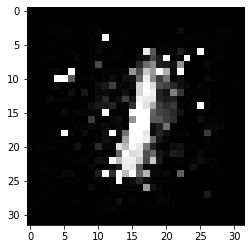

-------------------------------------


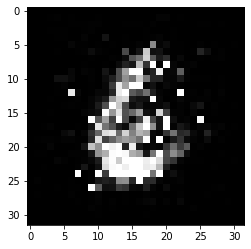

-------------------------------------


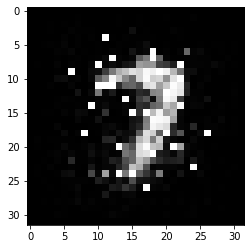

-------------------------------------


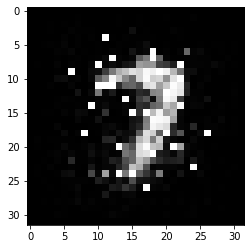

-------------------------------------


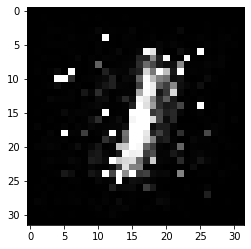

-------------------------------------


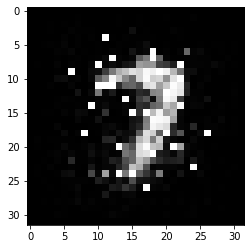

-------------------------------------


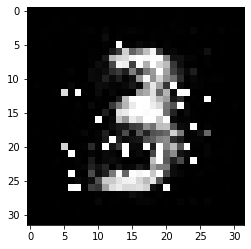

-------------------------------------


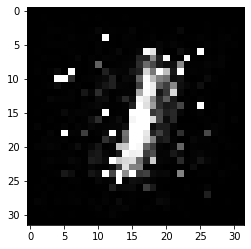

-------------------------------------


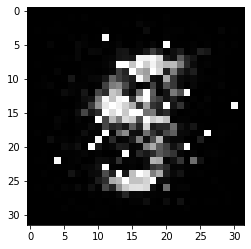

-------------------------------------


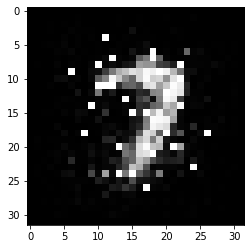

-------------------------------------


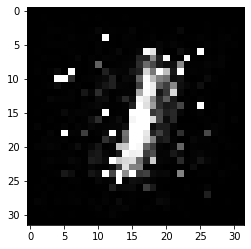

-------------------------------------


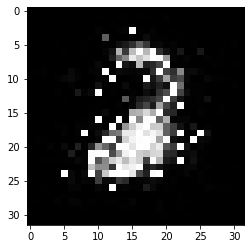

-------------------------------------


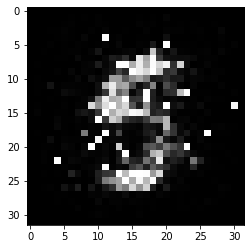

-------------------------------------


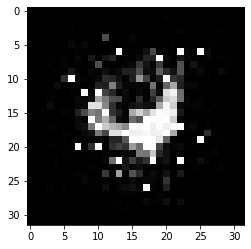

-------------------------------------


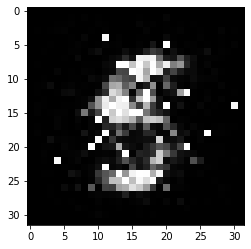

-------------------------------------


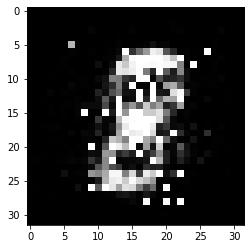

-------------------------------------


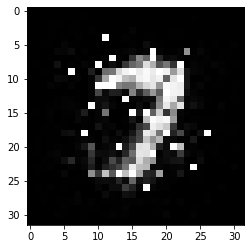

-------------------------------------


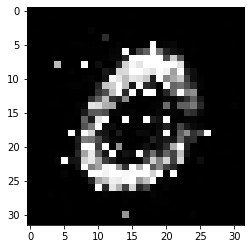

-------------------------------------


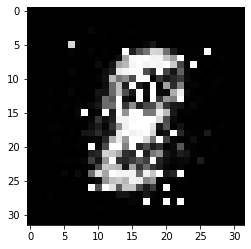

-------------------------------------


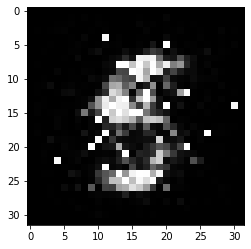

-------------------------------------


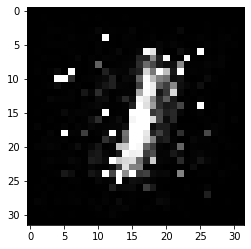

-------------------------------------


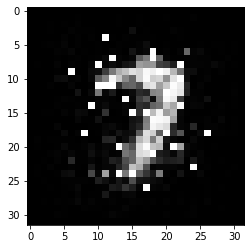

-------------------------------------


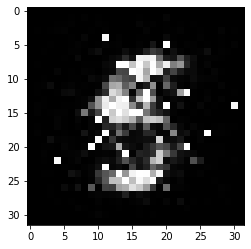

-------------------------------------


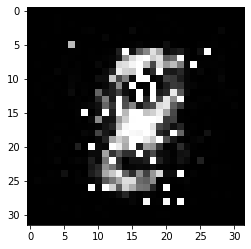

-------------------------------------


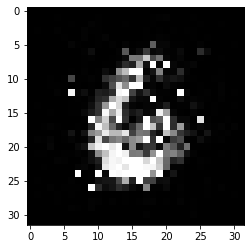

-------------------------------------


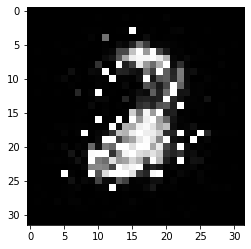

-------------------------------------


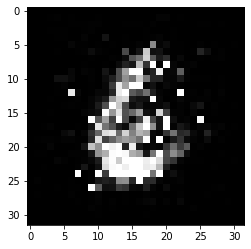

-------------------------------------


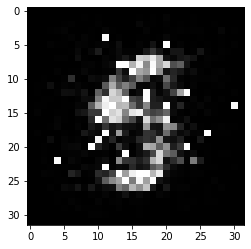

-------------------------------------


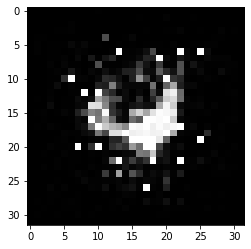

-------------------------------------


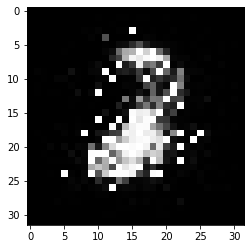

-------------------------------------


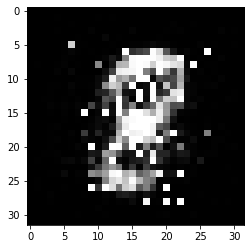

-------------------------------------


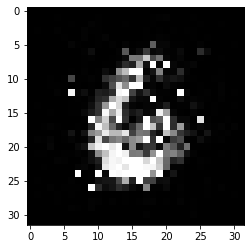

-------------------------------------


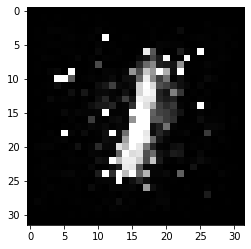

-------------------------------------


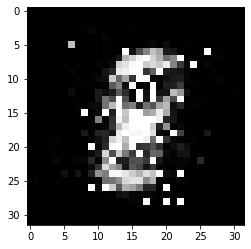

-------------------------------------


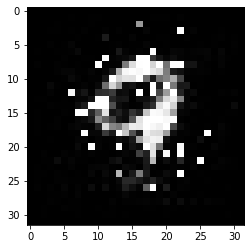

-------------------------------------


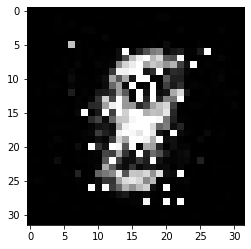

-------------------------------------


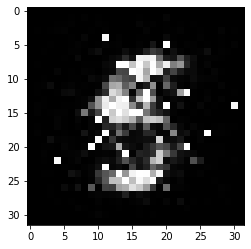

-------------------------------------


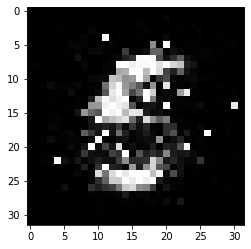

-------------------------------------


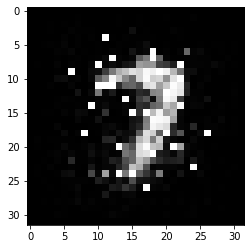

-------------------------------------


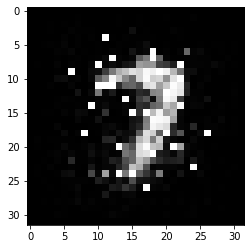

-------------------------------------


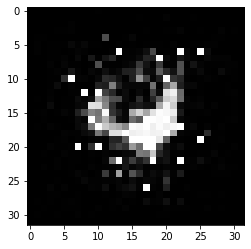

-------------------------------------


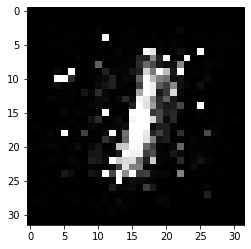

-------------------------------------


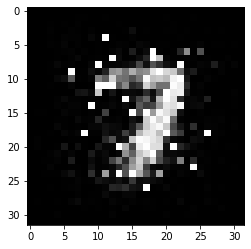

-------------------------------------


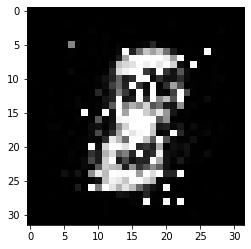

-------------------------------------


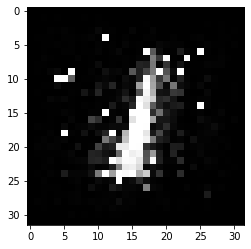

-------------------------------------


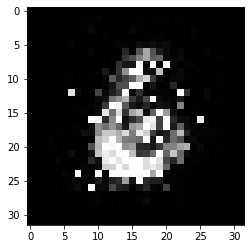

-------------------------------------


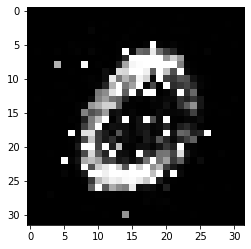

-------------------------------------


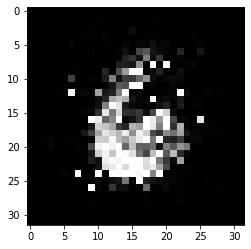

-------------------------------------


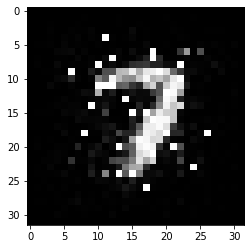

-------------------------------------


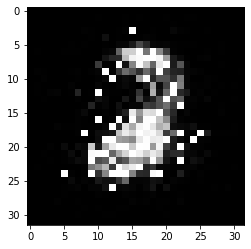

-------------------------------------


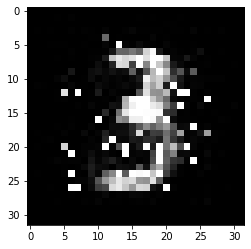

-------------------------------------


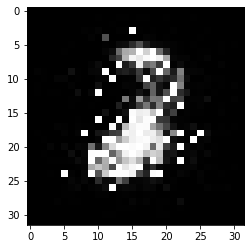

-------------------------------------


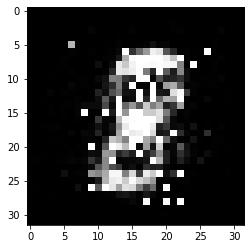

-------------------------------------


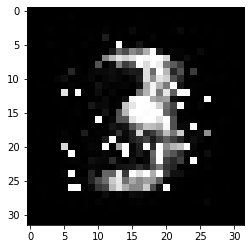

-------------------------------------


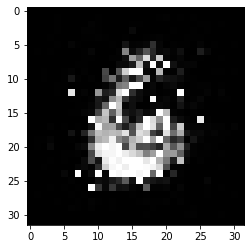

-------------------------------------


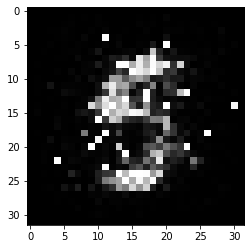

-------------------------------------


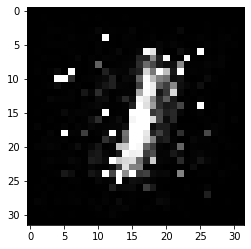

-------------------------------------


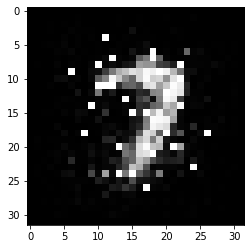

-------------------------------------


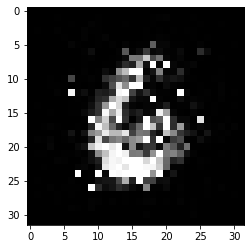

-------------------------------------


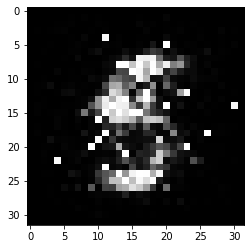

-------------------------------------


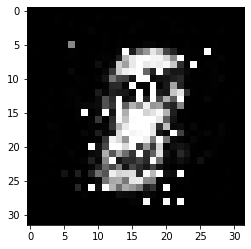

-------------------------------------


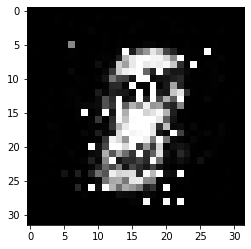

-------------------------------------


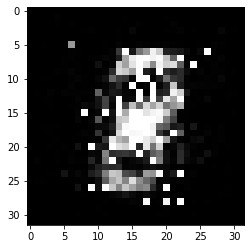

-------------------------------------


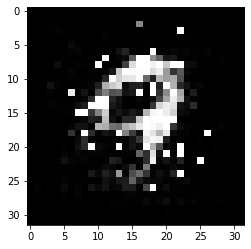

-------------------------------------


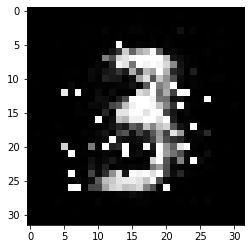

-------------------------------------


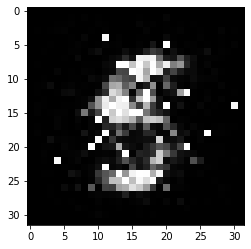

-------------------------------------


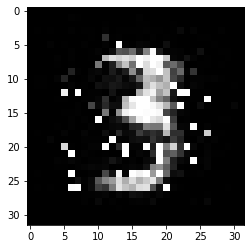

-------------------------------------


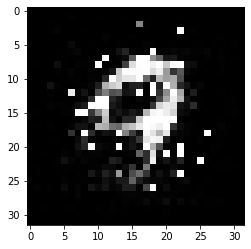

-------------------------------------


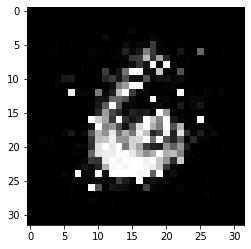

-------------------------------------


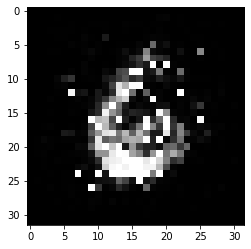

-------------------------------------


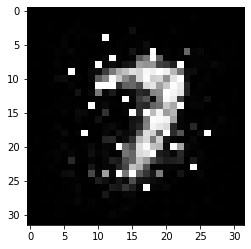

-------------------------------------


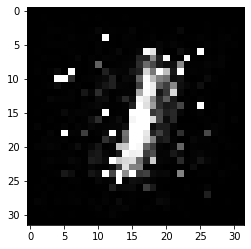

-------------------------------------


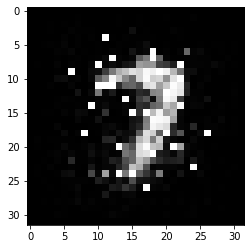

-------------------------------------


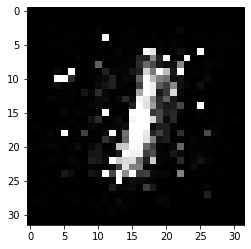

-------------------------------------


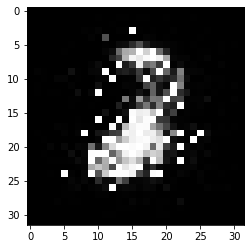

-------------------------------------


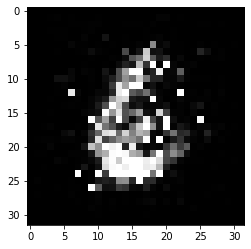

-------------------------------------


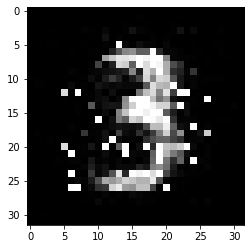

-------------------------------------


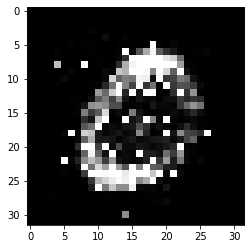

-------------------------------------


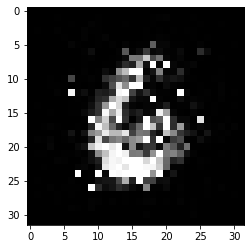

-------------------------------------


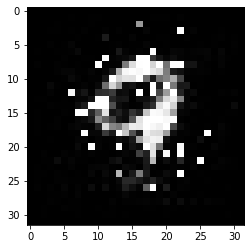

-------------------------------------


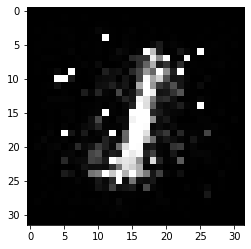

-------------------------------------


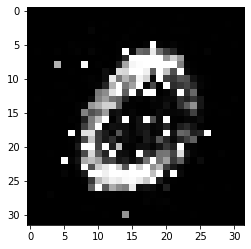

-------------------------------------


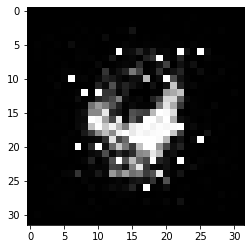

-------------------------------------


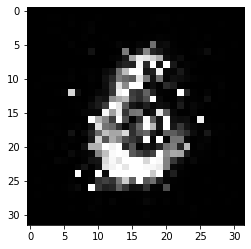

-------------------------------------


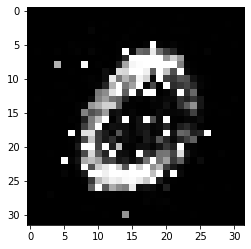

-------------------------------------


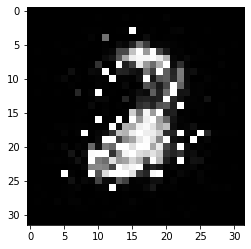

-------------------------------------


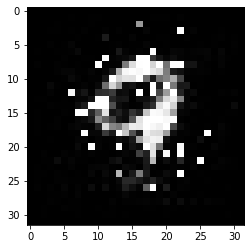

-------------------------------------


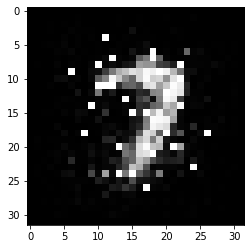

-------------------------------------


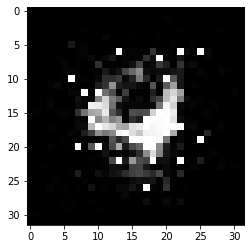

-------------------------------------


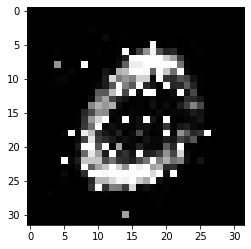

-------------------------------------


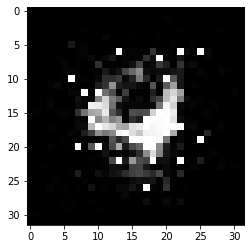

-------------------------------------


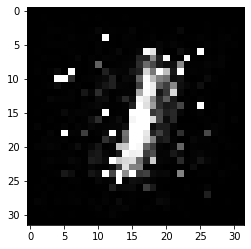

-------------------------------------


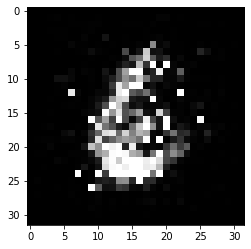

-------------------------------------


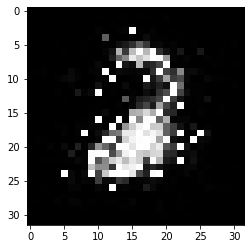

-------------------------------------


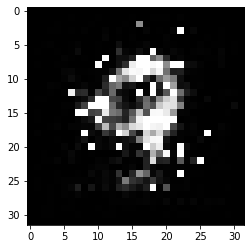

-------------------------------------


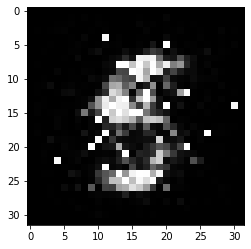

-------------------------------------


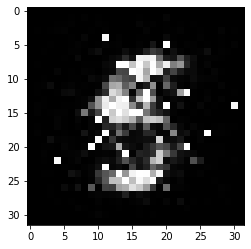

-------------------------------------


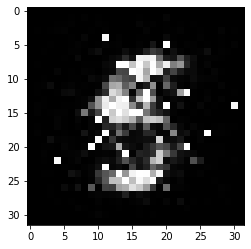

-------------------------------------


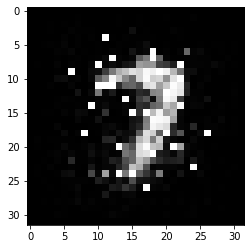

-------------------------------------


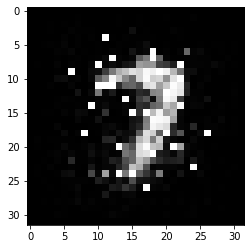

-------------------------------------


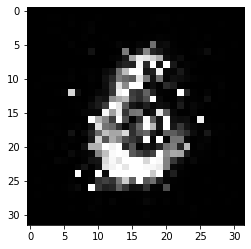

-------------------------------------


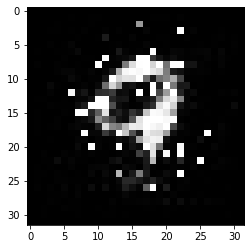

-------------------------------------


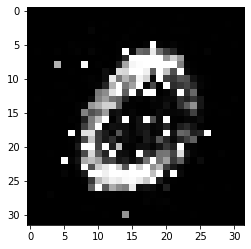

-------------------------------------


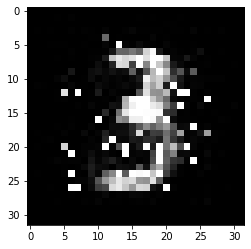

-------------------------------------


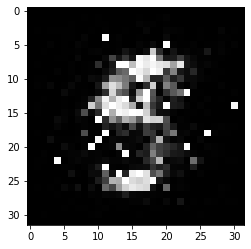

-------------------------------------


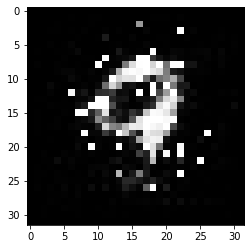

-------------------------------------


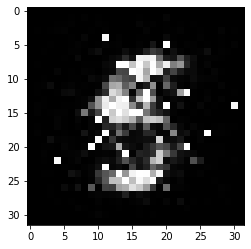

-------------------------------------


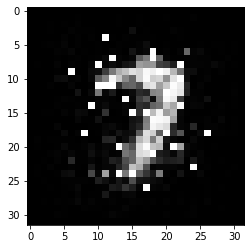

-------------------------------------


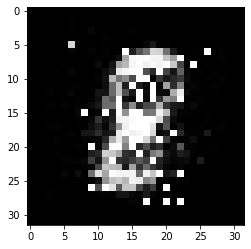

-------------------------------------


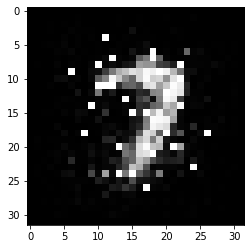

-------------------------------------


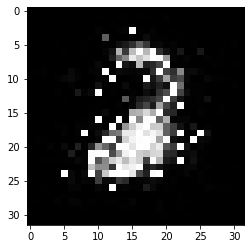

-------------------------------------


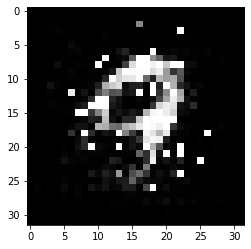

-------------------------------------


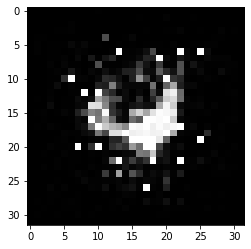

-------------------------------------


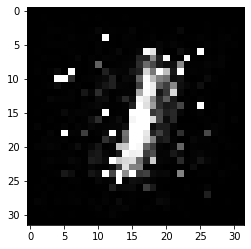

-------------------------------------


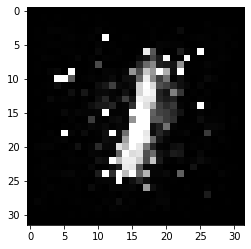

-------------------------------------


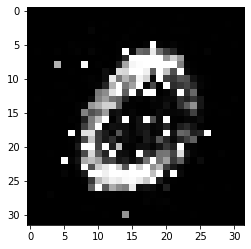

-------------------------------------


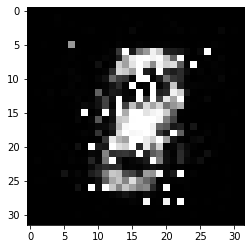

-------------------------------------


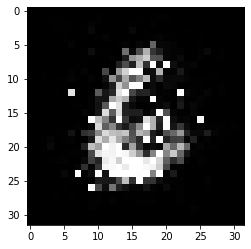

-------------------------------------


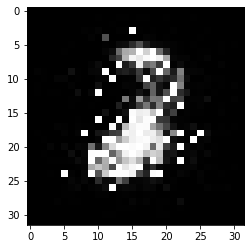

-------------------------------------


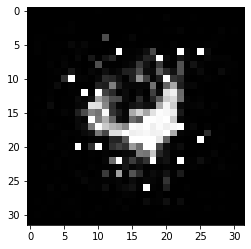

-------------------------------------


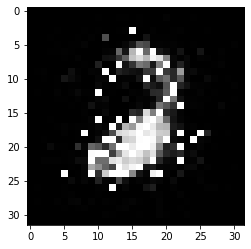

-------------------------------------


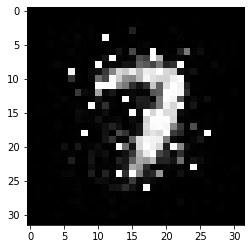

-------------------------------------


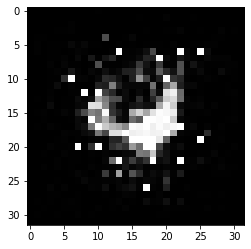

-------------------------------------


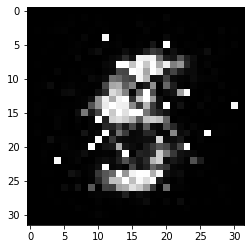

-------------------------------------


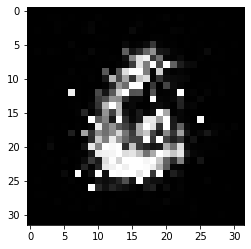

-------------------------------------


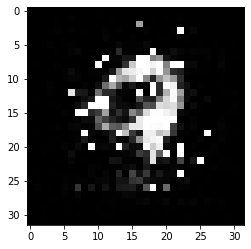

-------------------------------------


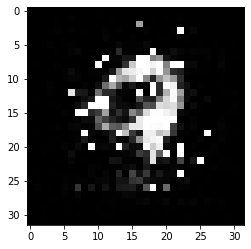

-------------------------------------


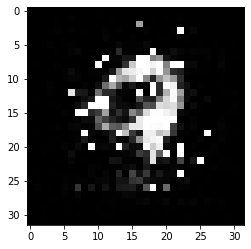

-------------------------------------


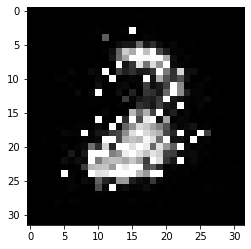

-------------------------------------


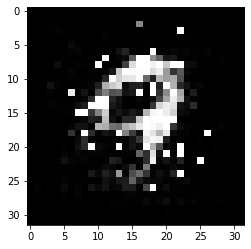

-------------------------------------


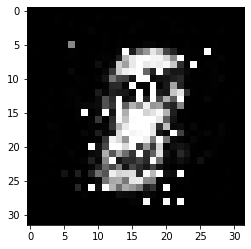

-------------------------------------


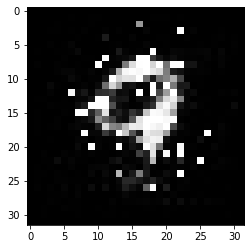

-------------------------------------


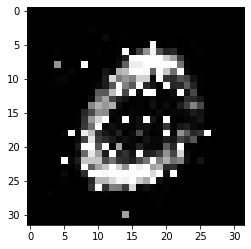

-------------------------------------


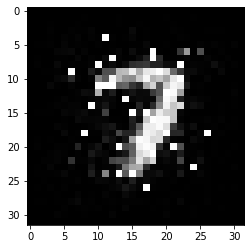

-------------------------------------


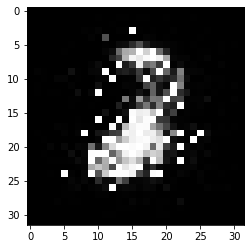

-------------------------------------


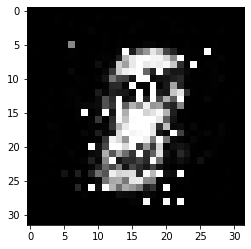

-------------------------------------


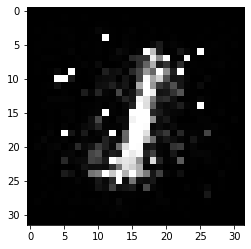

-------------------------------------


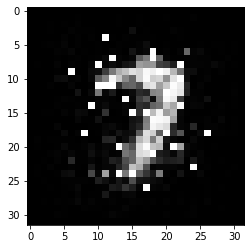

-------------------------------------


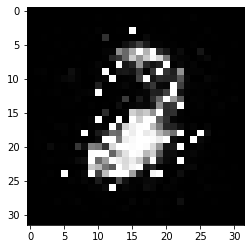

-------------------------------------


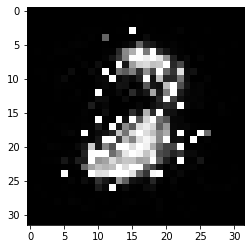

-------------------------------------


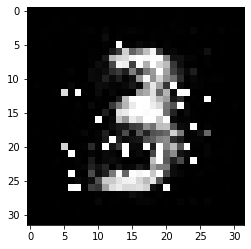

-------------------------------------


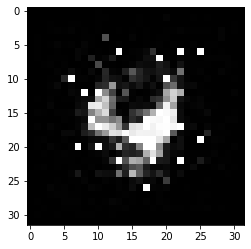

-------------------------------------


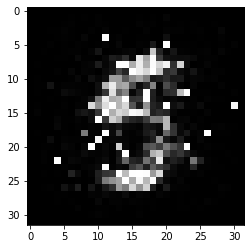

-------------------------------------


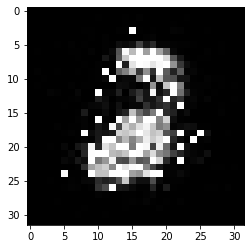

-------------------------------------


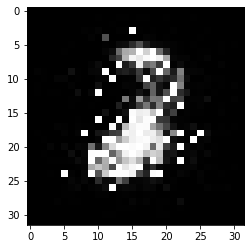

-------------------------------------


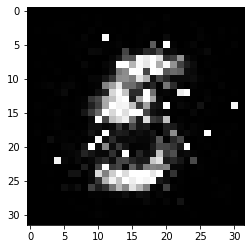

-------------------------------------


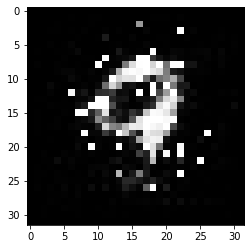

-------------------------------------


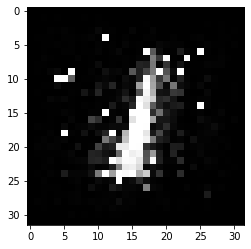

-------------------------------------


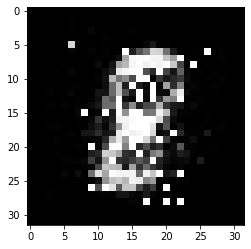

-------------------------------------


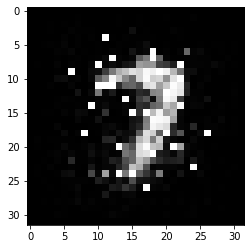

-------------------------------------


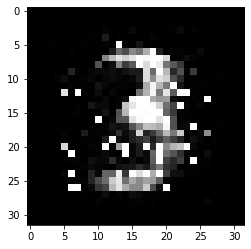

-------------------------------------


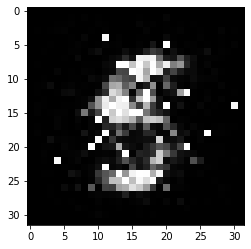

-------------------------------------


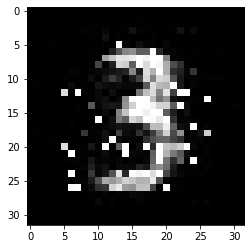

-------------------------------------


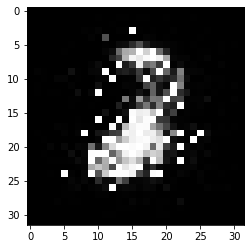

-------------------------------------


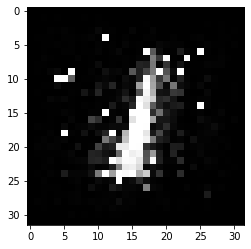

-------------------------------------


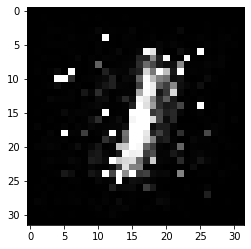

-------------------------------------


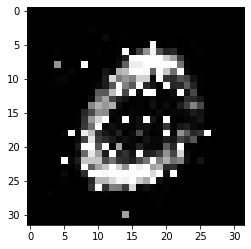

-------------------------------------


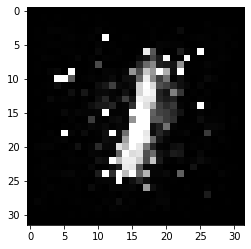

-------------------------------------


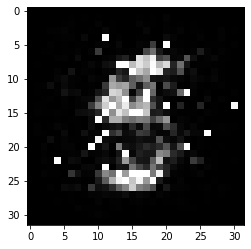

-------------------------------------


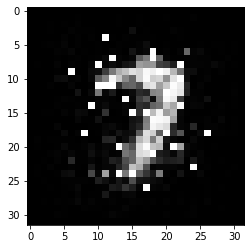

-------------------------------------


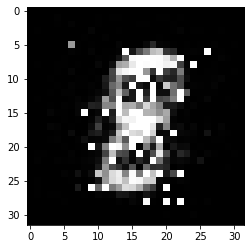

-------------------------------------


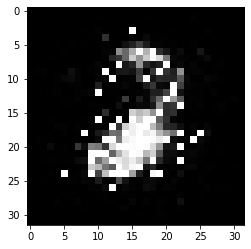

-------------------------------------


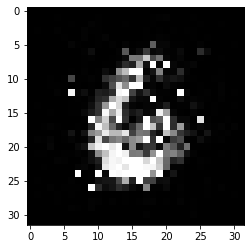

-------------------------------------


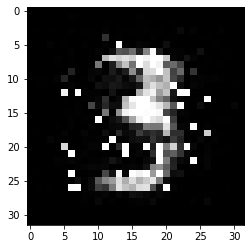

-------------------------------------


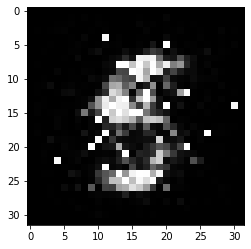

-------------------------------------


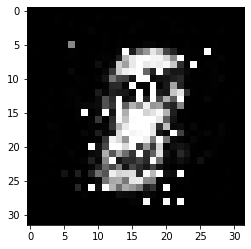

-------------------------------------


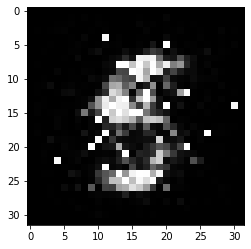

-------------------------------------


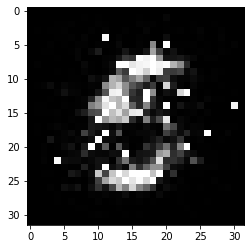

-------------------------------------


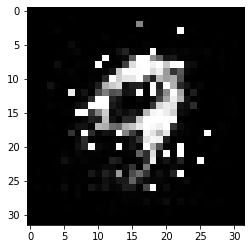

-------------------------------------


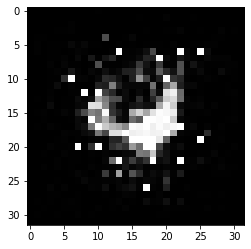

-------------------------------------


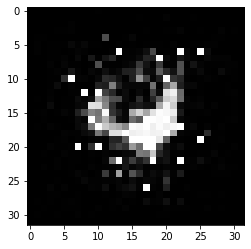

-------------------------------------


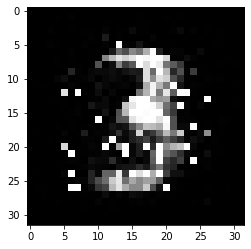

-------------------------------------


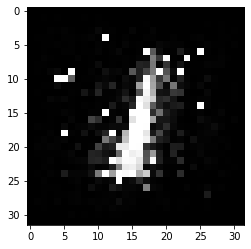

-------------------------------------


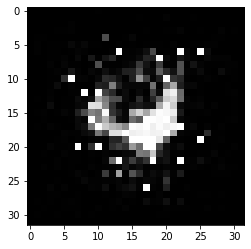

-------------------------------------


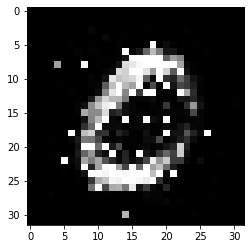

-------------------------------------


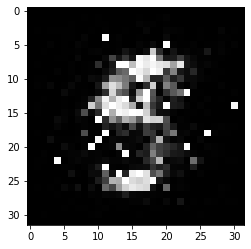

-------------------------------------


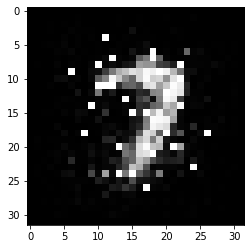

-------------------------------------


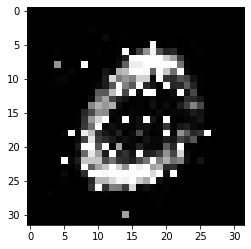

-------------------------------------


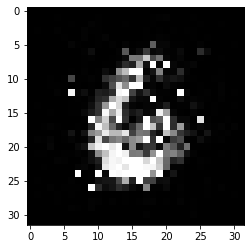

-------------------------------------


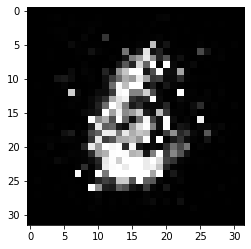

-------------------------------------


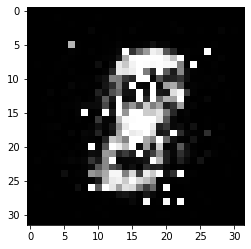

-------------------------------------


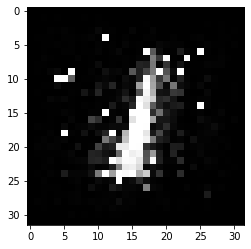

-------------------------------------


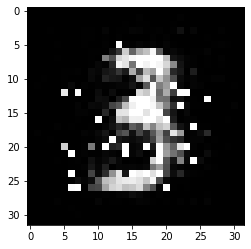

-------------------------------------


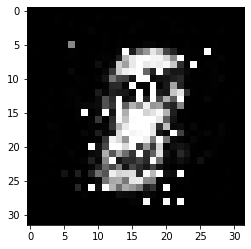

-------------------------------------


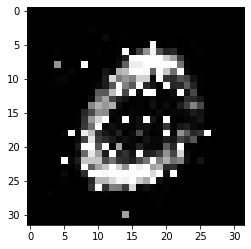

-------------------------------------


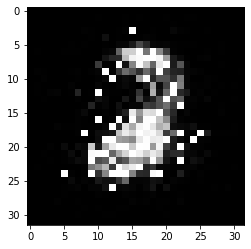

-------------------------------------


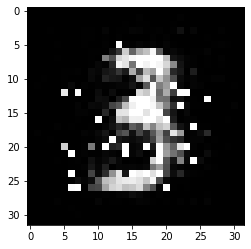

-------------------------------------


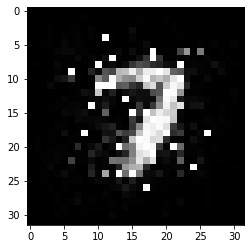

-------------------------------------


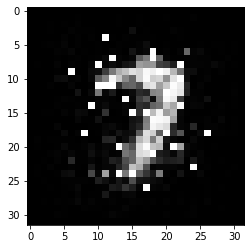

-------------------------------------


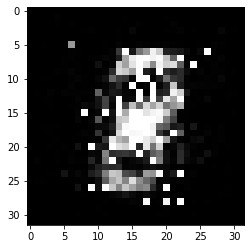

-------------------------------------


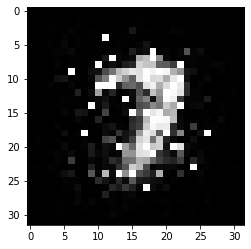

-------------------------------------


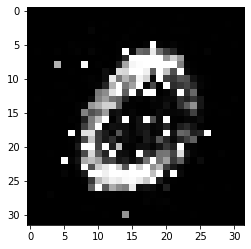

-------------------------------------


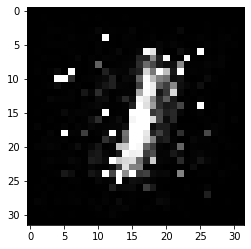

-------------------------------------


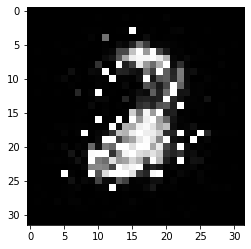

-------------------------------------


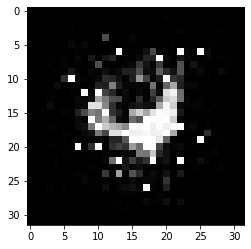

-------------------------------------


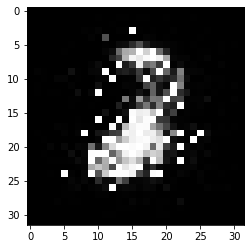

-------------------------------------


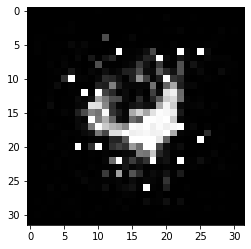

-------------------------------------


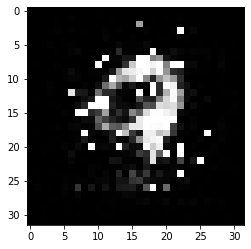

-------------------------------------


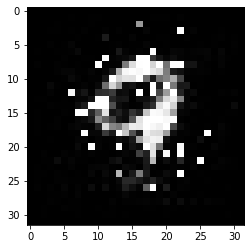

-------------------------------------


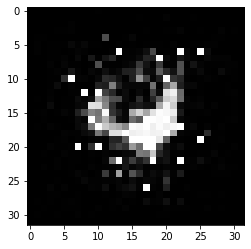

-------------------------------------


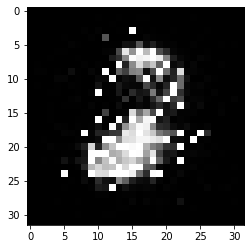

-------------------------------------


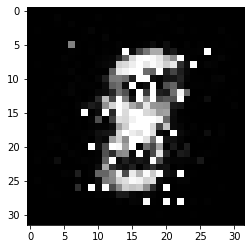

-------------------------------------


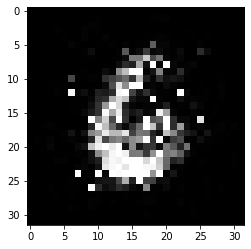

-------------------------------------


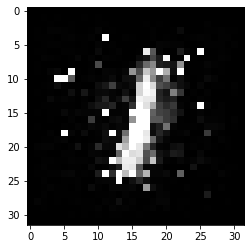

-------------------------------------


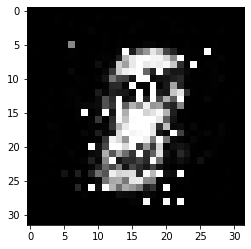

-------------------------------------


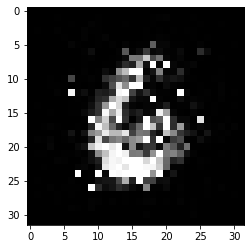

-------------------------------------


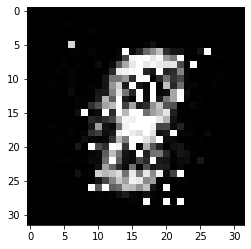

-------------------------------------


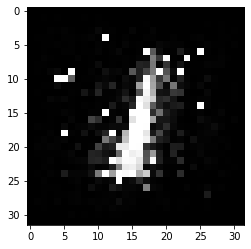

-------------------------------------


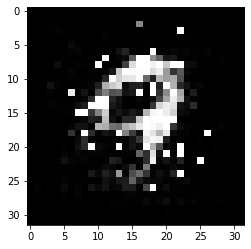

-------------------------------------


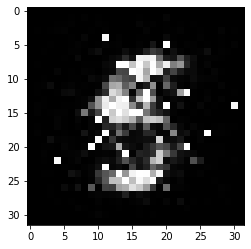

-------------------------------------


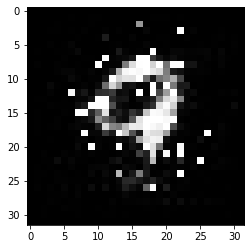

-------------------------------------


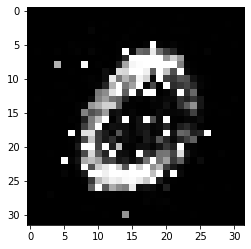

-------------------------------------


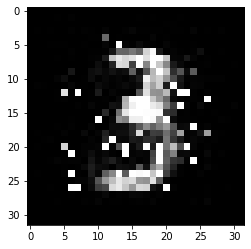

-------------------------------------


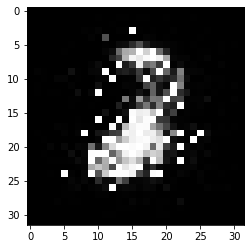

-------------------------------------


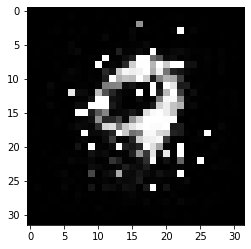

-------------------------------------


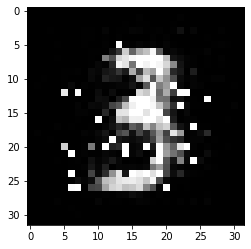

-------------------------------------


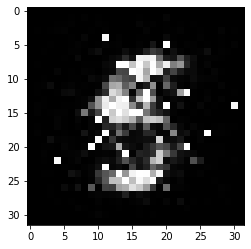

-------------------------------------


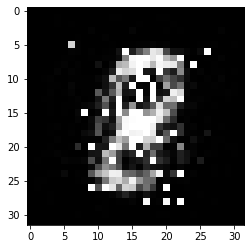

-------------------------------------


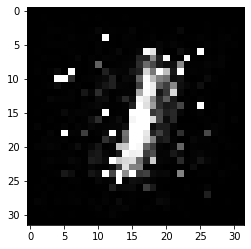

-------------------------------------


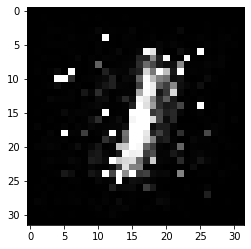

-------------------------------------


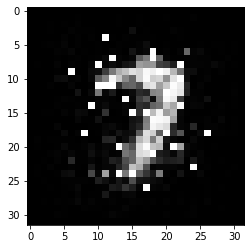

-------------------------------------


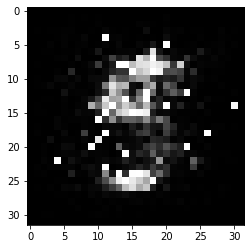

-------------------------------------


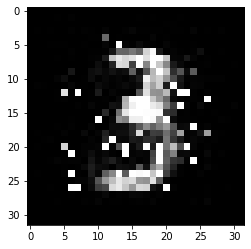

-------------------------------------


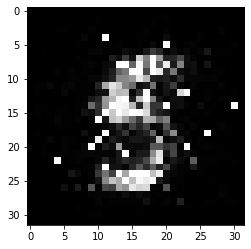

-------------------------------------


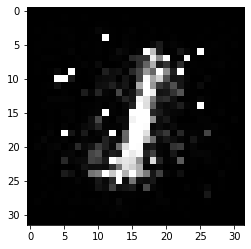

-------------------------------------


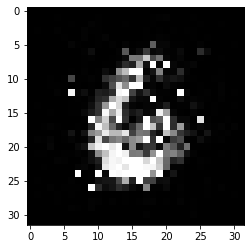

-------------------------------------


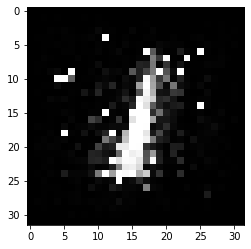

-------------------------------------


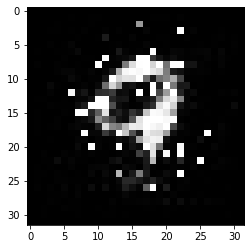

-------------------------------------


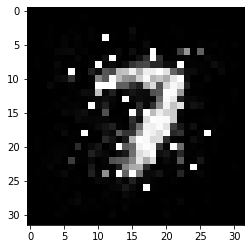

-------------------------------------


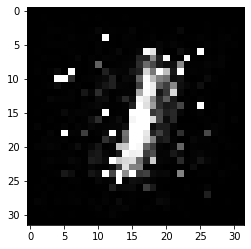

-------------------------------------


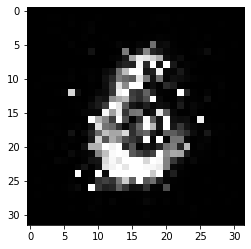

-------------------------------------


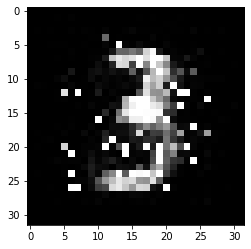

-------------------------------------


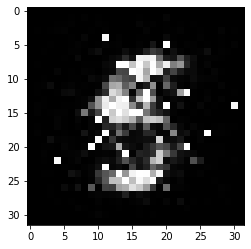

-------------------------------------


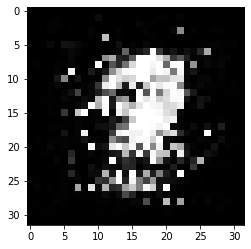

-------------------------------------


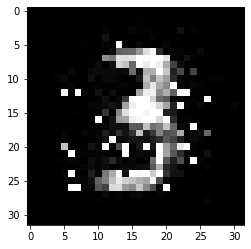

-------------------------------------


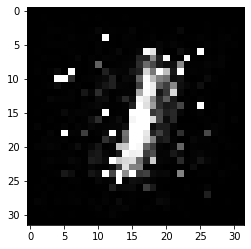

-------------------------------------


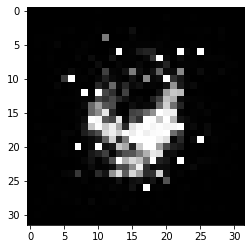

-------------------------------------


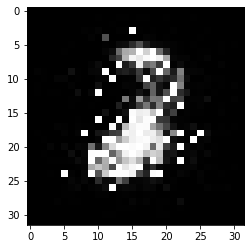

-------------------------------------


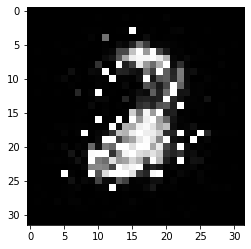

-------------------------------------


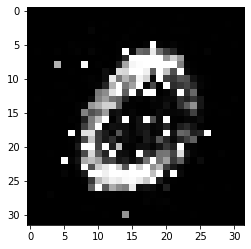

-------------------------------------


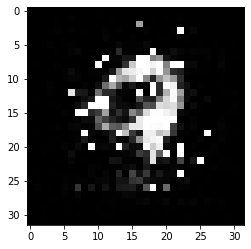

-------------------------------------


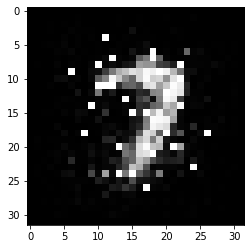

-------------------------------------


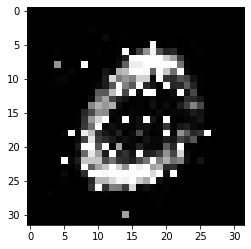

-------------------------------------


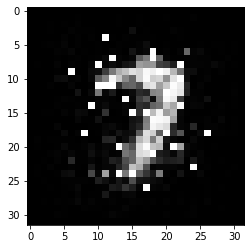

-------------------------------------


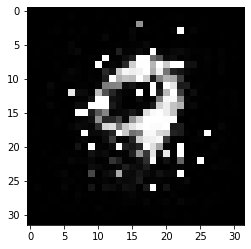

-------------------------------------


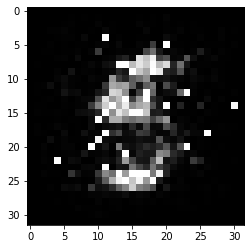

-------------------------------------


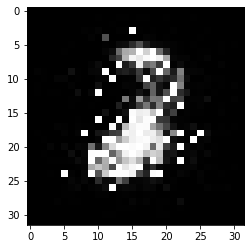

-------------------------------------


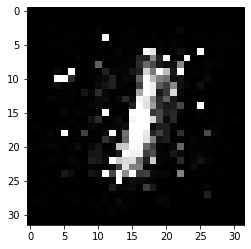

-------------------------------------


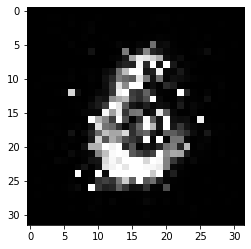

-------------------------------------


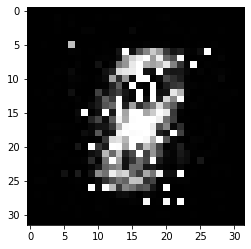

-------------------------------------


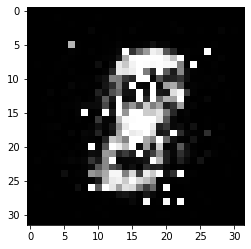

-------------------------------------


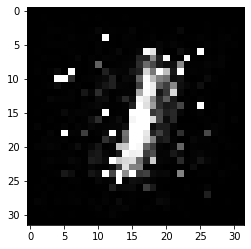

-------------------------------------


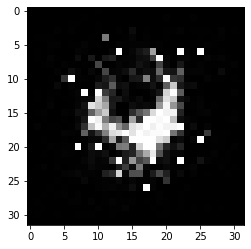

-------------------------------------


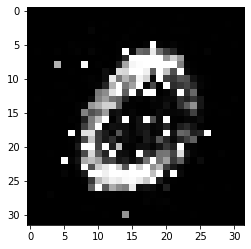

-------------------------------------


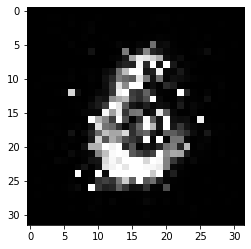

-------------------------------------


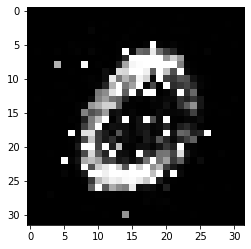

-------------------------------------


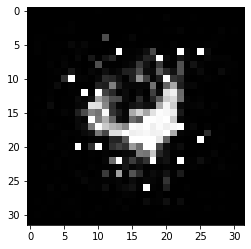

-------------------------------------


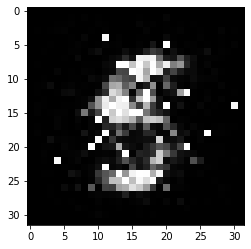

-------------------------------------


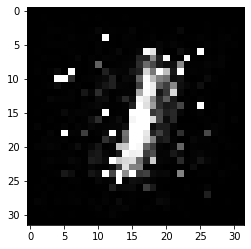

-------------------------------------


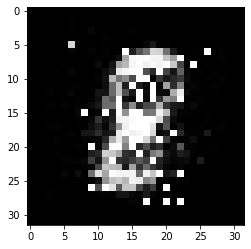

-------------------------------------


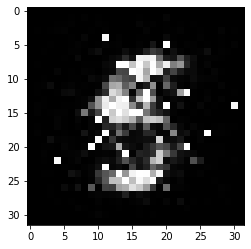

-------------------------------------


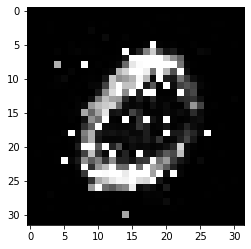

-------------------------------------


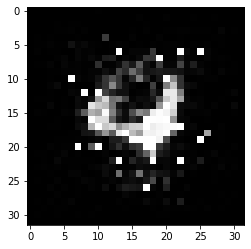

-------------------------------------


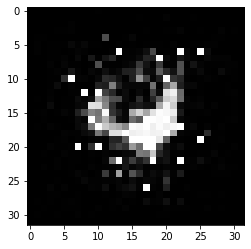

-------------------------------------


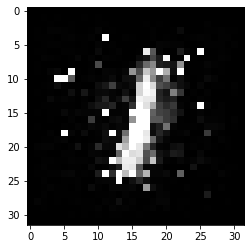

-------------------------------------


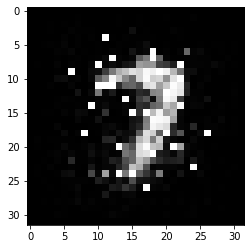

-------------------------------------


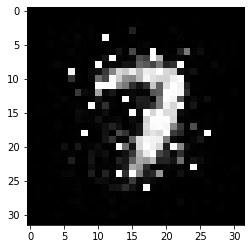

-------------------------------------


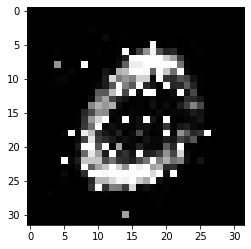

-------------------------------------


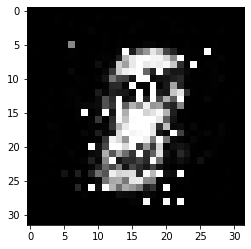

-------------------------------------


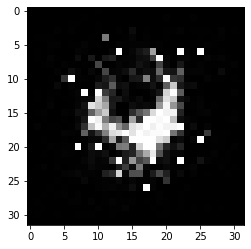

-------------------------------------


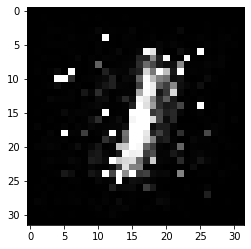

-------------------------------------


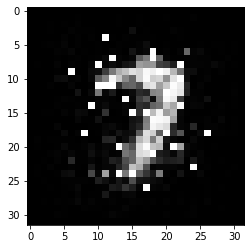

-------------------------------------


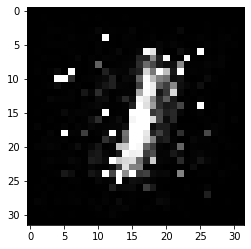

-------------------------------------


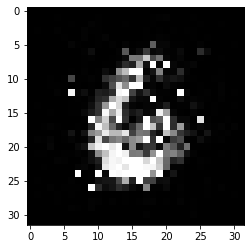

-------------------------------------


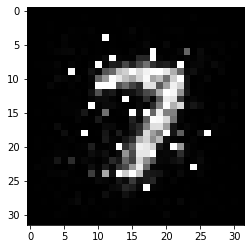

-------------------------------------


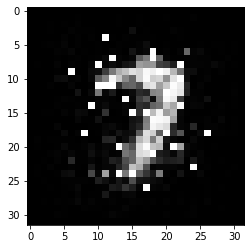

-------------------------------------


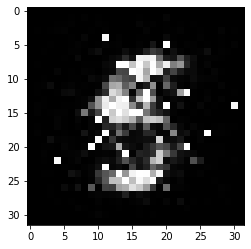

-------------------------------------


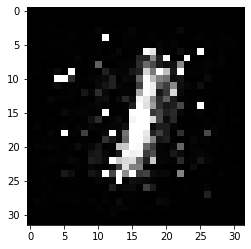

-------------------------------------


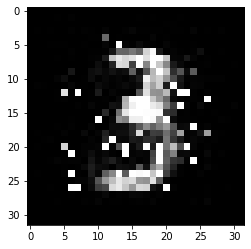

-------------------------------------


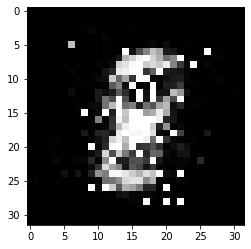

-------------------------------------


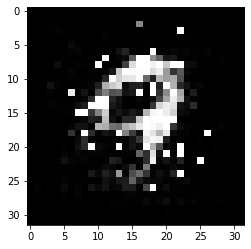

-------------------------------------


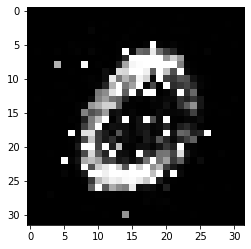

-------------------------------------


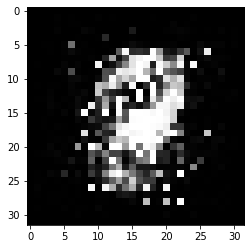

-------------------------------------


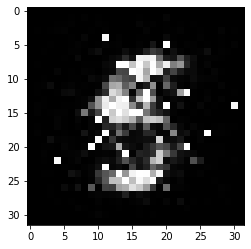

-------------------------------------


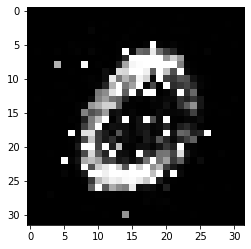

-------------------------------------


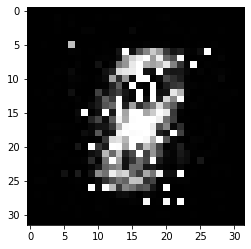

-------------------------------------


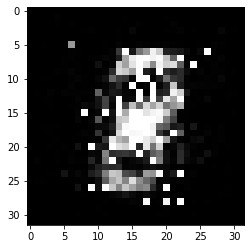

-------------------------------------


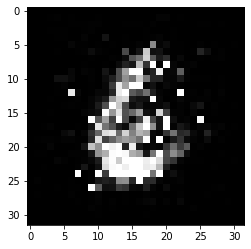

-------------------------------------


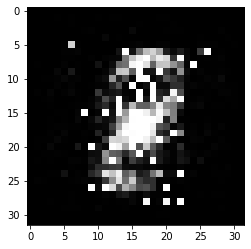

-------------------------------------


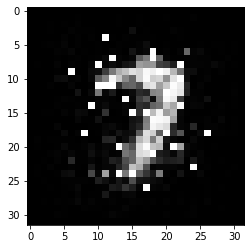

-------------------------------------


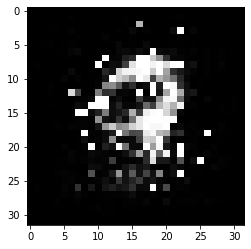

-------------------------------------


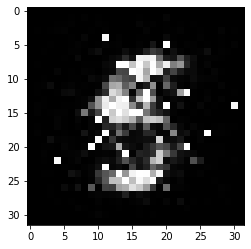

-------------------------------------


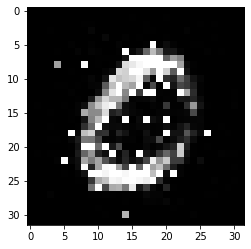

-------------------------------------


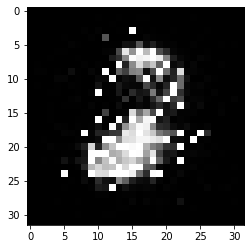

-------------------------------------


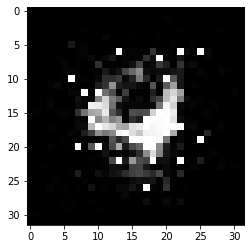

-------------------------------------


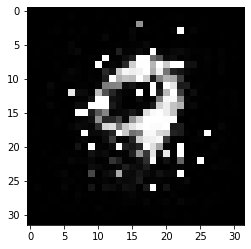

-------------------------------------


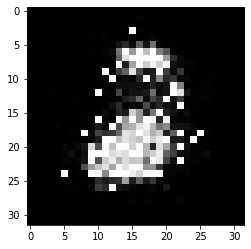

-------------------------------------


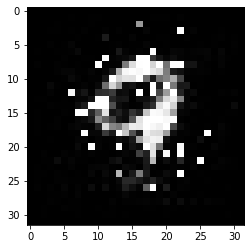

-------------------------------------


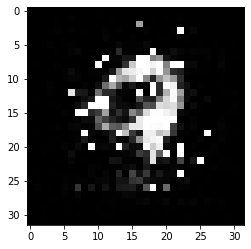

-------------------------------------


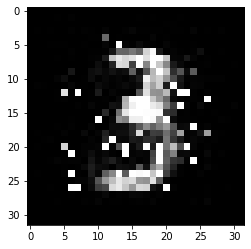

-------------------------------------


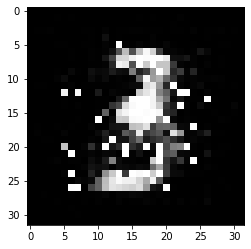

-------------------------------------


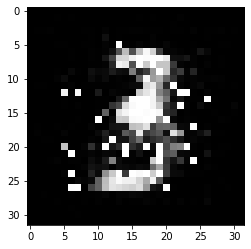

-------------------------------------


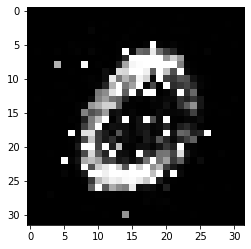

-------------------------------------


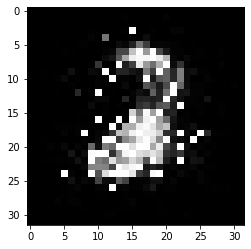

-------------------------------------


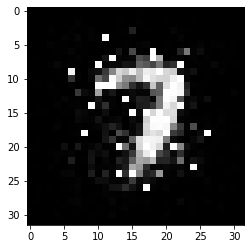

-------------------------------------


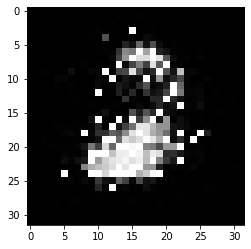

-------------------------------------


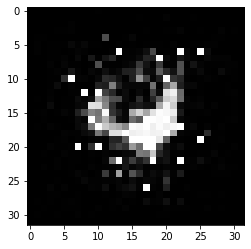

-------------------------------------


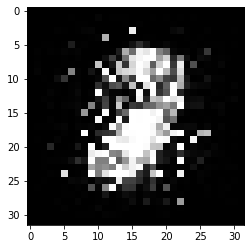

-------------------------------------


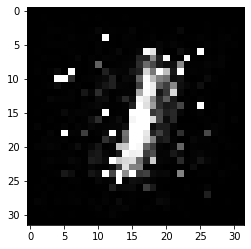

-------------------------------------


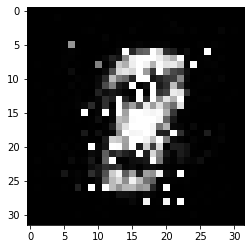

-------------------------------------


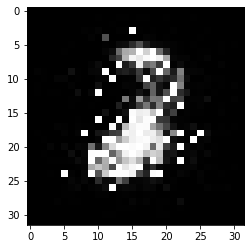

-------------------------------------


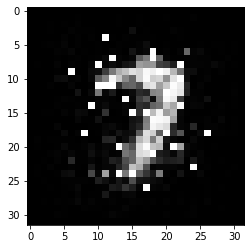

-------------------------------------


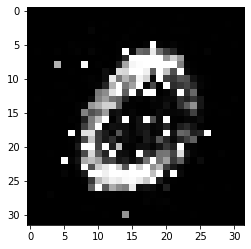

-------------------------------------


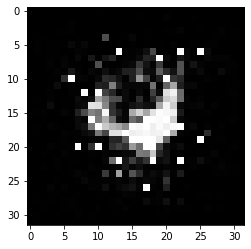

-------------------------------------


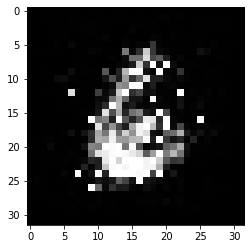

-------------------------------------


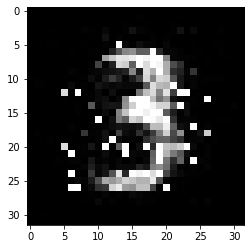

-------------------------------------


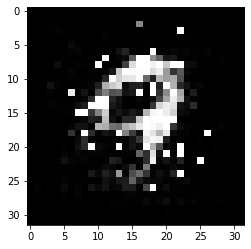

-------------------------------------


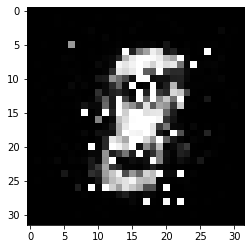

-------------------------------------


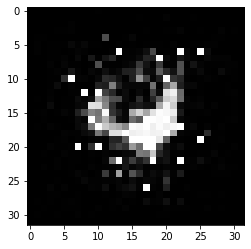

-------------------------------------


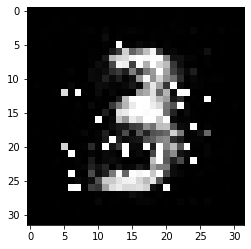

-------------------------------------


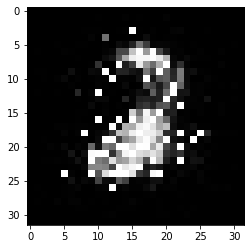

-------------------------------------


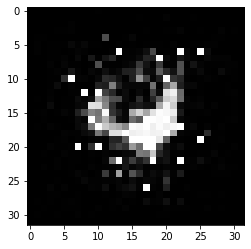

-------------------------------------


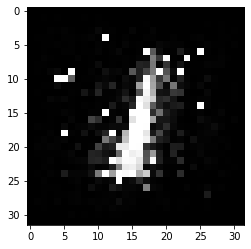

-------------------------------------


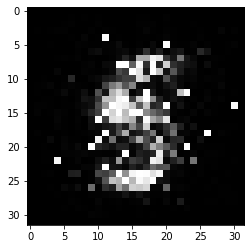

-------------------------------------


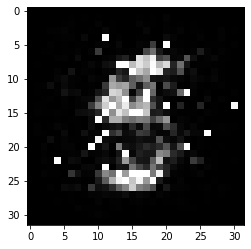

-------------------------------------


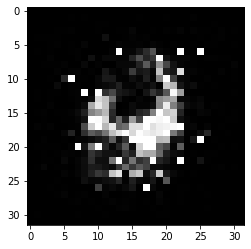

-------------------------------------


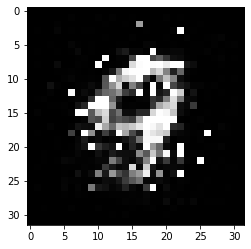

-------------------------------------


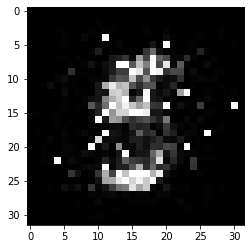

-------------------------------------


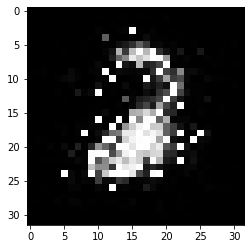

-------------------------------------


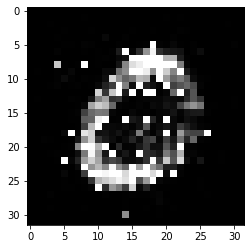

-------------------------------------


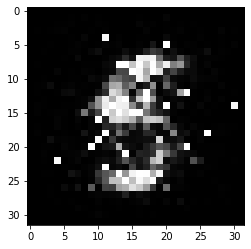

-------------------------------------


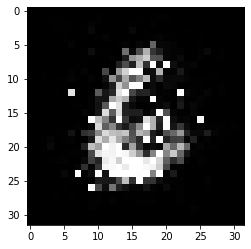

-------------------------------------


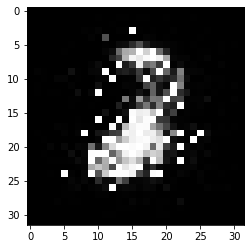

-------------------------------------


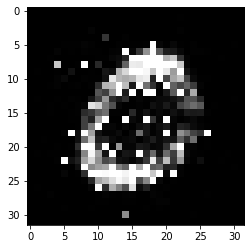

-------------------------------------


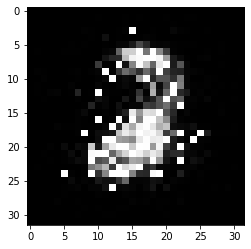

-------------------------------------


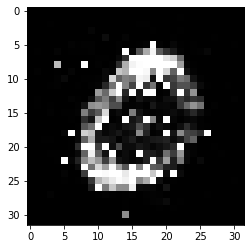

-------------------------------------


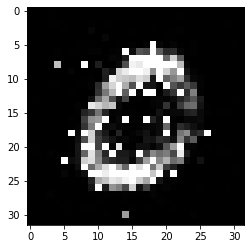

-------------------------------------


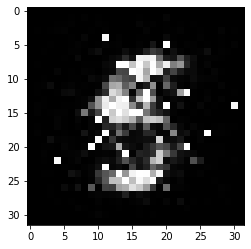

-------------------------------------


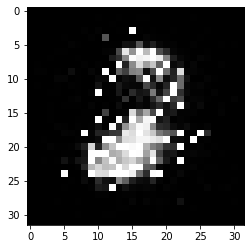

-------------------------------------


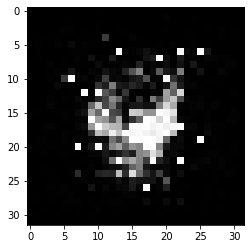

-------------------------------------


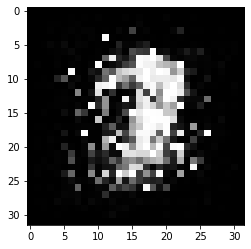

-------------------------------------


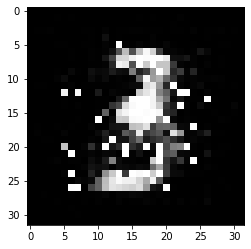

-------------------------------------


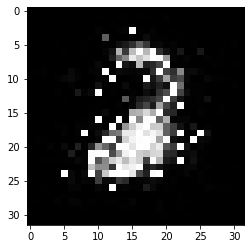

-------------------------------------


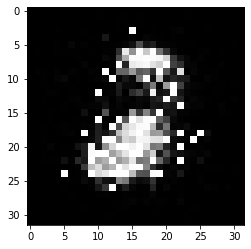

-------------------------------------


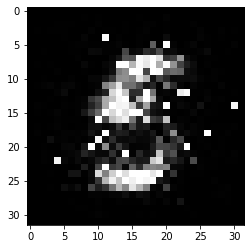

-------------------------------------


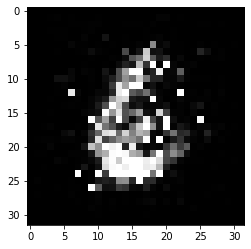

-------------------------------------


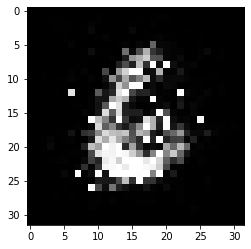

-------------------------------------


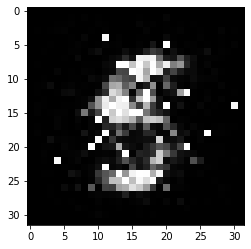

-------------------------------------


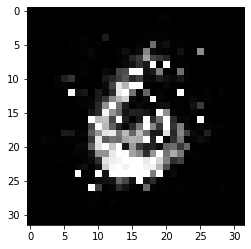

-------------------------------------


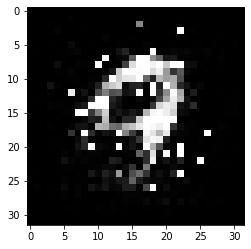

-------------------------------------


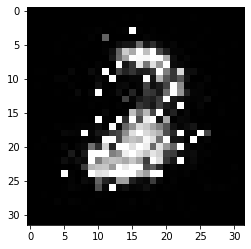

-------------------------------------


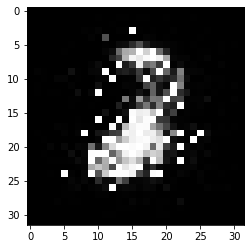

-------------------------------------


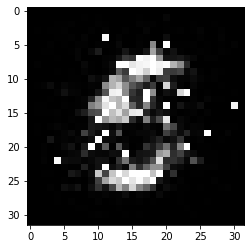

-------------------------------------


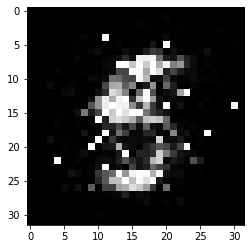

-------------------------------------


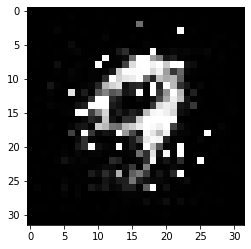

-------------------------------------


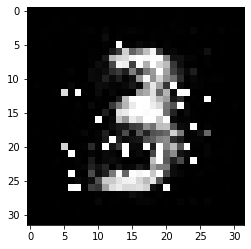

-------------------------------------


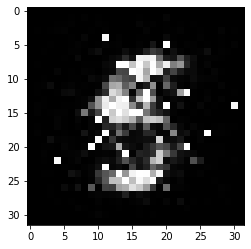

-------------------------------------


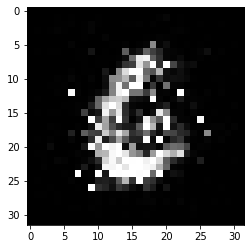

-------------------------------------


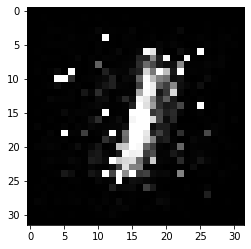

-------------------------------------


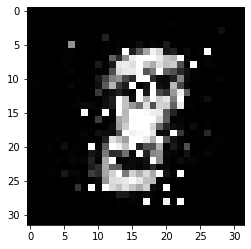

-------------------------------------


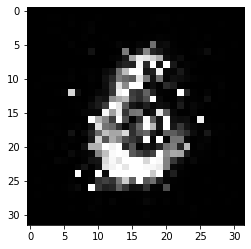

-------------------------------------


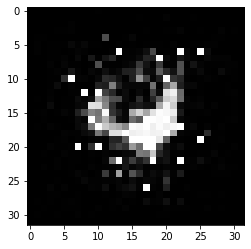

-------------------------------------


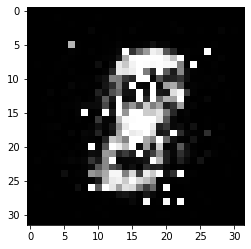

-------------------------------------


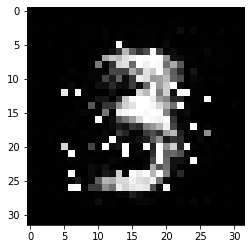

-------------------------------------


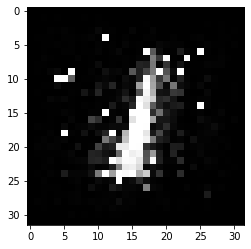

-------------------------------------


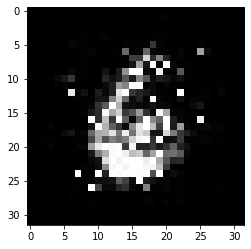

-------------------------------------


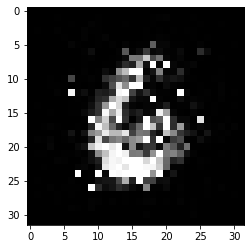

-------------------------------------


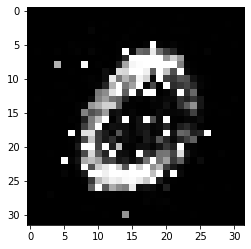

-------------------------------------


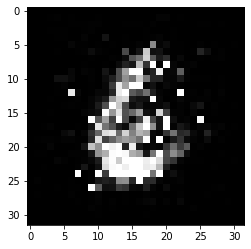

-------------------------------------


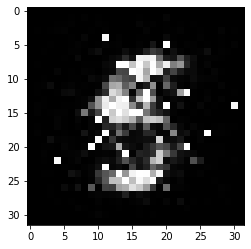

-------------------------------------


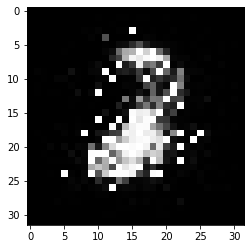

-------------------------------------


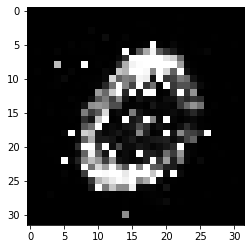

-------------------------------------


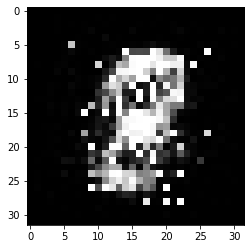

-------------------------------------


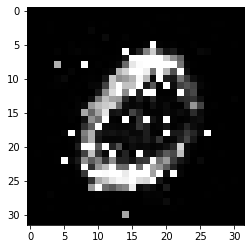

-------------------------------------


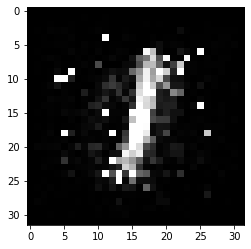

-------------------------------------


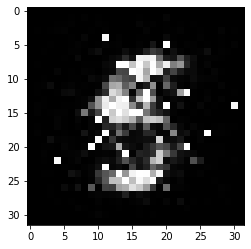

-------------------------------------


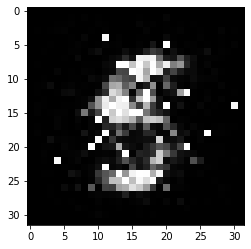

-------------------------------------


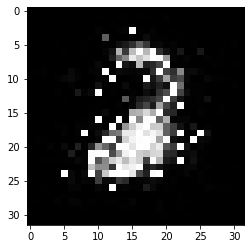

-------------------------------------


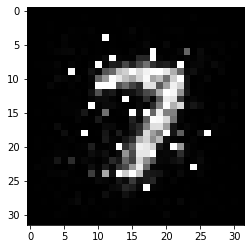

-------------------------------------


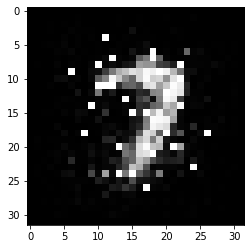

-------------------------------------


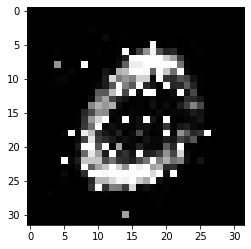

-------------------------------------


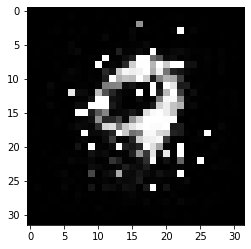

-------------------------------------


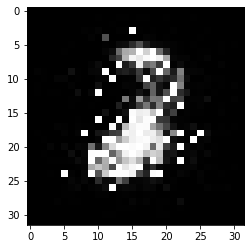

-------------------------------------


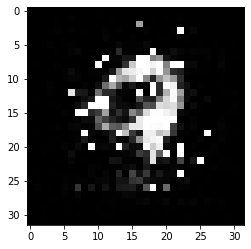

-------------------------------------


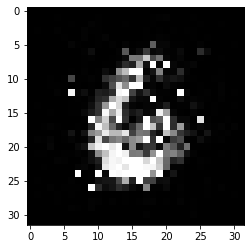

-------------------------------------


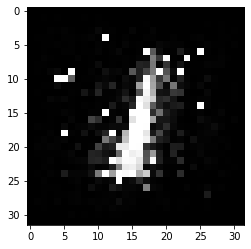

-------------------------------------


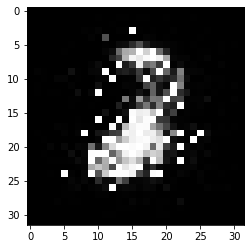

-------------------------------------


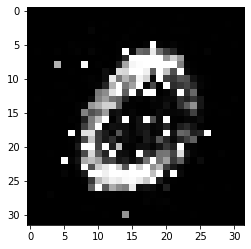

-------------------------------------


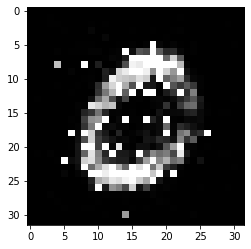

-------------------------------------


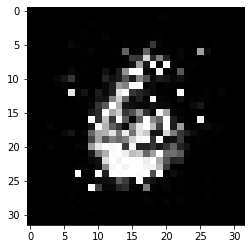

-------------------------------------


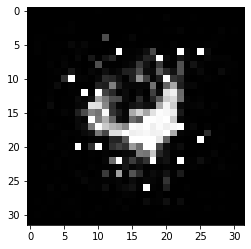

-------------------------------------


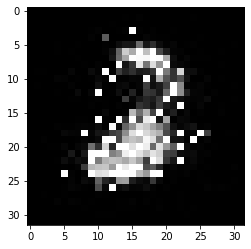

-------------------------------------


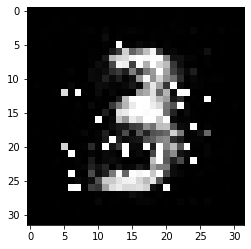

-------------------------------------


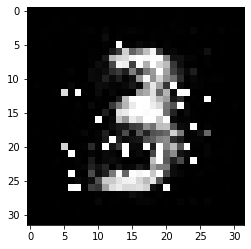

-------------------------------------


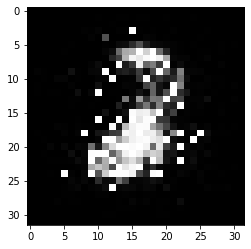

-------------------------------------


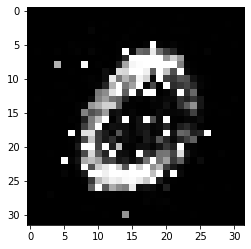

-------------------------------------


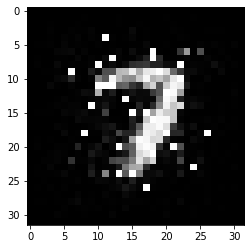

-------------------------------------


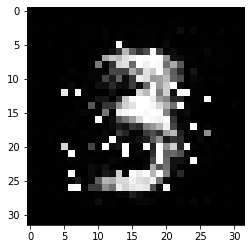

-------------------------------------


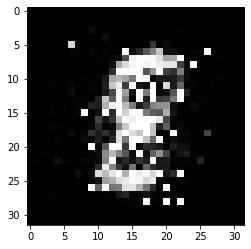

-------------------------------------


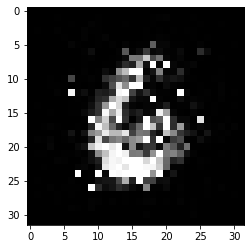

-------------------------------------


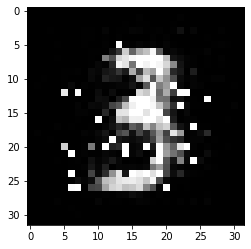

-------------------------------------


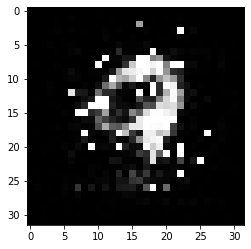

-------------------------------------


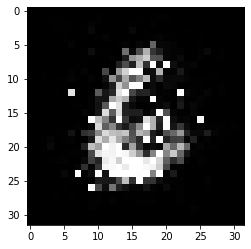

-------------------------------------


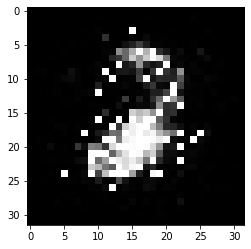

-------------------------------------


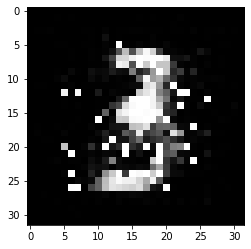

-------------------------------------


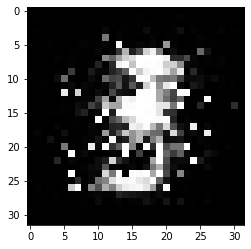

-------------------------------------


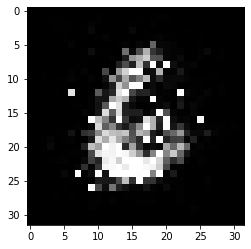

-------------------------------------


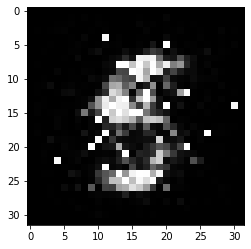

-------------------------------------


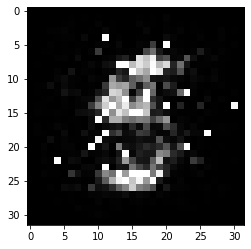

-------------------------------------


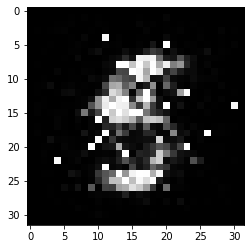

-------------------------------------


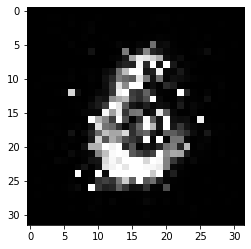

-------------------------------------


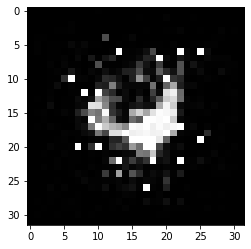

-------------------------------------


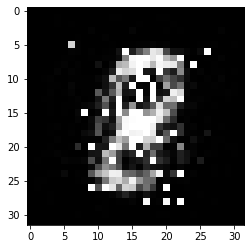

-------------------------------------


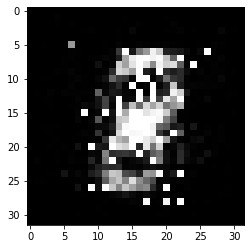

-------------------------------------


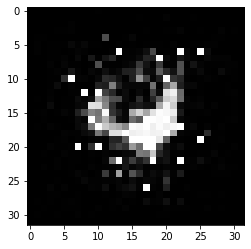

-------------------------------------


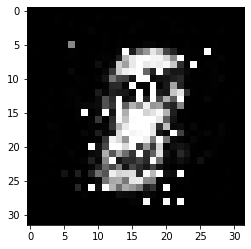

-------------------------------------


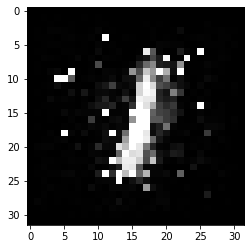

-------------------------------------


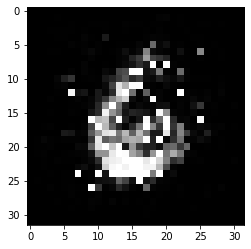

-------------------------------------


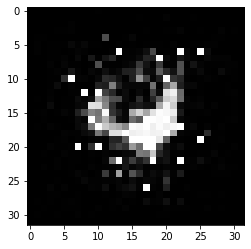

-------------------------------------


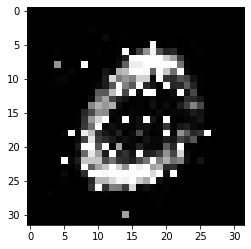

-------------------------------------


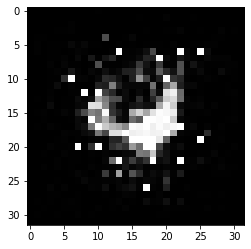

-------------------------------------


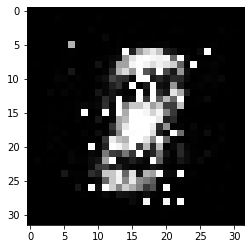

-------------------------------------


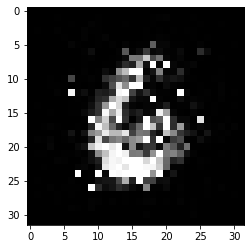

-------------------------------------


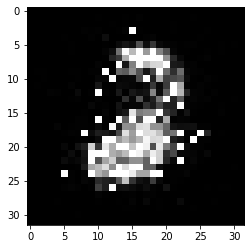

-------------------------------------


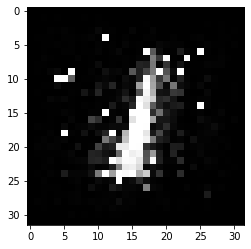

-------------------------------------


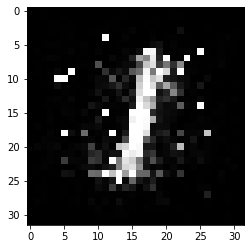

-------------------------------------


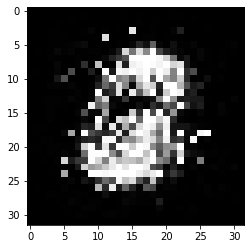

-------------------------------------


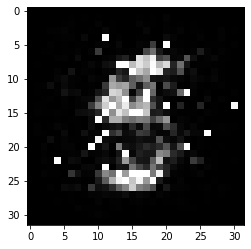

-------------------------------------


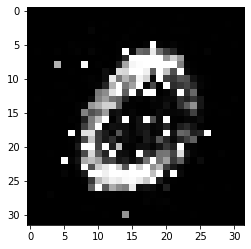

-------------------------------------


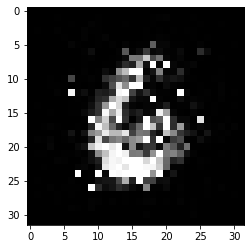

-------------------------------------


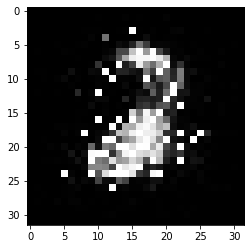

-------------------------------------


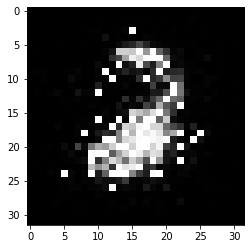

-------------------------------------


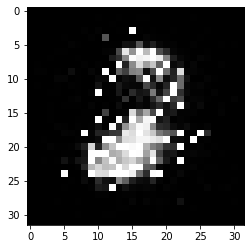

-------------------------------------


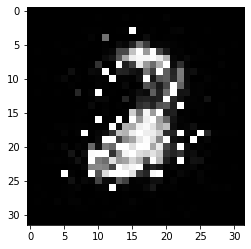

-------------------------------------


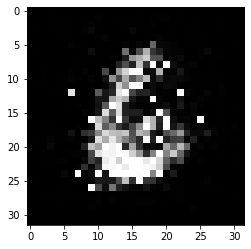

-------------------------------------


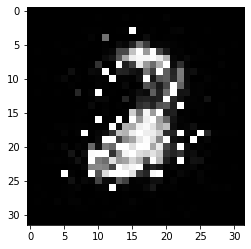

-------------------------------------


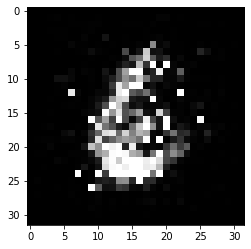

-------------------------------------


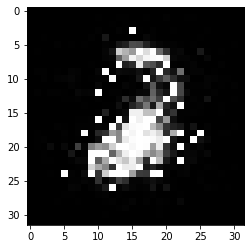

-------------------------------------


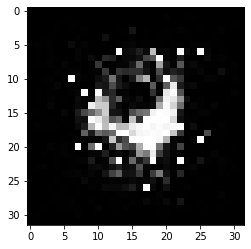

-------------------------------------


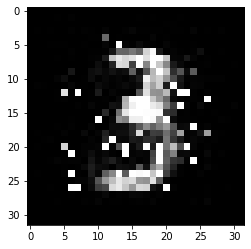

-------------------------------------


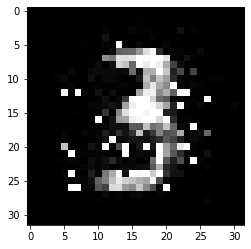

-------------------------------------


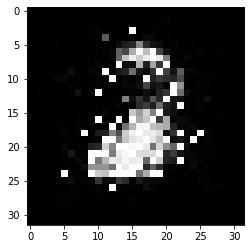

-------------------------------------


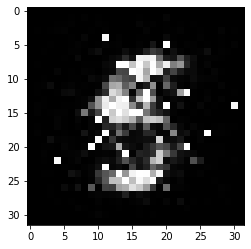

-------------------------------------


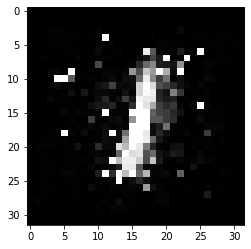

-------------------------------------


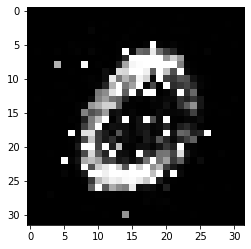

-------------------------------------


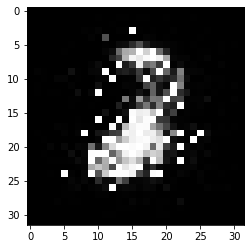

-------------------------------------


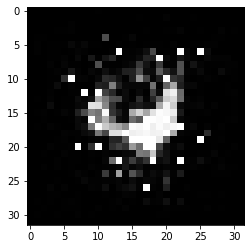

-------------------------------------


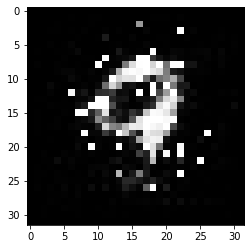

-------------------------------------


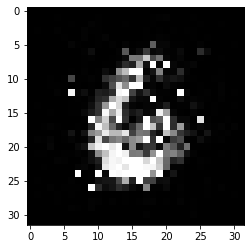

-------------------------------------


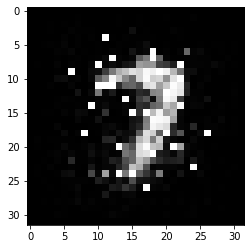

-------------------------------------


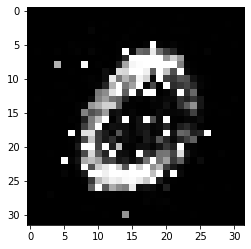

-------------------------------------


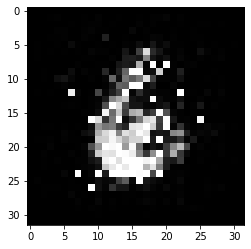

-------------------------------------


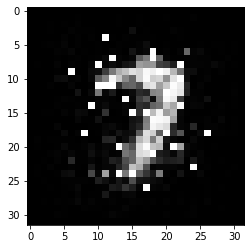

-------------------------------------


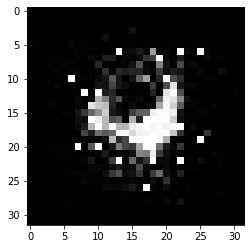

-------------------------------------


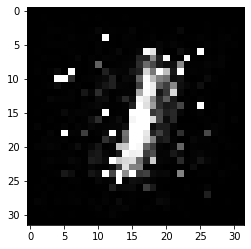

-------------------------------------


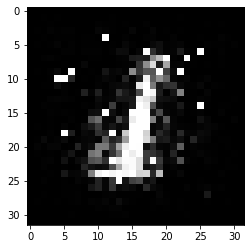

-------------------------------------


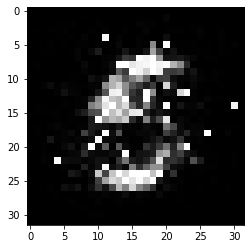

-------------------------------------


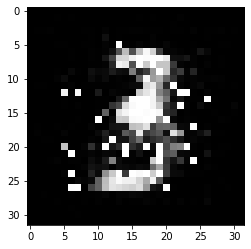

-------------------------------------


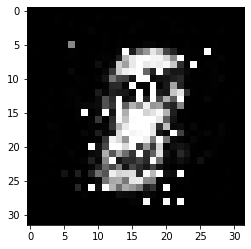

-------------------------------------


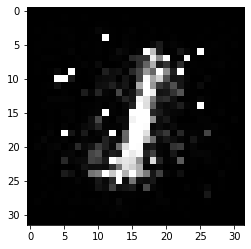

-------------------------------------


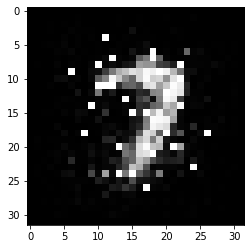

-------------------------------------


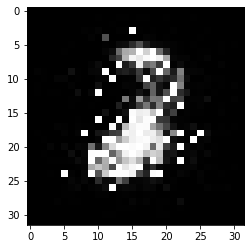

-------------------------------------


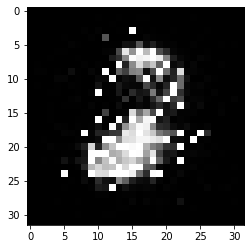

-------------------------------------


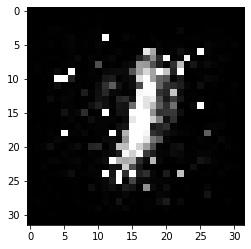

-------------------------------------


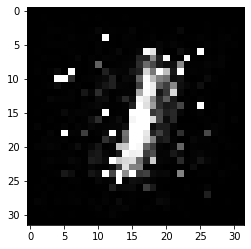

-------------------------------------


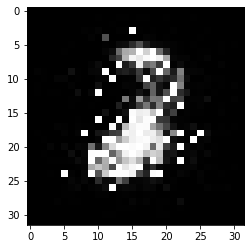

-------------------------------------


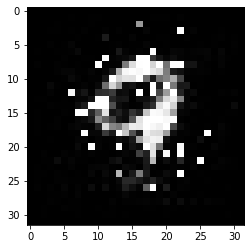

-------------------------------------


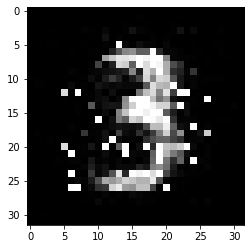

-------------------------------------


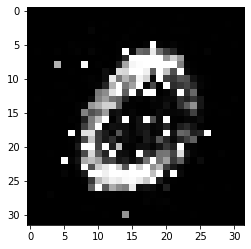

-------------------------------------


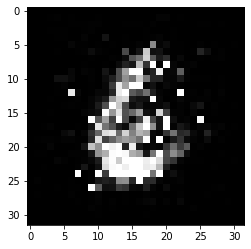

-------------------------------------


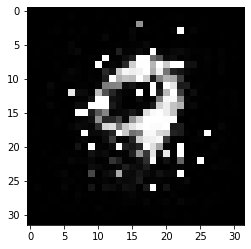

-------------------------------------


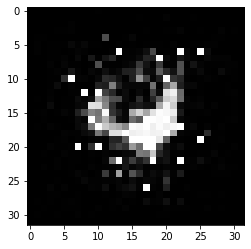

-------------------------------------


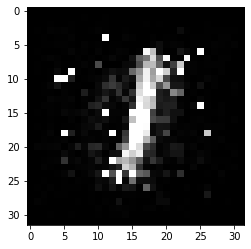

-------------------------------------


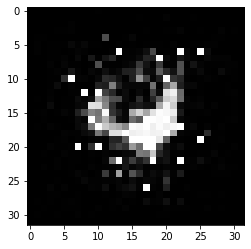

-------------------------------------


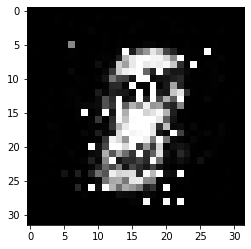

-------------------------------------


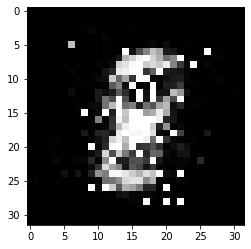

-------------------------------------


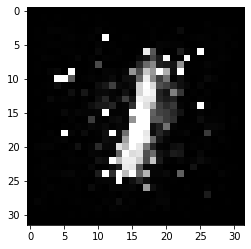

-------------------------------------


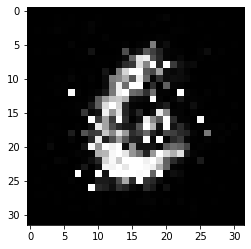

-------------------------------------


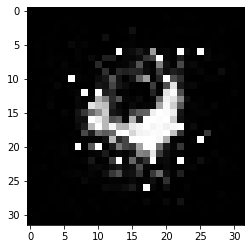

-------------------------------------


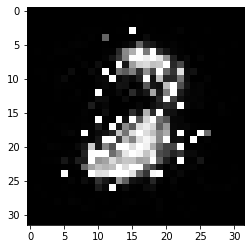

-------------------------------------


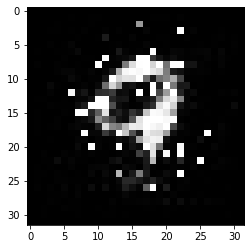

-------------------------------------


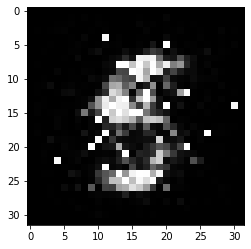

-------------------------------------


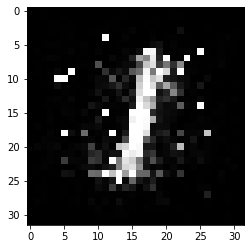

-------------------------------------


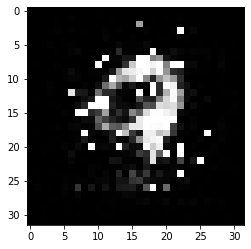

-------------------------------------


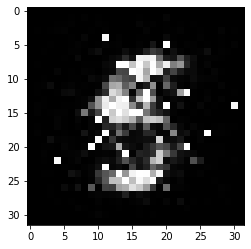

-------------------------------------


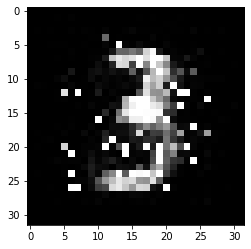

-------------------------------------


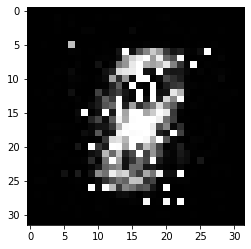

-------------------------------------


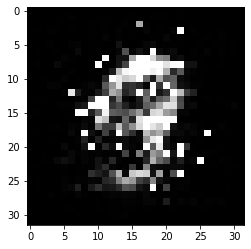

-------------------------------------


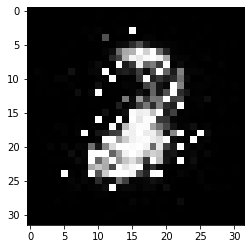

-------------------------------------


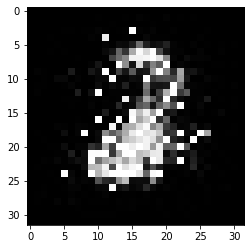

-------------------------------------


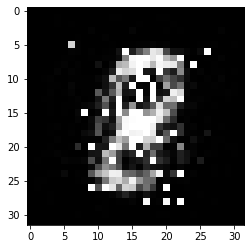

-------------------------------------


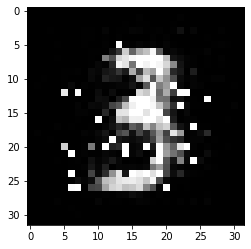

-------------------------------------


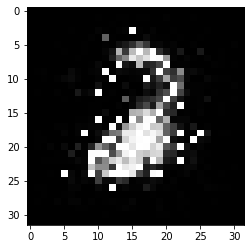

-------------------------------------


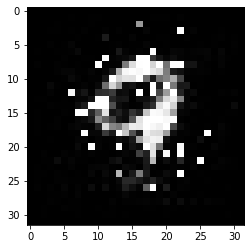

-------------------------------------


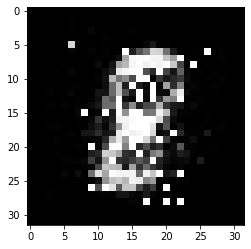

-------------------------------------


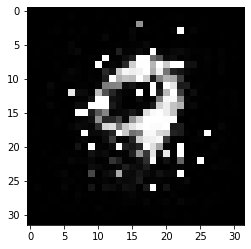

-------------------------------------


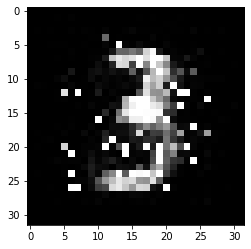

-------------------------------------


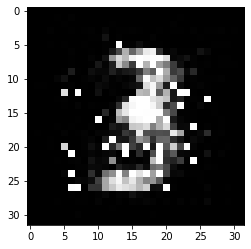

-------------------------------------


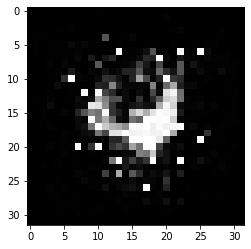

-------------------------------------


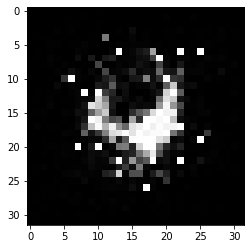

-------------------------------------


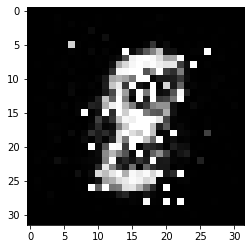

-------------------------------------


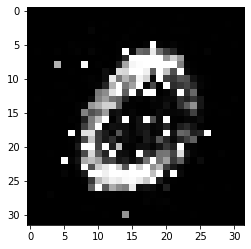

-------------------------------------


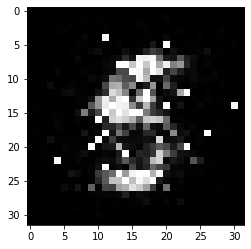

-------------------------------------


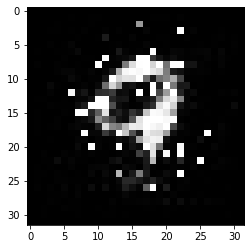

-------------------------------------


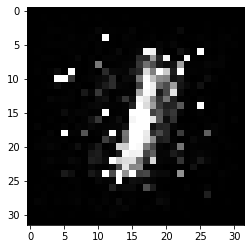

-------------------------------------


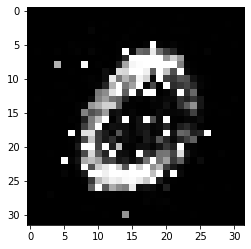

-------------------------------------


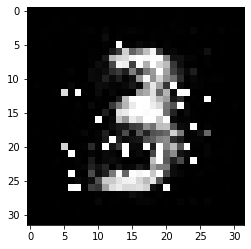

-------------------------------------


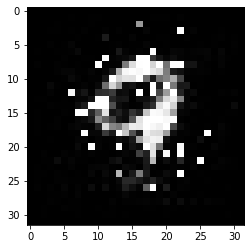

-------------------------------------


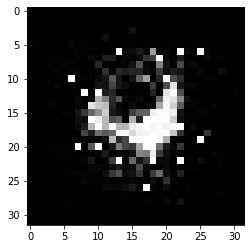

-------------------------------------


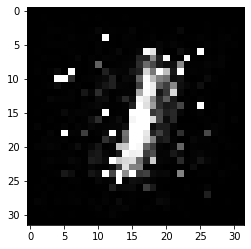

-------------------------------------


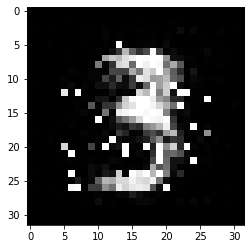

-------------------------------------


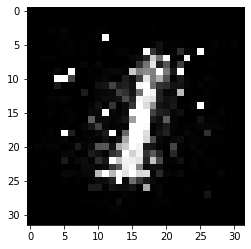

-------------------------------------


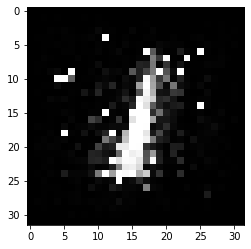

-------------------------------------


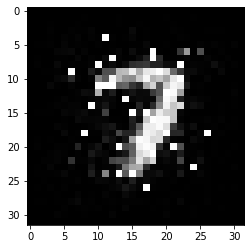

-------------------------------------


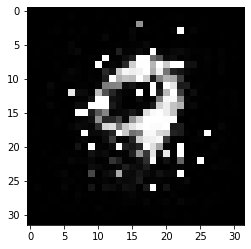

-------------------------------------


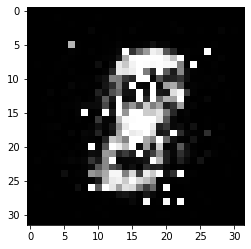

-------------------------------------


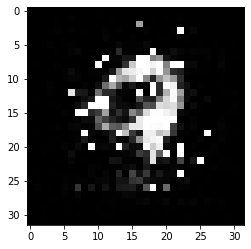

-------------------------------------


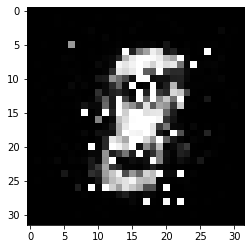

-------------------------------------


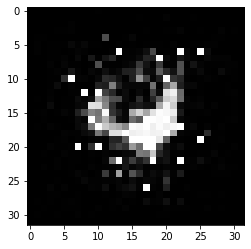

-------------------------------------


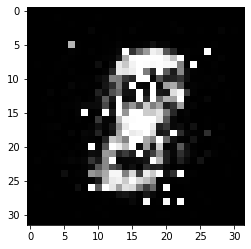

-------------------------------------


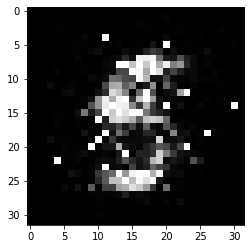

-------------------------------------


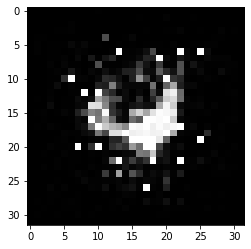

-------------------------------------


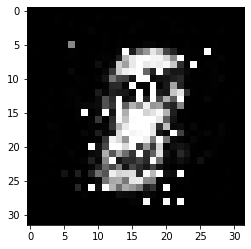

-------------------------------------


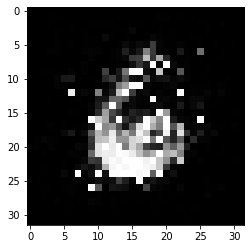

-------------------------------------


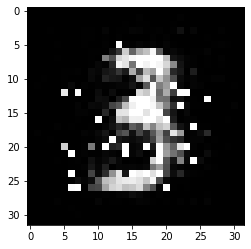

-------------------------------------


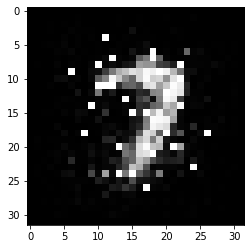

-------------------------------------


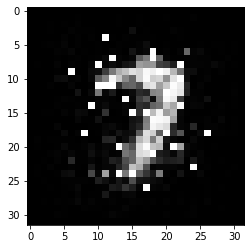

-------------------------------------


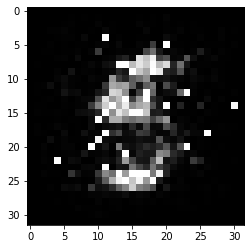

-------------------------------------


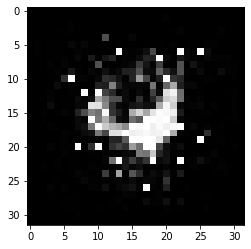

-------------------------------------


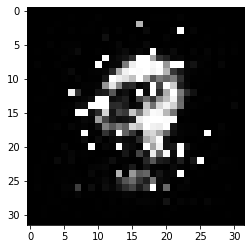

-------------------------------------


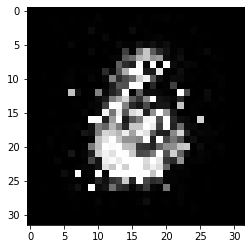

-------------------------------------


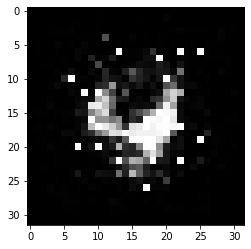

-------------------------------------


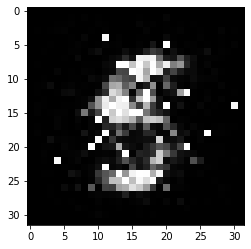

-------------------------------------


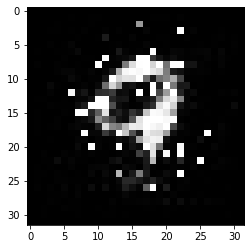

-------------------------------------


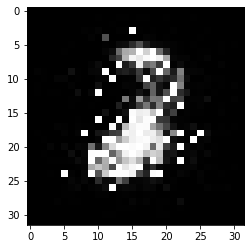

-------------------------------------


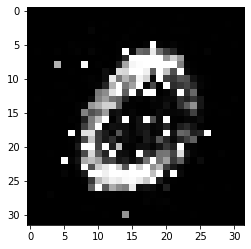

-------------------------------------


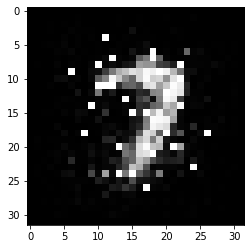

-------------------------------------


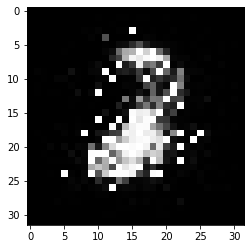

-------------------------------------


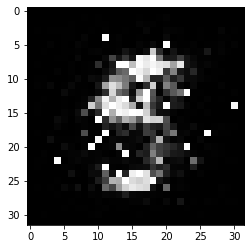

-------------------------------------


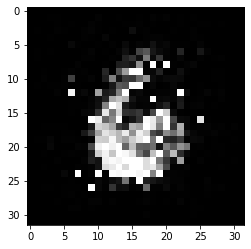

-------------------------------------


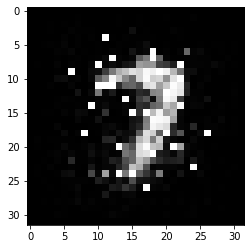

-------------------------------------


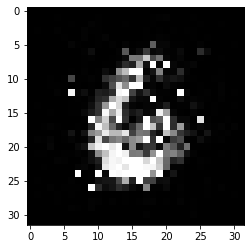

-------------------------------------


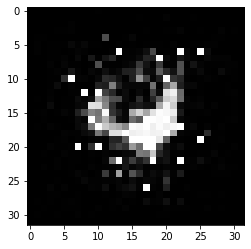

-------------------------------------


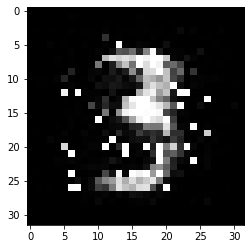

-------------------------------------


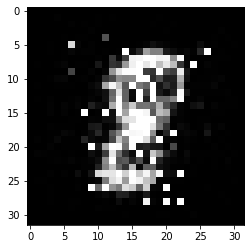

-------------------------------------


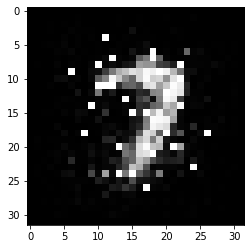

-------------------------------------


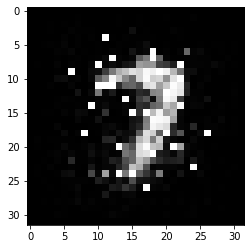

-------------------------------------


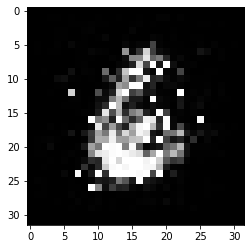

-------------------------------------


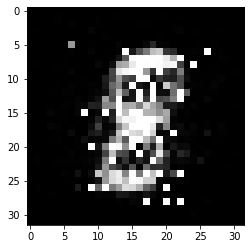

-------------------------------------


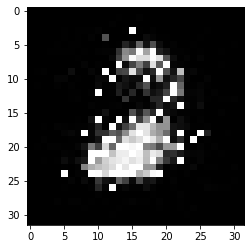

-------------------------------------


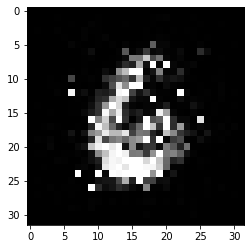

-------------------------------------


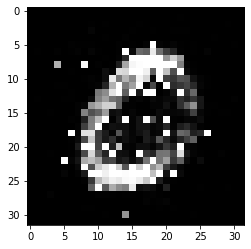

-------------------------------------


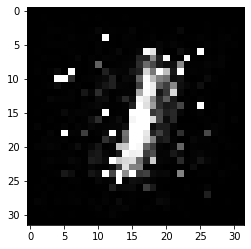

-------------------------------------


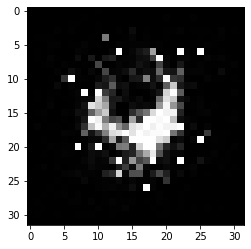

-------------------------------------


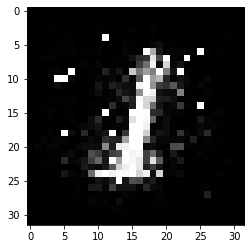

-------------------------------------


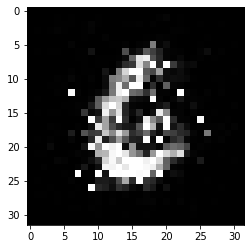

-------------------------------------


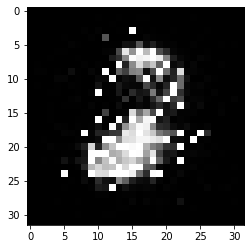

-------------------------------------


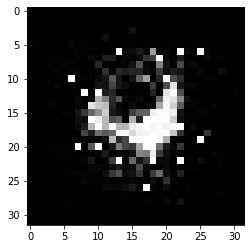

-------------------------------------


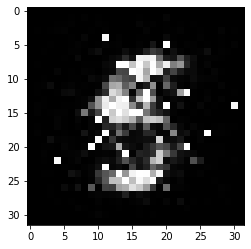

-------------------------------------


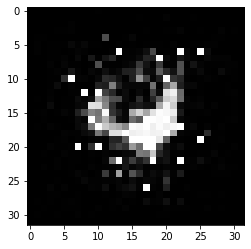

-------------------------------------


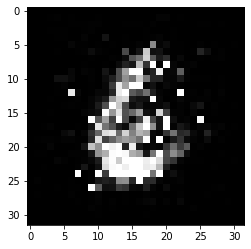

-------------------------------------


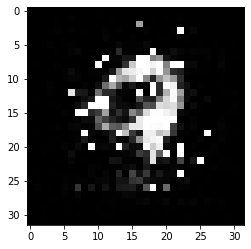

-------------------------------------


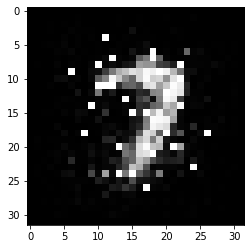

-------------------------------------


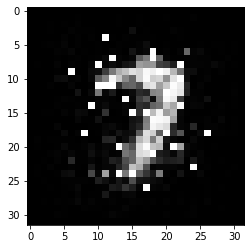

-------------------------------------


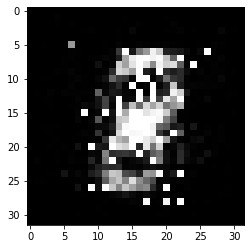

-------------------------------------


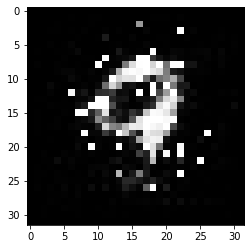

-------------------------------------


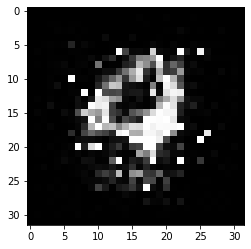

-------------------------------------


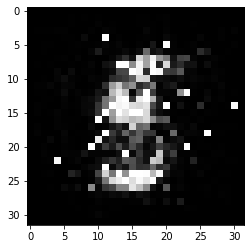

-------------------------------------


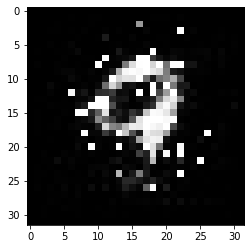

-------------------------------------


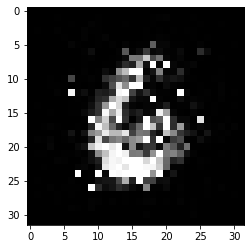

-------------------------------------


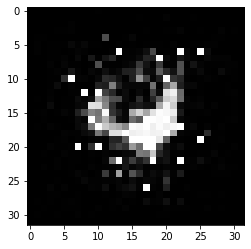

-------------------------------------


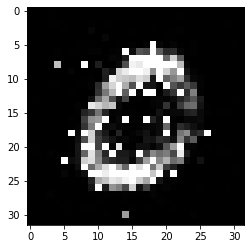

-------------------------------------


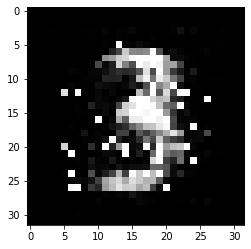

-------------------------------------


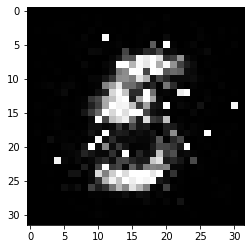

-------------------------------------


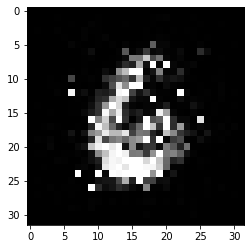

-------------------------------------


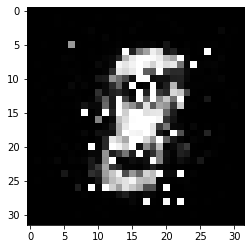

-------------------------------------


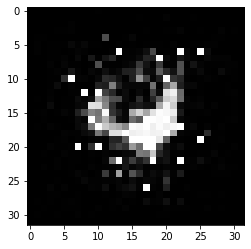

-------------------------------------


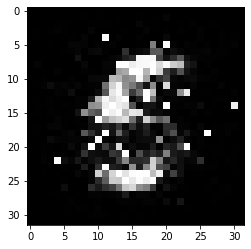

-------------------------------------


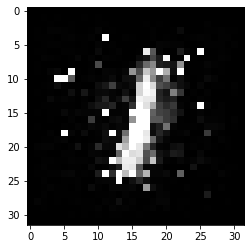

-------------------------------------


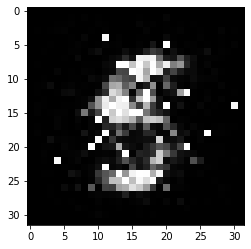

-------------------------------------


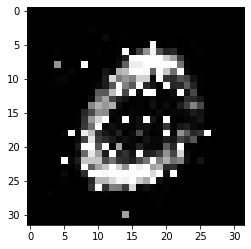

-------------------------------------


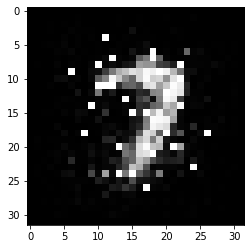

-------------------------------------


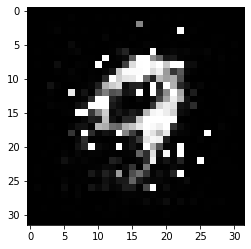

-------------------------------------


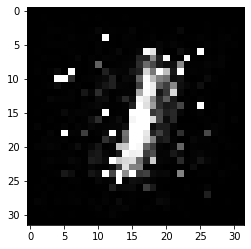

-------------------------------------


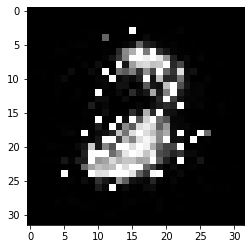

-------------------------------------


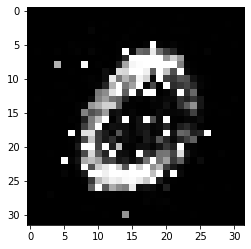

-------------------------------------


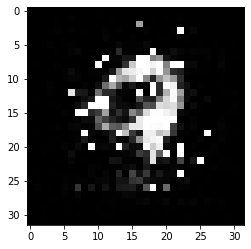

-------------------------------------


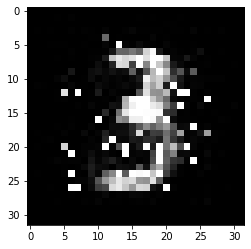

-------------------------------------


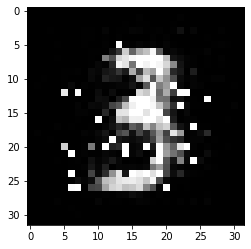

-------------------------------------


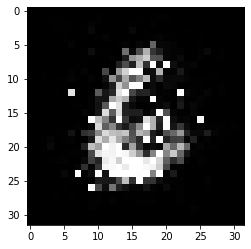

-------------------------------------


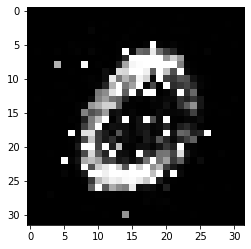

-------------------------------------


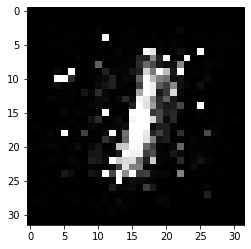

-------------------------------------


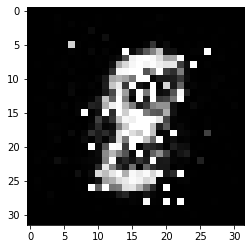

-------------------------------------


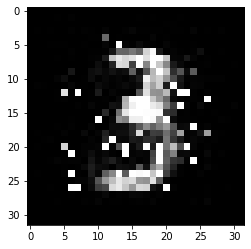

-------------------------------------


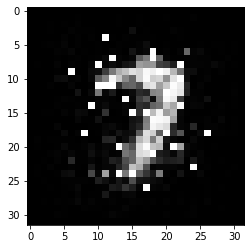

-------------------------------------


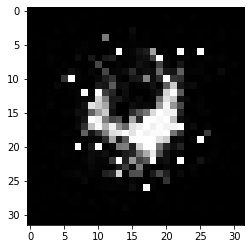

-------------------------------------


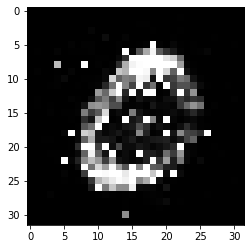

-------------------------------------


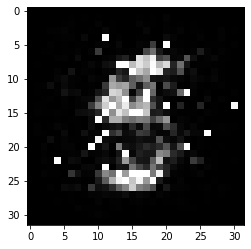

-------------------------------------


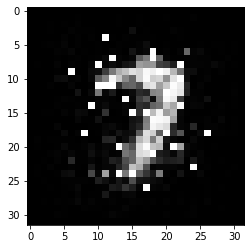

-------------------------------------


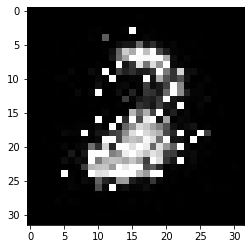

-------------------------------------


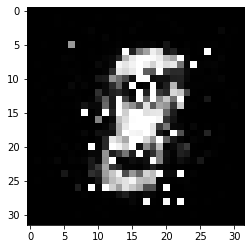

-------------------------------------


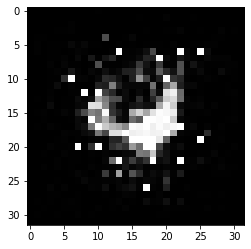

-------------------------------------


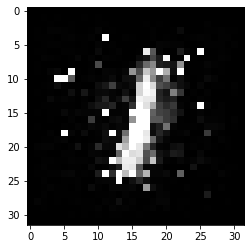

-------------------------------------


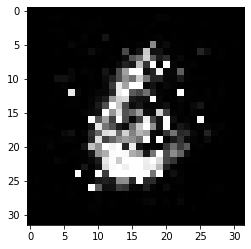

-------------------------------------


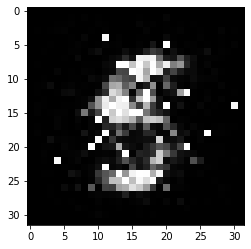

-------------------------------------


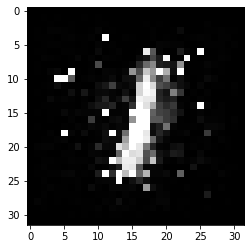

-------------------------------------


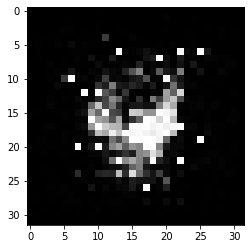

-------------------------------------


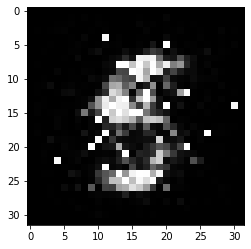

-------------------------------------


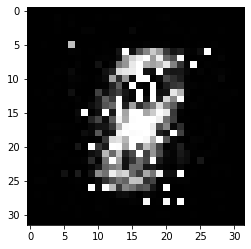

-------------------------------------


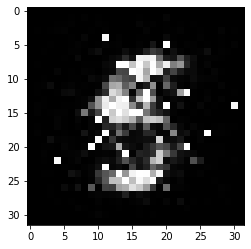

-------------------------------------


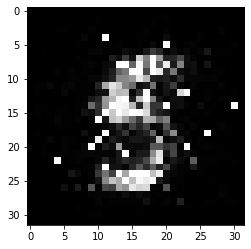

-------------------------------------


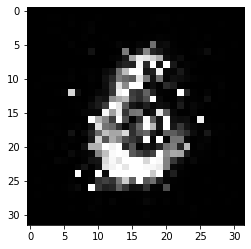

-------------------------------------


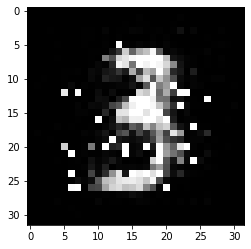

-------------------------------------


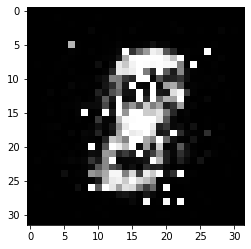

-------------------------------------


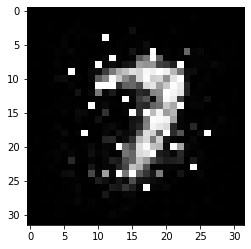

-------------------------------------


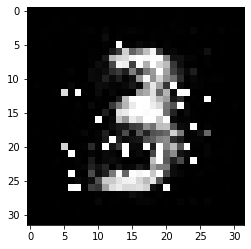

-------------------------------------


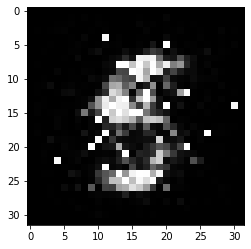

-------------------------------------


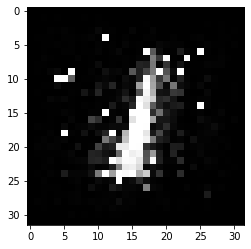

-------------------------------------


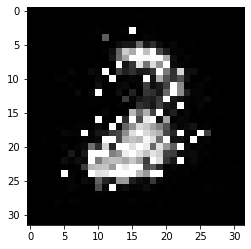

-------------------------------------


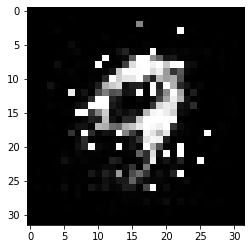

-------------------------------------


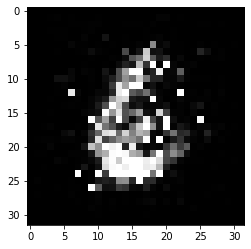

-------------------------------------


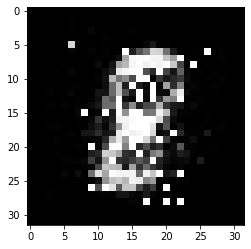

-------------------------------------


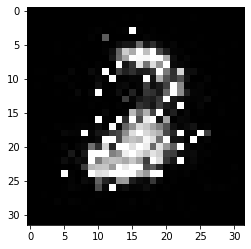

-------------------------------------


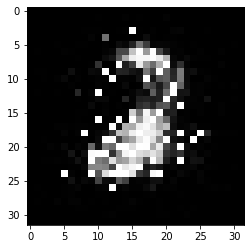

-------------------------------------


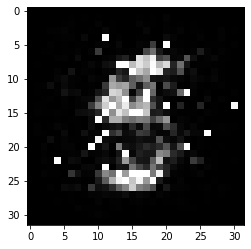

-------------------------------------


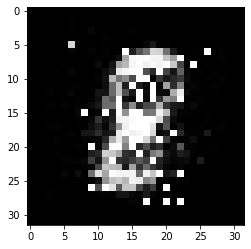

-------------------------------------


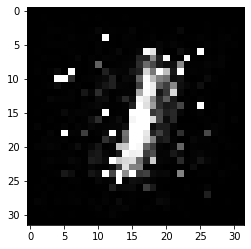

-------------------------------------


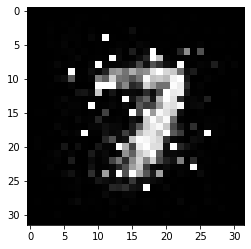

-------------------------------------


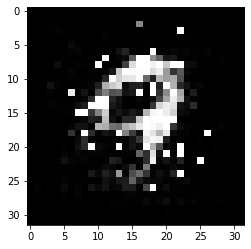

-------------------------------------


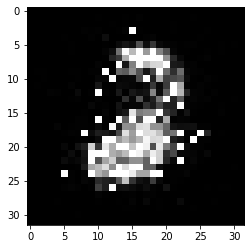

-------------------------------------


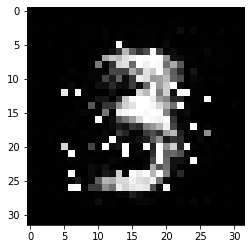

-------------------------------------


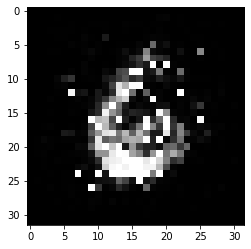

-------------------------------------


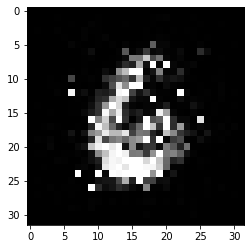

-------------------------------------


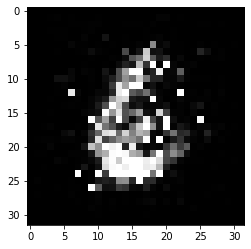

-------------------------------------


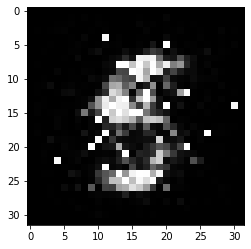

-------------------------------------


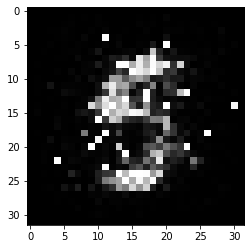

-------------------------------------


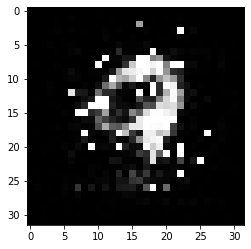

-------------------------------------


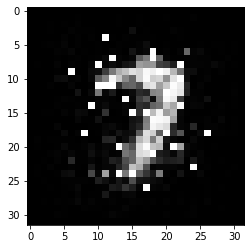

-------------------------------------


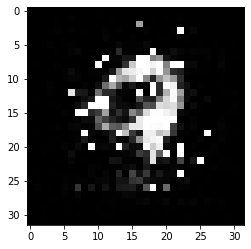

-------------------------------------


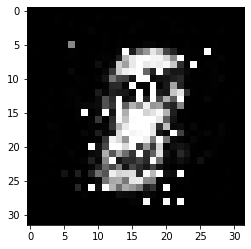

-------------------------------------


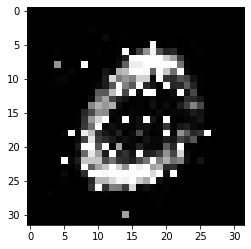

-------------------------------------


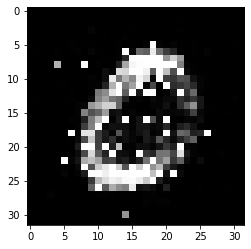

-------------------------------------


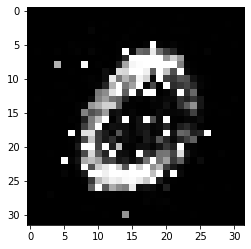

-------------------------------------


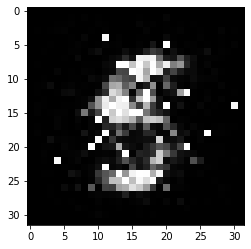

-------------------------------------


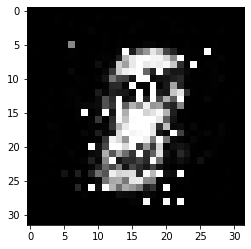

-------------------------------------


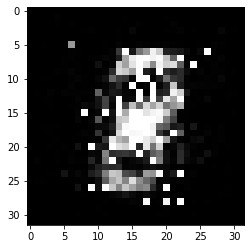

-------------------------------------


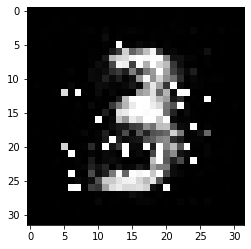

-------------------------------------


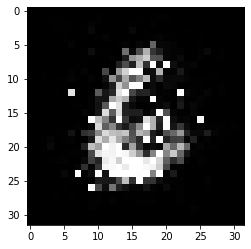

-------------------------------------


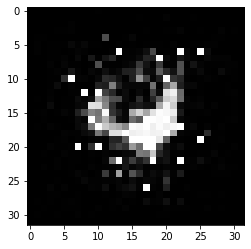

-------------------------------------


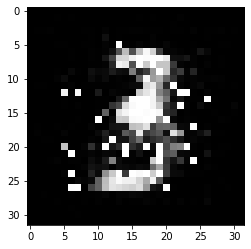

-------------------------------------


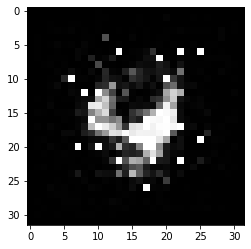

-------------------------------------


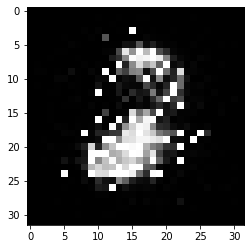

-------------------------------------


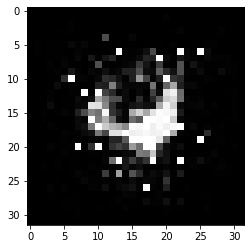

-------------------------------------


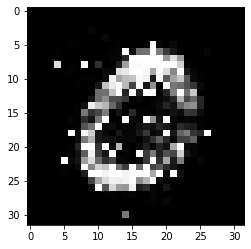

-------------------------------------


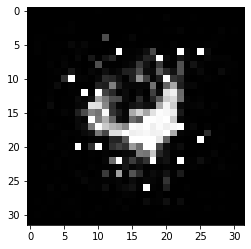

-------------------------------------


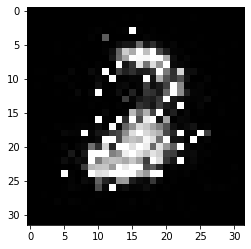

-------------------------------------


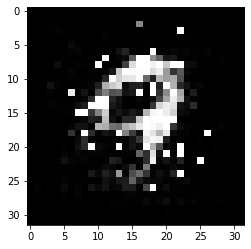

-------------------------------------


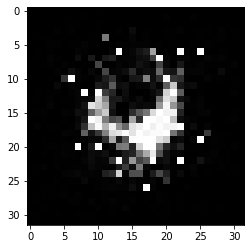

-------------------------------------


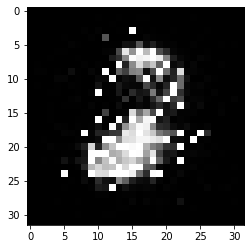

-------------------------------------


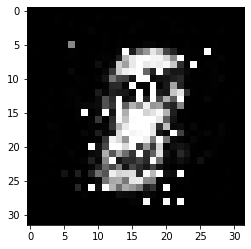

-------------------------------------


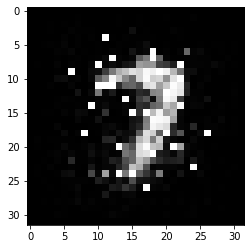

-------------------------------------


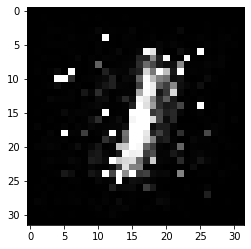

-------------------------------------


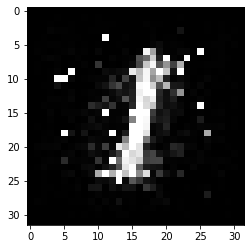

-------------------------------------


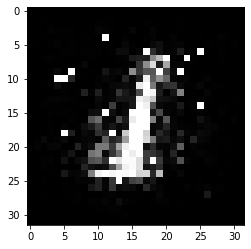

-------------------------------------


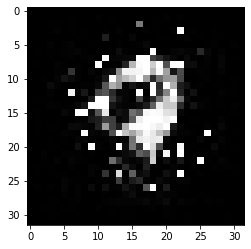

-------------------------------------


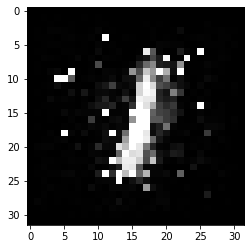

-------------------------------------


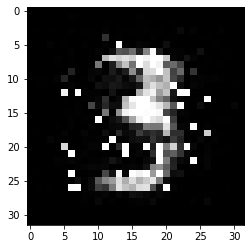

-------------------------------------


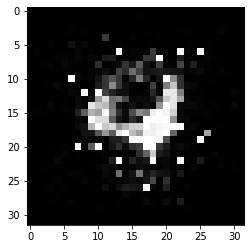

-------------------------------------


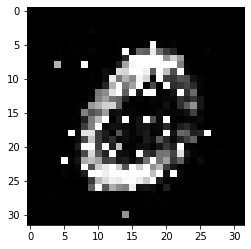

-------------------------------------


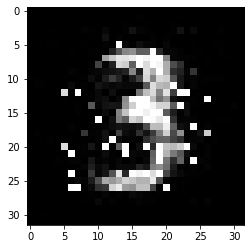

-------------------------------------


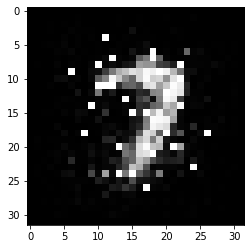

-------------------------------------


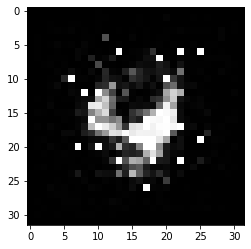

-------------------------------------


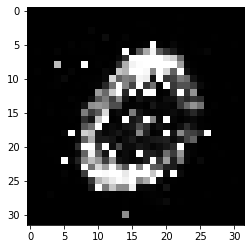

-------------------------------------


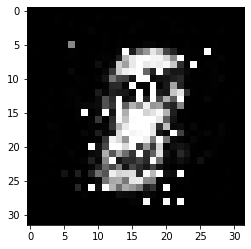

-------------------------------------


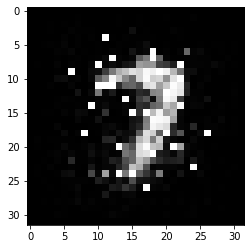

-------------------------------------


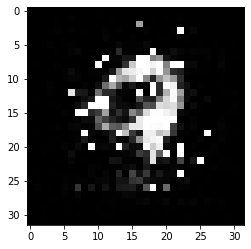

-------------------------------------


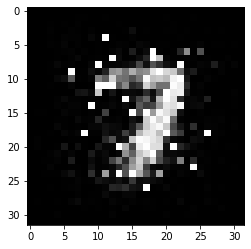

-------------------------------------


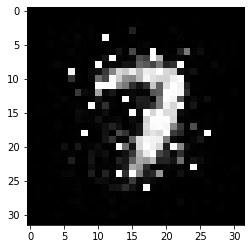

-------------------------------------


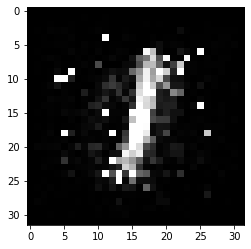

-------------------------------------


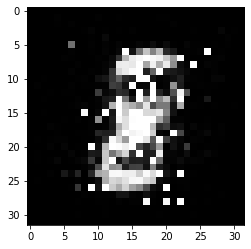

-------------------------------------


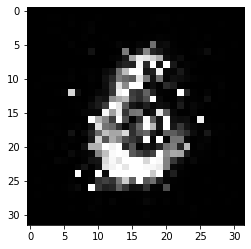

-------------------------------------


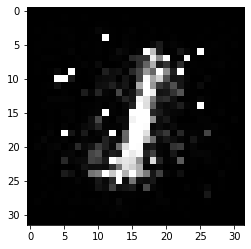

-------------------------------------


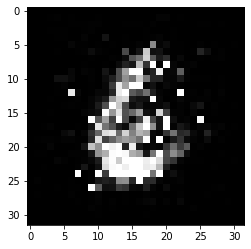

-------------------------------------


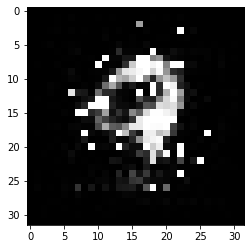

-------------------------------------


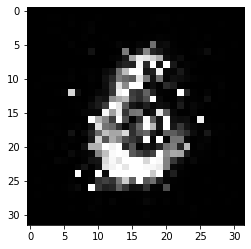

-------------------------------------


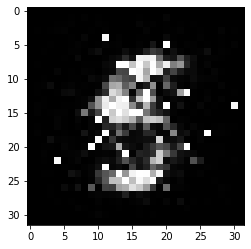

-------------------------------------


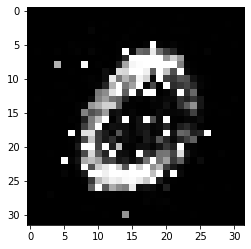

-------------------------------------


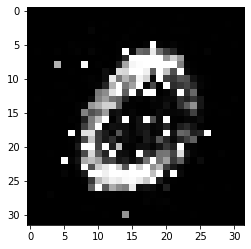

-------------------------------------


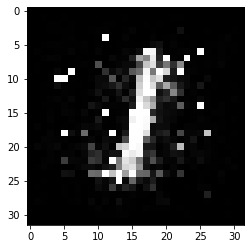

-------------------------------------


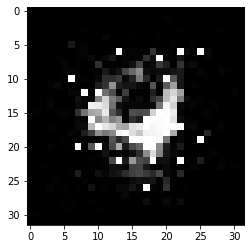

-------------------------------------


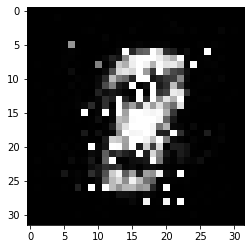

-------------------------------------


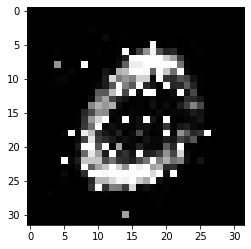

-------------------------------------


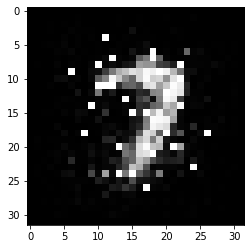

-------------------------------------


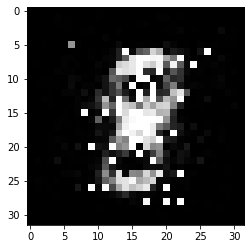

-------------------------------------


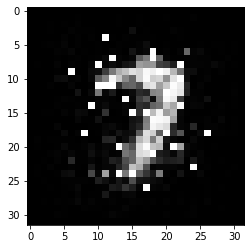

-------------------------------------


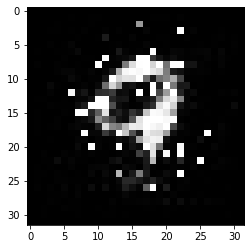

-------------------------------------


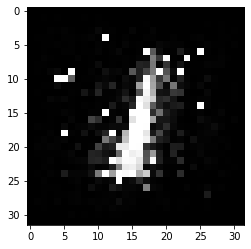

-------------------------------------


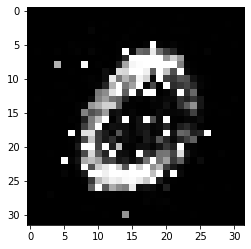

-------------------------------------


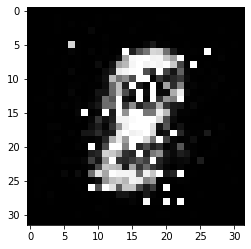

-------------------------------------


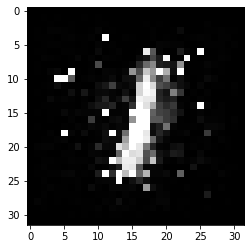

-------------------------------------


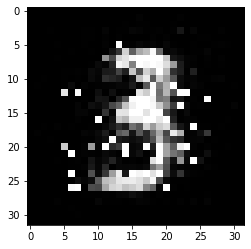

-------------------------------------


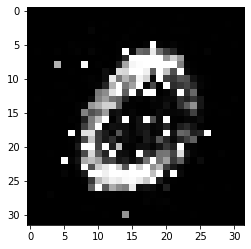

-------------------------------------


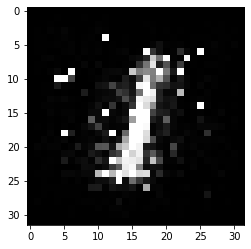

-------------------------------------


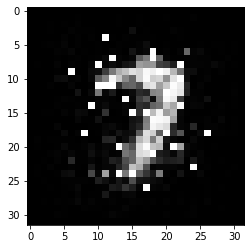

-------------------------------------


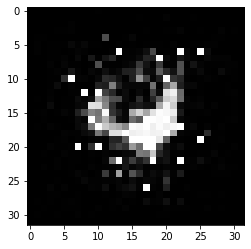

-------------------------------------


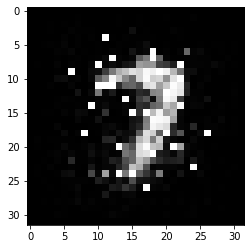

-------------------------------------


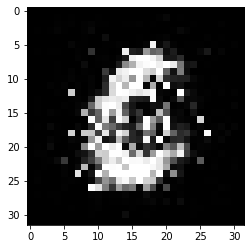

-------------------------------------


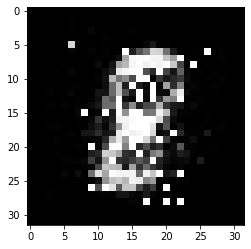

-------------------------------------


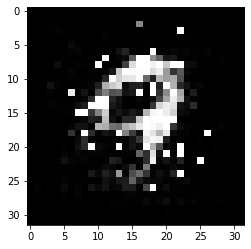

-------------------------------------


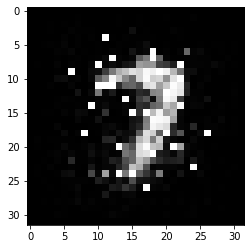

-------------------------------------


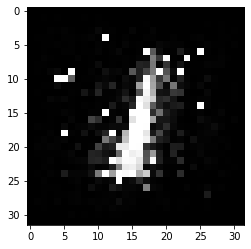

-------------------------------------


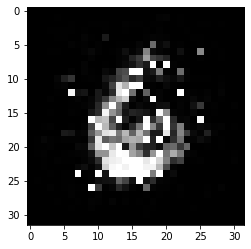

-------------------------------------


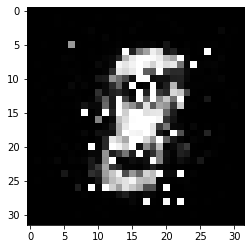

-------------------------------------


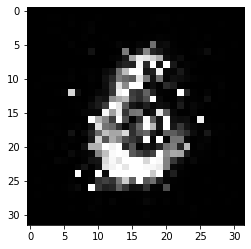

-------------------------------------


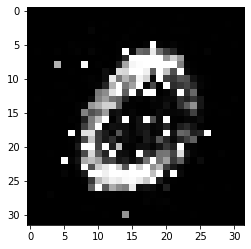

-------------------------------------


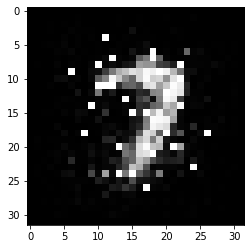

-------------------------------------


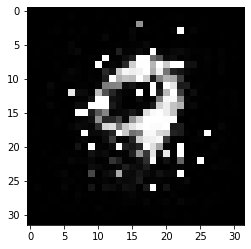

-------------------------------------


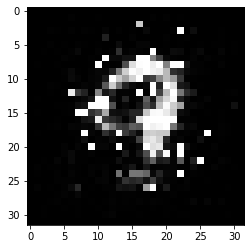

-------------------------------------


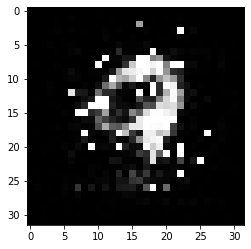

-------------------------------------


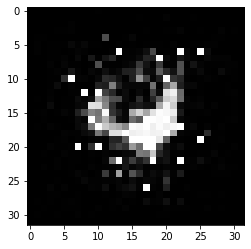

-------------------------------------


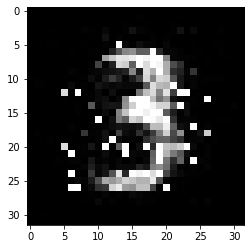

-------------------------------------


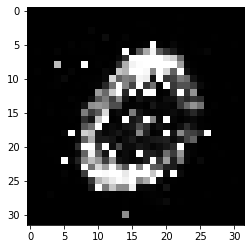

-------------------------------------


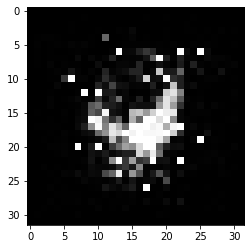

-------------------------------------


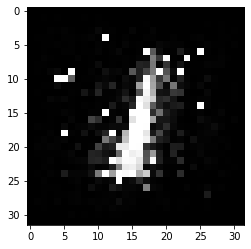

-------------------------------------


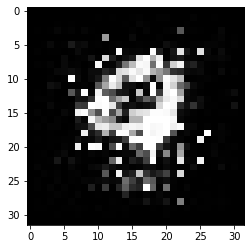

-------------------------------------


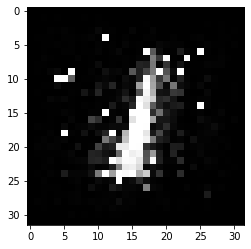

-------------------------------------


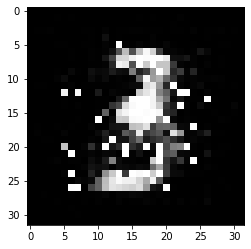

-------------------------------------


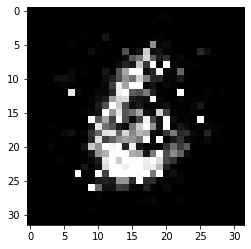

-------------------------------------


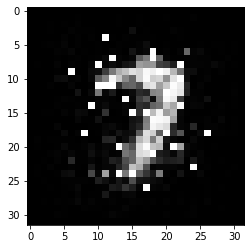

-------------------------------------


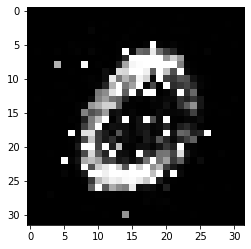

-------------------------------------


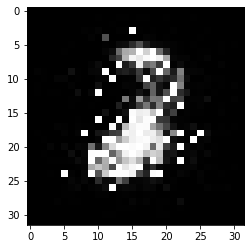

-------------------------------------


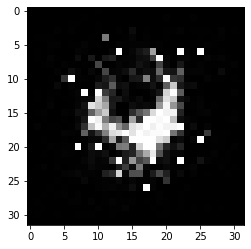

-------------------------------------


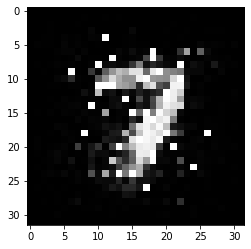

-------------------------------------


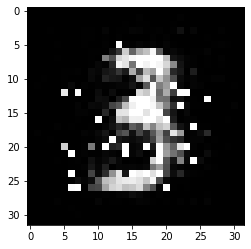

-------------------------------------


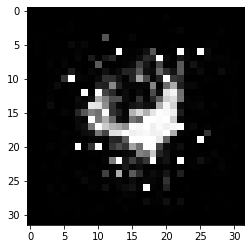

-------------------------------------


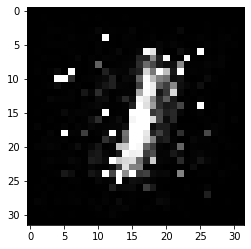

-------------------------------------


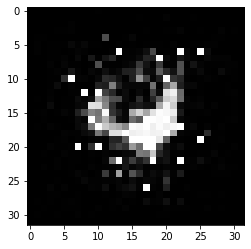

-------------------------------------


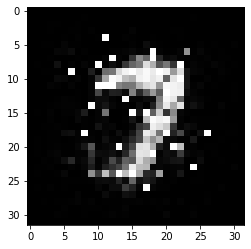

-------------------------------------


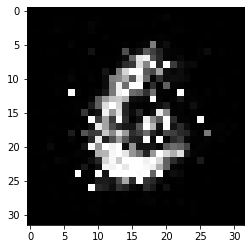

-------------------------------------


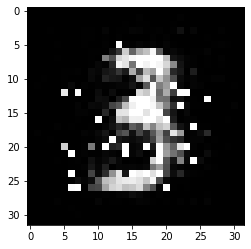

-------------------------------------


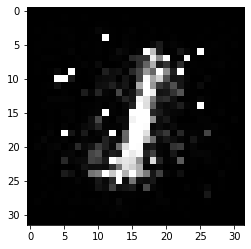

-------------------------------------


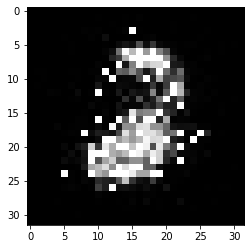

-------------------------------------


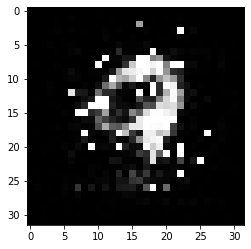

-------------------------------------


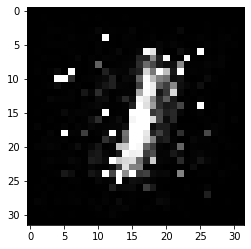

-------------------------------------


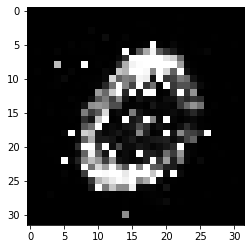

-------------------------------------


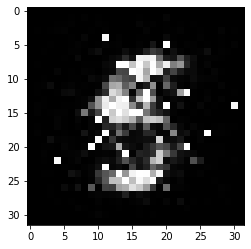

-------------------------------------


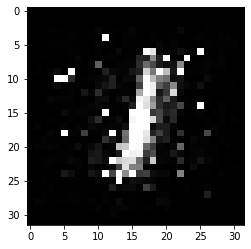

-------------------------------------


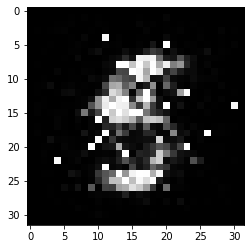

-------------------------------------


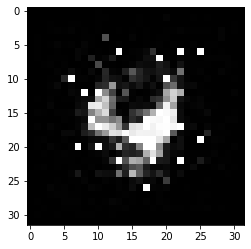

-------------------------------------


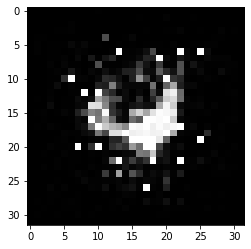

-------------------------------------


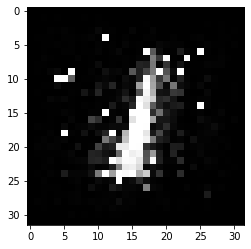

-------------------------------------


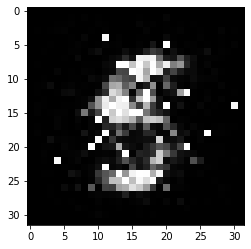

-------------------------------------


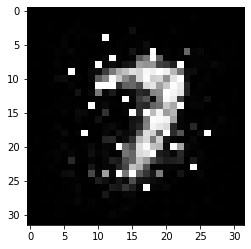

-------------------------------------


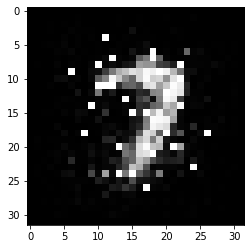

-------------------------------------


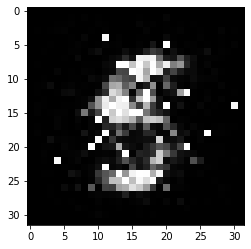

-------------------------------------


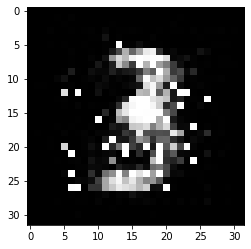

-------------------------------------


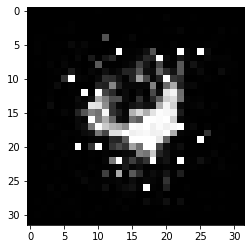

-------------------------------------


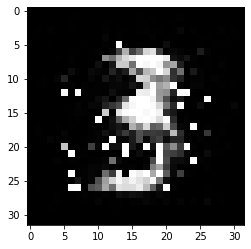

-------------------------------------


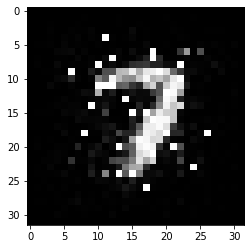

-------------------------------------


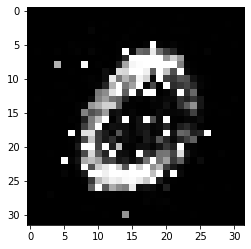

-------------------------------------


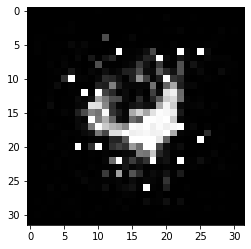

-------------------------------------


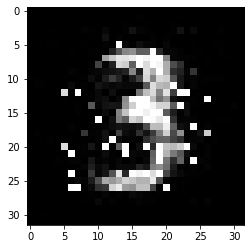

-------------------------------------


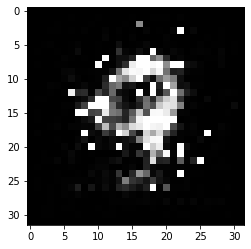

-------------------------------------


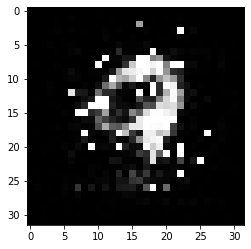

-------------------------------------


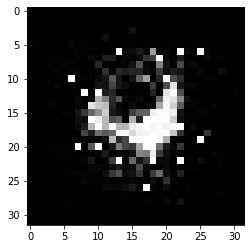

-------------------------------------


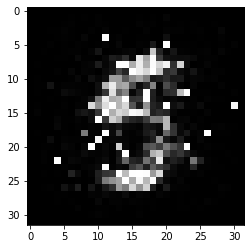

-------------------------------------


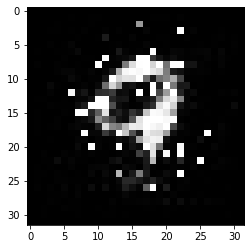

-------------------------------------


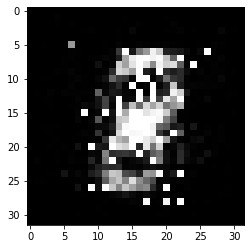

-------------------------------------


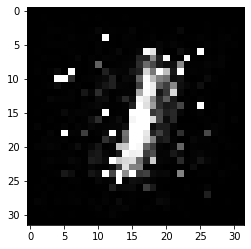

-------------------------------------


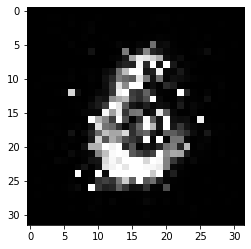

-------------------------------------


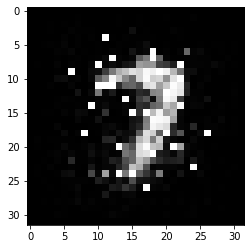

-------------------------------------


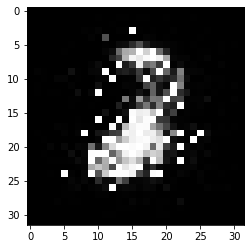

-------------------------------------


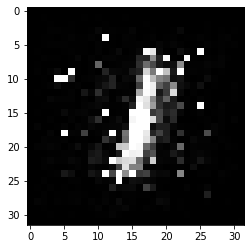

-------------------------------------


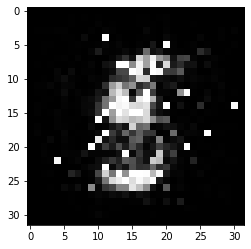

-------------------------------------


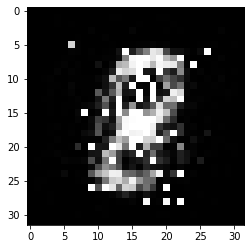

-------------------------------------


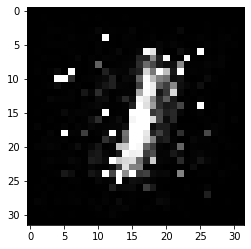

-------------------------------------


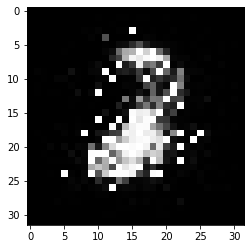

-------------------------------------


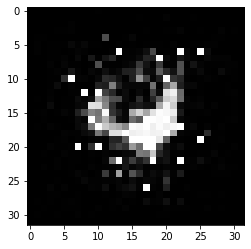

-------------------------------------


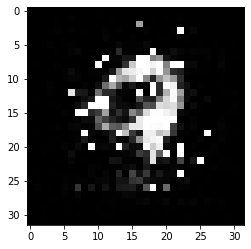

-------------------------------------


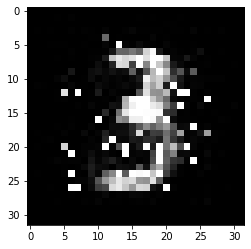

-------------------------------------


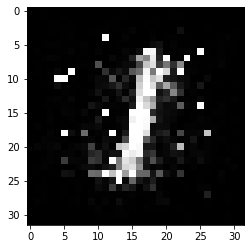

-------------------------------------


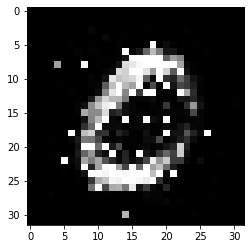

-------------------------------------


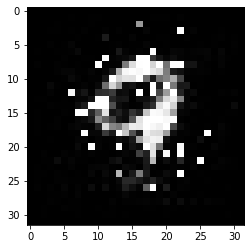

-------------------------------------


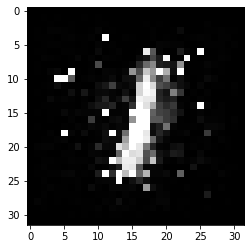

-------------------------------------


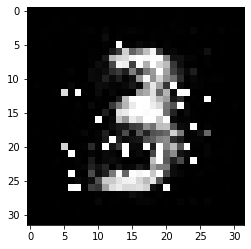

-------------------------------------


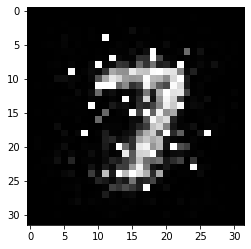

-------------------------------------


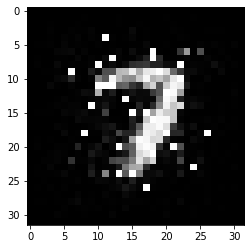

-------------------------------------


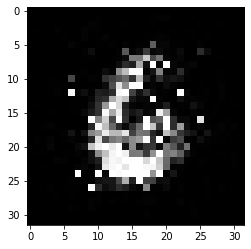

-------------------------------------


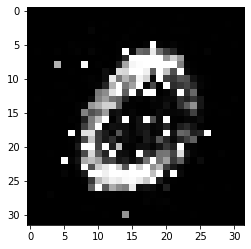

-------------------------------------


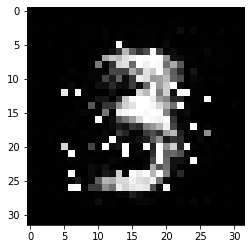

-------------------------------------


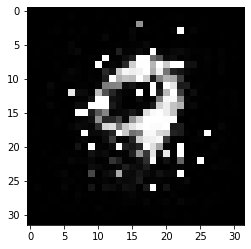

-------------------------------------


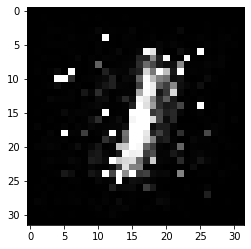

-------------------------------------


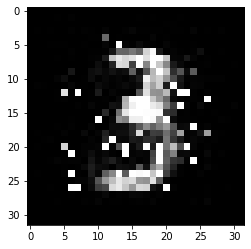

-------------------------------------


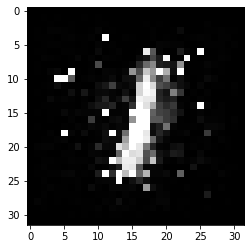

-------------------------------------


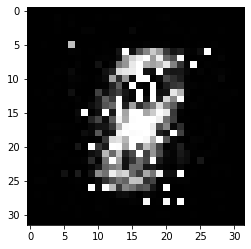

-------------------------------------


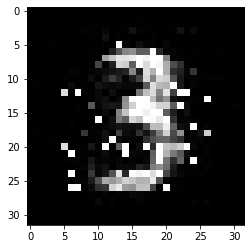

-------------------------------------


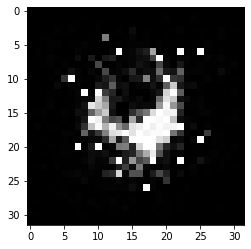

-------------------------------------


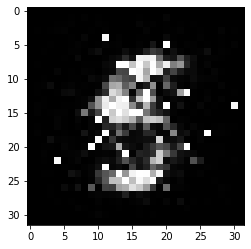

-------------------------------------


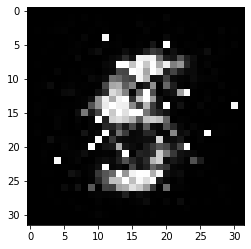

-------------------------------------


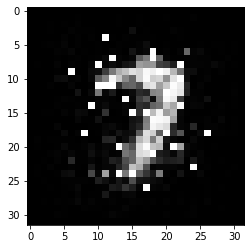

-------------------------------------


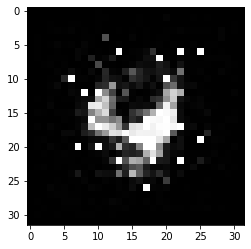

-------------------------------------


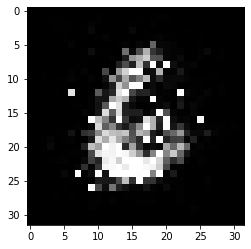

-------------------------------------


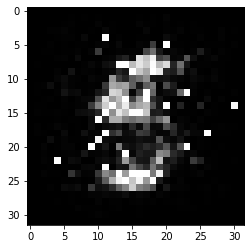

-------------------------------------


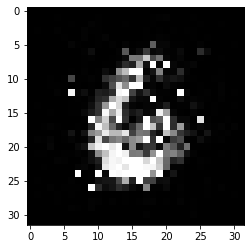

-------------------------------------


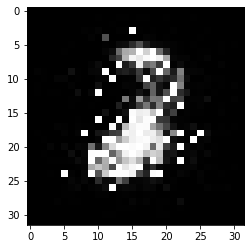

-------------------------------------


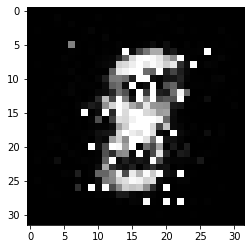

-------------------------------------


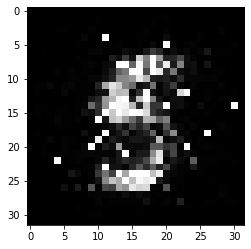

-------------------------------------


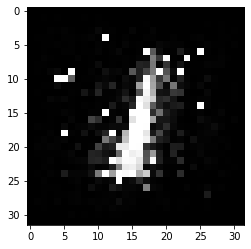

-------------------------------------


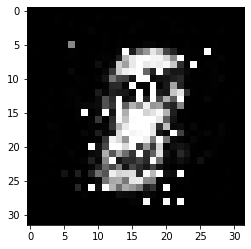

-------------------------------------


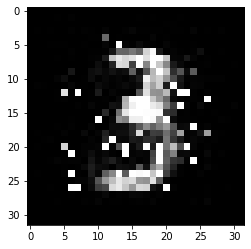

-------------------------------------


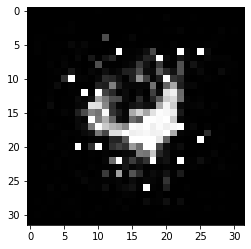

-------------------------------------


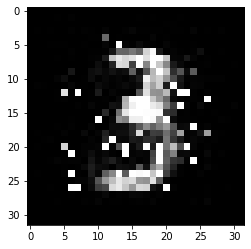

-------------------------------------


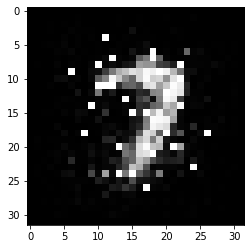

-------------------------------------


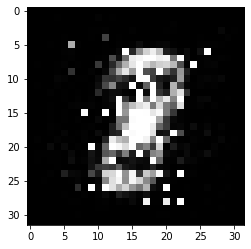

-------------------------------------


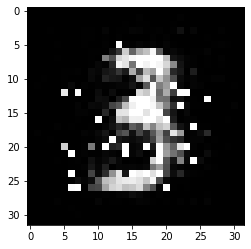

-------------------------------------


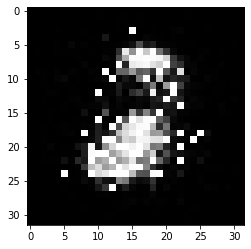

-------------------------------------


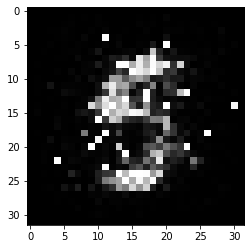

-------------------------------------


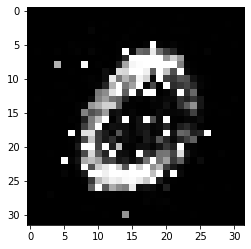

-------------------------------------


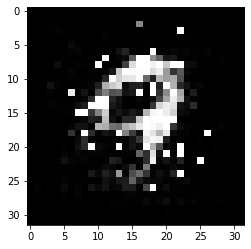

-------------------------------------


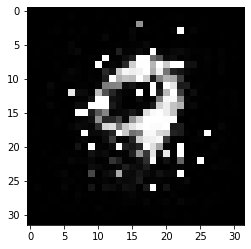

-------------------------------------


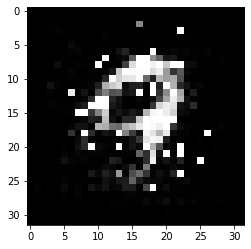

-------------------------------------


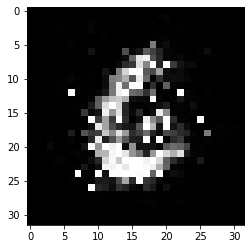

-------------------------------------


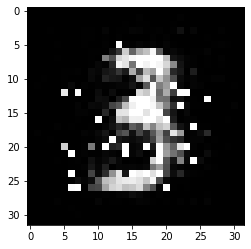

-------------------------------------


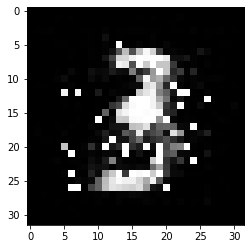

-------------------------------------


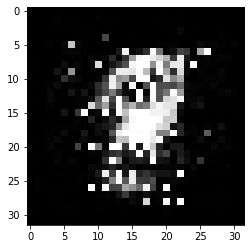

-------------------------------------


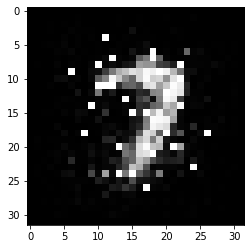

-------------------------------------


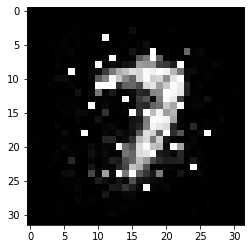

-------------------------------------


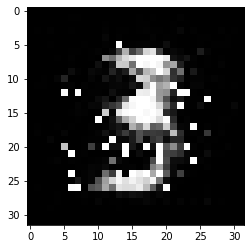

-------------------------------------


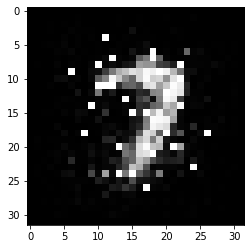

-------------------------------------


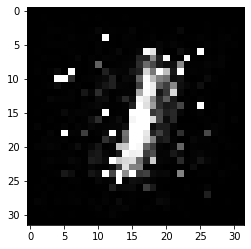

-------------------------------------


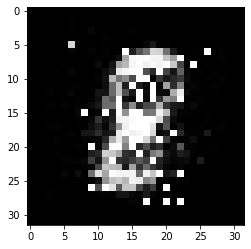

-------------------------------------


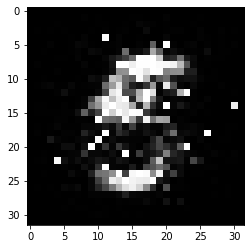

-------------------------------------


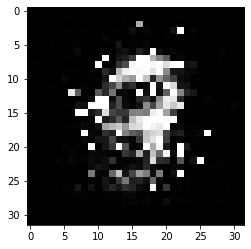

-------------------------------------


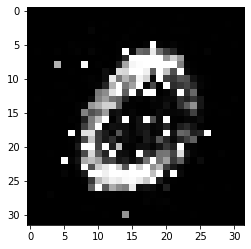

-------------------------------------


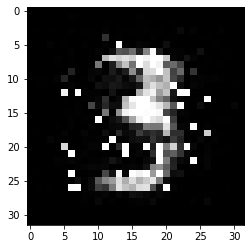

-------------------------------------


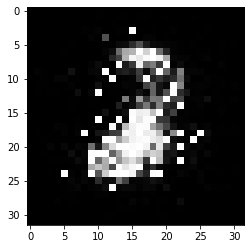

-------------------------------------


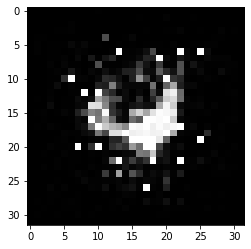

-------------------------------------


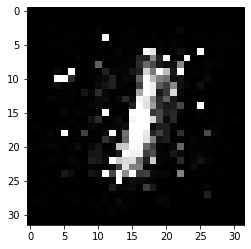

-------------------------------------


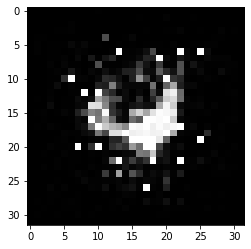

-------------------------------------


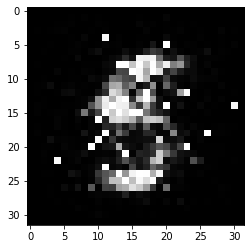

-------------------------------------


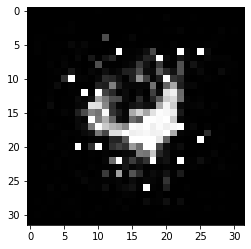

-------------------------------------


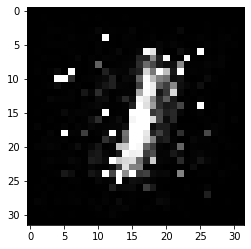

-------------------------------------


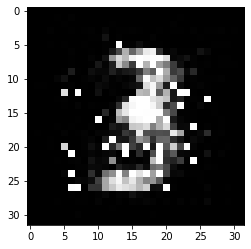

-------------------------------------


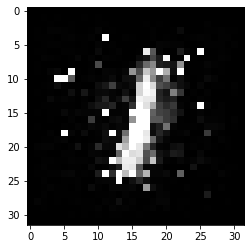

-------------------------------------


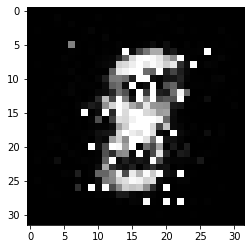

-------------------------------------


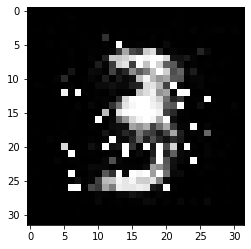

-------------------------------------


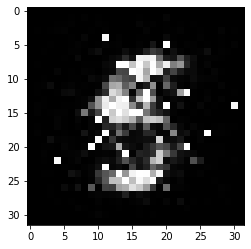

-------------------------------------


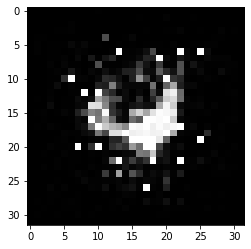

-------------------------------------


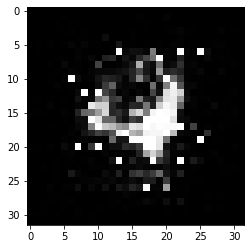

-------------------------------------


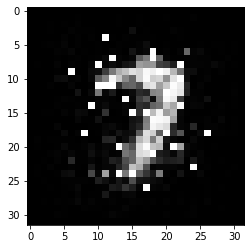

-------------------------------------


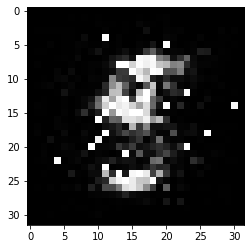

-------------------------------------


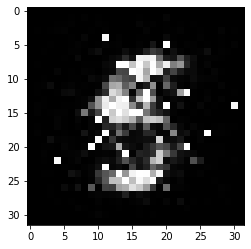

-------------------------------------


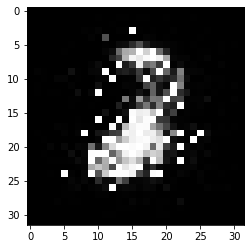

-------------------------------------


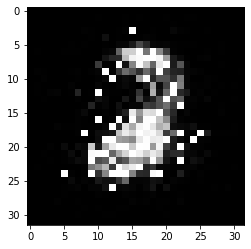

-------------------------------------


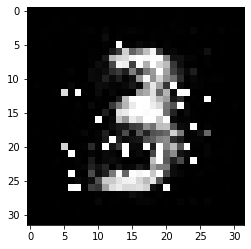

-------------------------------------


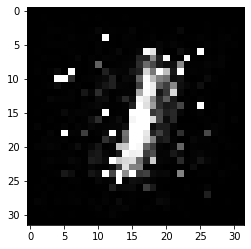

-------------------------------------


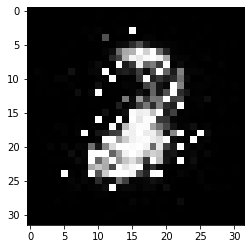

-------------------------------------


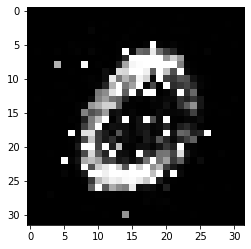

-------------------------------------


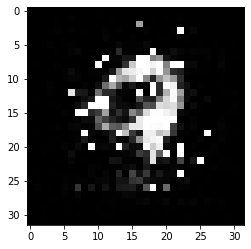

-------------------------------------


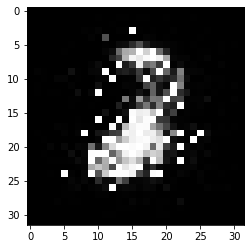

-------------------------------------


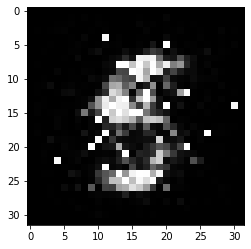

-------------------------------------


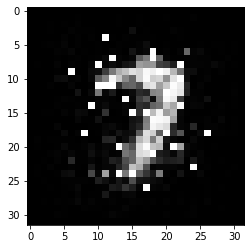

-------------------------------------


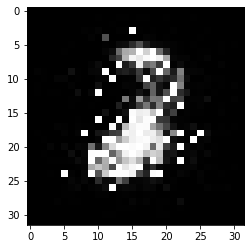

-------------------------------------


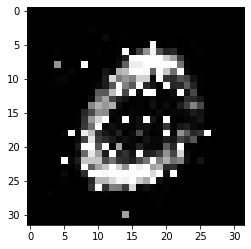

-------------------------------------


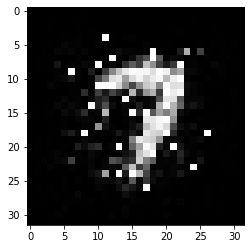

-------------------------------------


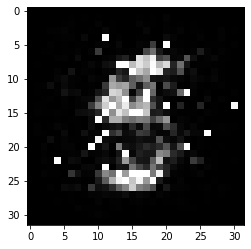

-------------------------------------


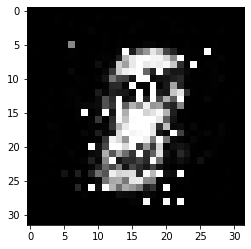

-------------------------------------


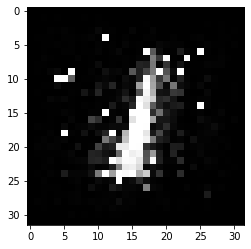

-------------------------------------


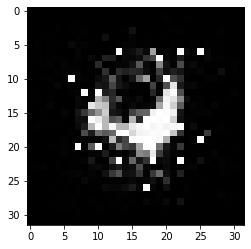

-------------------------------------


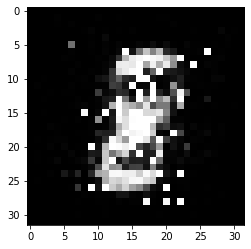

-------------------------------------


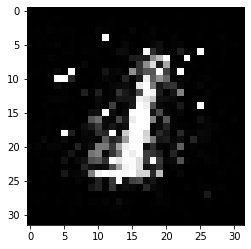

-------------------------------------


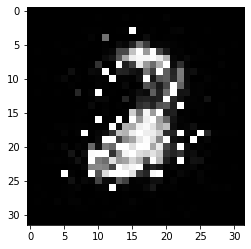

-------------------------------------


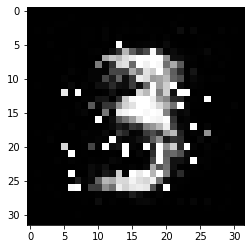

-------------------------------------


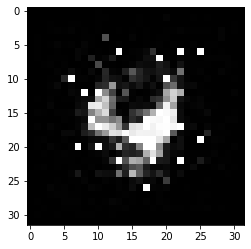

-------------------------------------


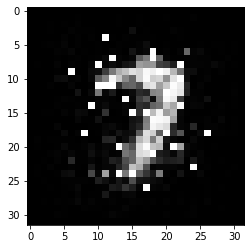

-------------------------------------


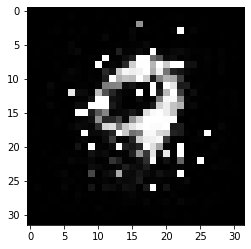

-------------------------------------


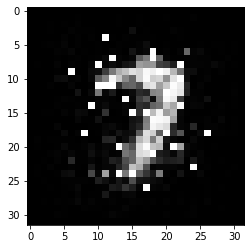

-------------------------------------


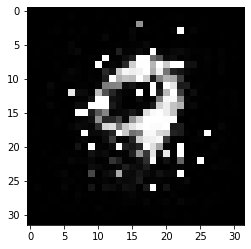

-------------------------------------


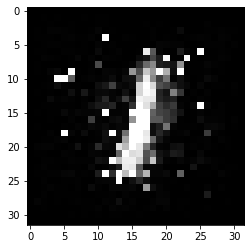

-------------------------------------


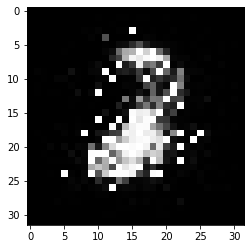

-------------------------------------


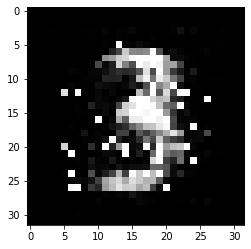

-------------------------------------


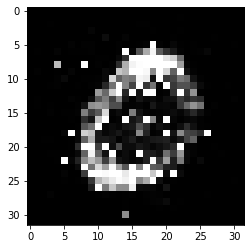

-------------------------------------


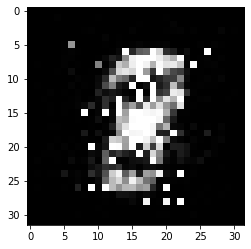

-------------------------------------


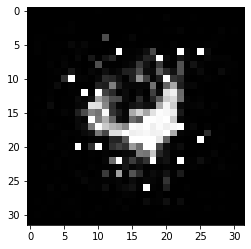

-------------------------------------


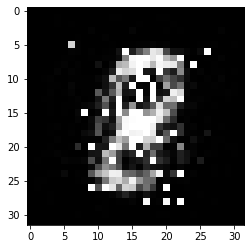

-------------------------------------


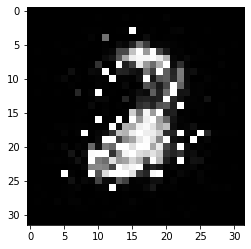

-------------------------------------


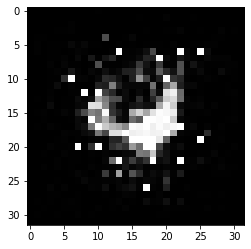

-------------------------------------


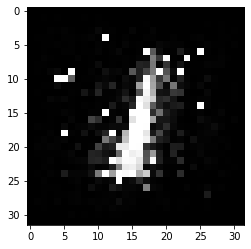

-------------------------------------


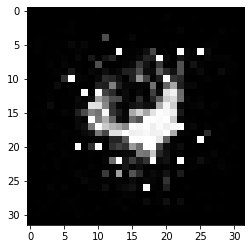

-------------------------------------


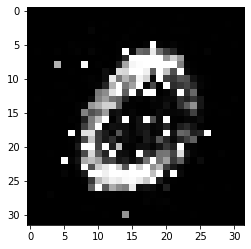

-------------------------------------


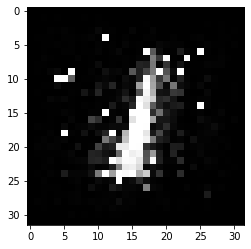

-------------------------------------


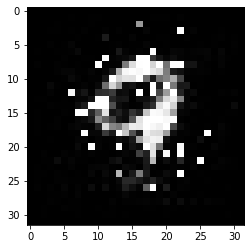

-------------------------------------


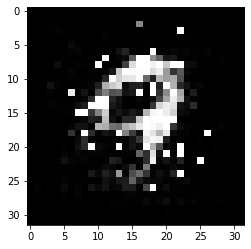

-------------------------------------


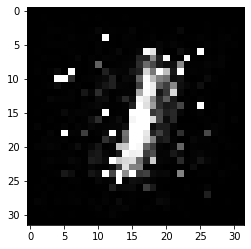

-------------------------------------


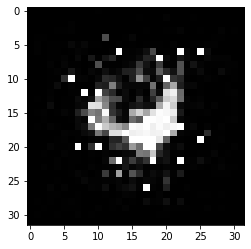

-------------------------------------


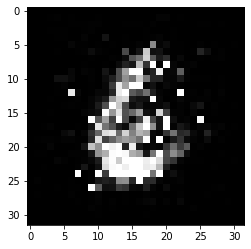

-------------------------------------


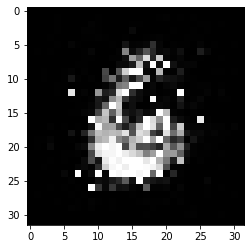

-------------------------------------


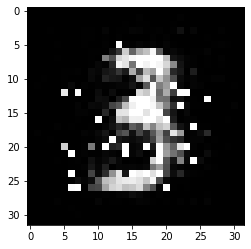

-------------------------------------


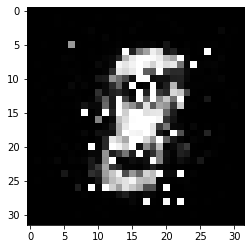

-------------------------------------


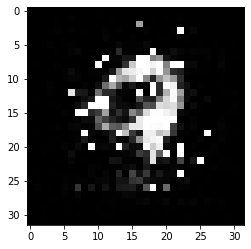

-------------------------------------


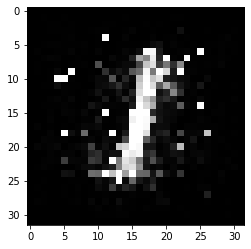

-------------------------------------


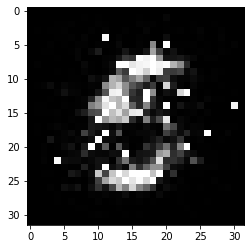

-------------------------------------


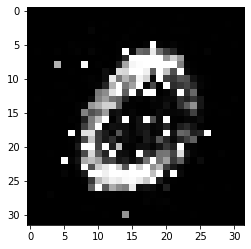

-------------------------------------


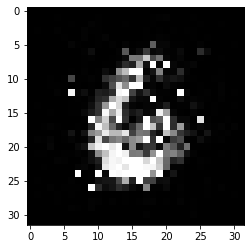

-------------------------------------


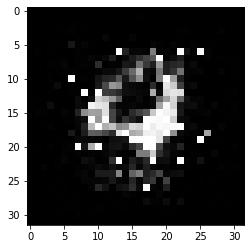

-------------------------------------


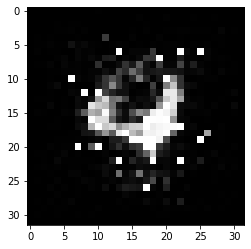

-------------------------------------


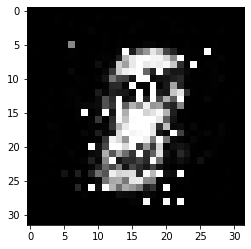

-------------------------------------


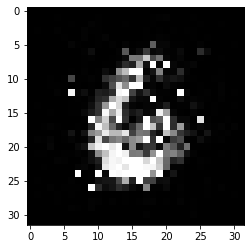

-------------------------------------


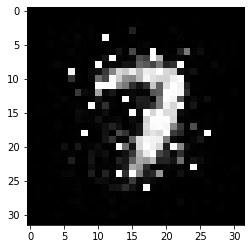

-------------------------------------


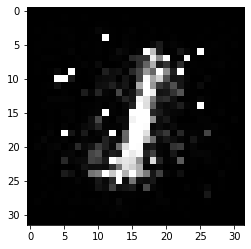

-------------------------------------


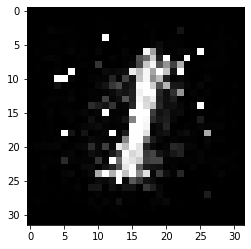

-------------------------------------


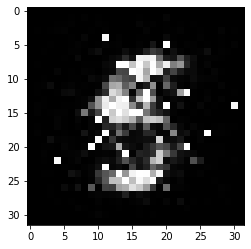

-------------------------------------


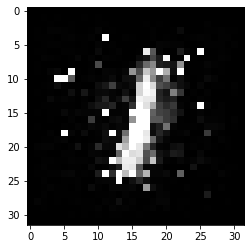

-------------------------------------


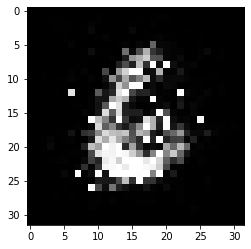

-------------------------------------


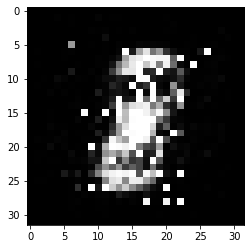

-------------------------------------


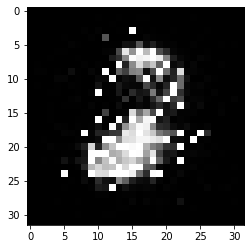

-------------------------------------


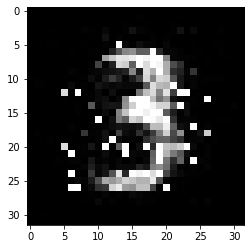

-------------------------------------


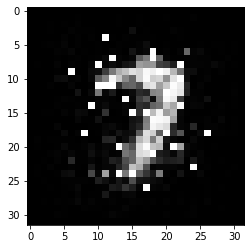

-------------------------------------


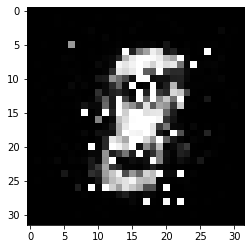

-------------------------------------


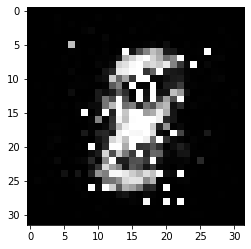

-------------------------------------


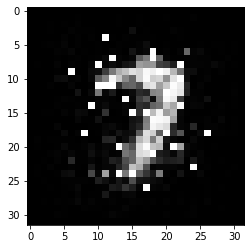

-------------------------------------


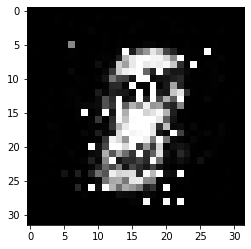

-------------------------------------


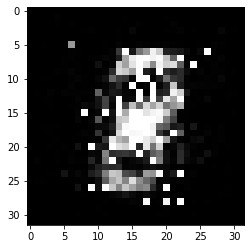

-------------------------------------


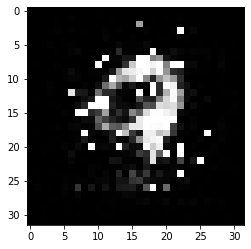

-------------------------------------


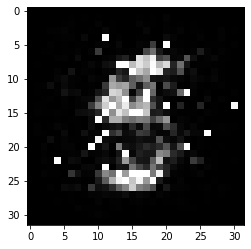

-------------------------------------


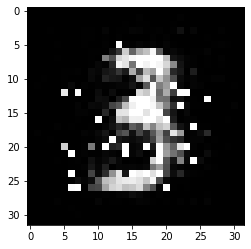

-------------------------------------


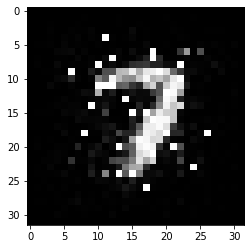

-------------------------------------


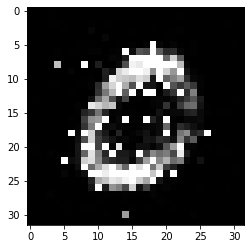

-------------------------------------


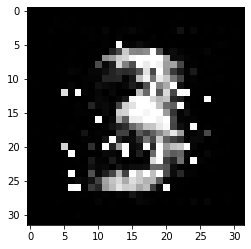

-------------------------------------


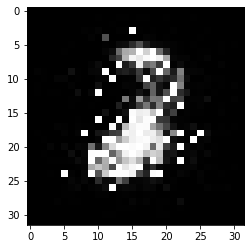

-------------------------------------


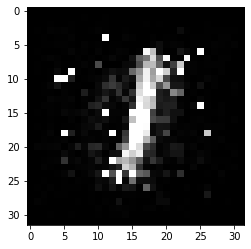

-------------------------------------


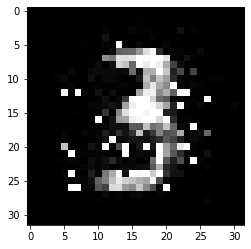

-------------------------------------


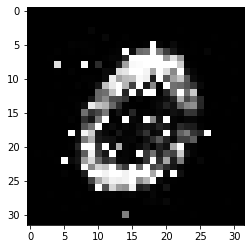

-------------------------------------


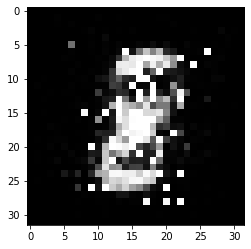

-------------------------------------


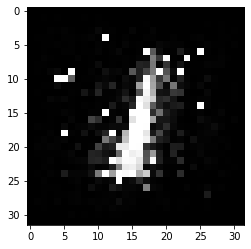

-------------------------------------


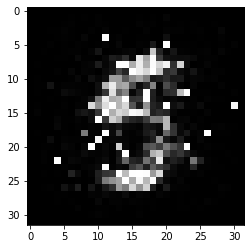

-------------------------------------


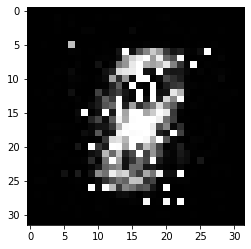

-------------------------------------


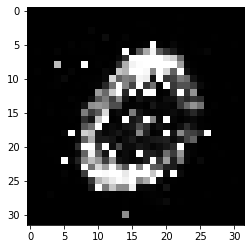

-------------------------------------


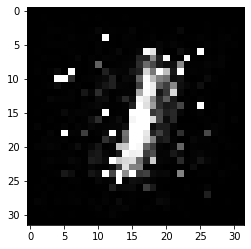

-------------------------------------


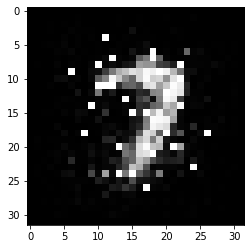

-------------------------------------


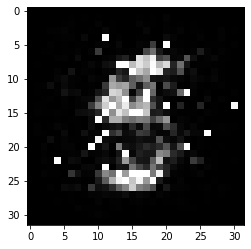

-------------------------------------


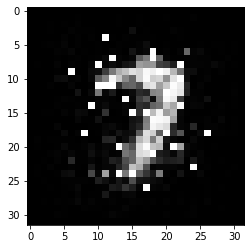

-------------------------------------


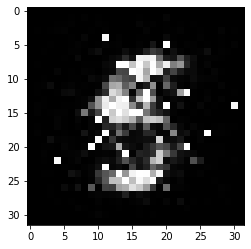

-------------------------------------


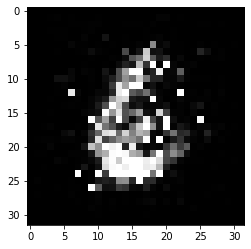

-------------------------------------


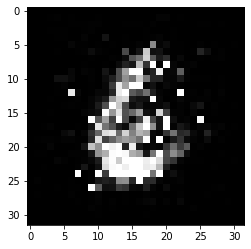

-------------------------------------


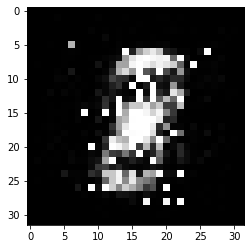

-------------------------------------


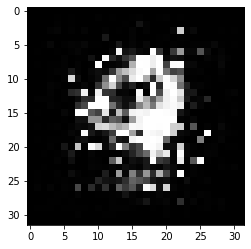

-------------------------------------


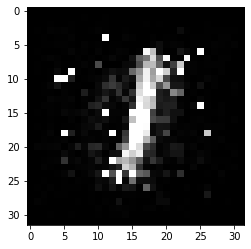

-------------------------------------


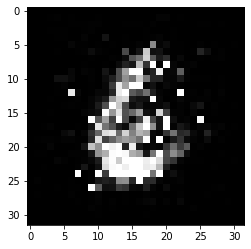

-------------------------------------


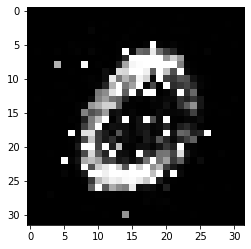

-------------------------------------


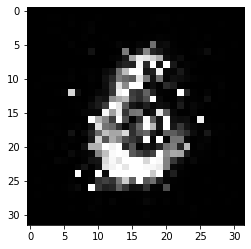

-------------------------------------


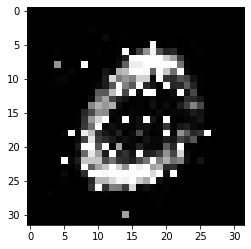

-------------------------------------


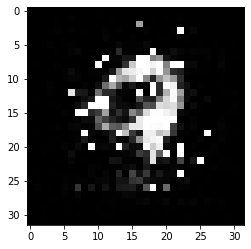

-------------------------------------


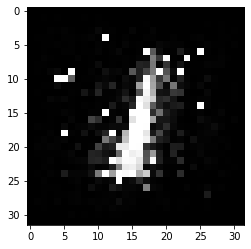

-------------------------------------


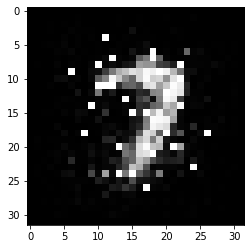

-------------------------------------


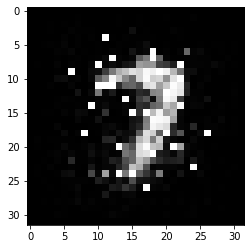

-------------------------------------


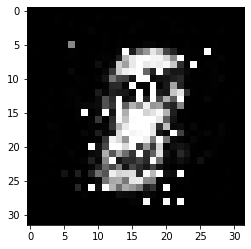

-------------------------------------


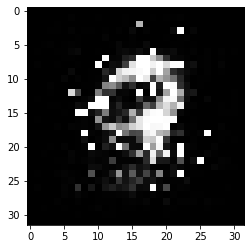

-------------------------------------


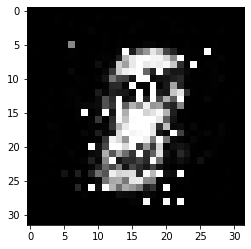

-------------------------------------


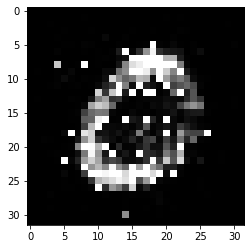

-------------------------------------


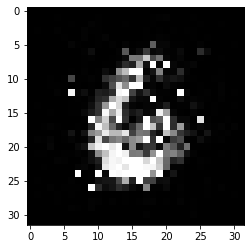

-------------------------------------


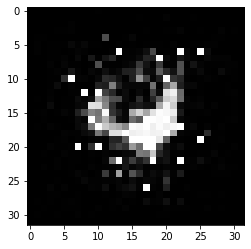

-------------------------------------


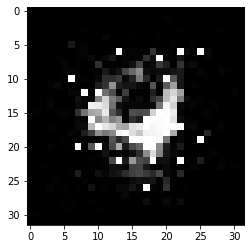

-------------------------------------


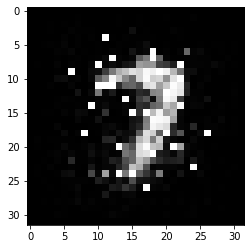

-------------------------------------


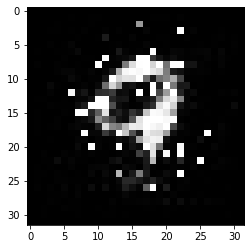

-------------------------------------


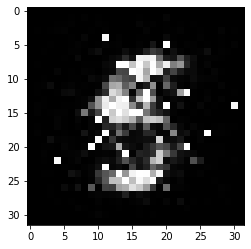

-------------------------------------


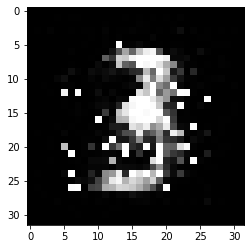

-------------------------------------


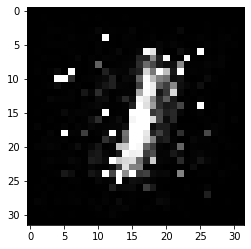

-------------------------------------


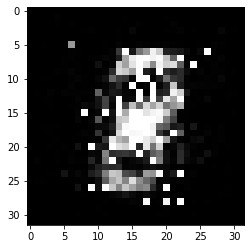

-------------------------------------


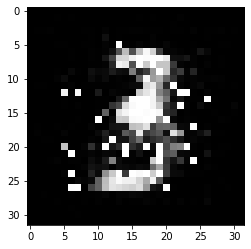

-------------------------------------


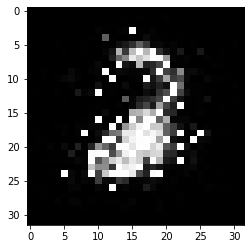

-------------------------------------


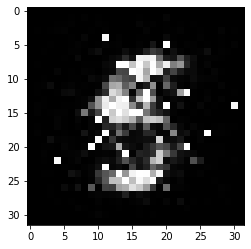

-------------------------------------


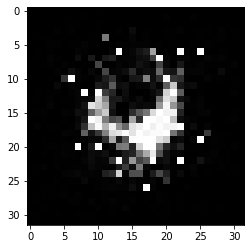

-------------------------------------


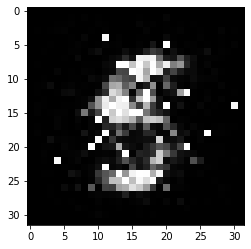

-------------------------------------


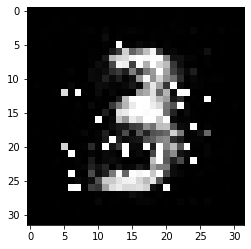

-------------------------------------


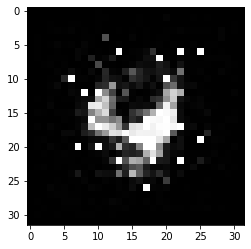

-------------------------------------


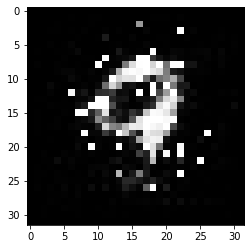

-------------------------------------


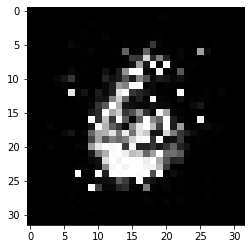

-------------------------------------


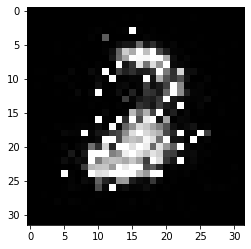

-------------------------------------


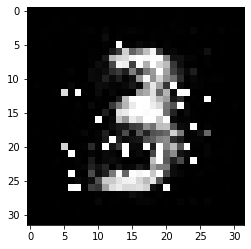

-------------------------------------


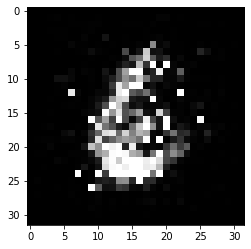

-------------------------------------


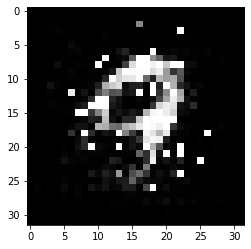

-------------------------------------


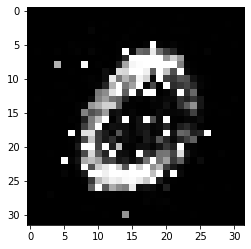

-------------------------------------


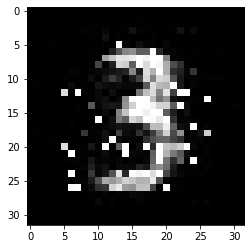

-------------------------------------


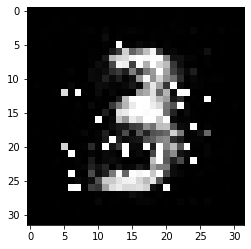

-------------------------------------


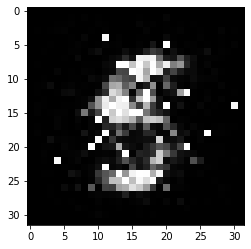

-------------------------------------


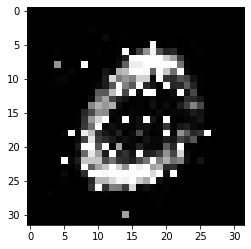

-------------------------------------


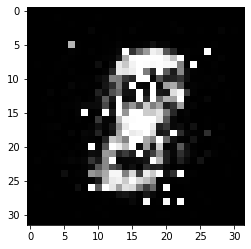

-------------------------------------


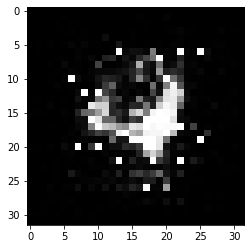

-------------------------------------


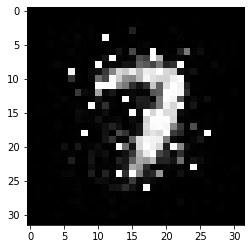

-------------------------------------


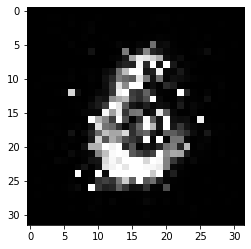

-------------------------------------


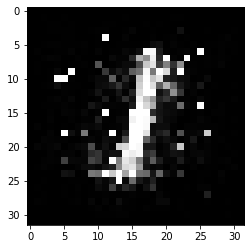

-------------------------------------


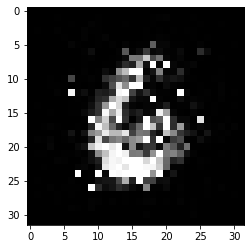

-------------------------------------


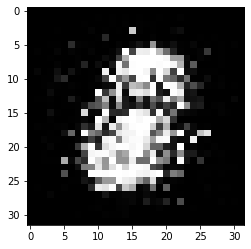

-------------------------------------


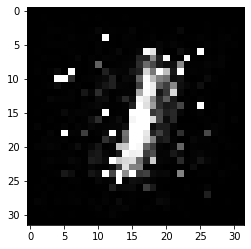

-------------------------------------


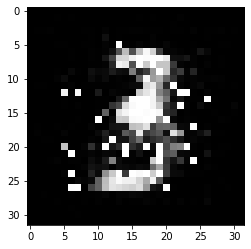

-------------------------------------


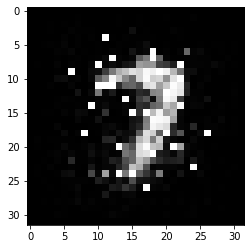

-------------------------------------


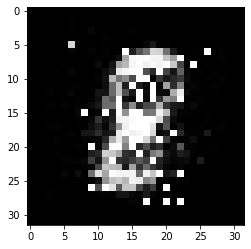

-------------------------------------


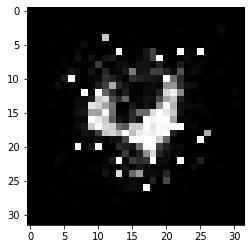

-------------------------------------


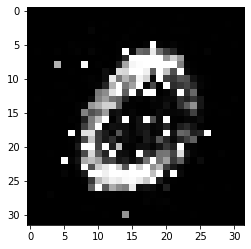

-------------------------------------


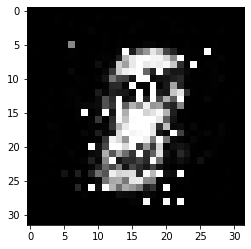

-------------------------------------


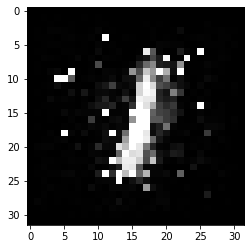

-------------------------------------


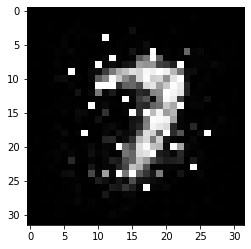

-------------------------------------


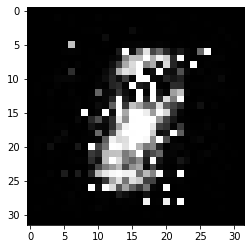

-------------------------------------


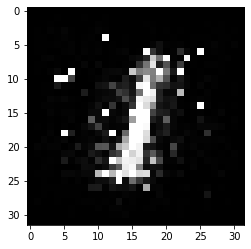

-------------------------------------


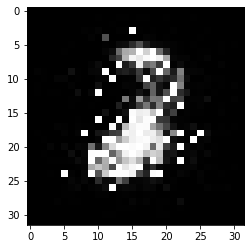

-------------------------------------


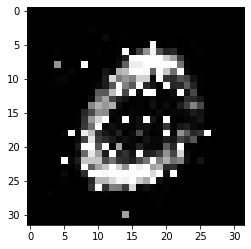

-------------------------------------


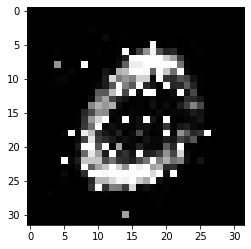

-------------------------------------


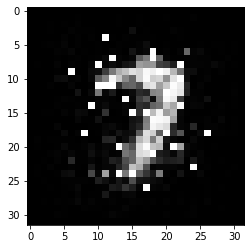

-------------------------------------


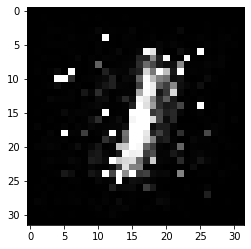

-------------------------------------


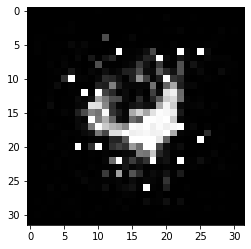

-------------------------------------


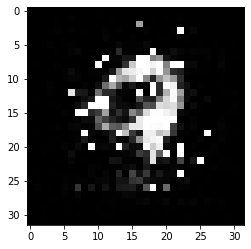

-------------------------------------


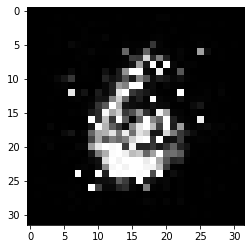

-------------------------------------


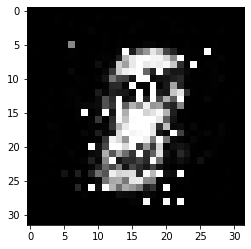

-------------------------------------


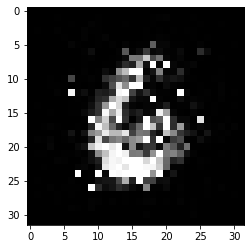

-------------------------------------


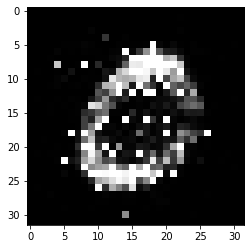

-------------------------------------


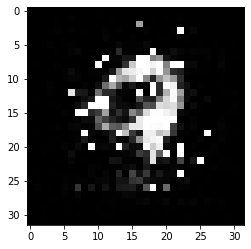

-------------------------------------


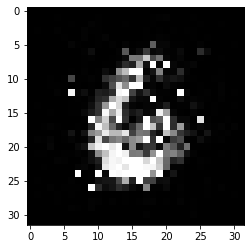

-------------------------------------


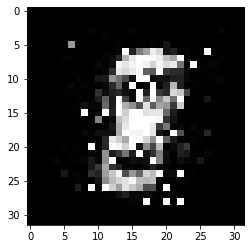

-------------------------------------


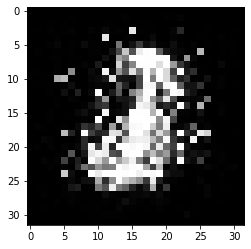

-------------------------------------


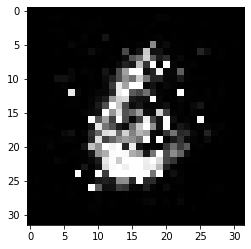

-------------------------------------


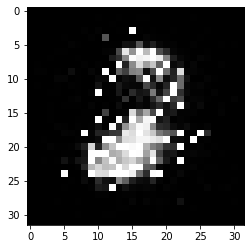

-------------------------------------


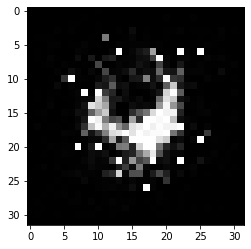

-------------------------------------


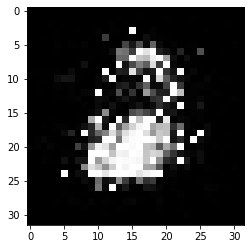

-------------------------------------


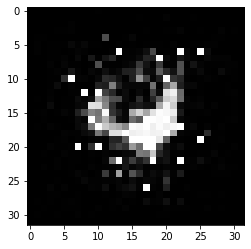

-------------------------------------


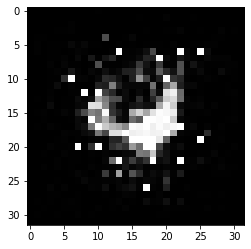

-------------------------------------


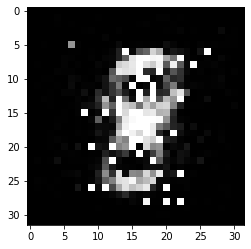

-------------------------------------


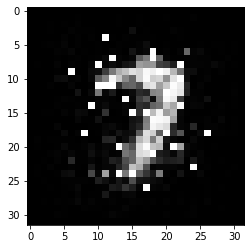

-------------------------------------


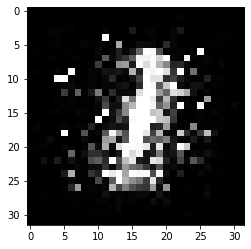

-------------------------------------


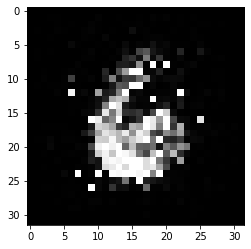

-------------------------------------


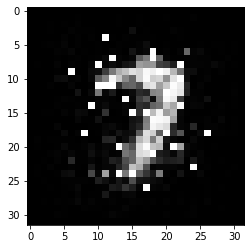

-------------------------------------


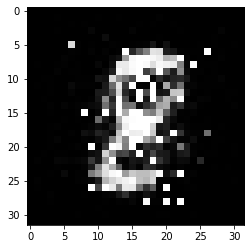

-------------------------------------


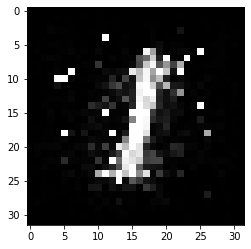

-------------------------------------


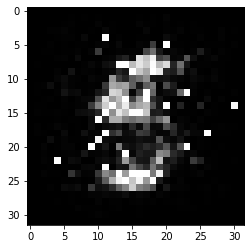

-------------------------------------


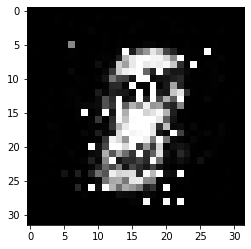

-------------------------------------


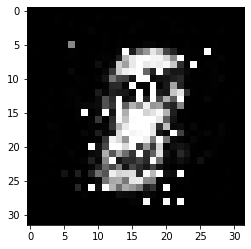

-------------------------------------


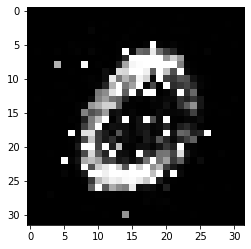

-------------------------------------


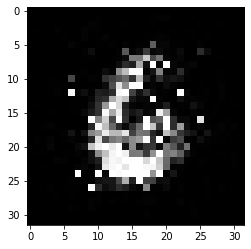

-------------------------------------


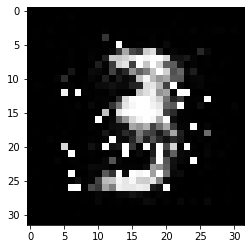

-------------------------------------


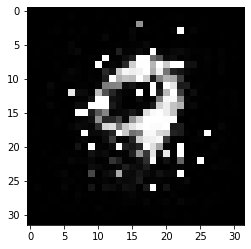

-------------------------------------


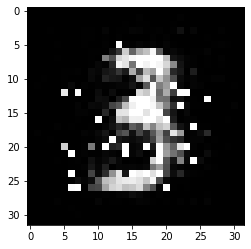

-------------------------------------


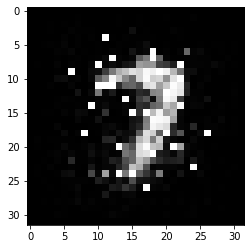

-------------------------------------


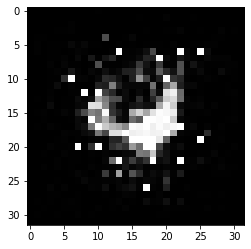

-------------------------------------


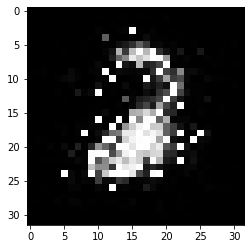

-------------------------------------


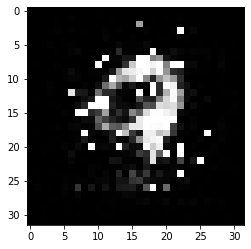

-------------------------------------


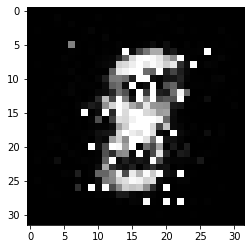

-------------------------------------


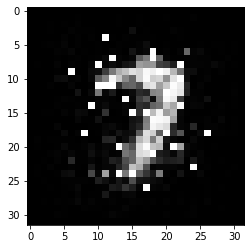

-------------------------------------


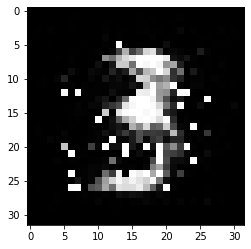

-------------------------------------


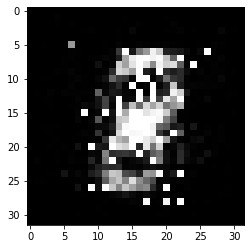

-------------------------------------


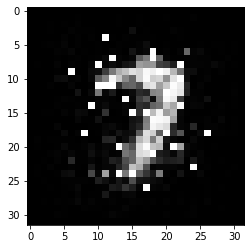

-------------------------------------


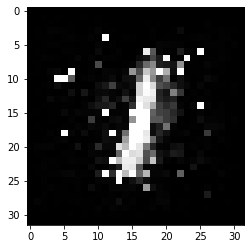

-------------------------------------


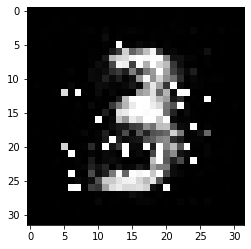

-------------------------------------


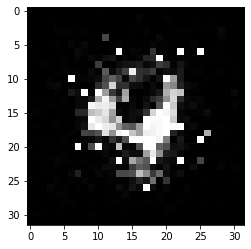

-------------------------------------


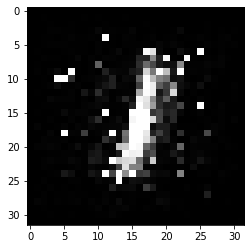

-------------------------------------


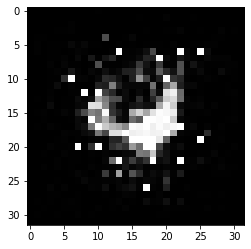

-------------------------------------


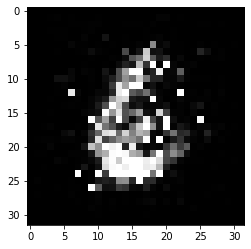

-------------------------------------


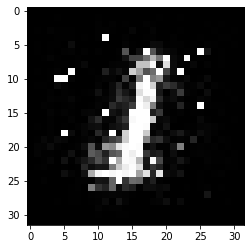

-------------------------------------


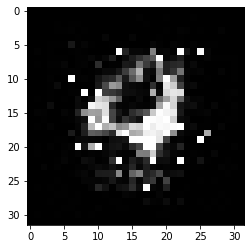

-------------------------------------


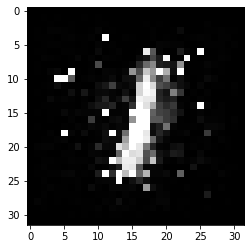

-------------------------------------


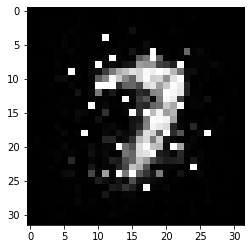

-------------------------------------


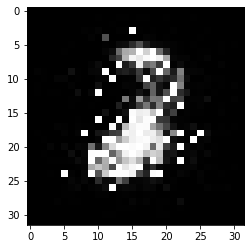

-------------------------------------


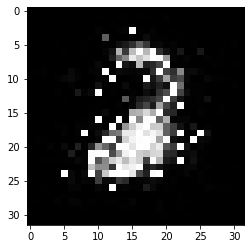

-------------------------------------


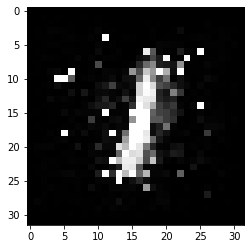

-------------------------------------


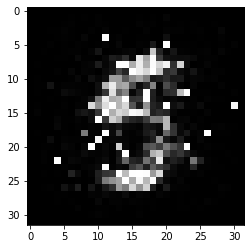

-------------------------------------


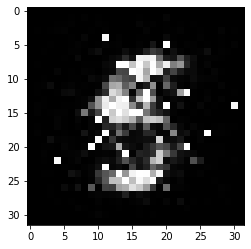

-------------------------------------


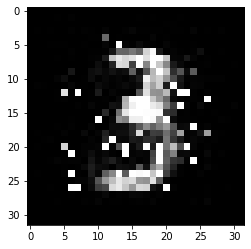

-------------------------------------


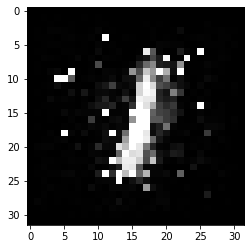

-------------------------------------


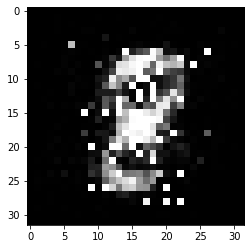

-------------------------------------


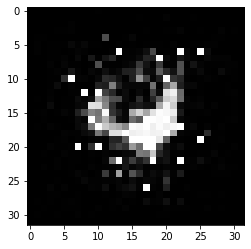

-------------------------------------


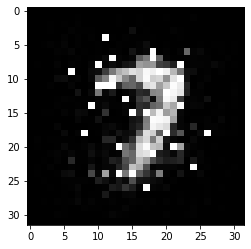

-------------------------------------


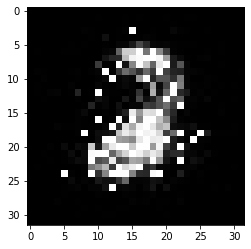

-------------------------------------


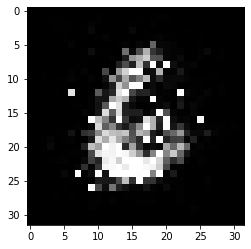

-------------------------------------


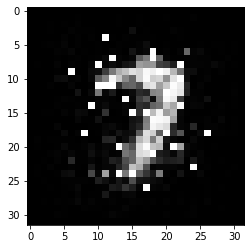

-------------------------------------


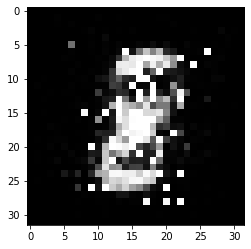

-------------------------------------


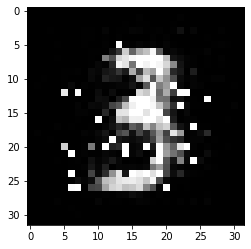

-------------------------------------


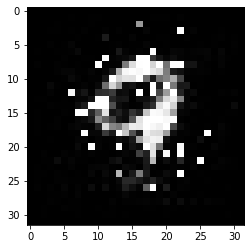

-------------------------------------


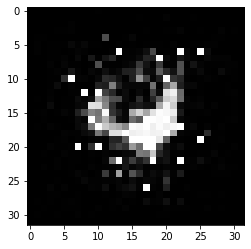

-------------------------------------


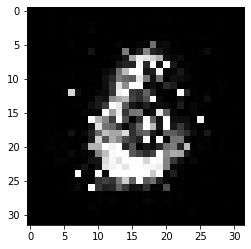

-------------------------------------


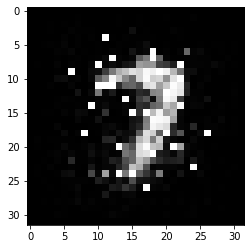

-------------------------------------


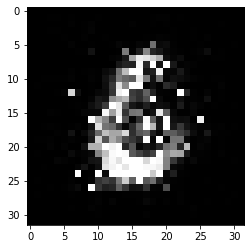

-------------------------------------


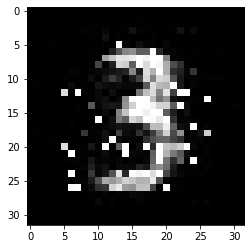

-------------------------------------


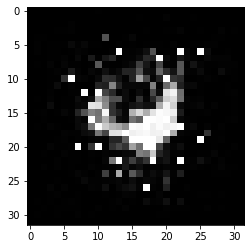

-------------------------------------


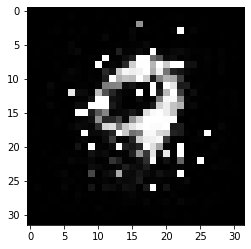

-------------------------------------


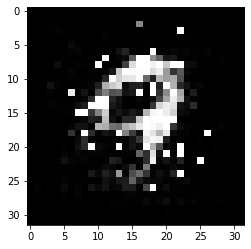

-------------------------------------


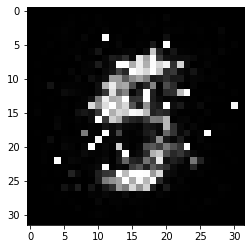

-------------------------------------


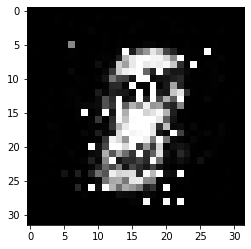

-------------------------------------


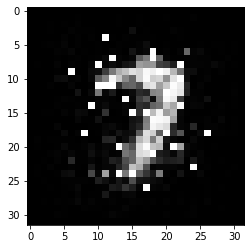

-------------------------------------


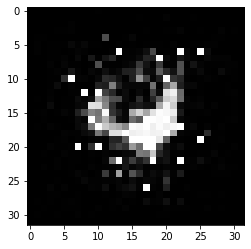

-------------------------------------


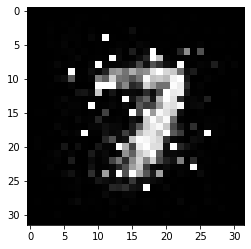

-------------------------------------


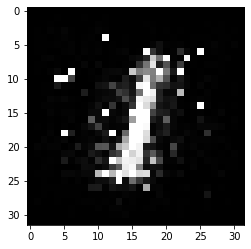

-------------------------------------


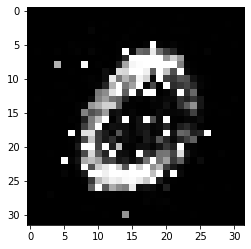

-------------------------------------


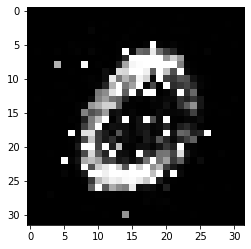

-------------------------------------


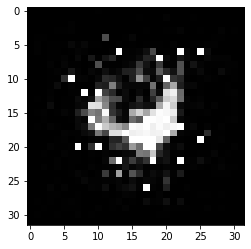

-------------------------------------


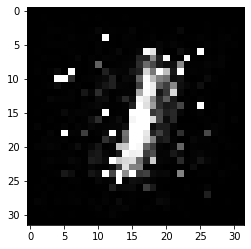

-------------------------------------


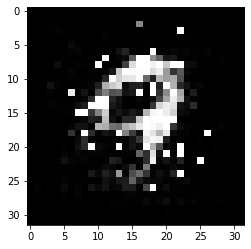

-------------------------------------


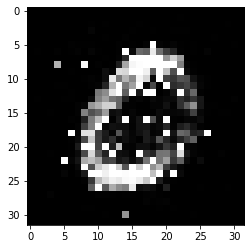

-------------------------------------


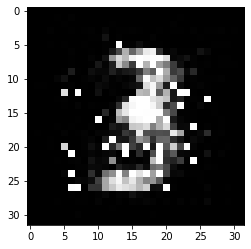

-------------------------------------


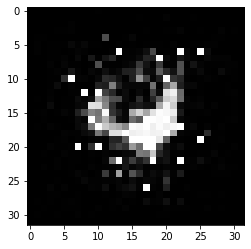

-------------------------------------


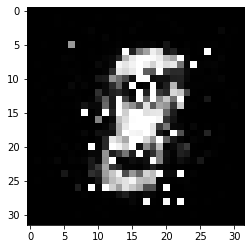

-------------------------------------


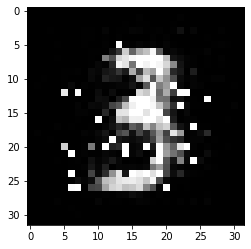

-------------------------------------


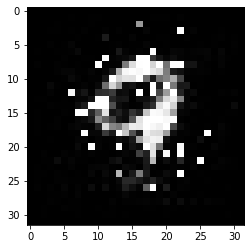

-------------------------------------


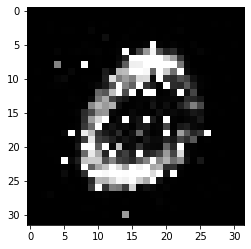

-------------------------------------


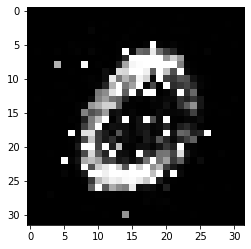

-------------------------------------


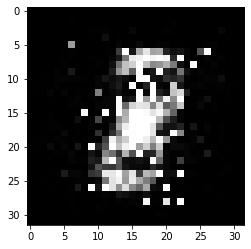

-------------------------------------


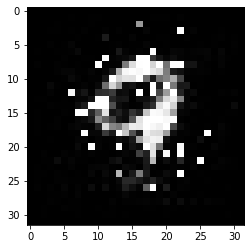

-------------------------------------


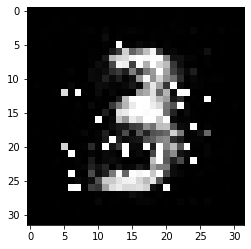

-------------------------------------


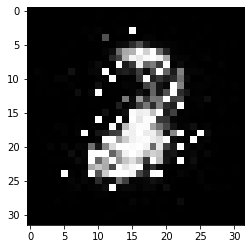

-------------------------------------


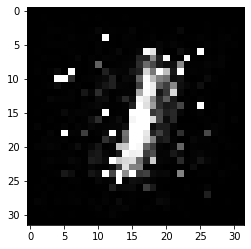

-------------------------------------


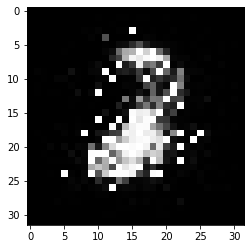

-------------------------------------


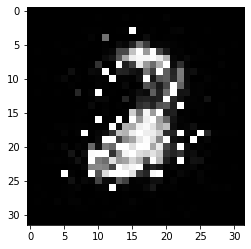

-------------------------------------


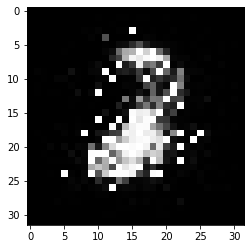

-------------------------------------


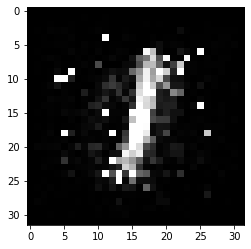

-------------------------------------


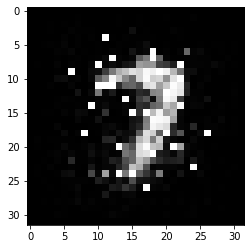

-------------------------------------


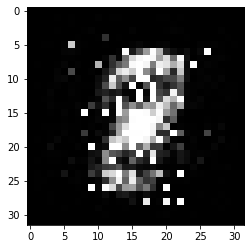

-------------------------------------


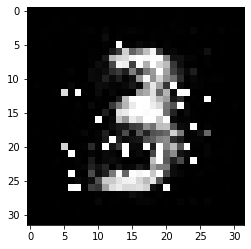

-------------------------------------


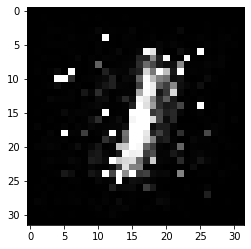

-------------------------------------


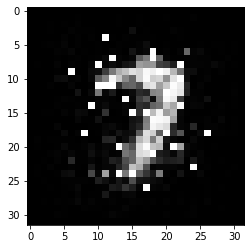

-------------------------------------


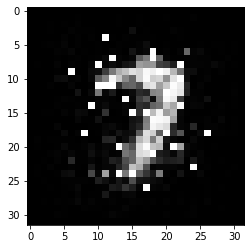

-------------------------------------


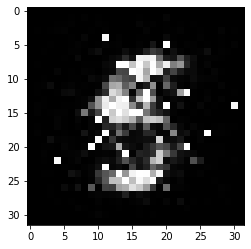

-------------------------------------


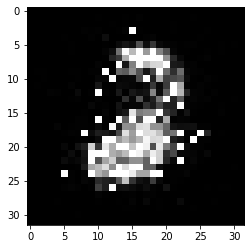

-------------------------------------


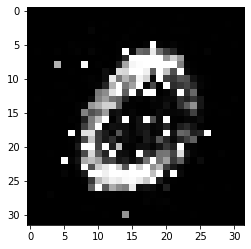

-------------------------------------


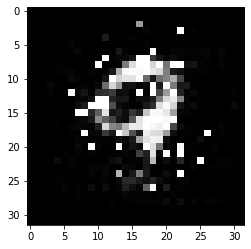

-------------------------------------


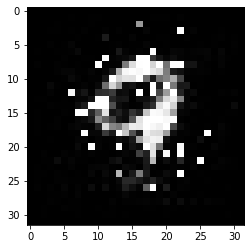

-------------------------------------


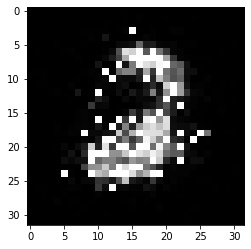

-------------------------------------


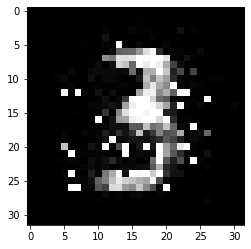

-------------------------------------


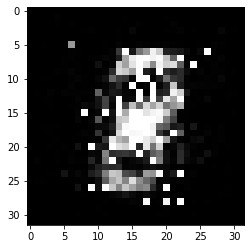

-------------------------------------


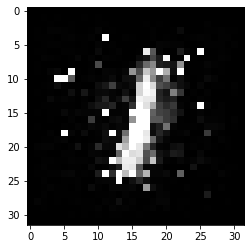

-------------------------------------


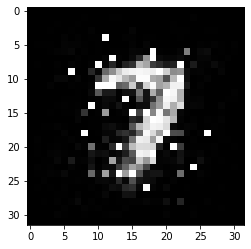

-------------------------------------


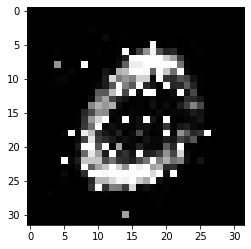

-------------------------------------


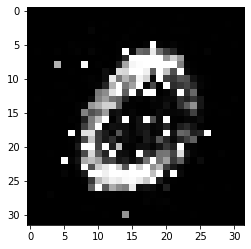

-------------------------------------


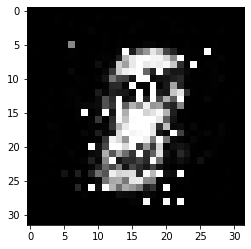

-------------------------------------


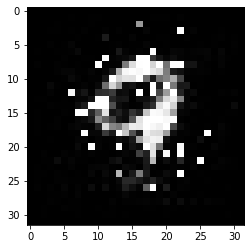

-------------------------------------


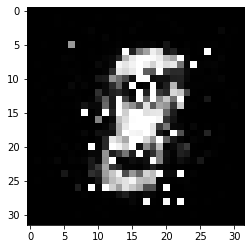

-------------------------------------


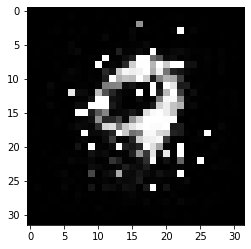

-------------------------------------


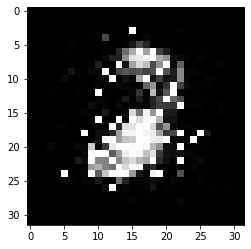

-------------------------------------


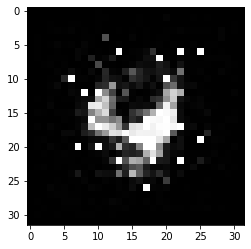

-------------------------------------


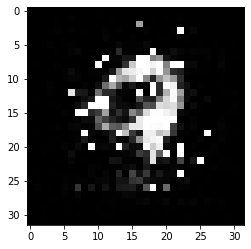

-------------------------------------


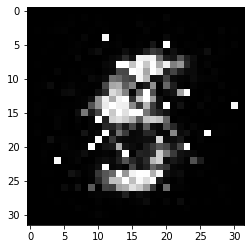

-------------------------------------


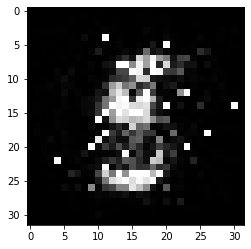

-------------------------------------


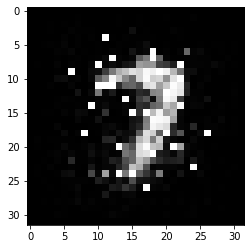

-------------------------------------


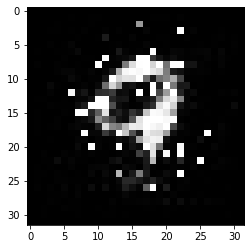

-------------------------------------


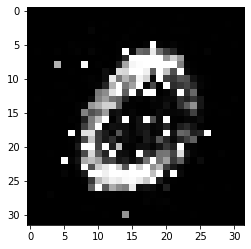

-------------------------------------


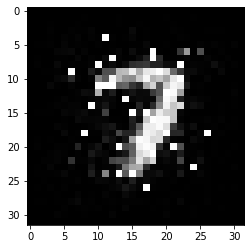

-------------------------------------


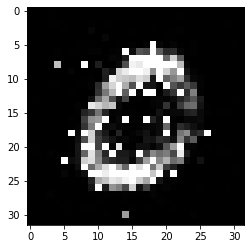

-------------------------------------


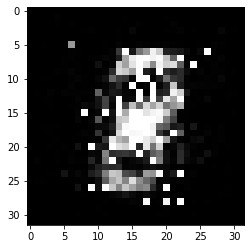

-------------------------------------


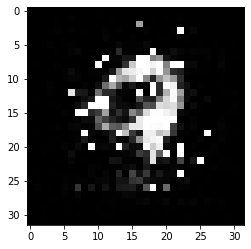

-------------------------------------


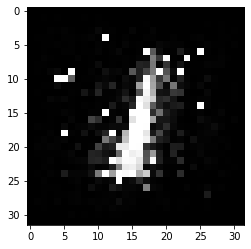

-------------------------------------


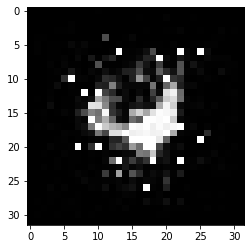

-------------------------------------


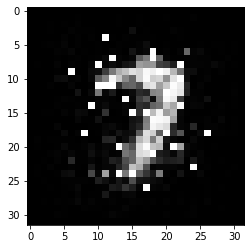

-------------------------------------


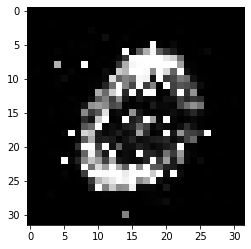

-------------------------------------


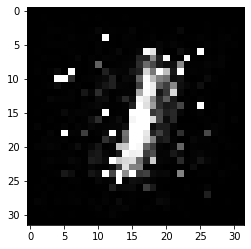

-------------------------------------


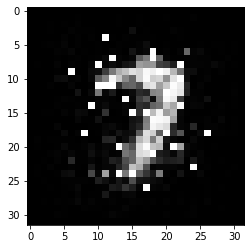

-------------------------------------


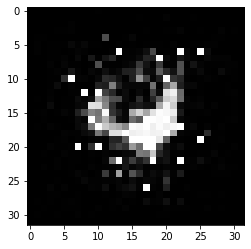

-------------------------------------


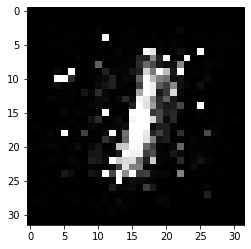

-------------------------------------


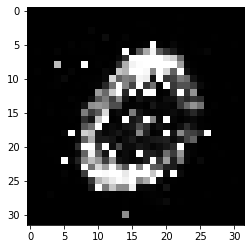

-------------------------------------


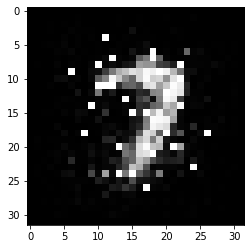

-------------------------------------


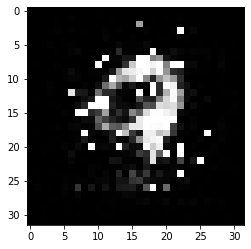

-------------------------------------


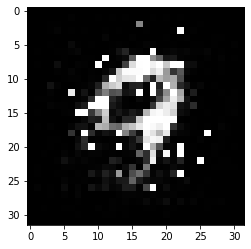

-------------------------------------


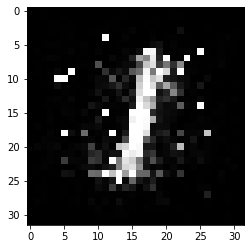

-------------------------------------


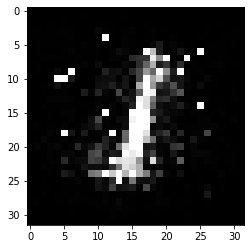

-------------------------------------


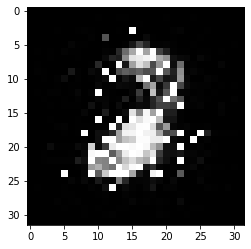

-------------------------------------


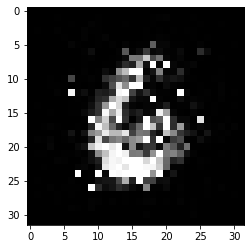

-------------------------------------


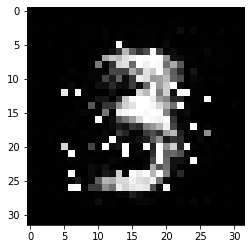

-------------------------------------


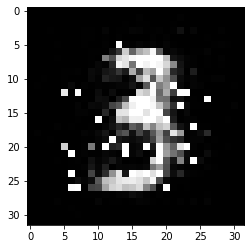

-------------------------------------


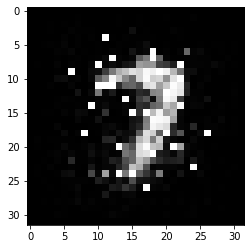

-------------------------------------


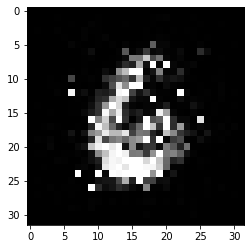

-------------------------------------


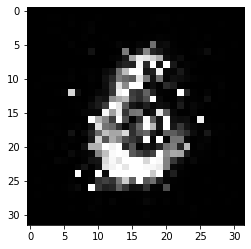

-------------------------------------


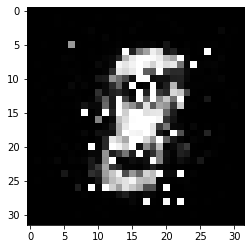

-------------------------------------


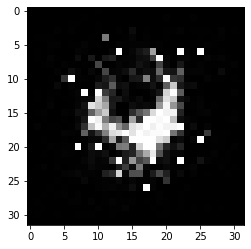

-------------------------------------


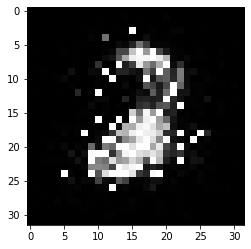

-------------------------------------


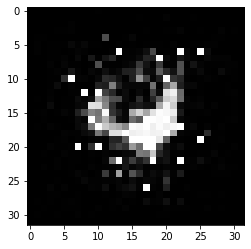

-------------------------------------


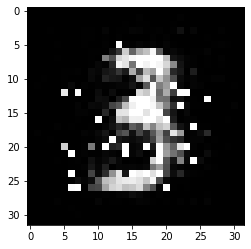

-------------------------------------


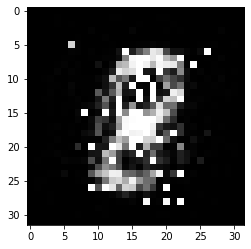

-------------------------------------


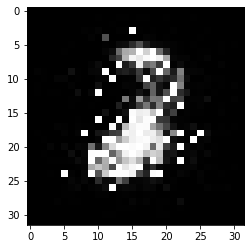

-------------------------------------


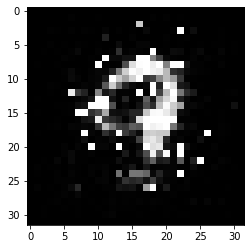

-------------------------------------


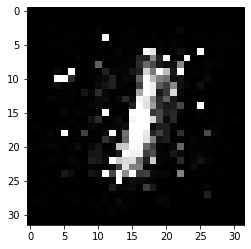

-------------------------------------


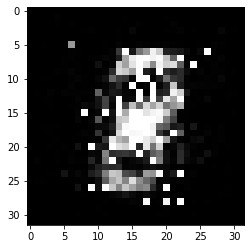

-------------------------------------


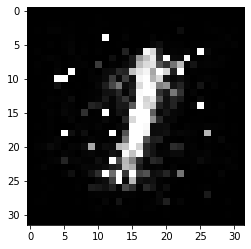

-------------------------------------


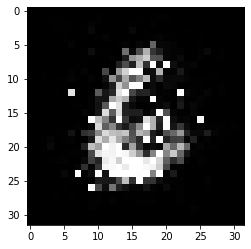

-------------------------------------


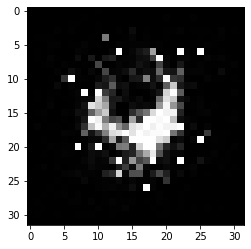

-------------------------------------


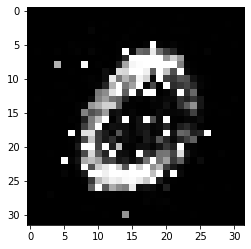

-------------------------------------


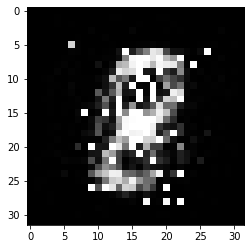

-------------------------------------


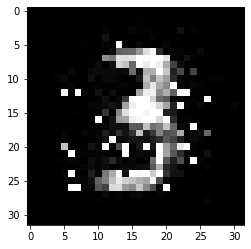

-------------------------------------


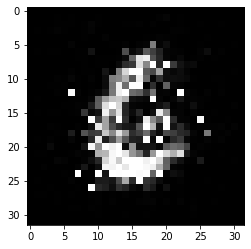

-------------------------------------


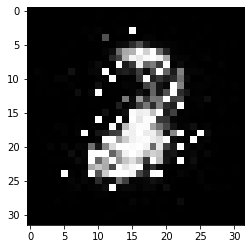

-------------------------------------


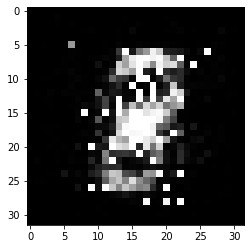

-------------------------------------


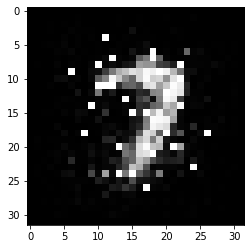

-------------------------------------


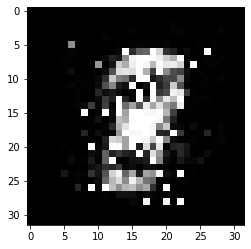

-------------------------------------


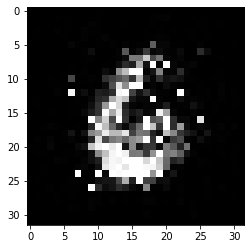

-------------------------------------


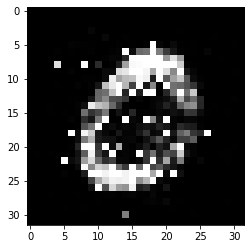

-------------------------------------


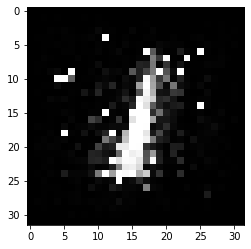

-------------------------------------


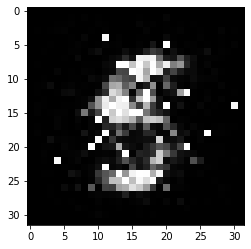

-------------------------------------


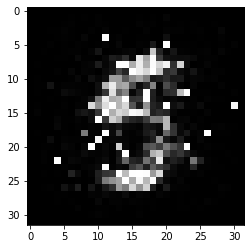

-------------------------------------


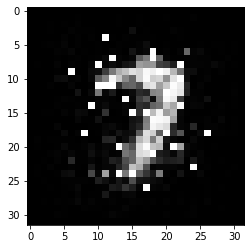

-------------------------------------


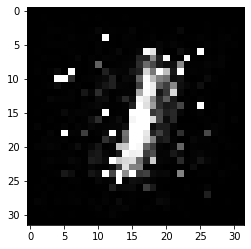

-------------------------------------


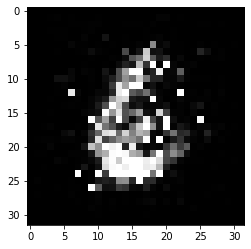

-------------------------------------


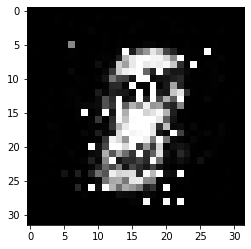

-------------------------------------


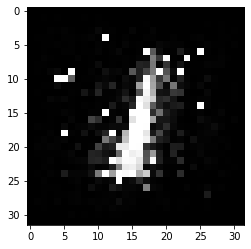

-------------------------------------


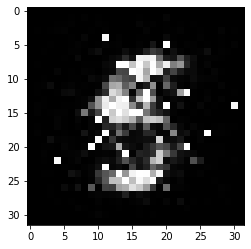

-------------------------------------


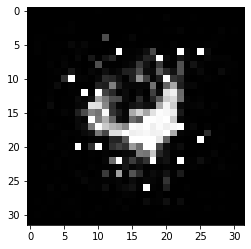

-------------------------------------


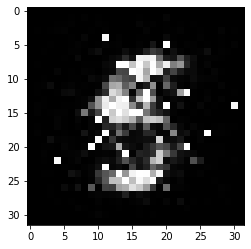

-------------------------------------


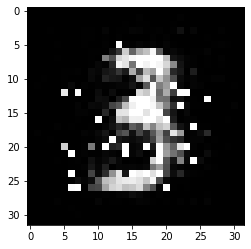

-------------------------------------


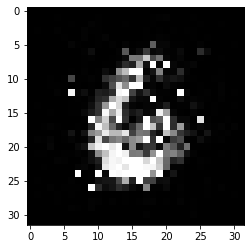

-------------------------------------


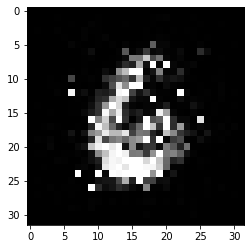

-------------------------------------


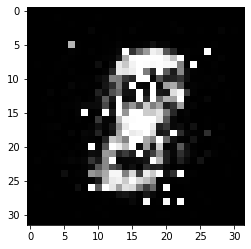

-------------------------------------


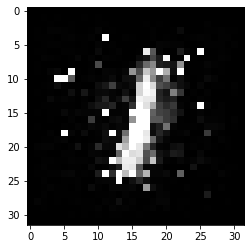

-------------------------------------


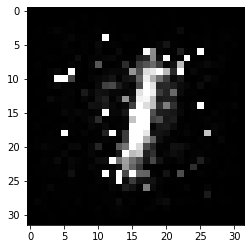

-------------------------------------


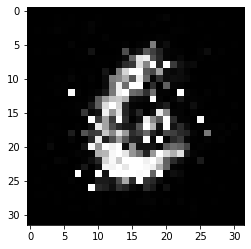

-------------------------------------


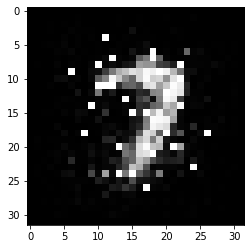

-------------------------------------


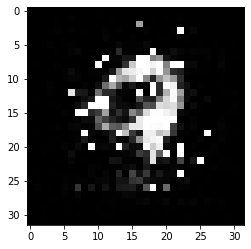

-------------------------------------


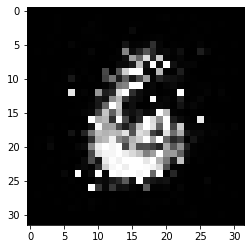

-------------------------------------


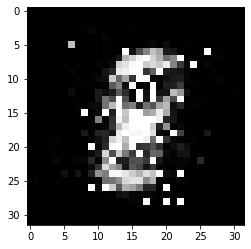

-------------------------------------


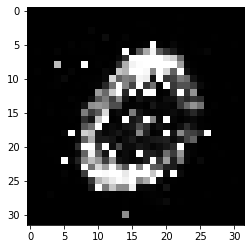

-------------------------------------


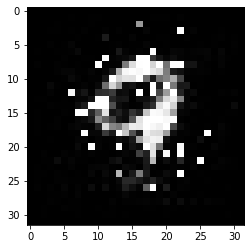

-------------------------------------


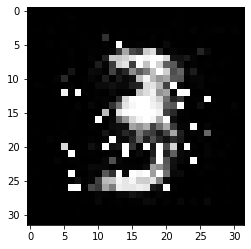

-------------------------------------


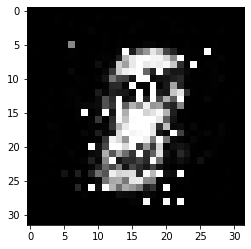

-------------------------------------


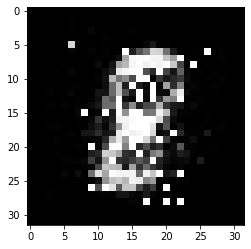

-------------------------------------


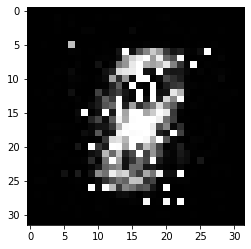

-------------------------------------


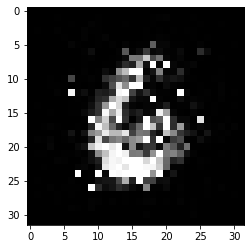

-------------------------------------


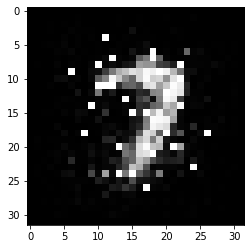

-------------------------------------


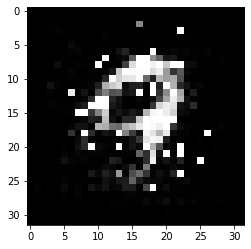

-------------------------------------


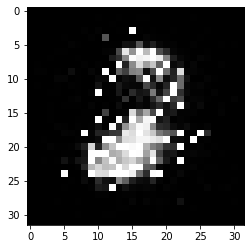

-------------------------------------


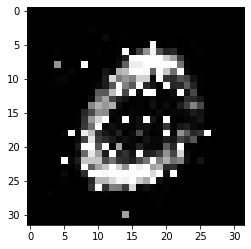

-------------------------------------


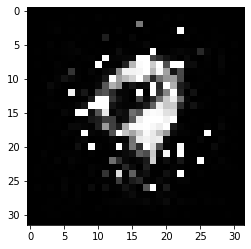

-------------------------------------


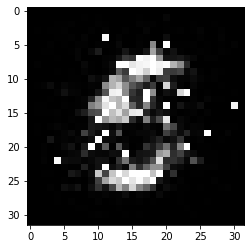

-------------------------------------


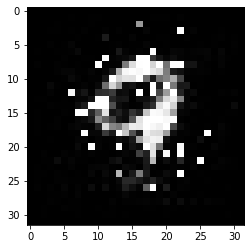

-------------------------------------


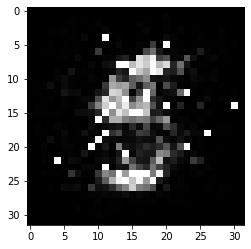

-------------------------------------


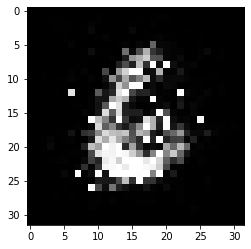

-------------------------------------


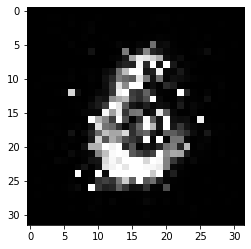

-------------------------------------


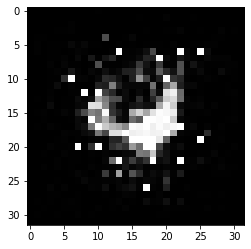

-------------------------------------


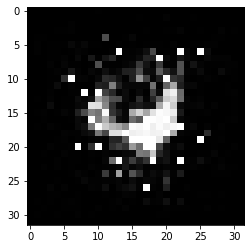

-------------------------------------


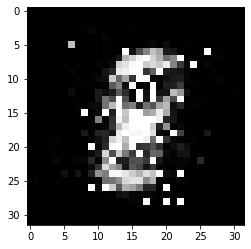

-------------------------------------


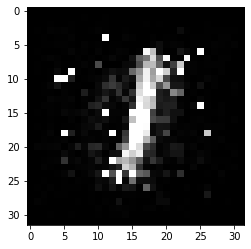

-------------------------------------


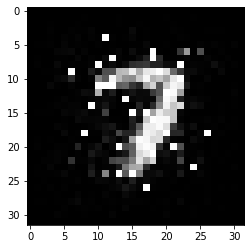

-------------------------------------


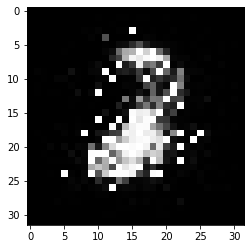

-------------------------------------


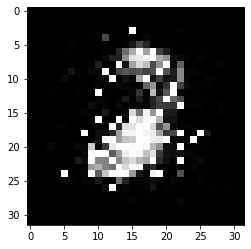

-------------------------------------


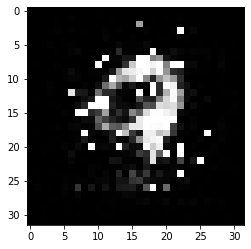

-------------------------------------


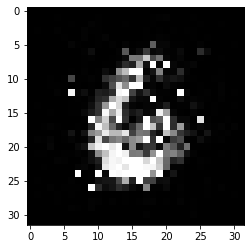

-------------------------------------


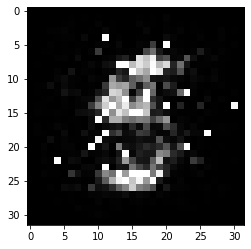

-------------------------------------


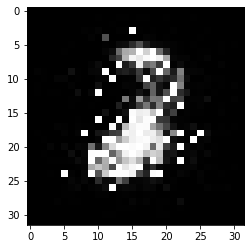

-------------------------------------


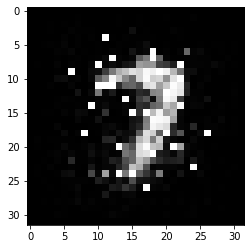

-------------------------------------


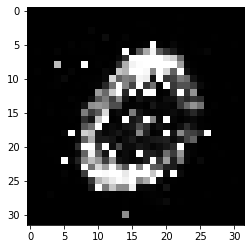

-------------------------------------


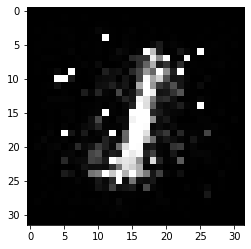

-------------------------------------


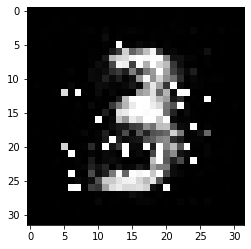

-------------------------------------


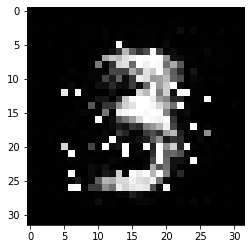

-------------------------------------


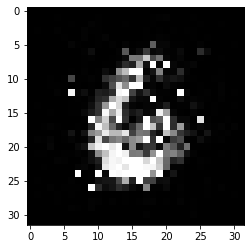

-------------------------------------


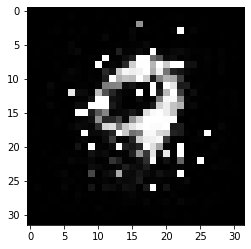

-------------------------------------


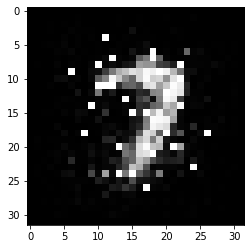

-------------------------------------


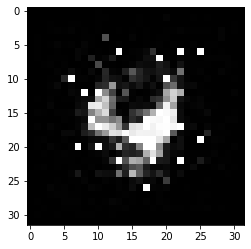

-------------------------------------


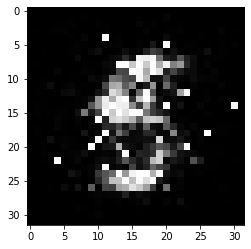

-------------------------------------


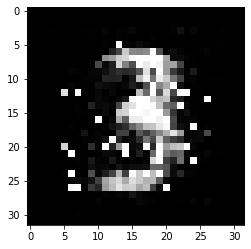

-------------------------------------


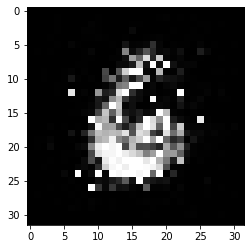

-------------------------------------


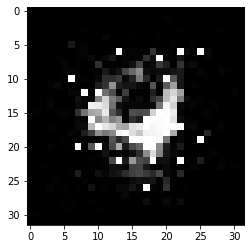

-------------------------------------


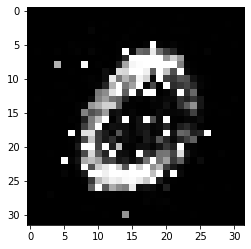

-------------------------------------


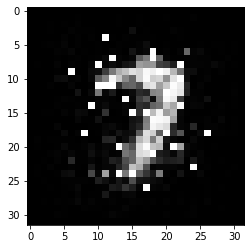

-------------------------------------


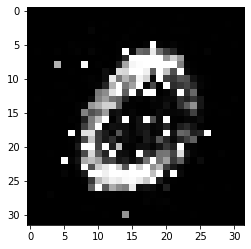

-------------------------------------


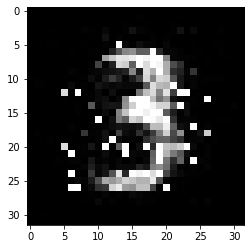

-------------------------------------


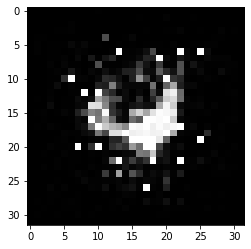

-------------------------------------


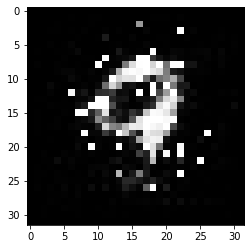

-------------------------------------


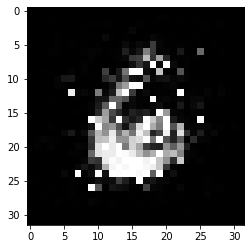

-------------------------------------


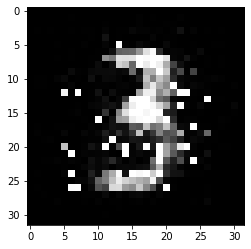

-------------------------------------


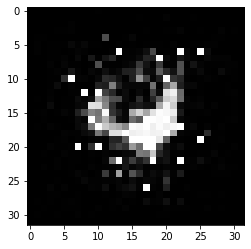

-------------------------------------


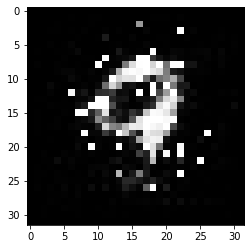

-------------------------------------


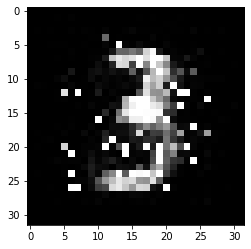

-------------------------------------


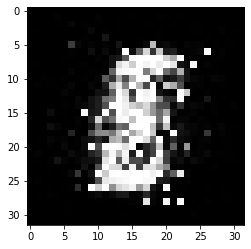

-------------------------------------


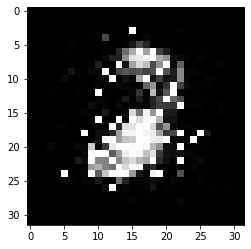

-------------------------------------


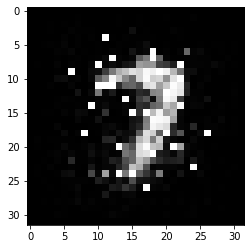

-------------------------------------


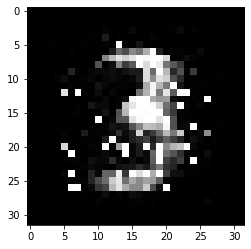

-------------------------------------


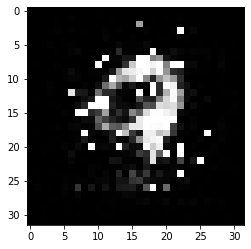

-------------------------------------


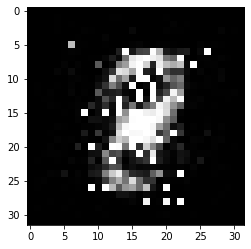

-------------------------------------


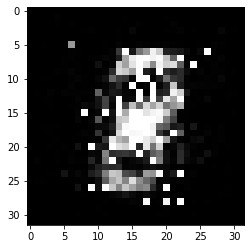

-------------------------------------


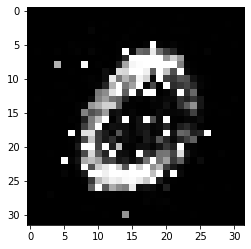

-------------------------------------


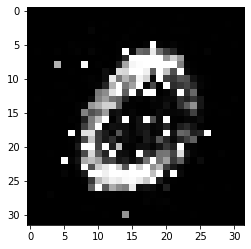

-------------------------------------


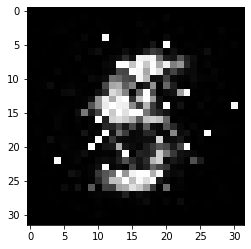

-------------------------------------


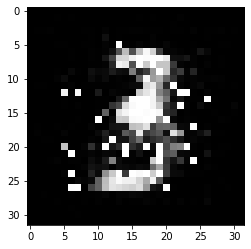

-------------------------------------


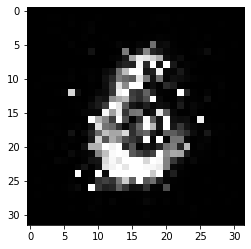

-------------------------------------


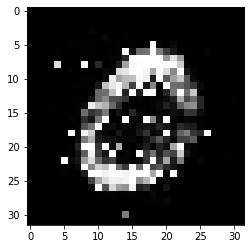

-------------------------------------


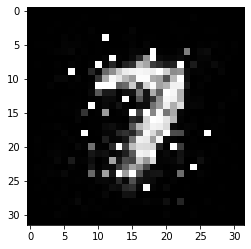

-------------------------------------


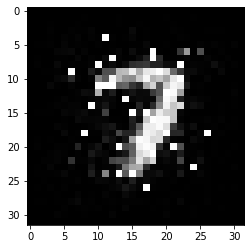

-------------------------------------


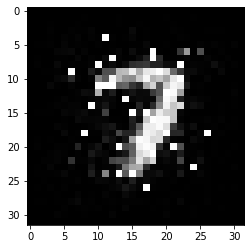

-------------------------------------


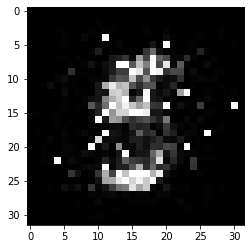

-------------------------------------


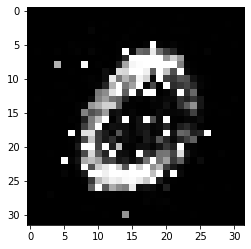

-------------------------------------


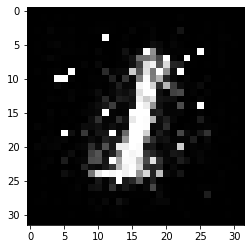

-------------------------------------


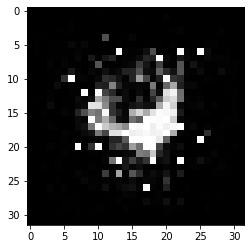

-------------------------------------


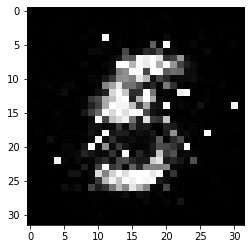

-------------------------------------


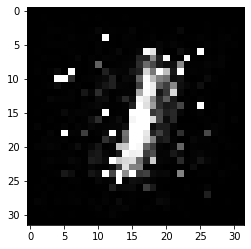

-------------------------------------


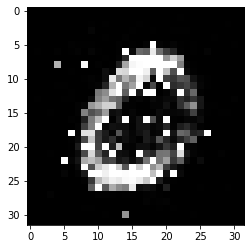

-------------------------------------


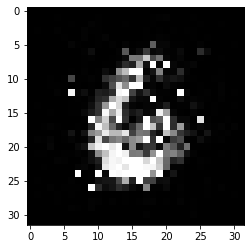

-------------------------------------


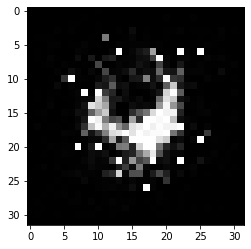

-------------------------------------


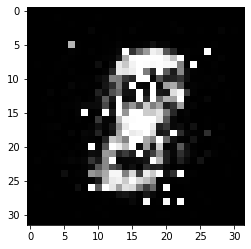

-------------------------------------


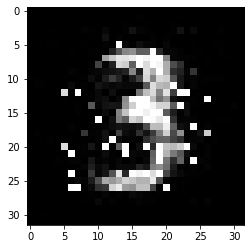

-------------------------------------


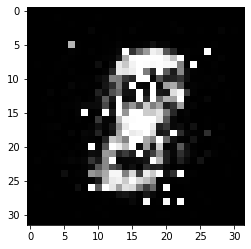

-------------------------------------


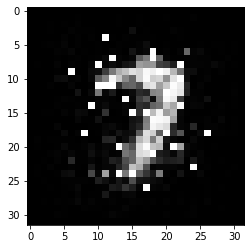

-------------------------------------


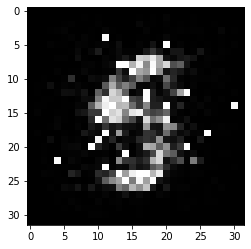

-------------------------------------


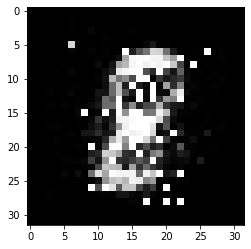

-------------------------------------


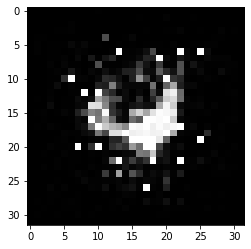

-------------------------------------


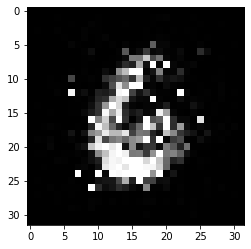

-------------------------------------


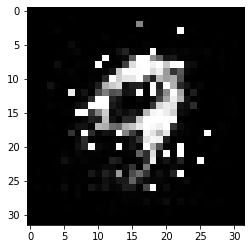

-------------------------------------


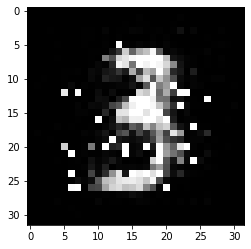

-------------------------------------


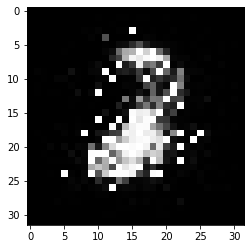

-------------------------------------


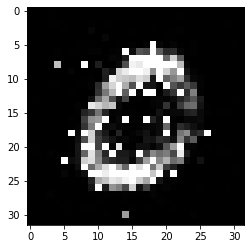

-------------------------------------


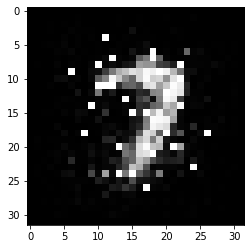

-------------------------------------


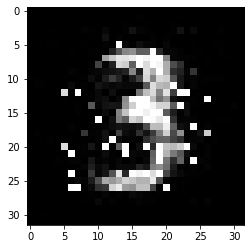

-------------------------------------


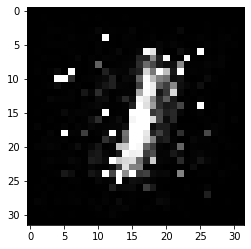

-------------------------------------


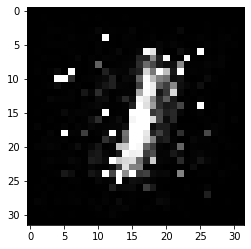

-------------------------------------


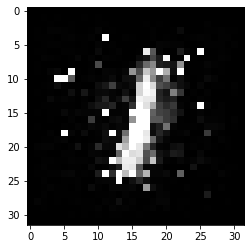

-------------------------------------


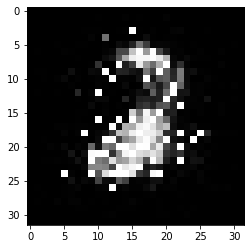

-------------------------------------


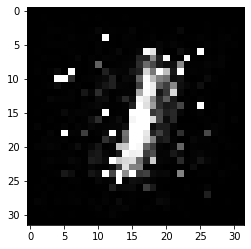

-------------------------------------


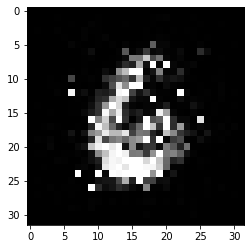

-------------------------------------


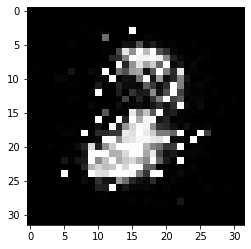

-------------------------------------


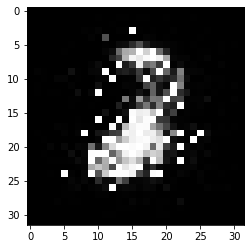

-------------------------------------


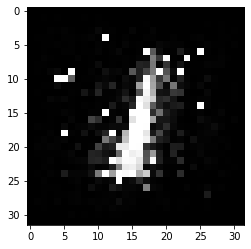

-------------------------------------


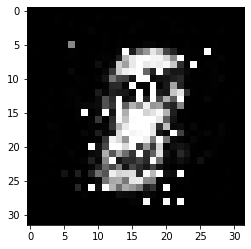

-------------------------------------


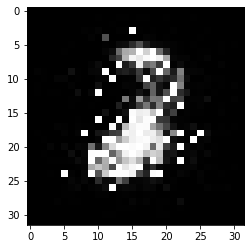

-------------------------------------


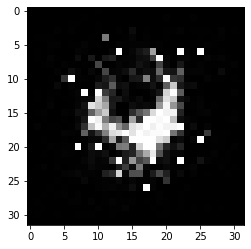

-------------------------------------


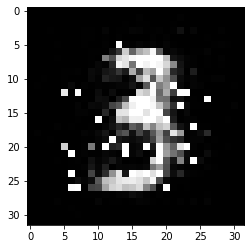

-------------------------------------


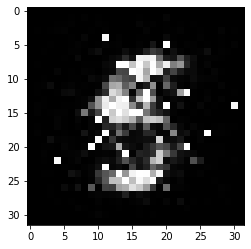

-------------------------------------


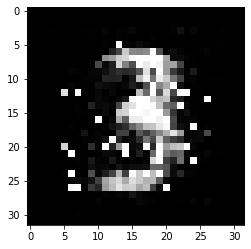

-------------------------------------


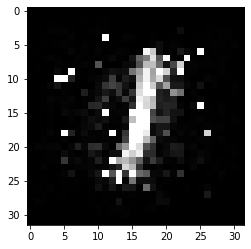

-------------------------------------


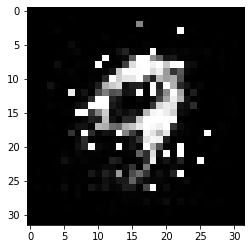

-------------------------------------


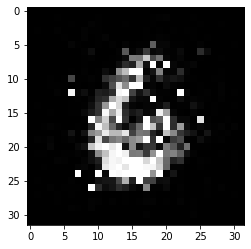

-------------------------------------


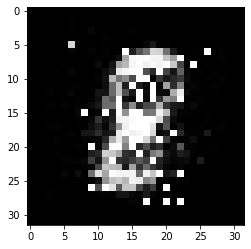

-------------------------------------


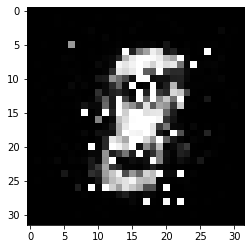

-------------------------------------


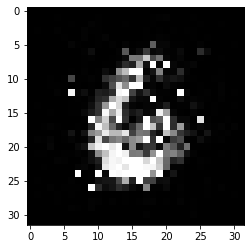

-------------------------------------


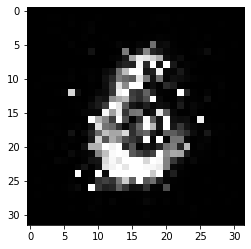

-------------------------------------


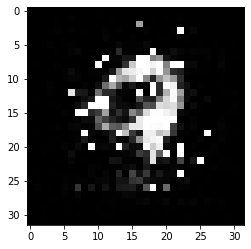

-------------------------------------


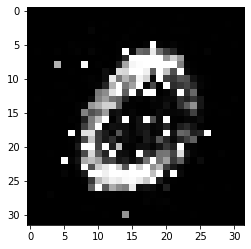

-------------------------------------


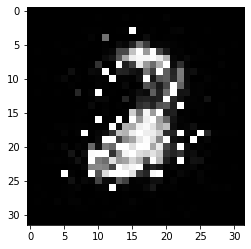

-------------------------------------


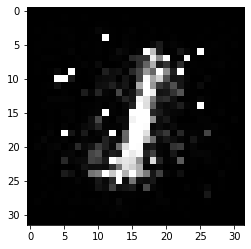

-------------------------------------


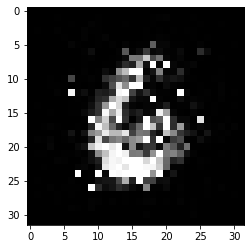

-------------------------------------


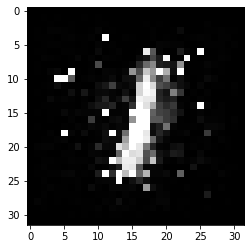

-------------------------------------


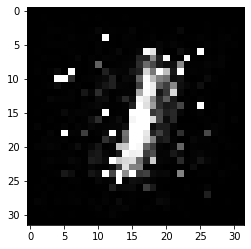

-------------------------------------


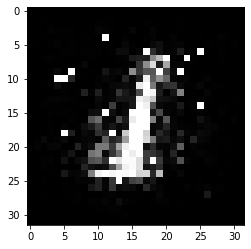

-------------------------------------


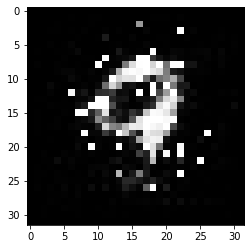

-------------------------------------


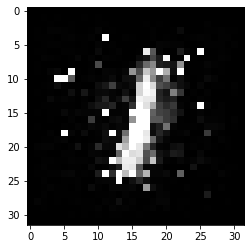

-------------------------------------


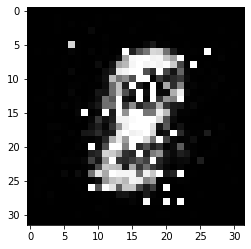

-------------------------------------


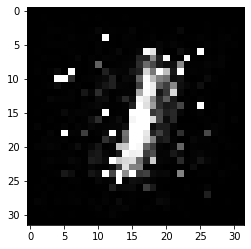

-------------------------------------


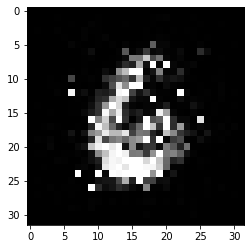

-------------------------------------


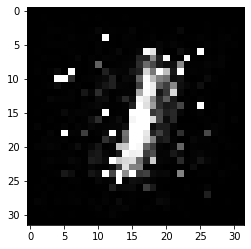

-------------------------------------


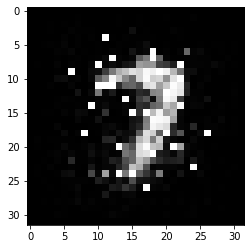

-------------------------------------


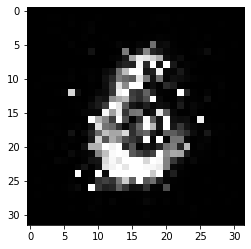

-------------------------------------


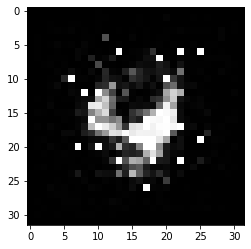

-------------------------------------


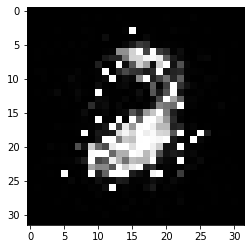

-------------------------------------


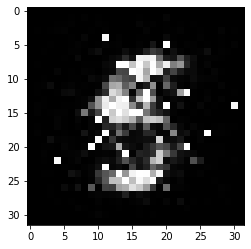

-------------------------------------


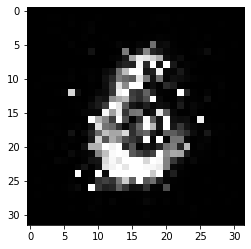

-------------------------------------


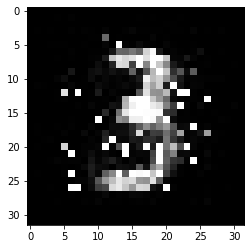

-------------------------------------


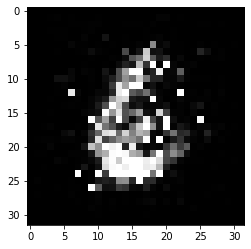

-------------------------------------


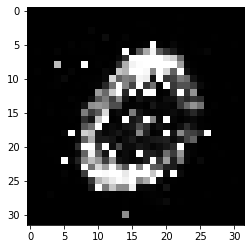

-------------------------------------


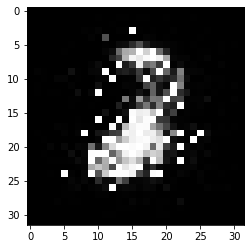

-------------------------------------


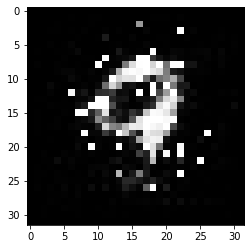

-------------------------------------


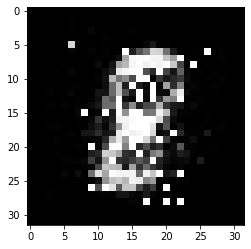

-------------------------------------


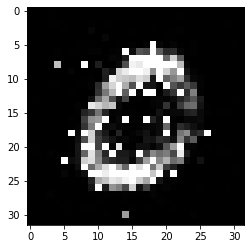

-------------------------------------


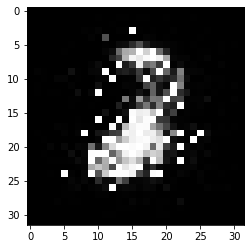

-------------------------------------


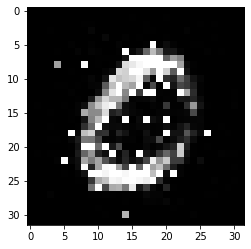

-------------------------------------


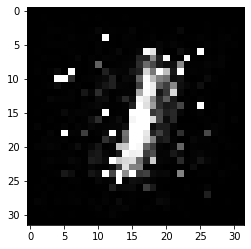

-------------------------------------


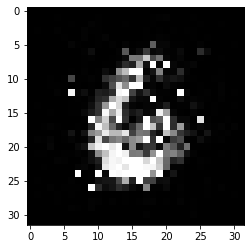

-------------------------------------


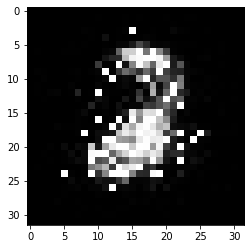

-------------------------------------


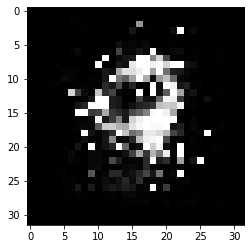

-------------------------------------


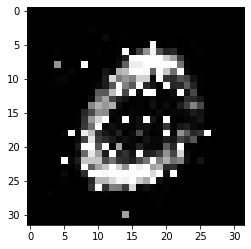

-------------------------------------


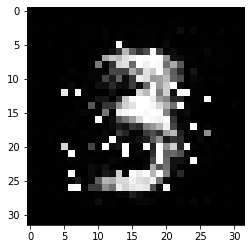

-------------------------------------


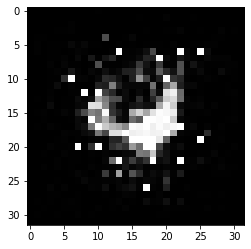

-------------------------------------


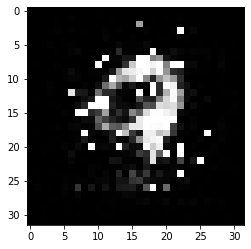

-------------------------------------


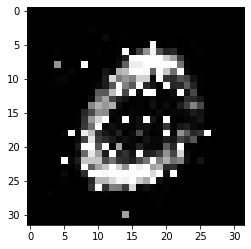

-------------------------------------


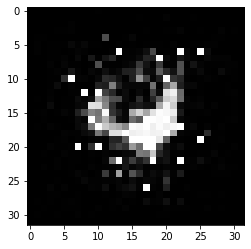

-------------------------------------


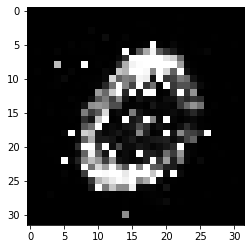

-------------------------------------


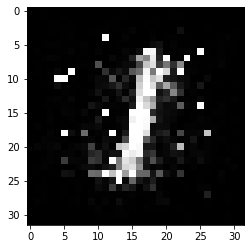

-------------------------------------


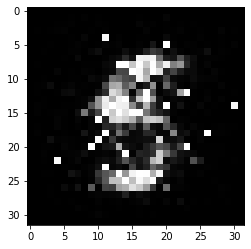

-------------------------------------


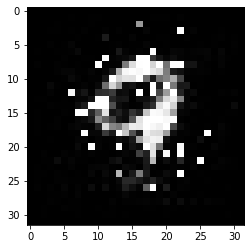

-------------------------------------


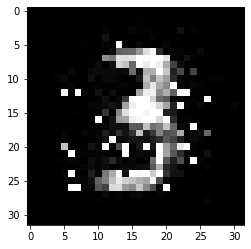

-------------------------------------


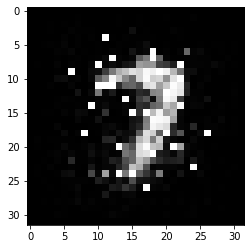

-------------------------------------


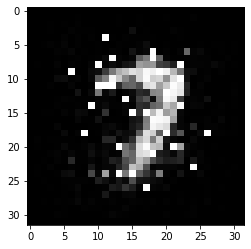

-------------------------------------


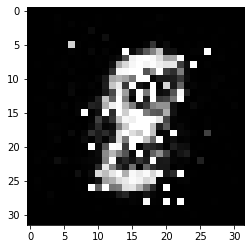

-------------------------------------


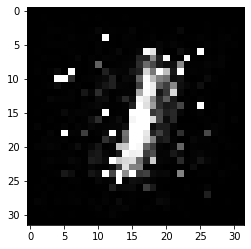

-------------------------------------


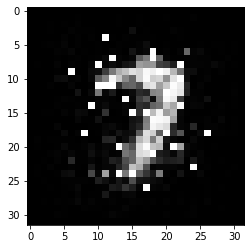

-------------------------------------


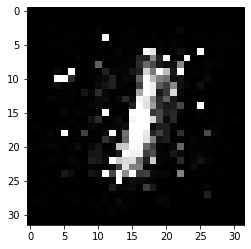

-------------------------------------


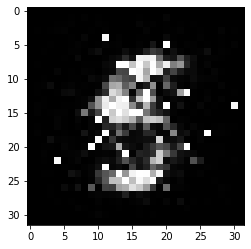

-------------------------------------


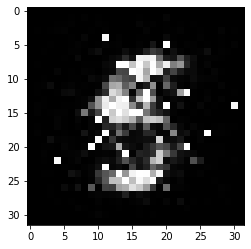

-------------------------------------


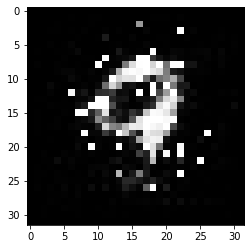

-------------------------------------


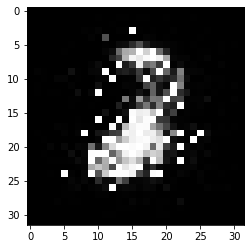

-------------------------------------


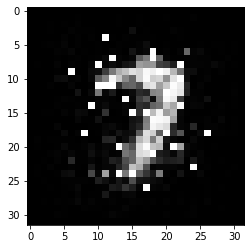

-------------------------------------


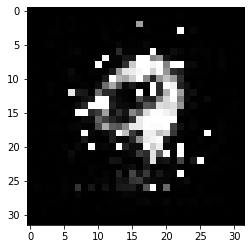

-------------------------------------


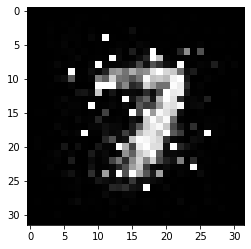

-------------------------------------


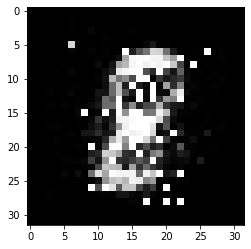

-------------------------------------


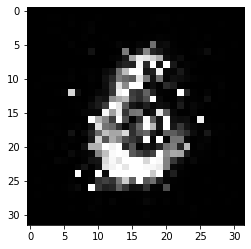

-------------------------------------


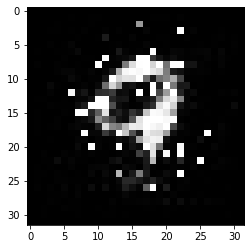

-------------------------------------


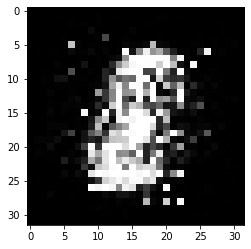

-------------------------------------


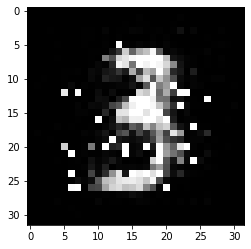

-------------------------------------


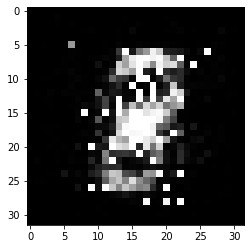

-------------------------------------


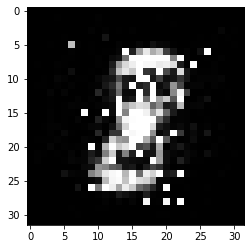

-------------------------------------


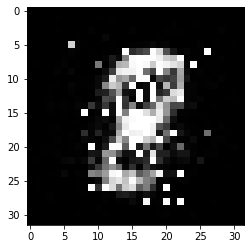

-------------------------------------


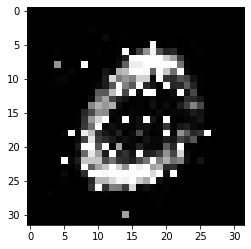

-------------------------------------


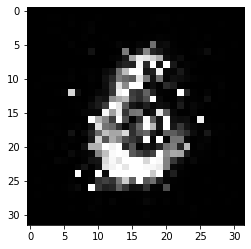

-------------------------------------


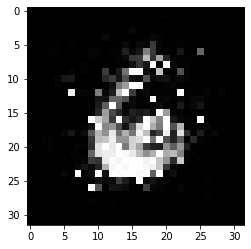

-------------------------------------


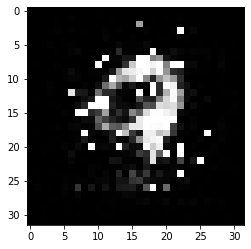

-------------------------------------


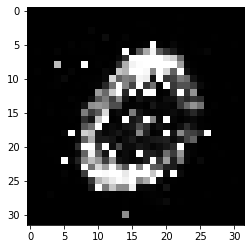

-------------------------------------


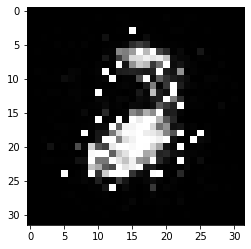

-------------------------------------


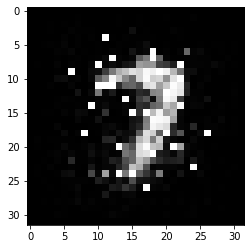

-------------------------------------


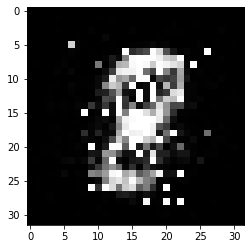

-------------------------------------


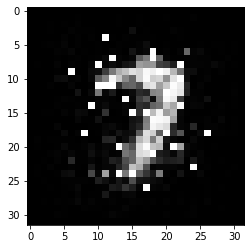

-------------------------------------


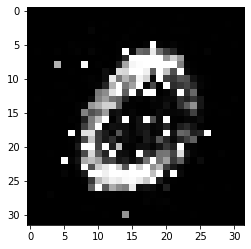

-------------------------------------


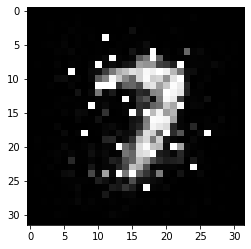

-------------------------------------


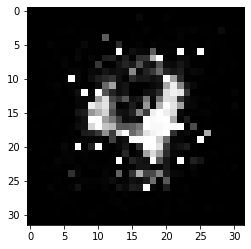

-------------------------------------


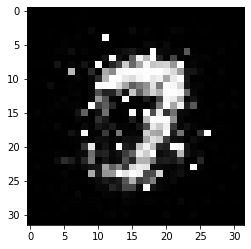

-------------------------------------


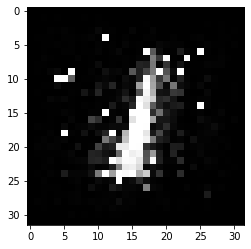

-------------------------------------


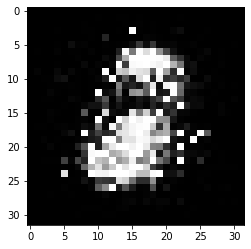

-------------------------------------


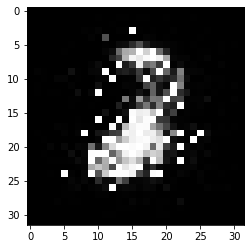

-------------------------------------


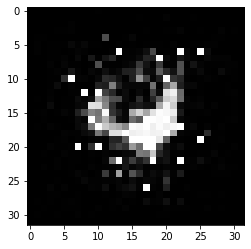

-------------------------------------


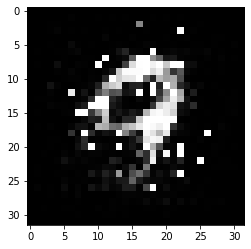

-------------------------------------


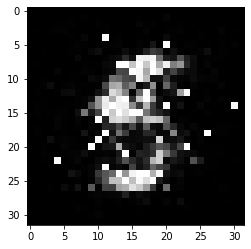

-------------------------------------


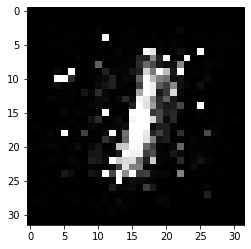

-------------------------------------


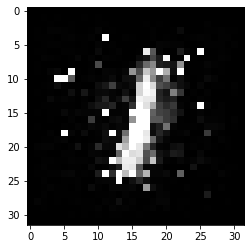

-------------------------------------


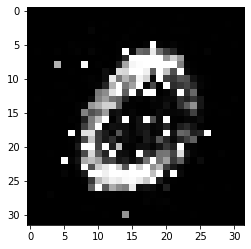

-------------------------------------


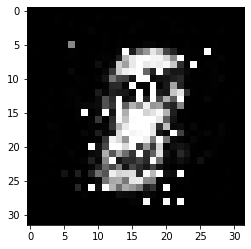

-------------------------------------


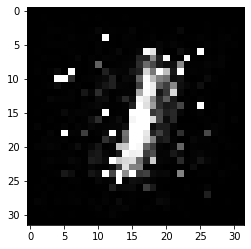

-------------------------------------


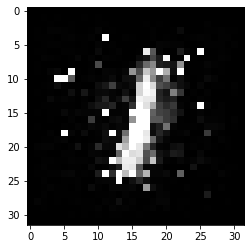

-------------------------------------


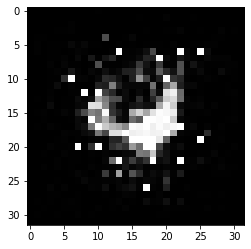

-------------------------------------


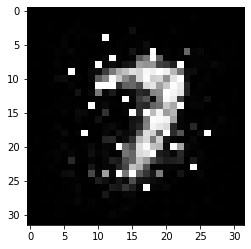

-------------------------------------


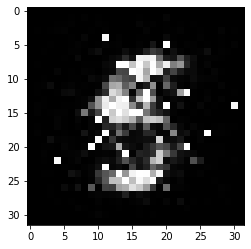

-------------------------------------


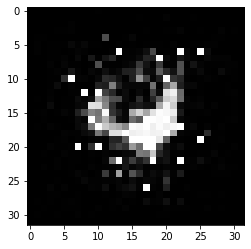

-------------------------------------


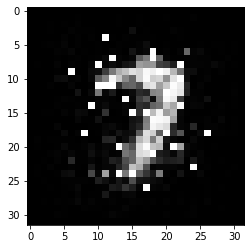

-------------------------------------


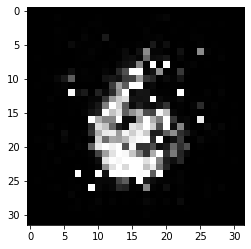

-------------------------------------


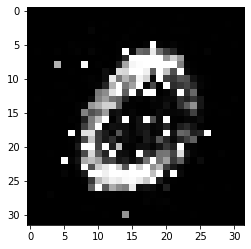

-------------------------------------


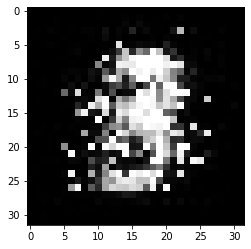

-------------------------------------


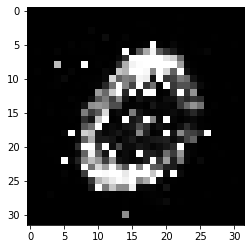

-------------------------------------


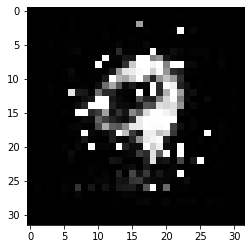

-------------------------------------


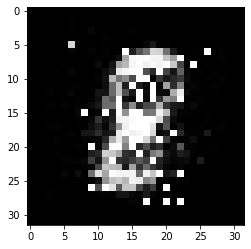

-------------------------------------


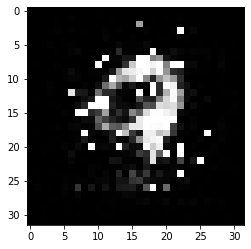

-------------------------------------


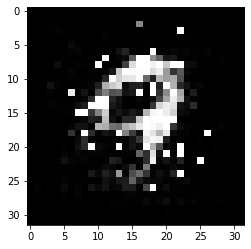

-------------------------------------


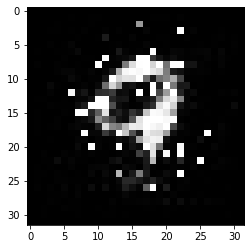

-------------------------------------


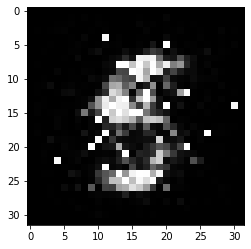

-------------------------------------


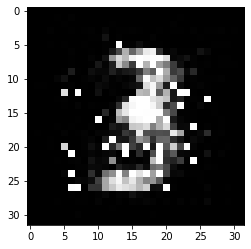

-------------------------------------


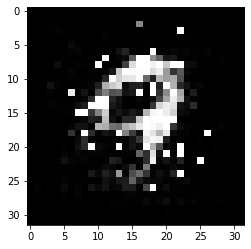

-------------------------------------


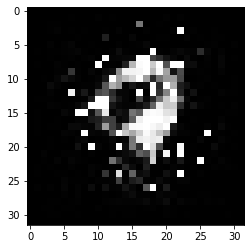

-------------------------------------


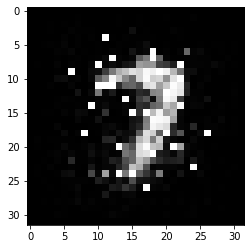

-------------------------------------


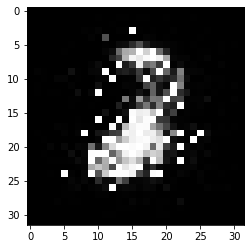

-------------------------------------


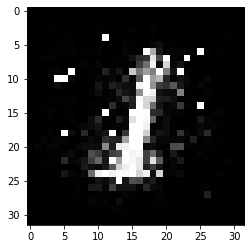

-------------------------------------


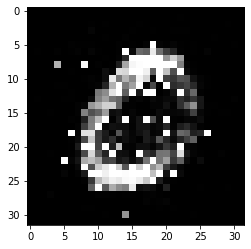

-------------------------------------


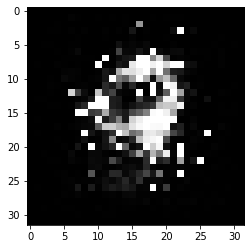

-------------------------------------


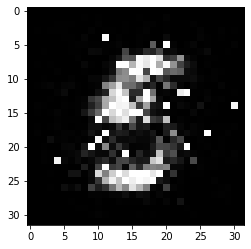

-------------------------------------


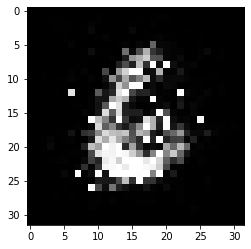

-------------------------------------


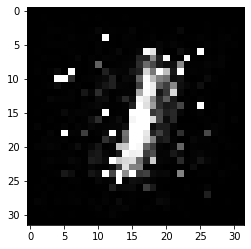

-------------------------------------


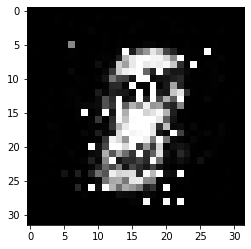

-------------------------------------


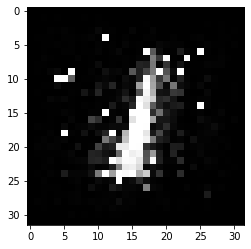

-------------------------------------


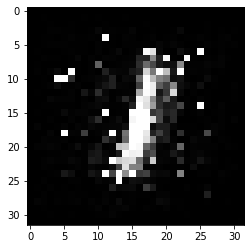

-------------------------------------


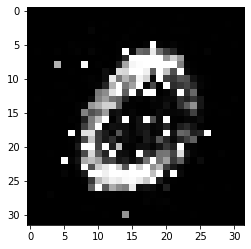

-------------------------------------


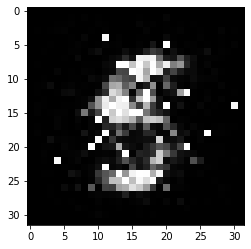

-------------------------------------


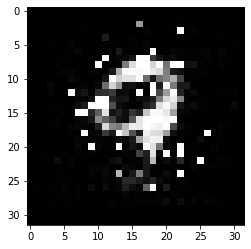

-------------------------------------


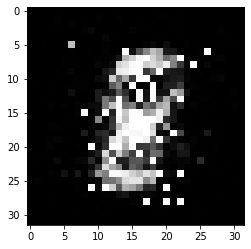

-------------------------------------


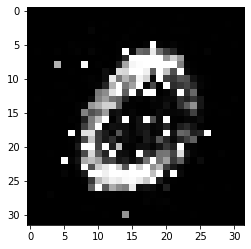

-------------------------------------


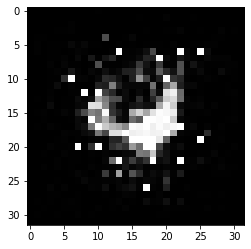

-------------------------------------


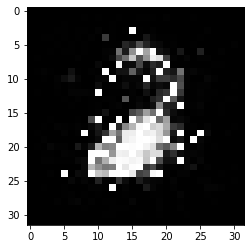

-------------------------------------


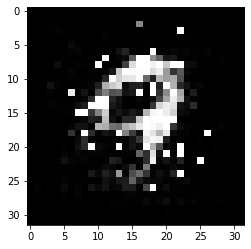

-------------------------------------


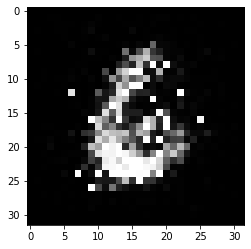

-------------------------------------


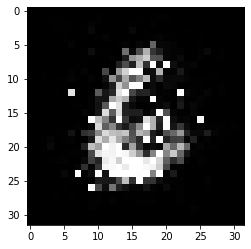

-------------------------------------


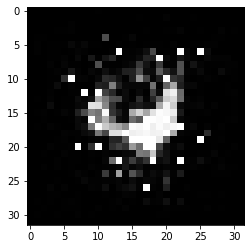

-------------------------------------


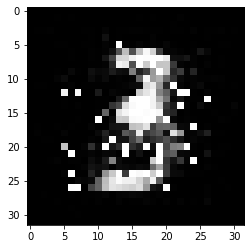

-------------------------------------


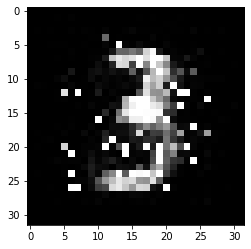

-------------------------------------


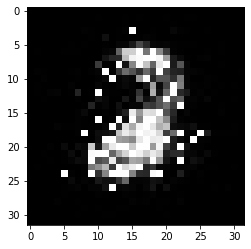

-------------------------------------


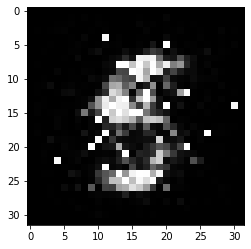

-------------------------------------


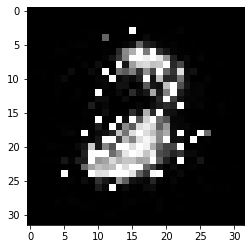

-------------------------------------


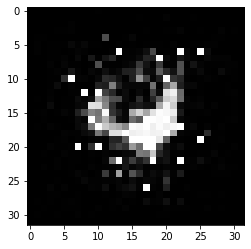

-------------------------------------


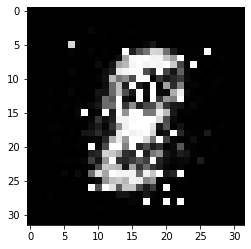

-------------------------------------


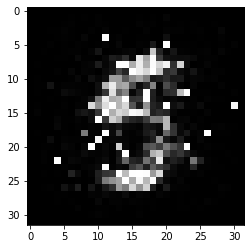

-------------------------------------


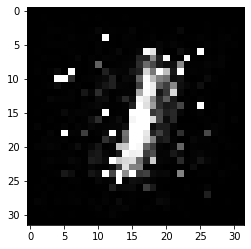

-------------------------------------


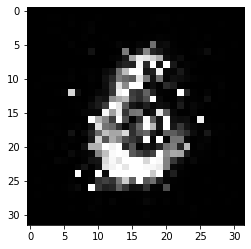

-------------------------------------


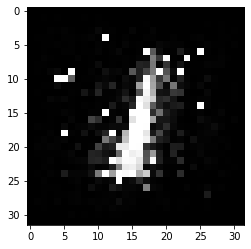

-------------------------------------


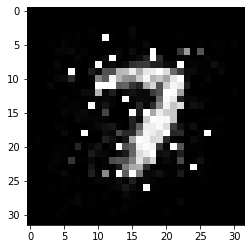

-------------------------------------


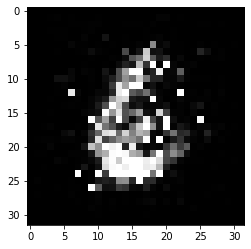

-------------------------------------


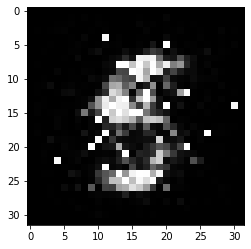

-------------------------------------


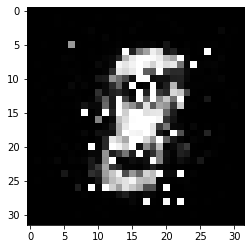

-------------------------------------


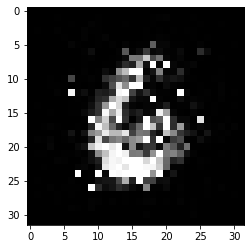

-------------------------------------


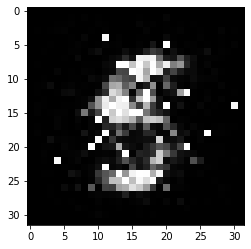

-------------------------------------


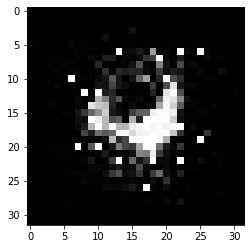

-------------------------------------


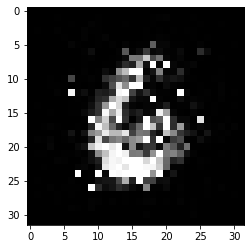

-------------------------------------


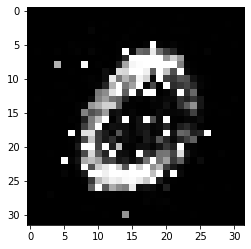

-------------------------------------


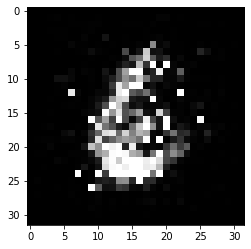

-------------------------------------


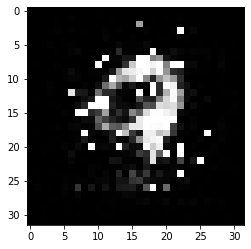

-------------------------------------


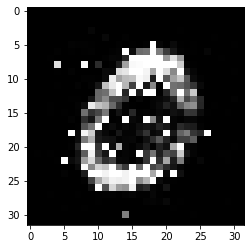

-------------------------------------


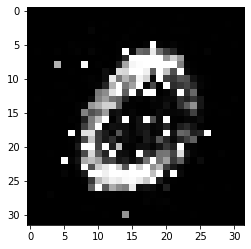

-------------------------------------


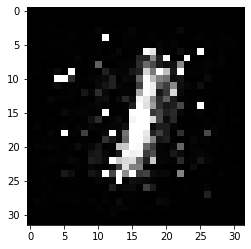

-------------------------------------


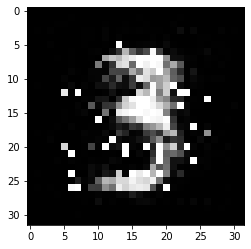

-------------------------------------


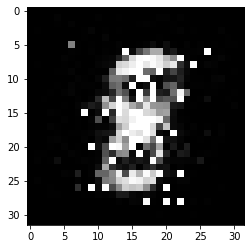

-------------------------------------


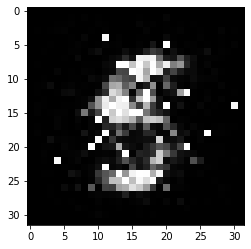

-------------------------------------


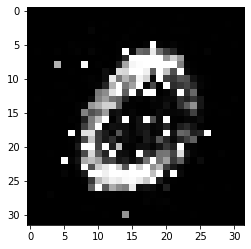

-------------------------------------


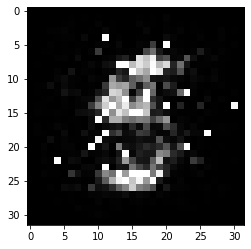

-------------------------------------


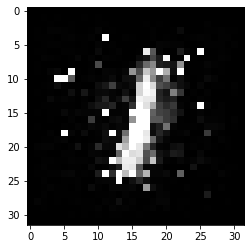

-------------------------------------


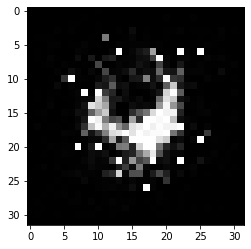

-------------------------------------


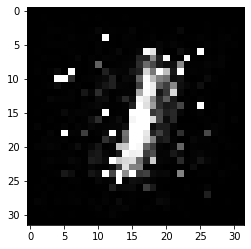

-------------------------------------


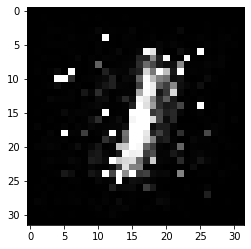

-------------------------------------


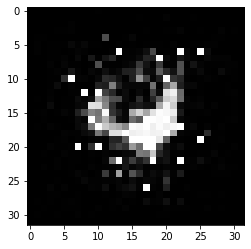

-------------------------------------


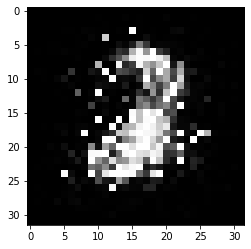

-------------------------------------


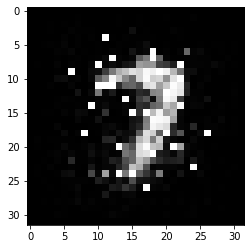

-------------------------------------


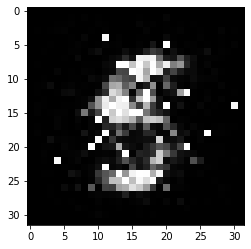

-------------------------------------


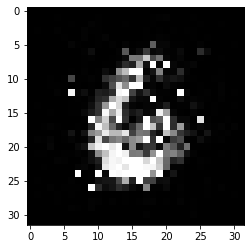

-------------------------------------


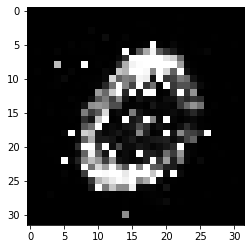

-------------------------------------


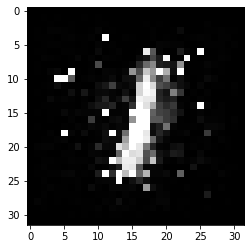

-------------------------------------


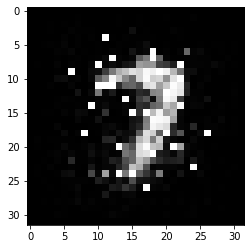

-------------------------------------


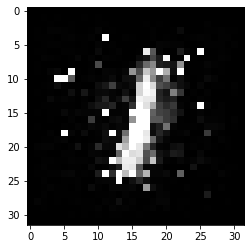

-------------------------------------


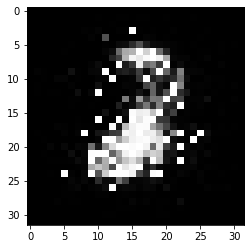

-------------------------------------


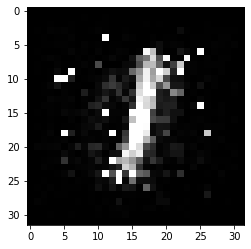

-------------------------------------


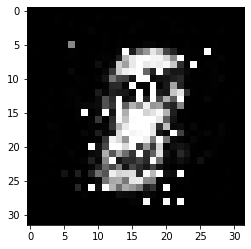

-------------------------------------


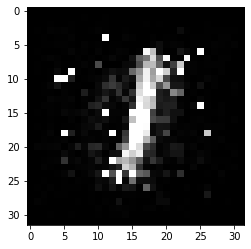

-------------------------------------


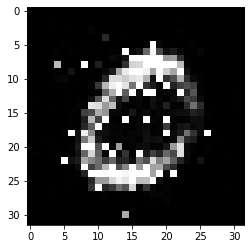

-------------------------------------


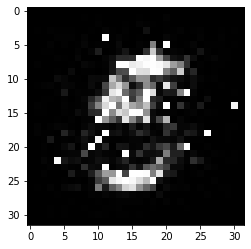

-------------------------------------


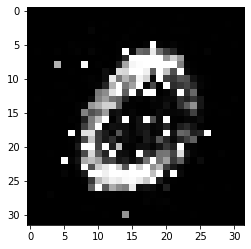

-------------------------------------


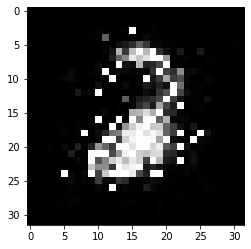

-------------------------------------


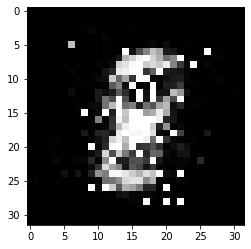

-------------------------------------


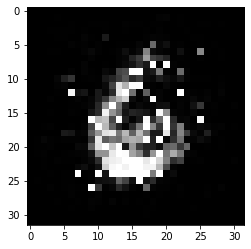

-------------------------------------


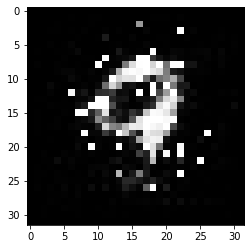

-------------------------------------


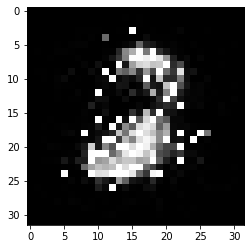

-------------------------------------


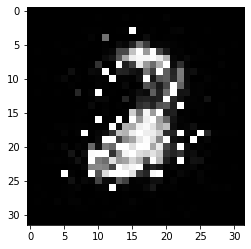

-------------------------------------


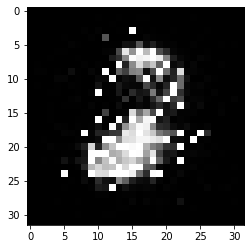

-------------------------------------


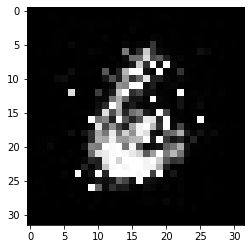

-------------------------------------


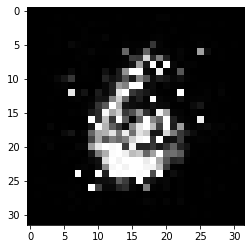

-------------------------------------


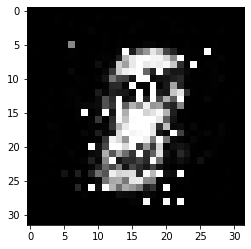

-------------------------------------


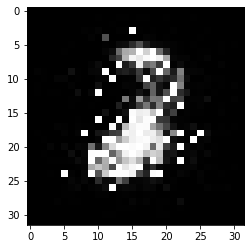

-------------------------------------


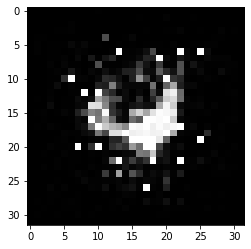

-------------------------------------


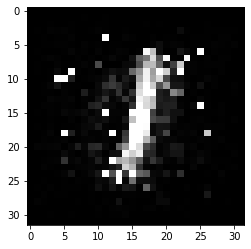

-------------------------------------


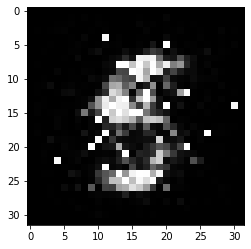

-------------------------------------


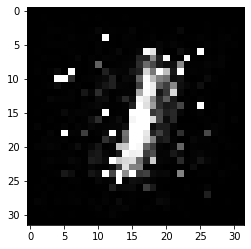

-------------------------------------


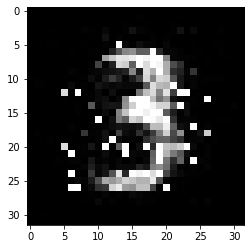

-------------------------------------


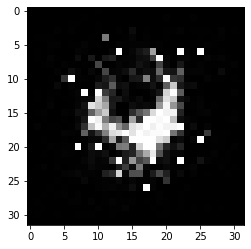

-------------------------------------


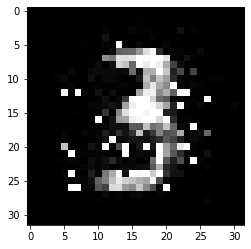

-------------------------------------


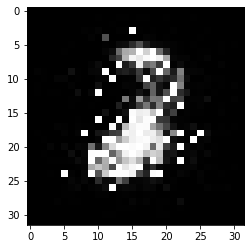

-------------------------------------


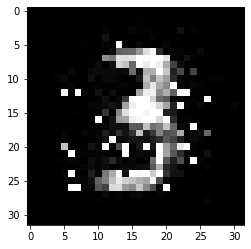

-------------------------------------


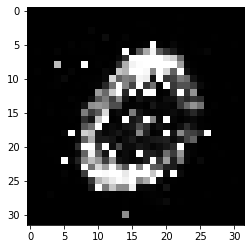

-------------------------------------


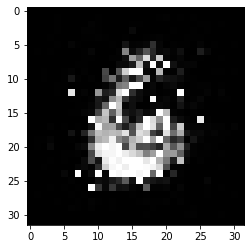

-------------------------------------


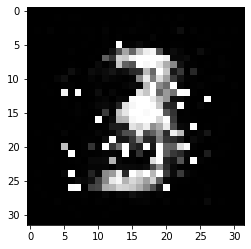

-------------------------------------


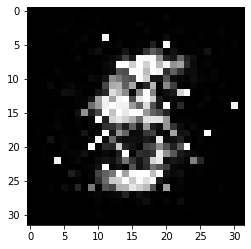

-------------------------------------


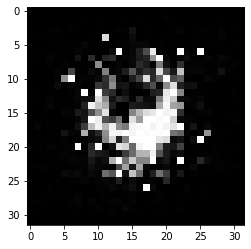

-------------------------------------


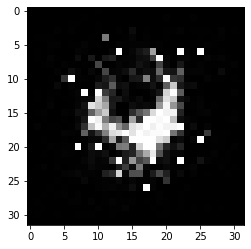

-------------------------------------


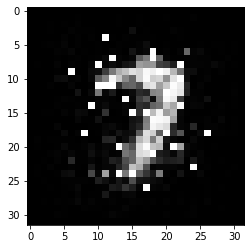

-------------------------------------


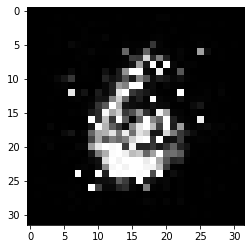

-------------------------------------


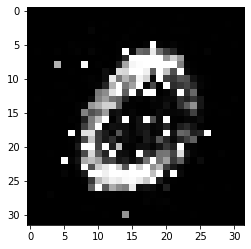

-------------------------------------


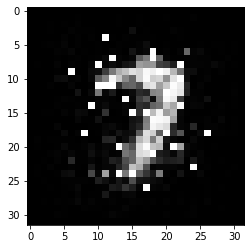

-------------------------------------


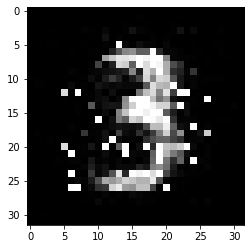

-------------------------------------


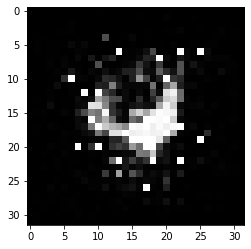

-------------------------------------


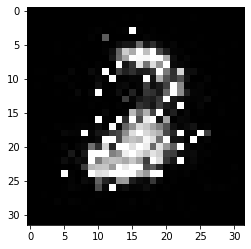

-------------------------------------


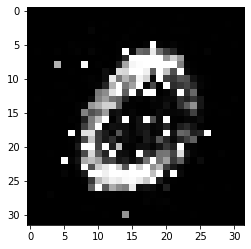

-------------------------------------


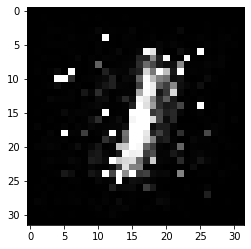

-------------------------------------


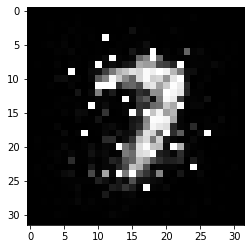

-------------------------------------


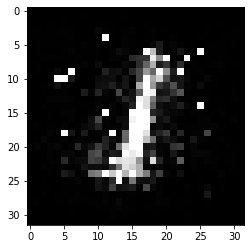

-------------------------------------


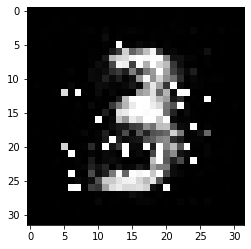

-------------------------------------


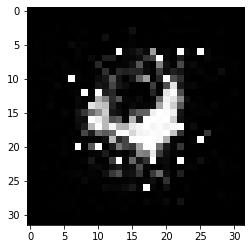

-------------------------------------


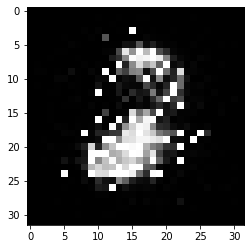

-------------------------------------


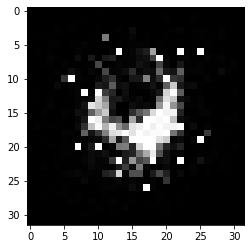

-------------------------------------


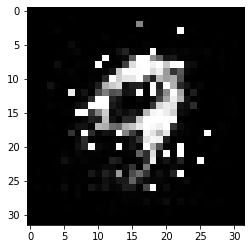

-------------------------------------


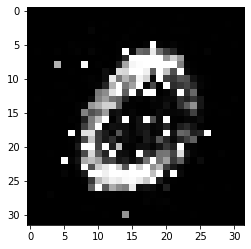

-------------------------------------


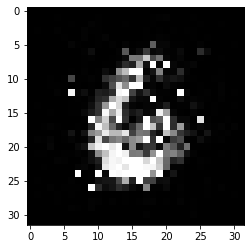

-------------------------------------


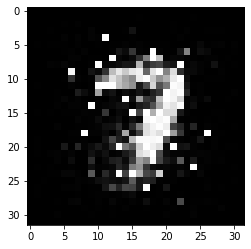

-------------------------------------


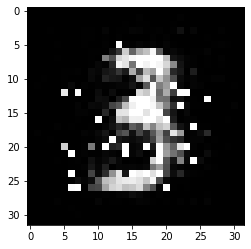

-------------------------------------


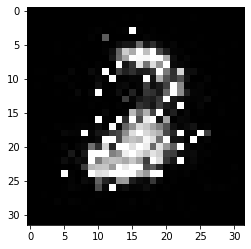

-------------------------------------


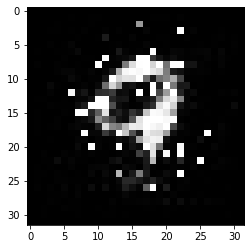

-------------------------------------


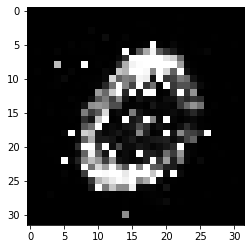

-------------------------------------


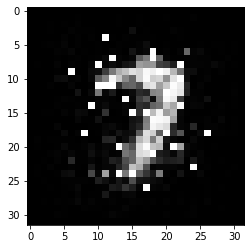

-------------------------------------


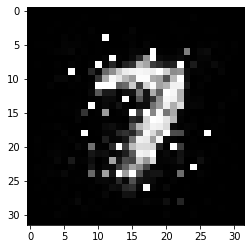

-------------------------------------


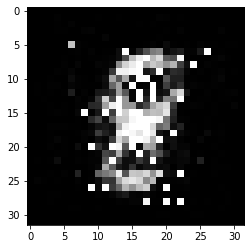

-------------------------------------


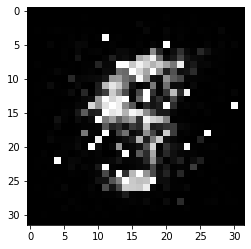

-------------------------------------


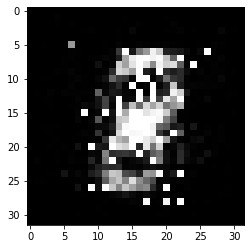

-------------------------------------


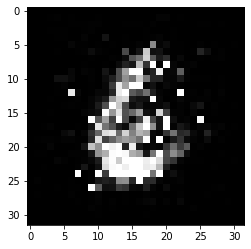

-------------------------------------


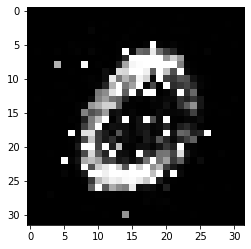

-------------------------------------


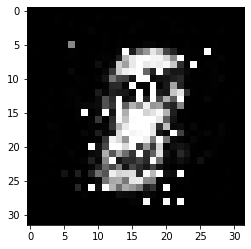

-------------------------------------


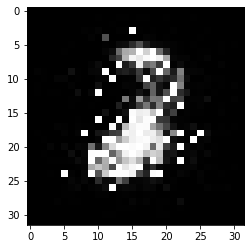

-------------------------------------


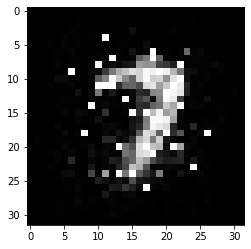

-------------------------------------


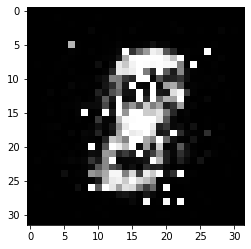

-------------------------------------


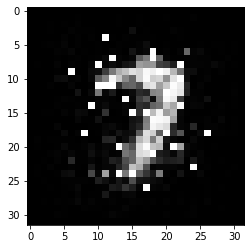

-------------------------------------


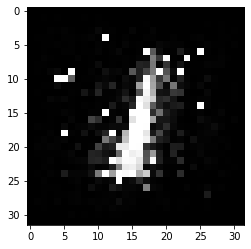

-------------------------------------


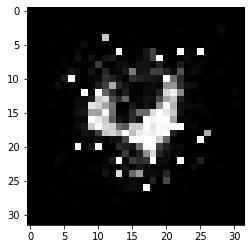

-------------------------------------


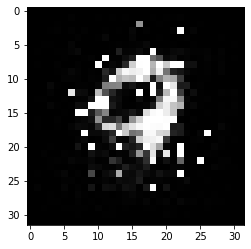

-------------------------------------


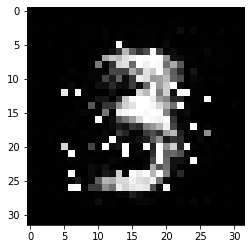

-------------------------------------


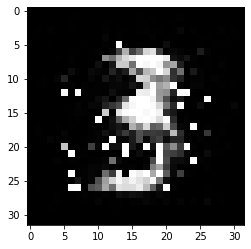

-------------------------------------


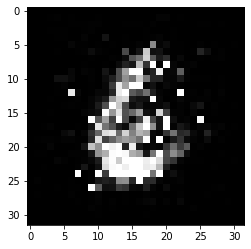

-------------------------------------


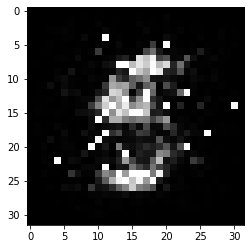

-------------------------------------


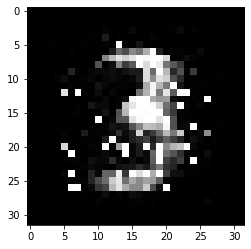

-------------------------------------


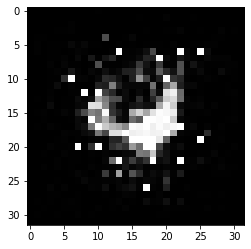

-------------------------------------


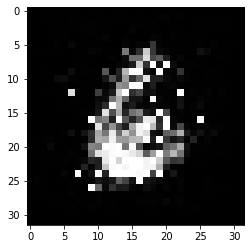

-------------------------------------


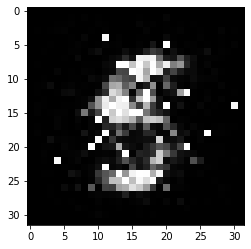

-------------------------------------


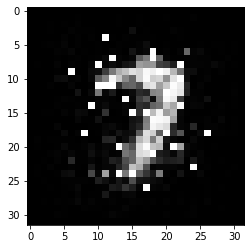

-------------------------------------


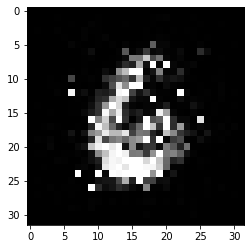

-------------------------------------


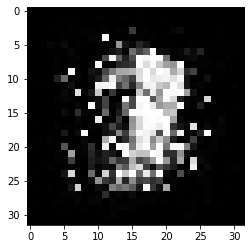

-------------------------------------


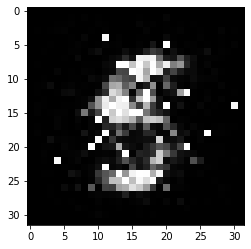

-------------------------------------


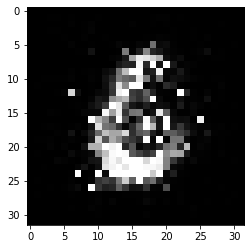

-------------------------------------


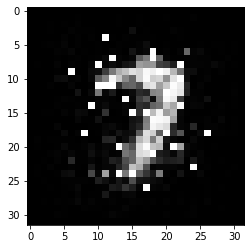

-------------------------------------


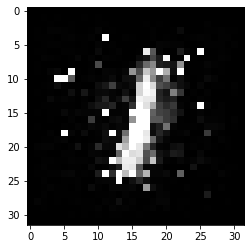

-------------------------------------


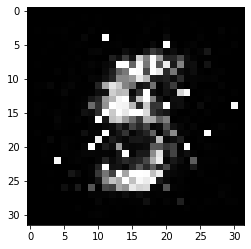

-------------------------------------


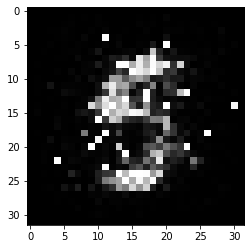

-------------------------------------


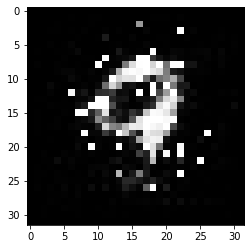

-------------------------------------


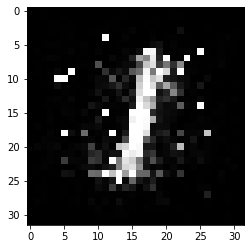

-------------------------------------


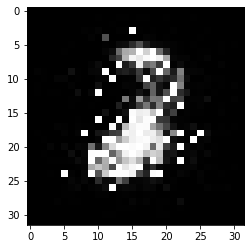

-------------------------------------


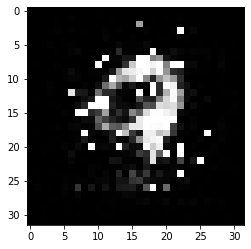

-------------------------------------


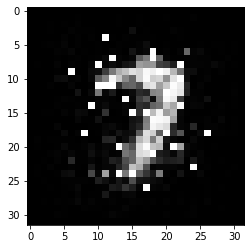

-------------------------------------


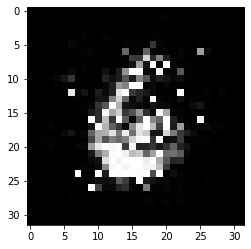

-------------------------------------


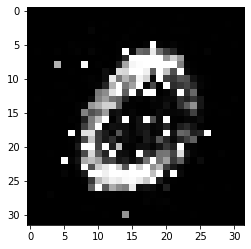

-------------------------------------


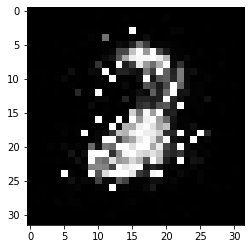

-------------------------------------


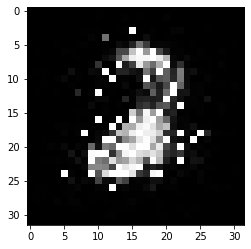

-------------------------------------


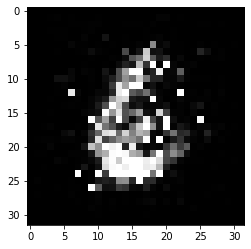

-------------------------------------


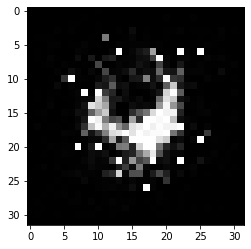

-------------------------------------


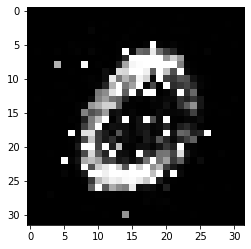

-------------------------------------


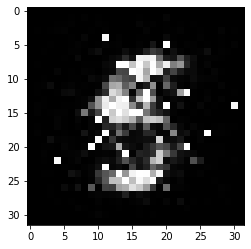

-------------------------------------


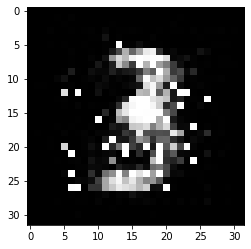

-------------------------------------


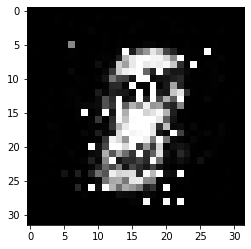

-------------------------------------


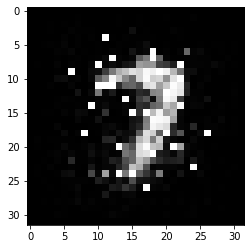

-------------------------------------


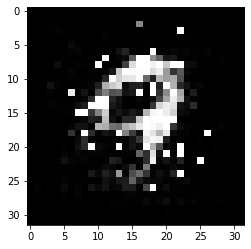

-------------------------------------


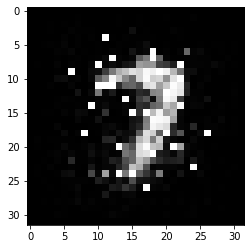

-------------------------------------


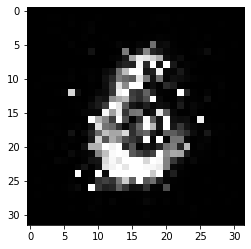

-------------------------------------


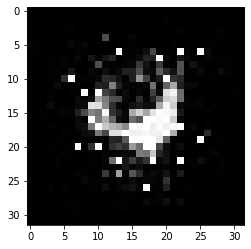

-------------------------------------


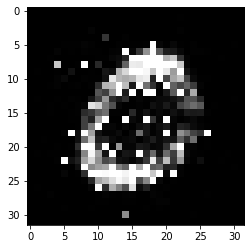

-------------------------------------


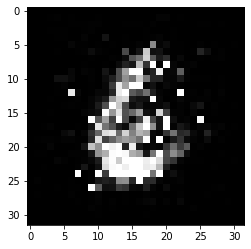

-------------------------------------


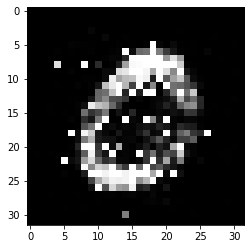

-------------------------------------


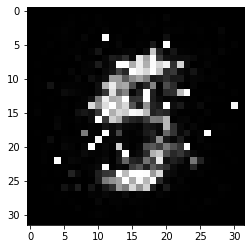

-------------------------------------


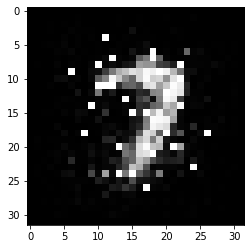

-------------------------------------


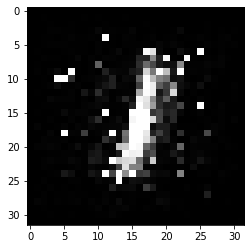

-------------------------------------


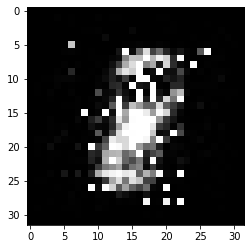

-------------------------------------


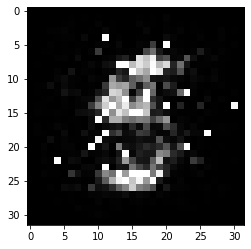

-------------------------------------


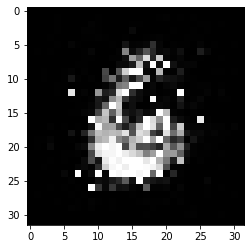

-------------------------------------


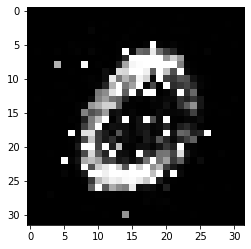

-------------------------------------


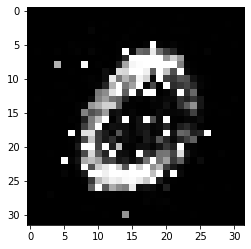

-------------------------------------


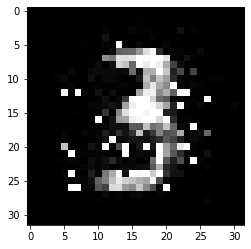

-------------------------------------


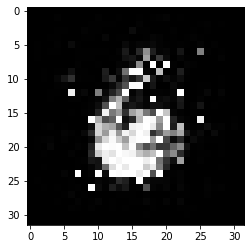

-------------------------------------


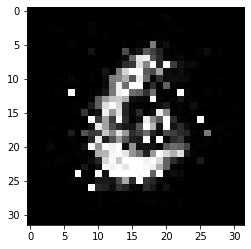

-------------------------------------


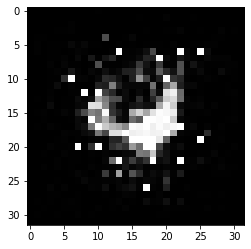

-------------------------------------


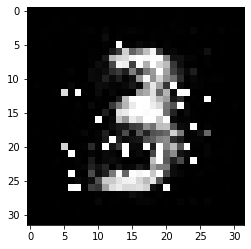

-------------------------------------


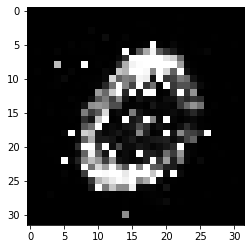

-------------------------------------


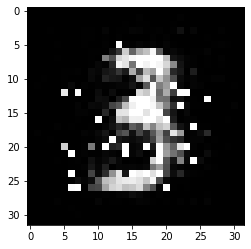

-------------------------------------


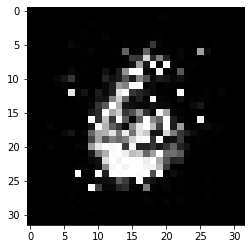

-------------------------------------


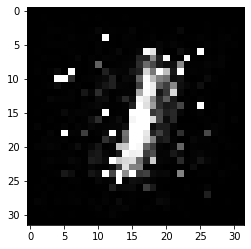

-------------------------------------


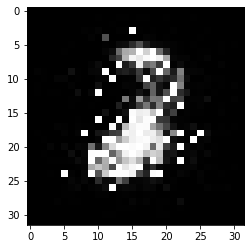

-------------------------------------


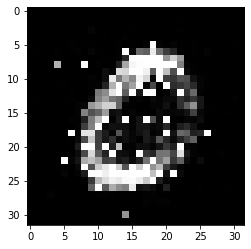

-------------------------------------


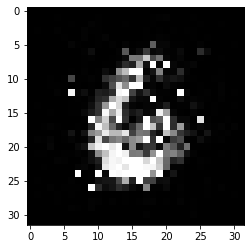

-------------------------------------


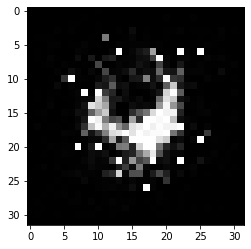

-------------------------------------


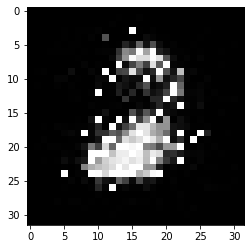

-------------------------------------


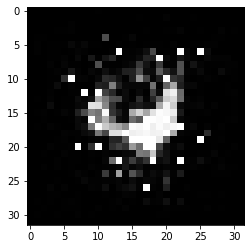

-------------------------------------


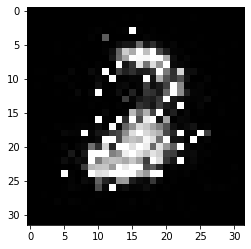

-------------------------------------


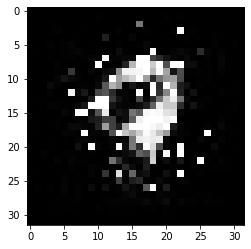

-------------------------------------


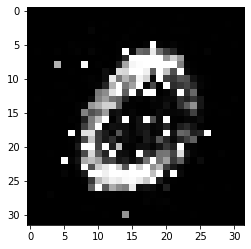

-------------------------------------


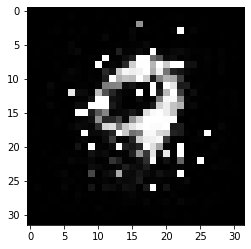

-------------------------------------


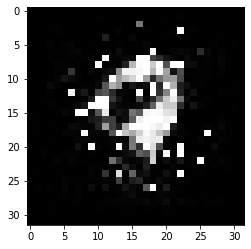

-------------------------------------


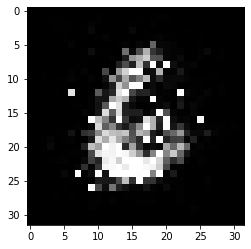

-------------------------------------


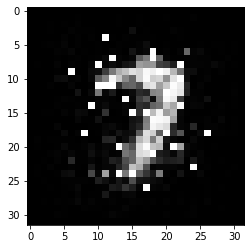

-------------------------------------


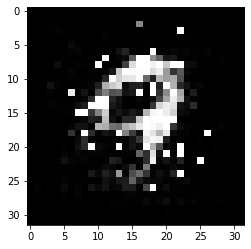

-------------------------------------


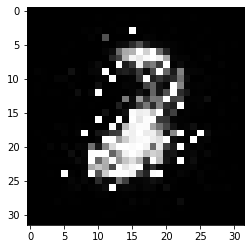

-------------------------------------


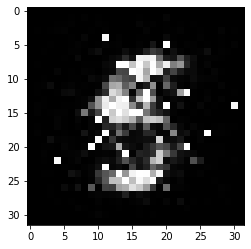

-------------------------------------


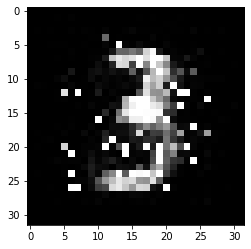

-------------------------------------


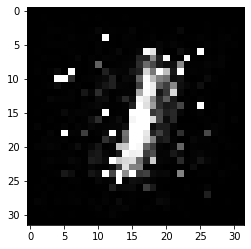

-------------------------------------


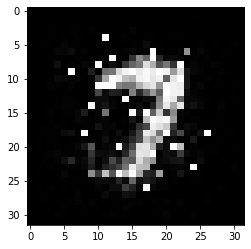

-------------------------------------


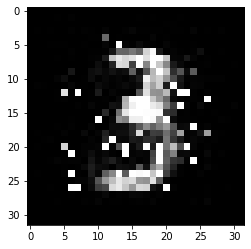

-------------------------------------


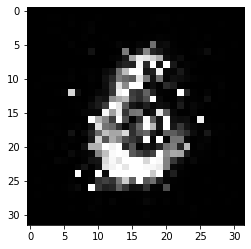

-------------------------------------


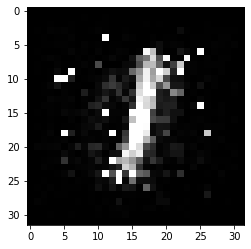

-------------------------------------


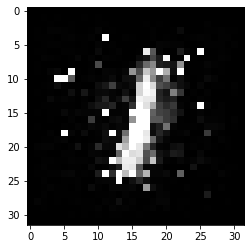

-------------------------------------


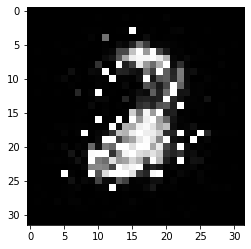

-------------------------------------


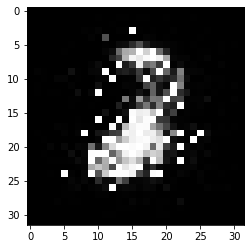

-------------------------------------


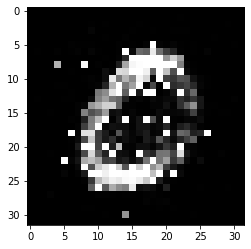

-------------------------------------


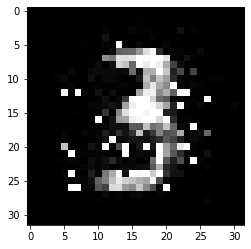

-------------------------------------


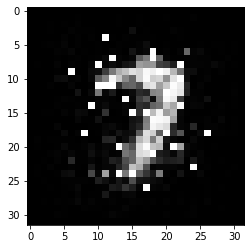

-------------------------------------


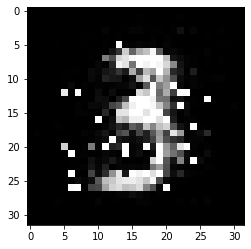

-------------------------------------


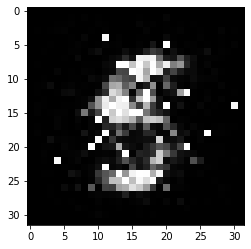

-------------------------------------


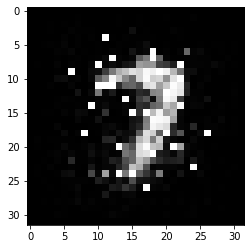

-------------------------------------


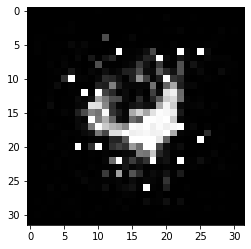

-------------------------------------


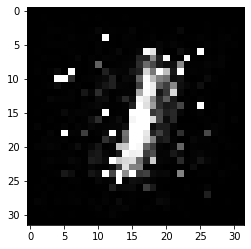

-------------------------------------


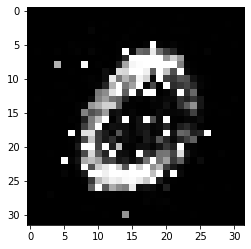

-------------------------------------


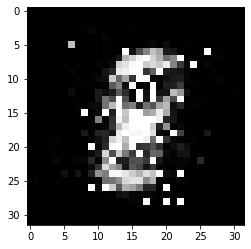

-------------------------------------


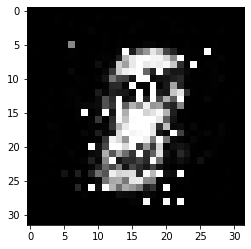

-------------------------------------


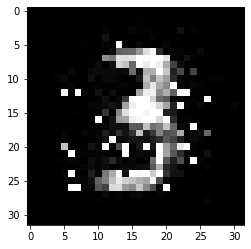

-------------------------------------


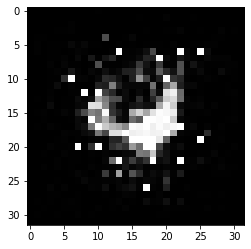

-------------------------------------


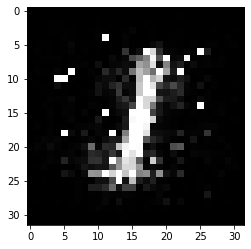

-------------------------------------


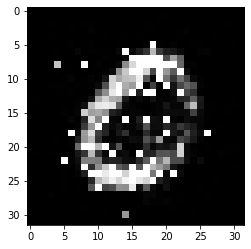

-------------------------------------


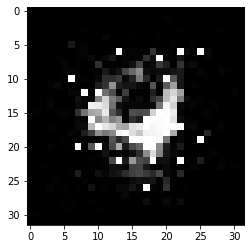

-------------------------------------


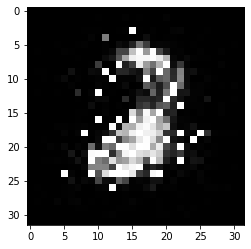

-------------------------------------


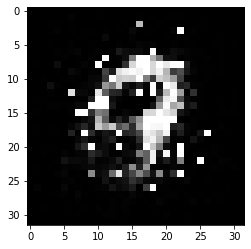

-------------------------------------


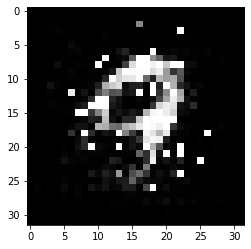

-------------------------------------


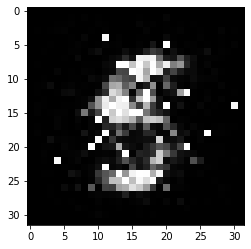

-------------------------------------


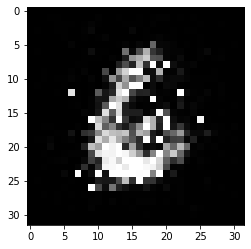

-------------------------------------


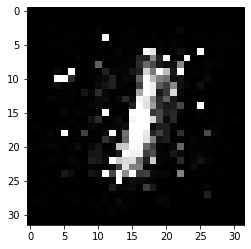

-------------------------------------


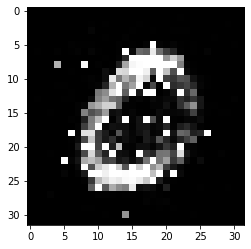

-------------------------------------


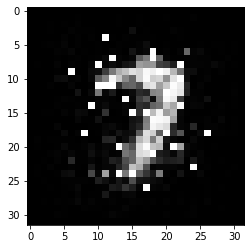

-------------------------------------


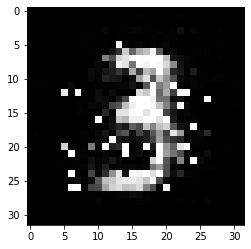

-------------------------------------


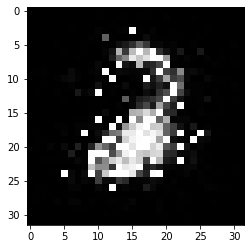

-------------------------------------


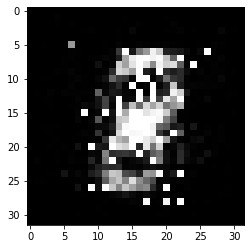

-------------------------------------


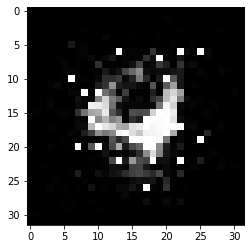

-------------------------------------


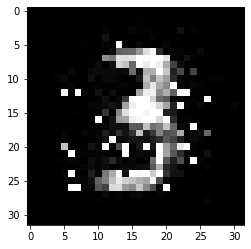

-------------------------------------


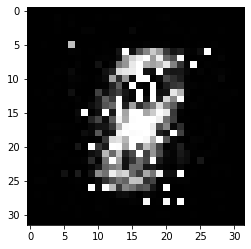

-------------------------------------


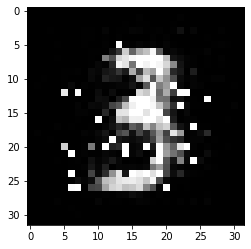

-------------------------------------


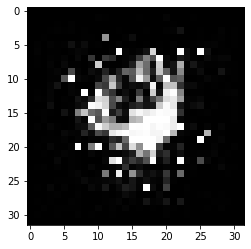

-------------------------------------


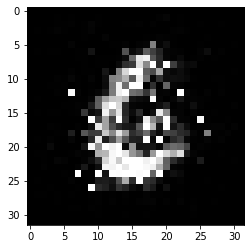

-------------------------------------


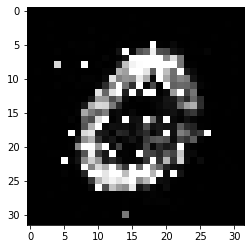

-------------------------------------


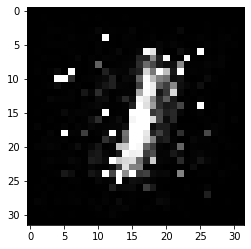

-------------------------------------


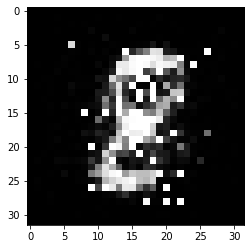

-------------------------------------


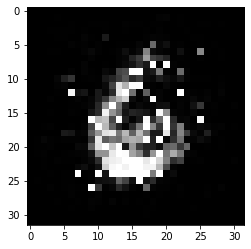

-------------------------------------


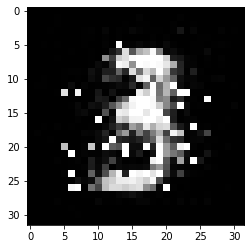

-------------------------------------


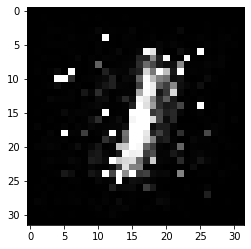

-------------------------------------


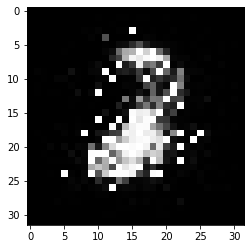

-------------------------------------


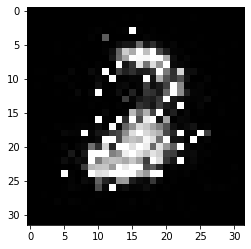

-------------------------------------


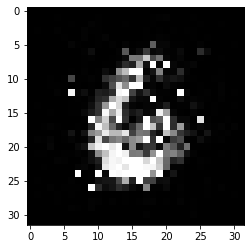

-------------------------------------


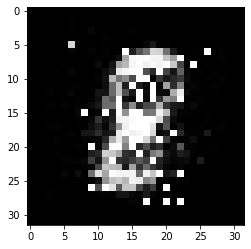

-------------------------------------


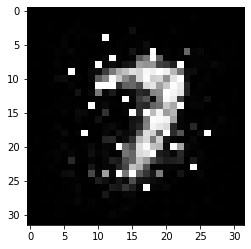

-------------------------------------


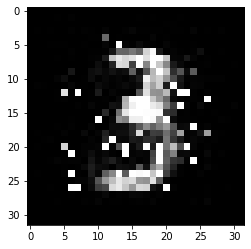

-------------------------------------


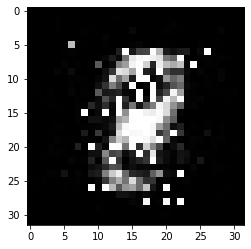

-------------------------------------


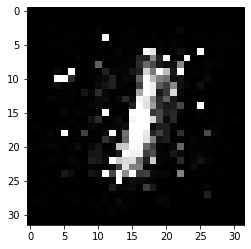

-------------------------------------


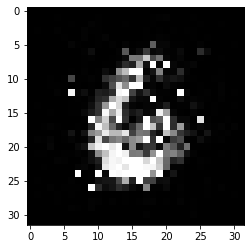

-------------------------------------


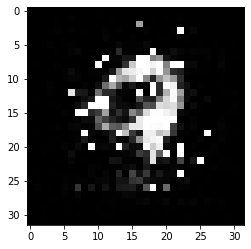

-------------------------------------


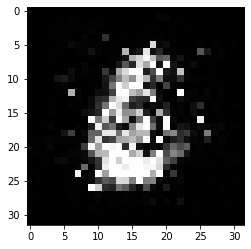

-------------------------------------


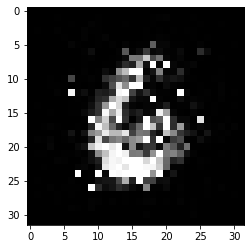

-------------------------------------


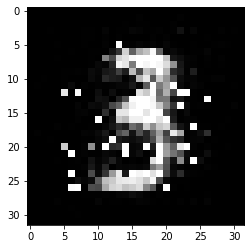

-------------------------------------


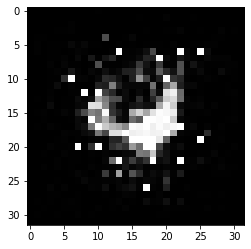

-------------------------------------


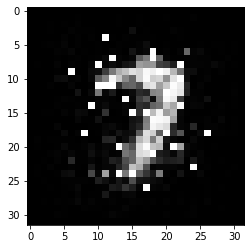

-------------------------------------


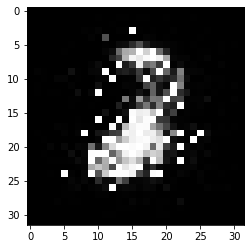

-------------------------------------


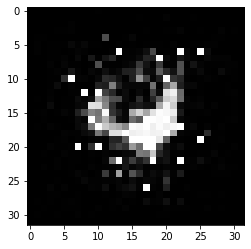

-------------------------------------


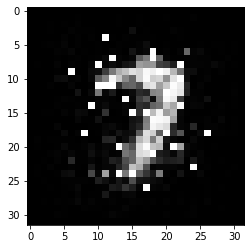

-------------------------------------


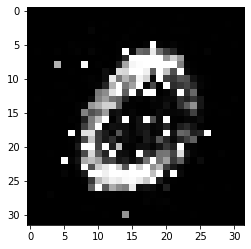

-------------------------------------


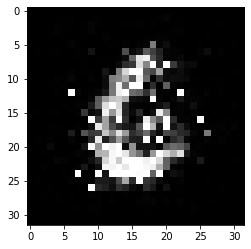

-------------------------------------


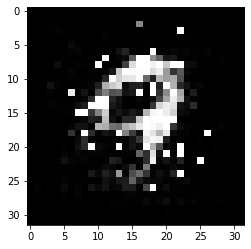

-------------------------------------


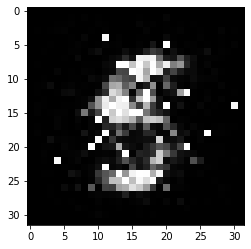

-------------------------------------


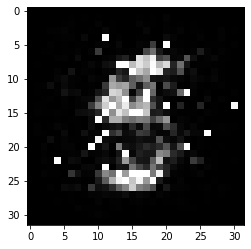

-------------------------------------


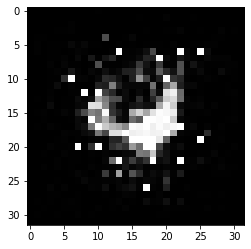

-------------------------------------


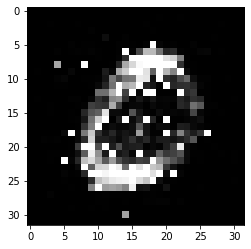

-------------------------------------


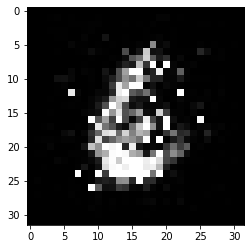

-------------------------------------


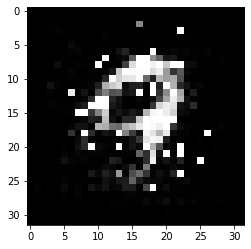

-------------------------------------


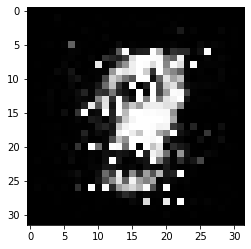

-------------------------------------


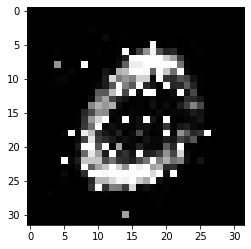

-------------------------------------


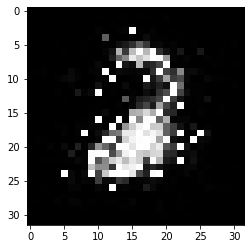

-------------------------------------


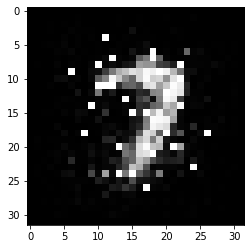

-------------------------------------


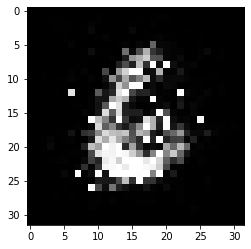

-------------------------------------


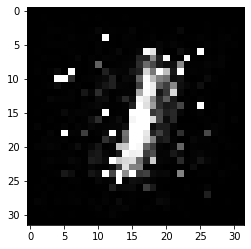

-------------------------------------


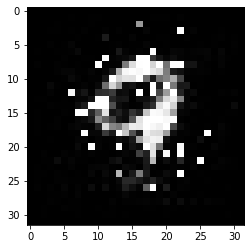

-------------------------------------


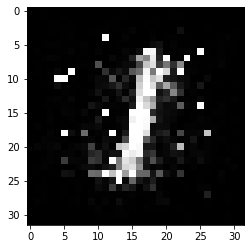

-------------------------------------


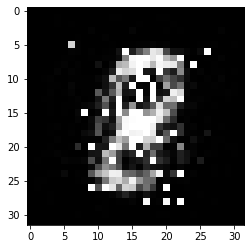

-------------------------------------


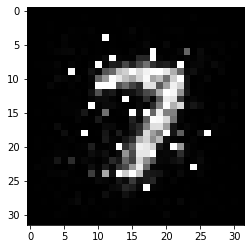

-------------------------------------


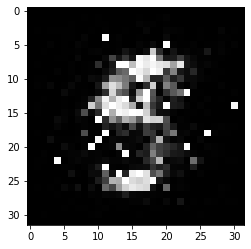

-------------------------------------


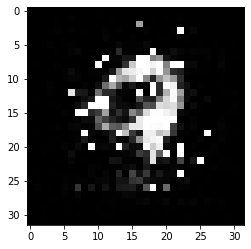

-------------------------------------


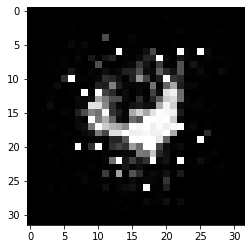

-------------------------------------


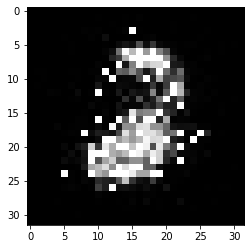

-------------------------------------


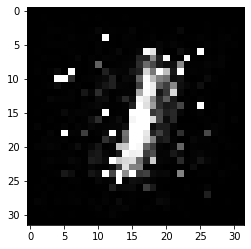

-------------------------------------


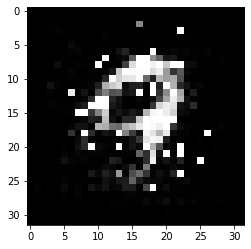

-------------------------------------


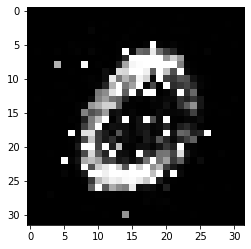

-------------------------------------


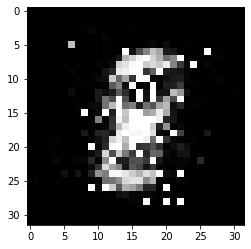

-------------------------------------


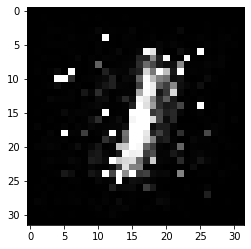

-------------------------------------


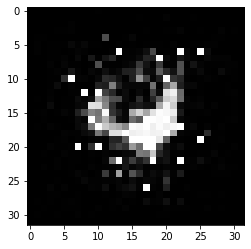

-------------------------------------


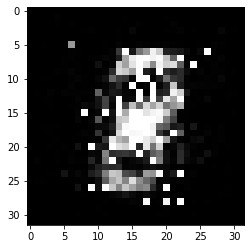

-------------------------------------


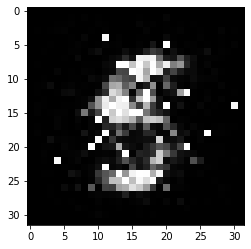

-------------------------------------


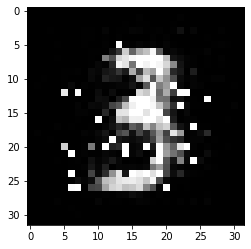

-------------------------------------


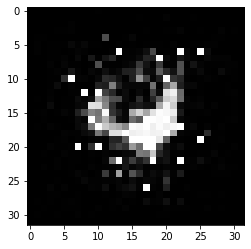

-------------------------------------


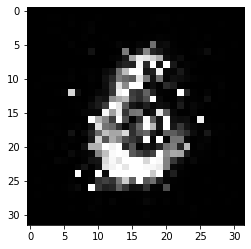

-------------------------------------


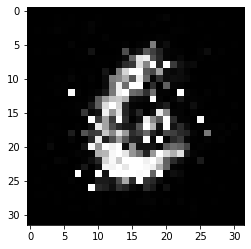

-------------------------------------


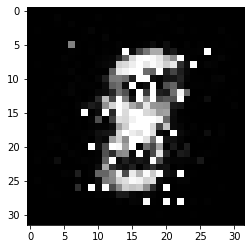

-------------------------------------


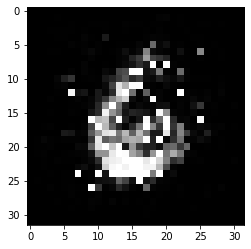

-------------------------------------


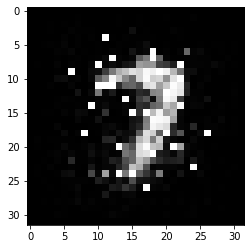

-------------------------------------


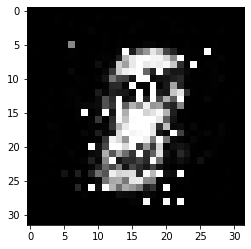

-------------------------------------


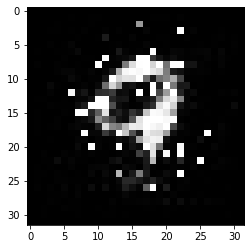

-------------------------------------


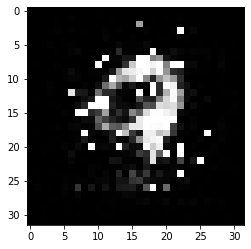

-------------------------------------


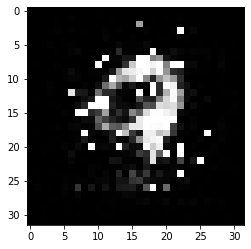

-------------------------------------


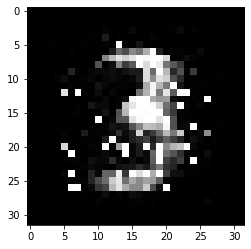

-------------------------------------


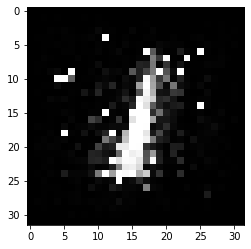

-------------------------------------


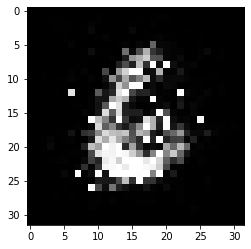

-------------------------------------


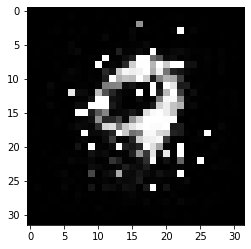

-------------------------------------


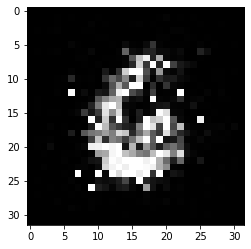

-------------------------------------


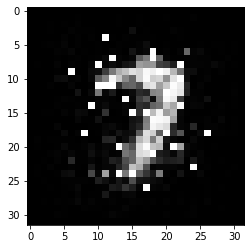

-------------------------------------


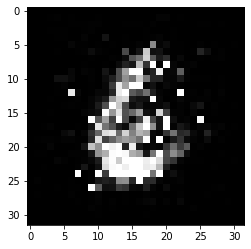

-------------------------------------


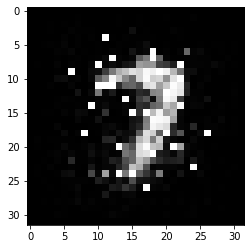

-------------------------------------


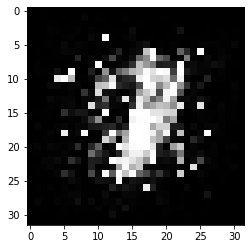

-------------------------------------


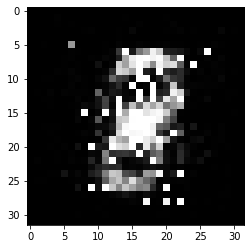

-------------------------------------


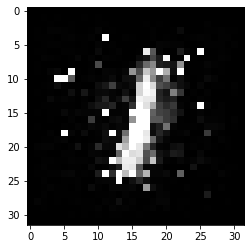

-------------------------------------


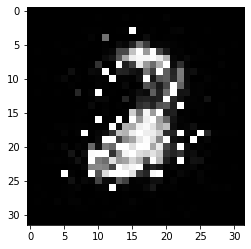

-------------------------------------


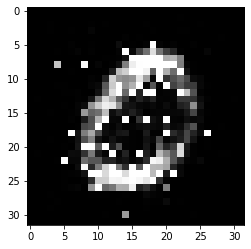

-------------------------------------


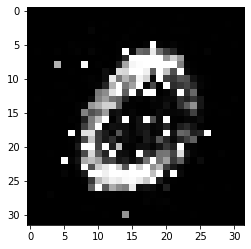

-------------------------------------


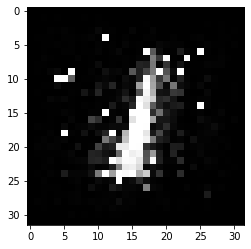

-------------------------------------


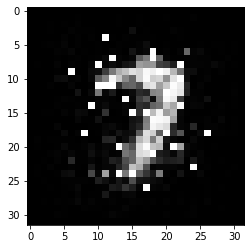

-------------------------------------


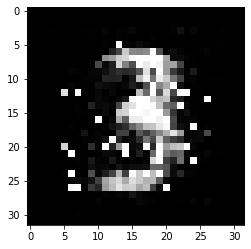

-------------------------------------


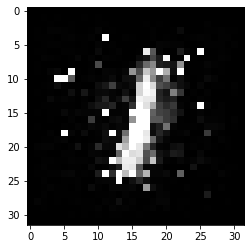

-------------------------------------


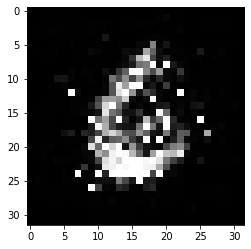

-------------------------------------


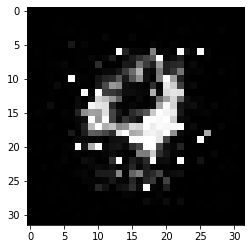

-------------------------------------


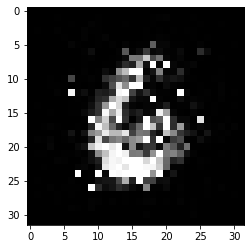

-------------------------------------


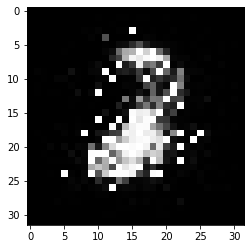

-------------------------------------


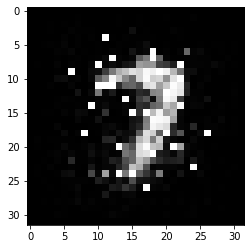

-------------------------------------


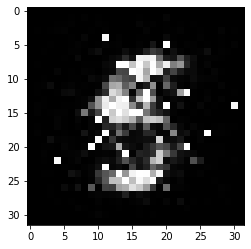

-------------------------------------


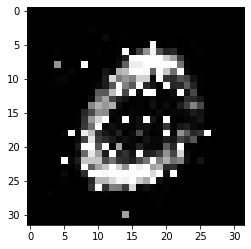

-------------------------------------


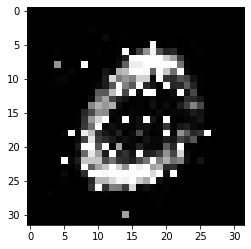

-------------------------------------


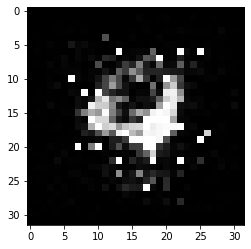

-------------------------------------


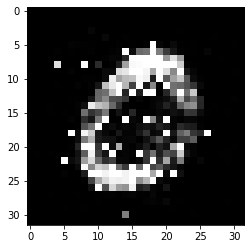

-------------------------------------


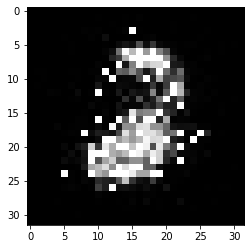

-------------------------------------


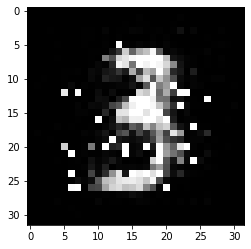

-------------------------------------


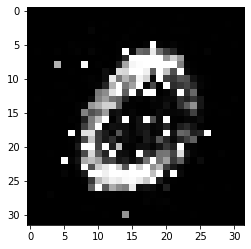

-------------------------------------


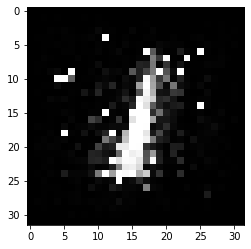

-------------------------------------


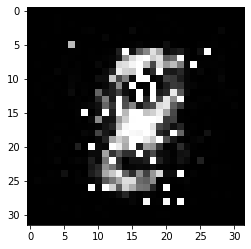

-------------------------------------


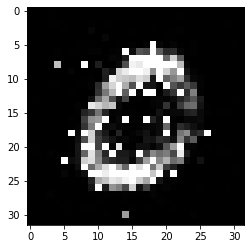

-------------------------------------


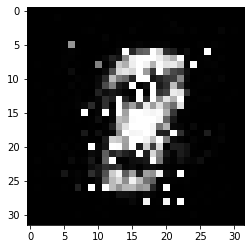

-------------------------------------


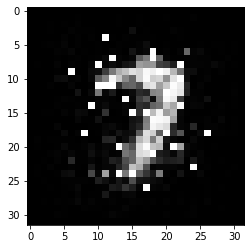

-------------------------------------


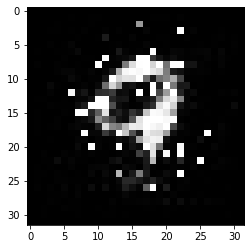

-------------------------------------


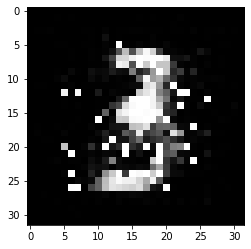

-------------------------------------


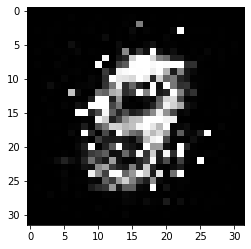

-------------------------------------


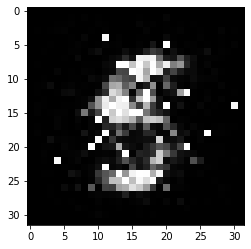

-------------------------------------


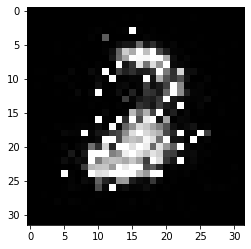

-------------------------------------


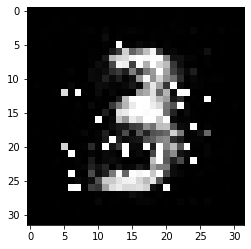

-------------------------------------


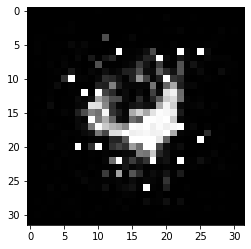

-------------------------------------


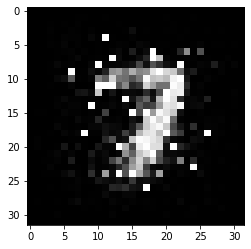

-------------------------------------


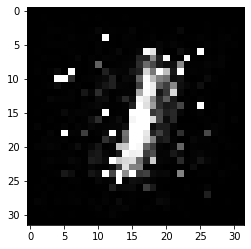

-------------------------------------


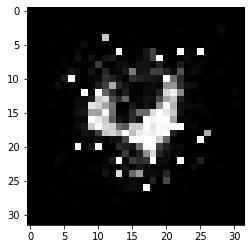

-------------------------------------


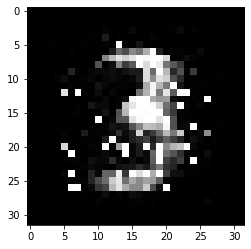

-------------------------------------


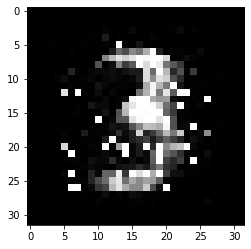

-------------------------------------


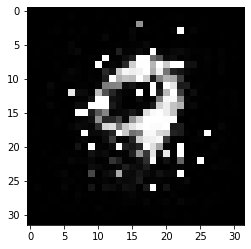

-------------------------------------


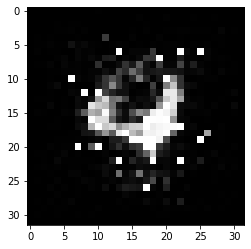

-------------------------------------


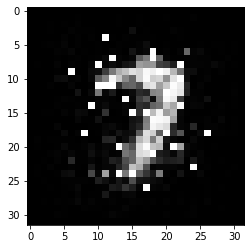

-------------------------------------


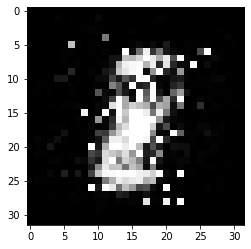

-------------------------------------


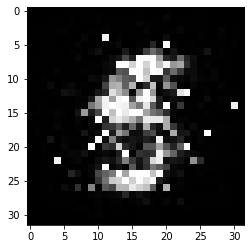

-------------------------------------


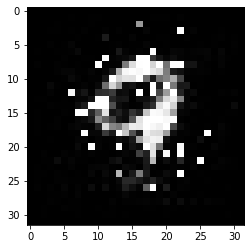

-------------------------------------


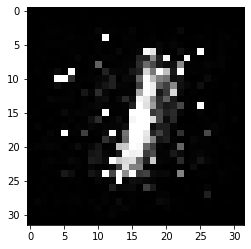

-------------------------------------


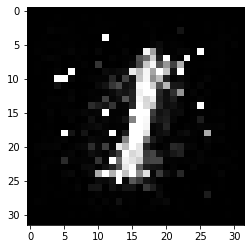

-------------------------------------


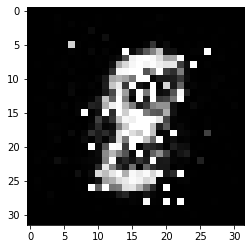

-------------------------------------


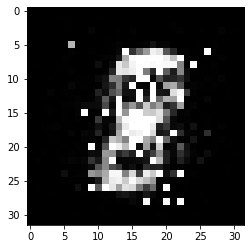

-------------------------------------


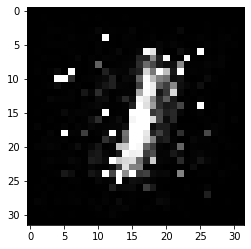

-------------------------------------


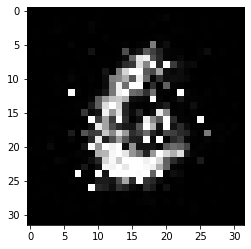

-------------------------------------


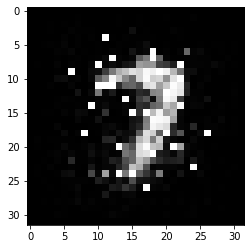

-------------------------------------


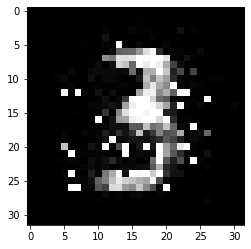

-------------------------------------


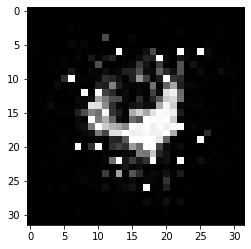

-------------------------------------


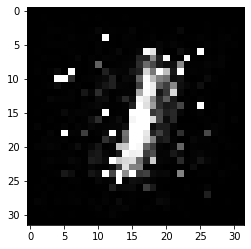

-------------------------------------


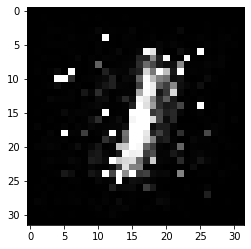

-------------------------------------


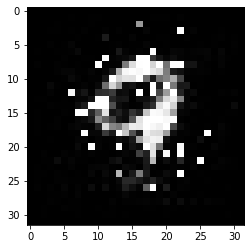

-------------------------------------


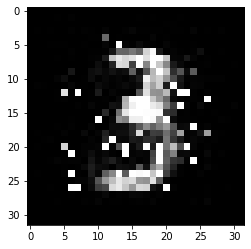

-------------------------------------


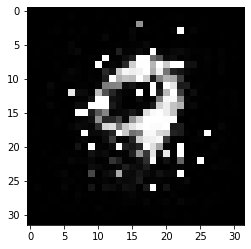

-------------------------------------


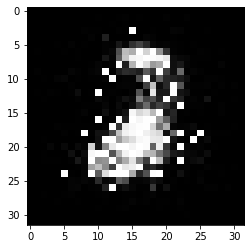

-------------------------------------


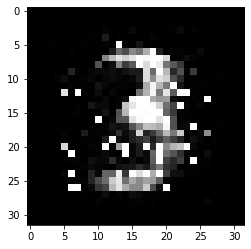

-------------------------------------


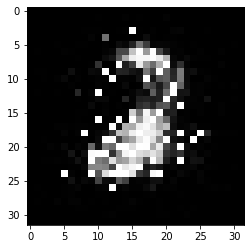

-------------------------------------


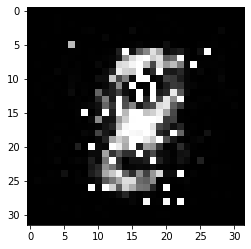

-------------------------------------


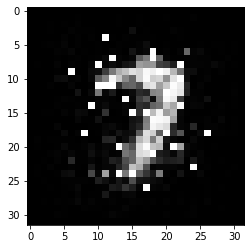

-------------------------------------


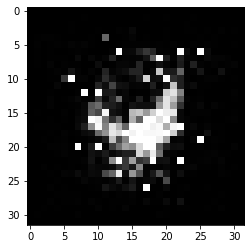

-------------------------------------


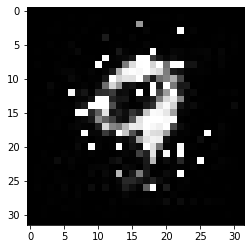

-------------------------------------


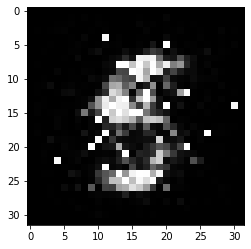

-------------------------------------


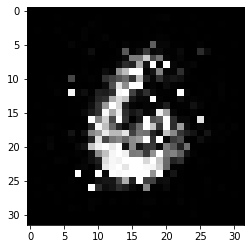

-------------------------------------


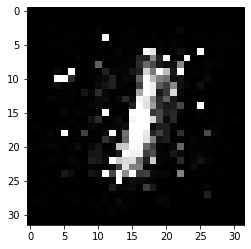

-------------------------------------


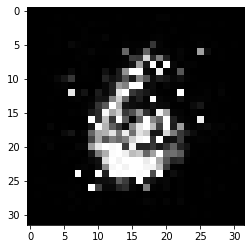

-------------------------------------


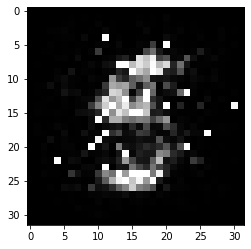

-------------------------------------


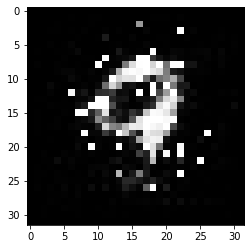

-------------------------------------


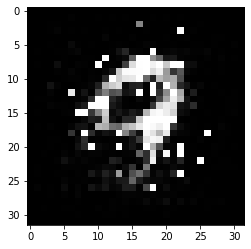

-------------------------------------


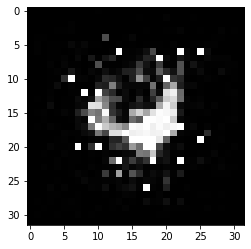

-------------------------------------


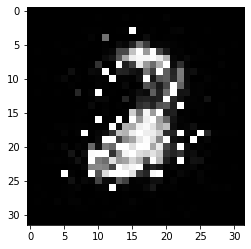

-------------------------------------


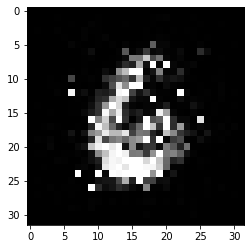

-------------------------------------


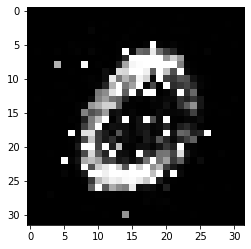

-------------------------------------


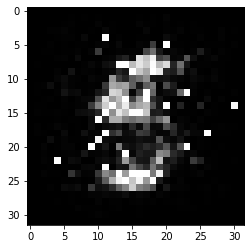

-------------------------------------


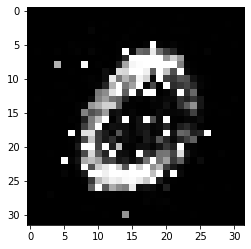

-------------------------------------


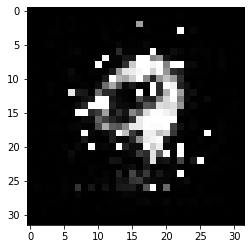

-------------------------------------


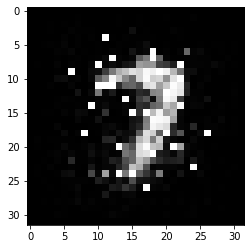

-------------------------------------


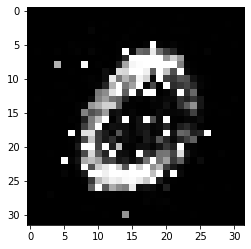

-------------------------------------


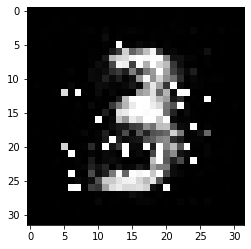

-------------------------------------


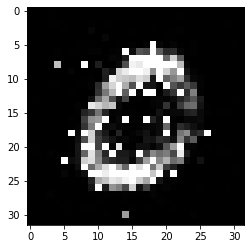

-------------------------------------


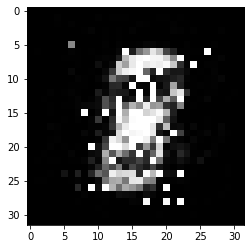

-------------------------------------


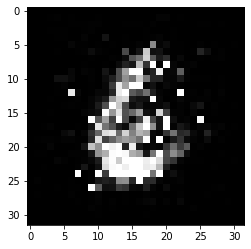

-------------------------------------


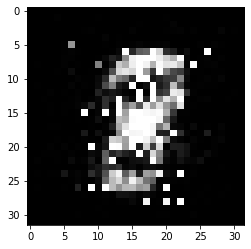

-------------------------------------


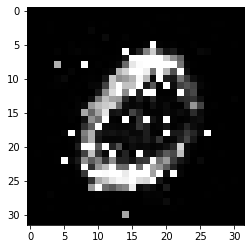

-------------------------------------


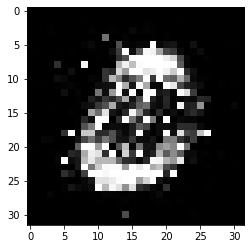

-------------------------------------


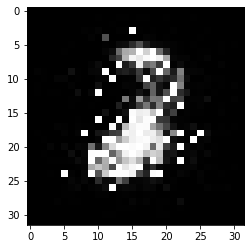

-------------------------------------


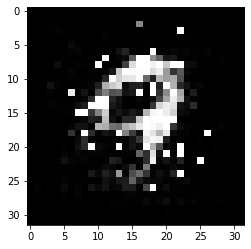

-------------------------------------


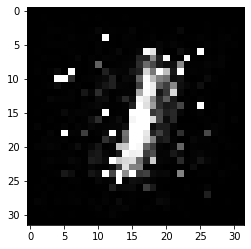

-------------------------------------


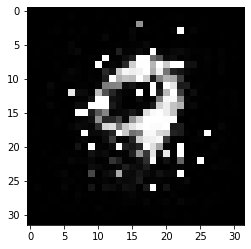

-------------------------------------


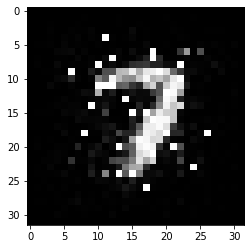

-------------------------------------


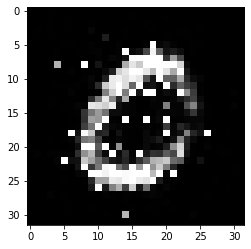

-------------------------------------


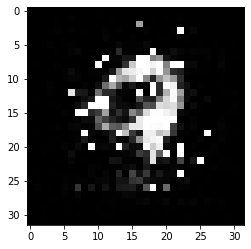

-------------------------------------


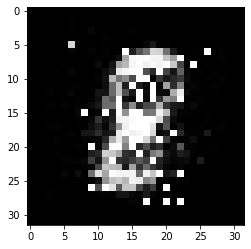

-------------------------------------


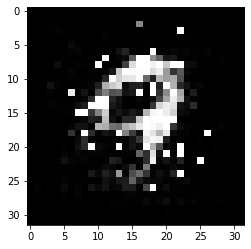

-------------------------------------


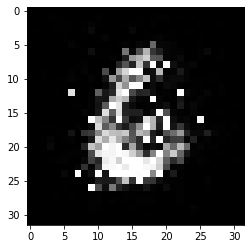

-------------------------------------


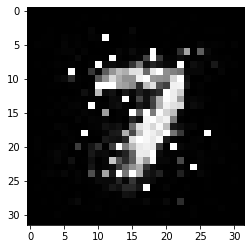

-------------------------------------


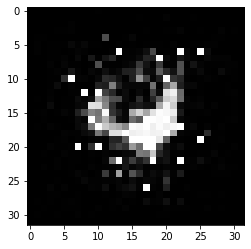

-------------------------------------


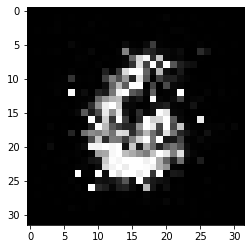

-------------------------------------


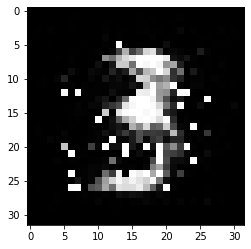

-------------------------------------


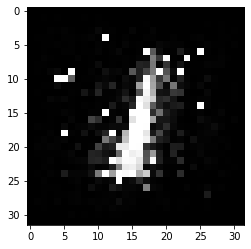

-------------------------------------


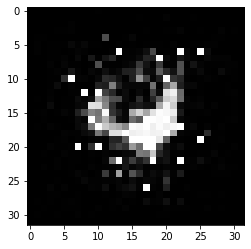

-------------------------------------


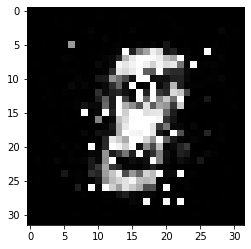

-------------------------------------


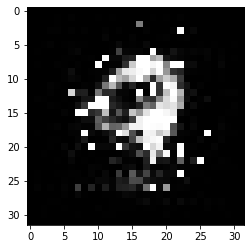

-------------------------------------


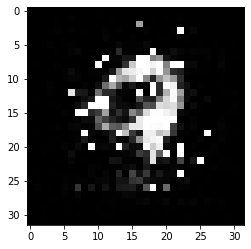

-------------------------------------


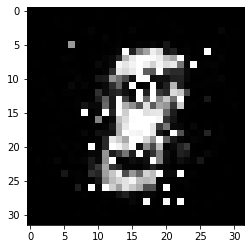

-------------------------------------


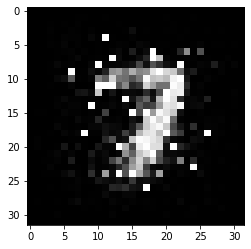

-------------------------------------


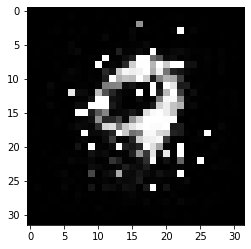

-------------------------------------


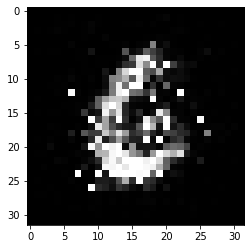

-------------------------------------


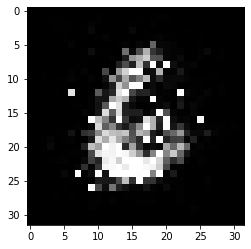

-------------------------------------


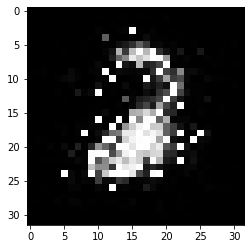

-------------------------------------


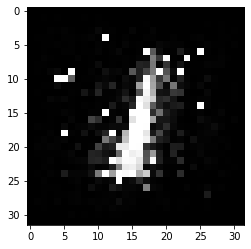

-------------------------------------


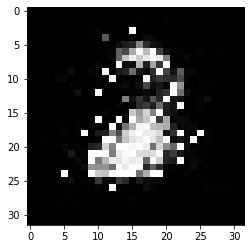

-------------------------------------


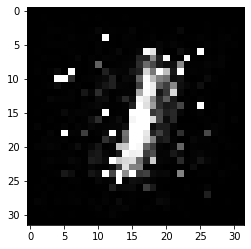

-------------------------------------


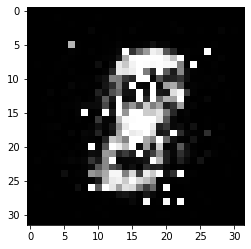

-------------------------------------


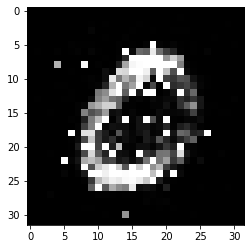

-------------------------------------


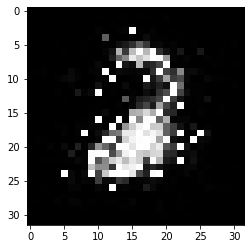

-------------------------------------


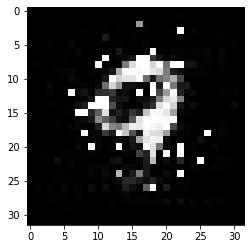

-------------------------------------


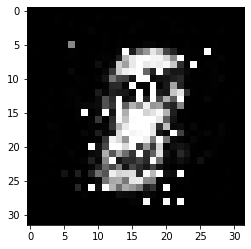

-------------------------------------


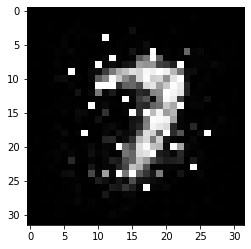

-------------------------------------


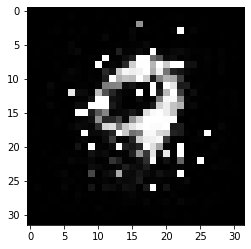

-------------------------------------


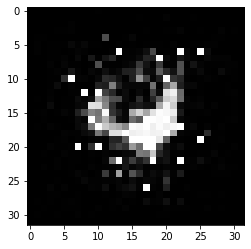

-------------------------------------


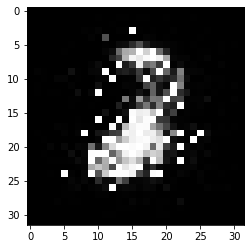

-------------------------------------


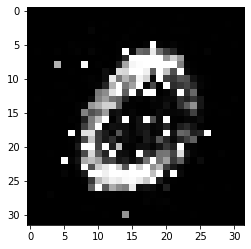

-------------------------------------


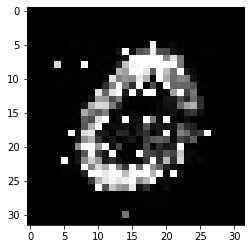

-------------------------------------


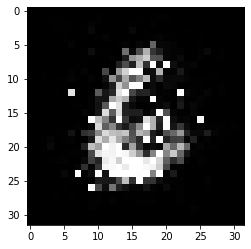

-------------------------------------


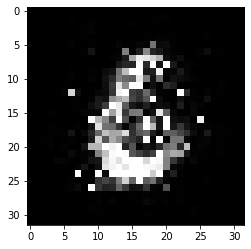

-------------------------------------


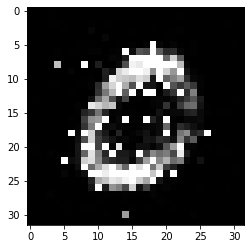

-------------------------------------


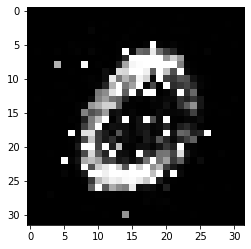

-------------------------------------


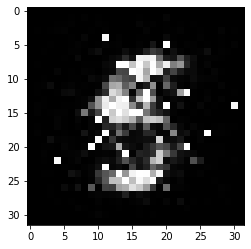

-------------------------------------


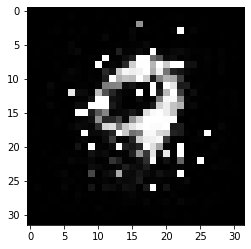

-------------------------------------


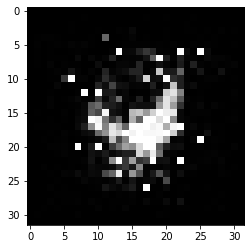

-------------------------------------


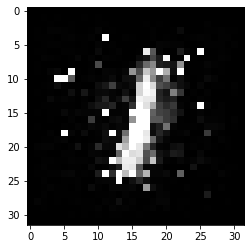

-------------------------------------


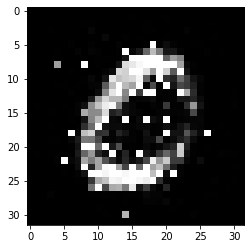

-------------------------------------


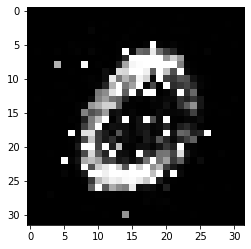

-------------------------------------


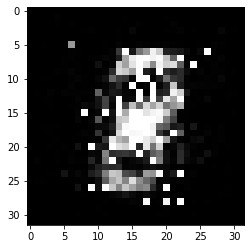

-------------------------------------


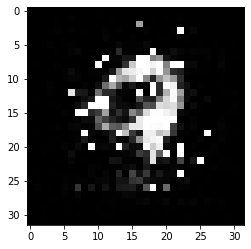

-------------------------------------


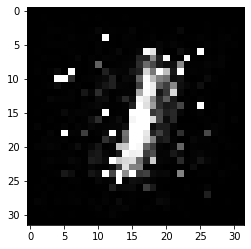

-------------------------------------


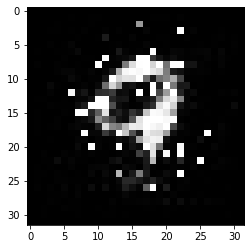

-------------------------------------


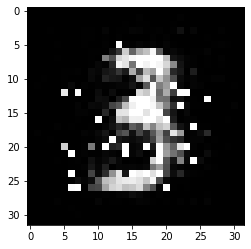

-------------------------------------


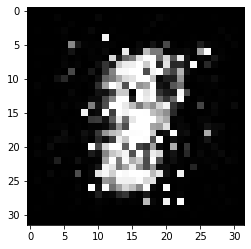

-------------------------------------


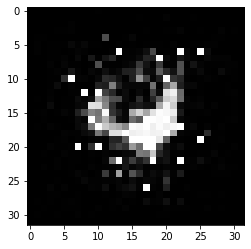

-------------------------------------


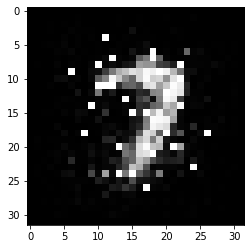

-------------------------------------


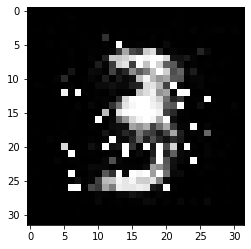

-------------------------------------


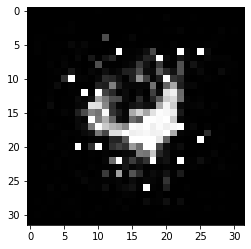

-------------------------------------


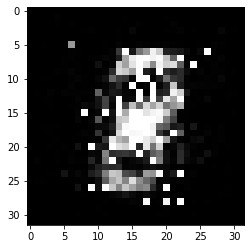

-------------------------------------


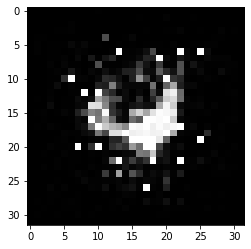

-------------------------------------


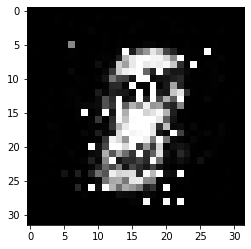

-------------------------------------


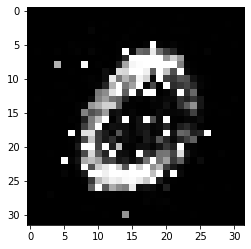

-------------------------------------


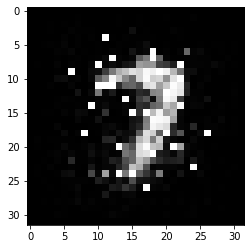

-------------------------------------


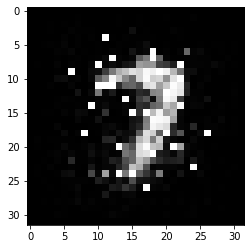

-------------------------------------


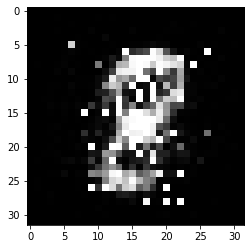

-------------------------------------


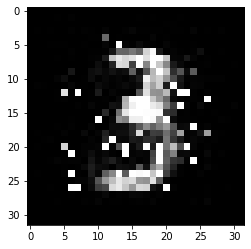

-------------------------------------


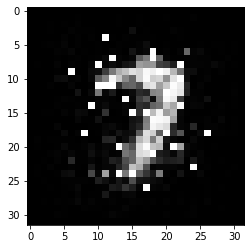

-------------------------------------


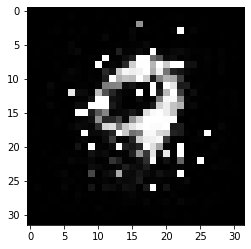

-------------------------------------


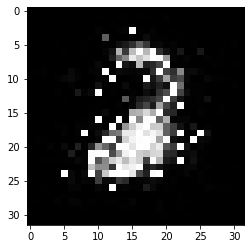

-------------------------------------


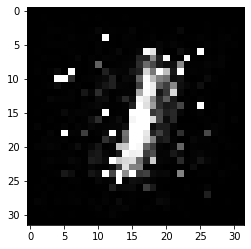

-------------------------------------


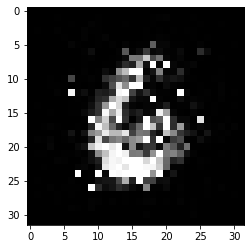

-------------------------------------


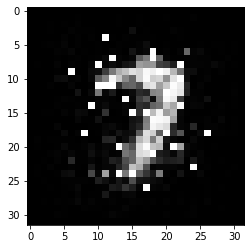

-------------------------------------


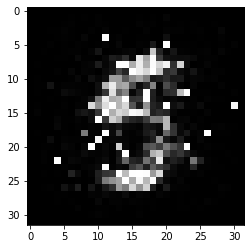

-------------------------------------


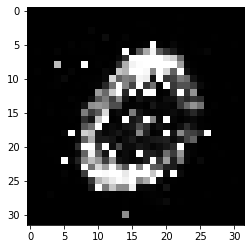

-------------------------------------


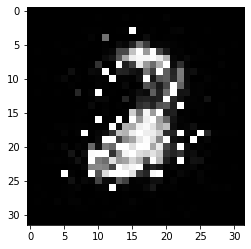

-------------------------------------


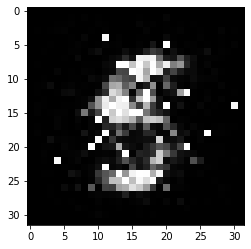

-------------------------------------


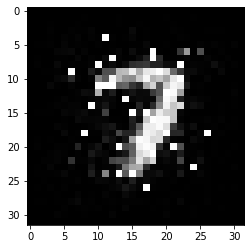

-------------------------------------


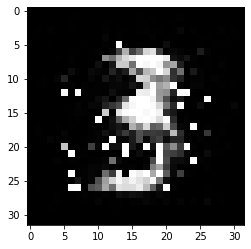

-------------------------------------


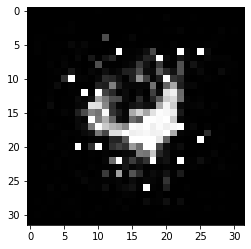

-------------------------------------


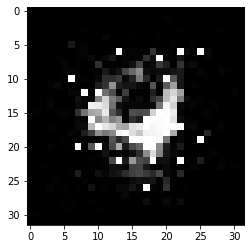

-------------------------------------


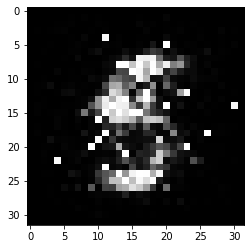

-------------------------------------


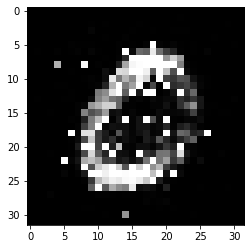

-------------------------------------


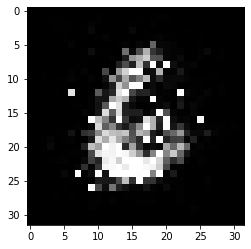

-------------------------------------


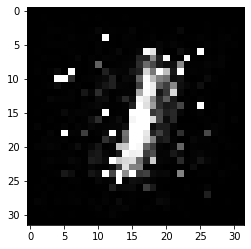

-------------------------------------


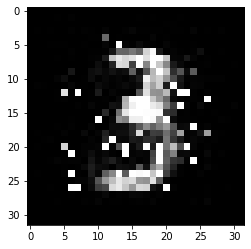

-------------------------------------


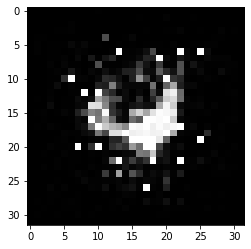

-------------------------------------


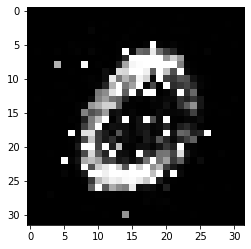

-------------------------------------


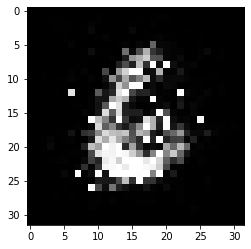

-------------------------------------


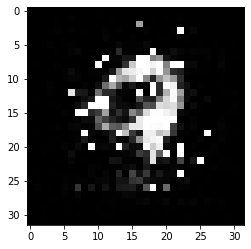

-------------------------------------


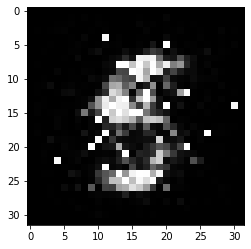

-------------------------------------


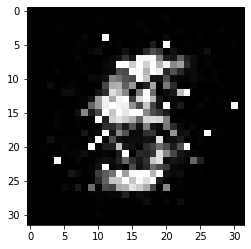

-------------------------------------


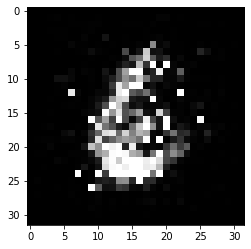

-------------------------------------


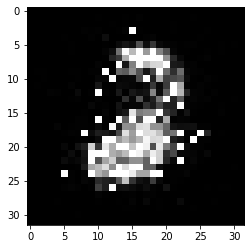

-------------------------------------


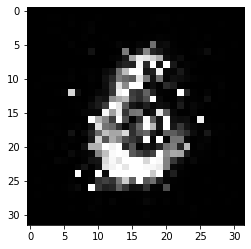

-------------------------------------


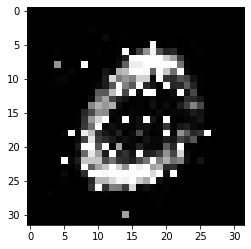

-------------------------------------


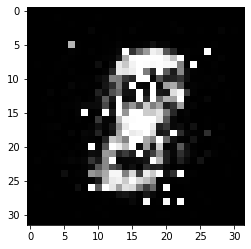

-------------------------------------


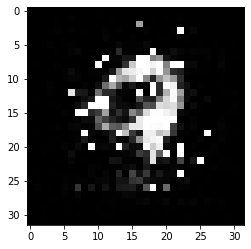

-------------------------------------


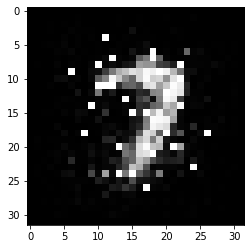

-------------------------------------


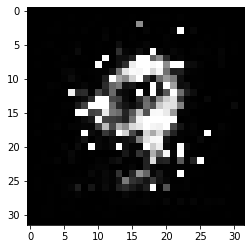

-------------------------------------


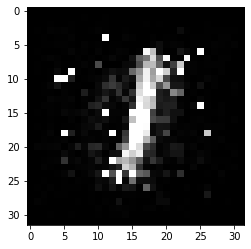

-------------------------------------


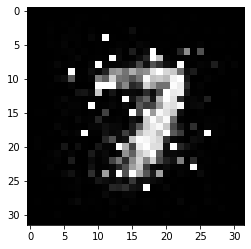

-------------------------------------


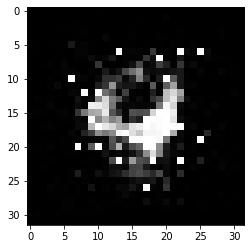

-------------------------------------


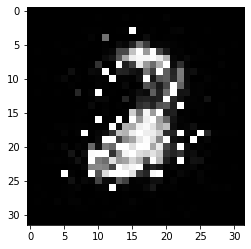

-------------------------------------


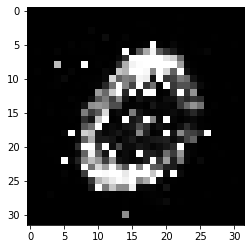

-------------------------------------


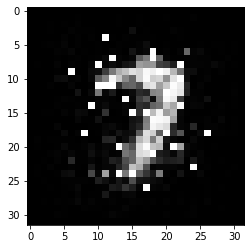

-------------------------------------


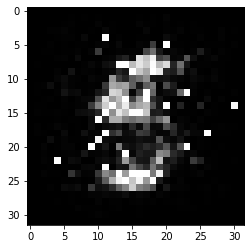

-------------------------------------


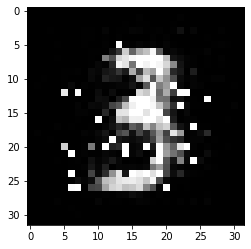

-------------------------------------


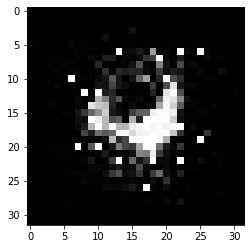

-------------------------------------


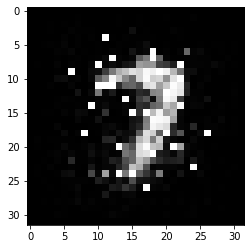

-------------------------------------


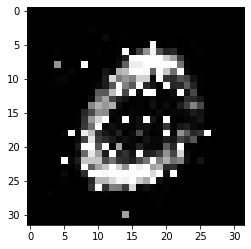

-------------------------------------


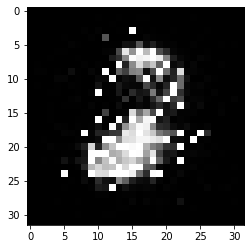

-------------------------------------


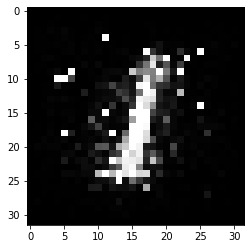

-------------------------------------


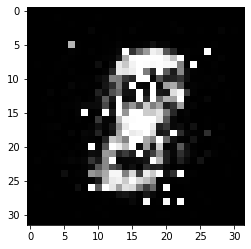

-------------------------------------


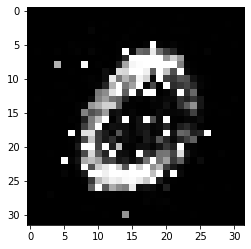

-------------------------------------


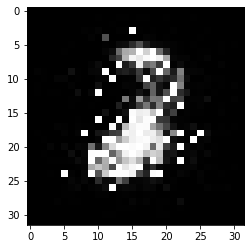

-------------------------------------


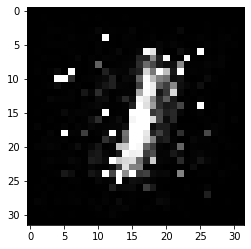

-------------------------------------


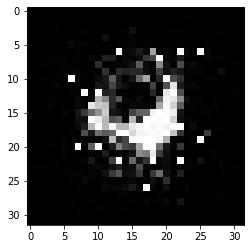

-------------------------------------


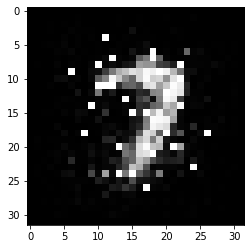

-------------------------------------


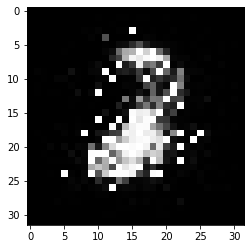

-------------------------------------


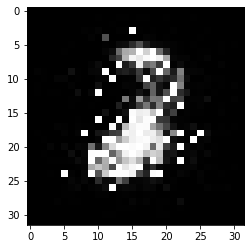

-------------------------------------


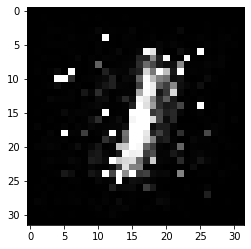

-------------------------------------


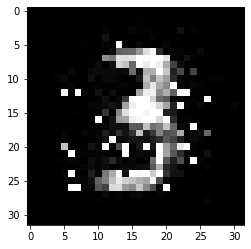

-------------------------------------


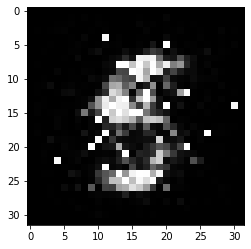

-------------------------------------


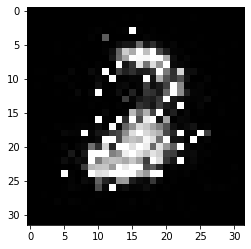

-------------------------------------


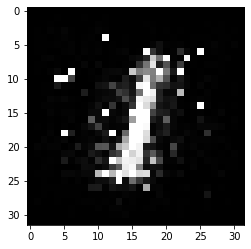

-------------------------------------


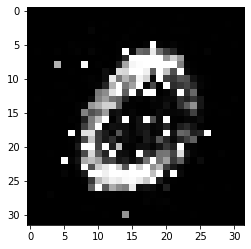

-------------------------------------


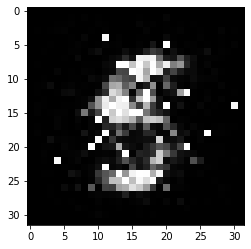

-------------------------------------


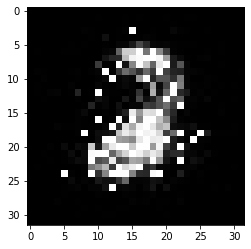

-------------------------------------


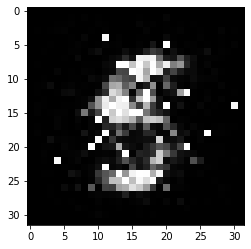

-------------------------------------


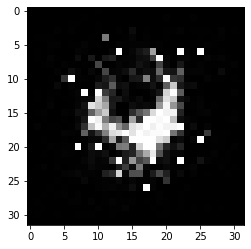

-------------------------------------


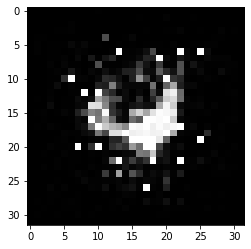

-------------------------------------


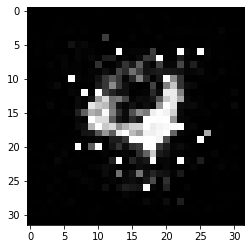

-------------------------------------


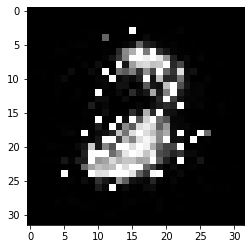

-------------------------------------


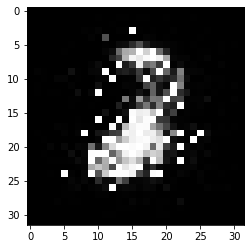

-------------------------------------


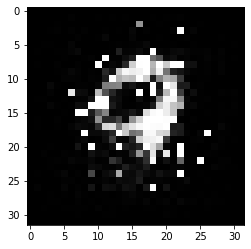

-------------------------------------


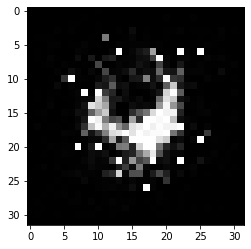

-------------------------------------


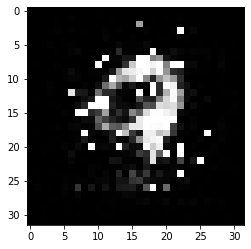

-------------------------------------


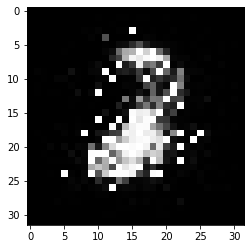

-------------------------------------


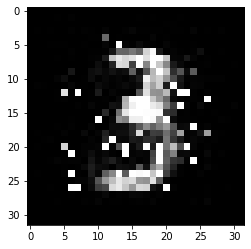

-------------------------------------


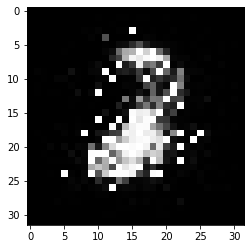

-------------------------------------


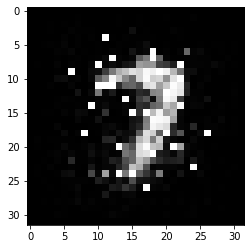

-------------------------------------


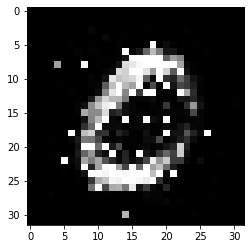

-------------------------------------


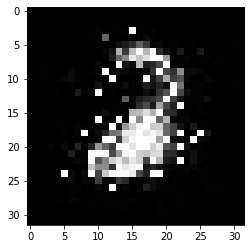

-------------------------------------


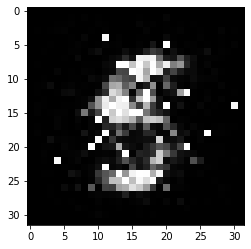

-------------------------------------


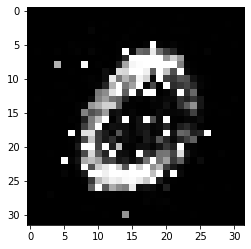

-------------------------------------


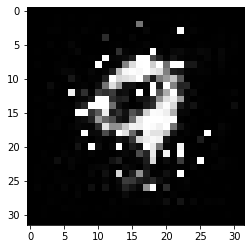

-------------------------------------


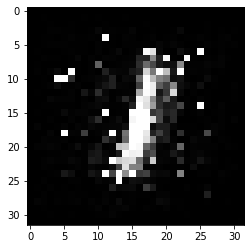

-------------------------------------


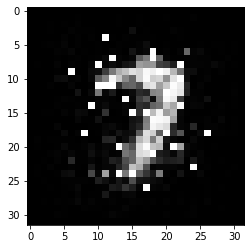

-------------------------------------


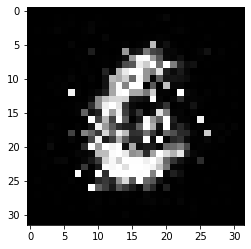

-------------------------------------


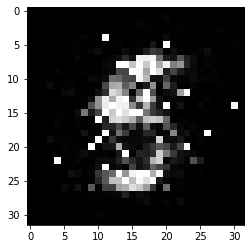

-------------------------------------


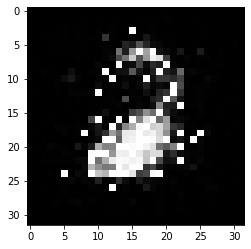

-------------------------------------


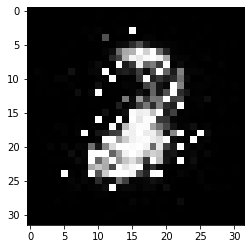

-------------------------------------


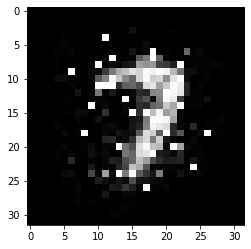

-------------------------------------


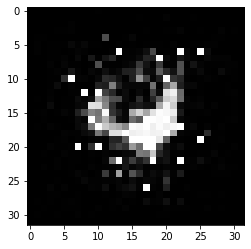

-------------------------------------


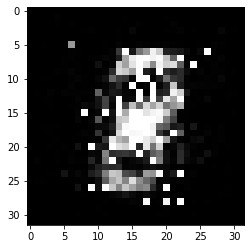

-------------------------------------


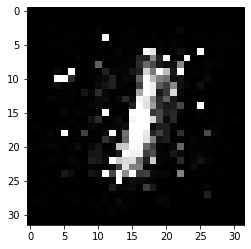

-------------------------------------


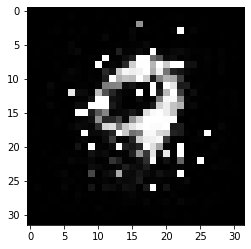

-------------------------------------


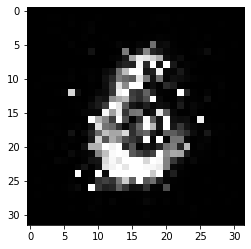

-------------------------------------


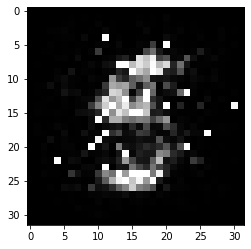

-------------------------------------


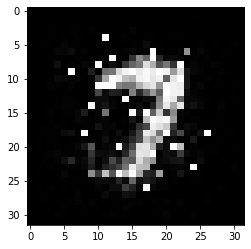

-------------------------------------


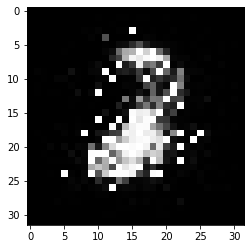

-------------------------------------


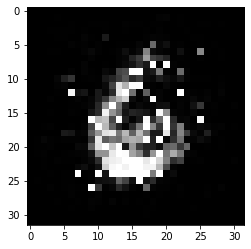

-------------------------------------


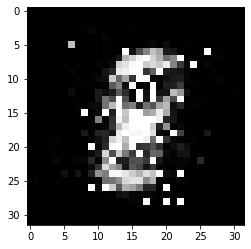

-------------------------------------


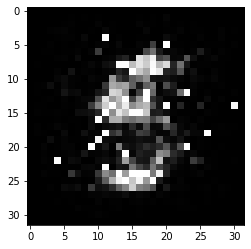

-------------------------------------


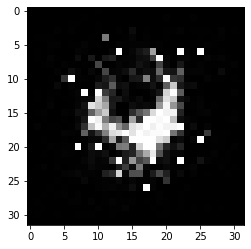

-------------------------------------


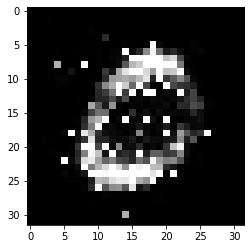

-------------------------------------


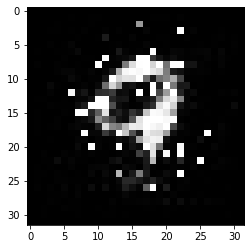

-------------------------------------


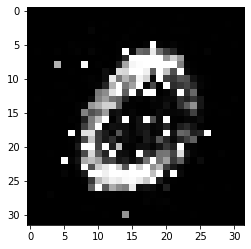

-------------------------------------


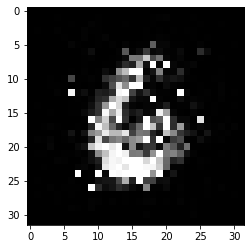

-------------------------------------


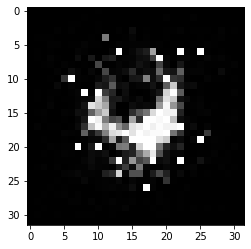

-------------------------------------


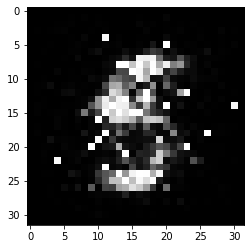

-------------------------------------


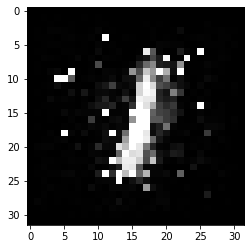

-------------------------------------


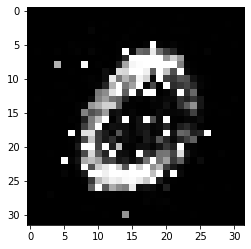

-------------------------------------


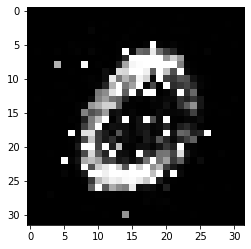

-------------------------------------


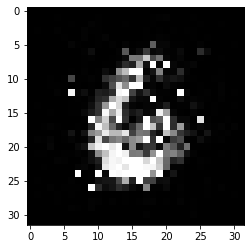

-------------------------------------


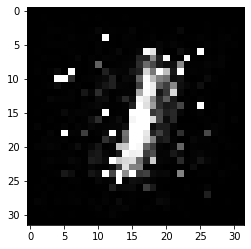

-------------------------------------


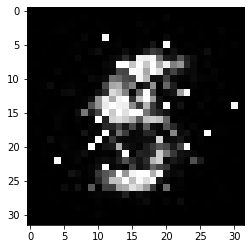

-------------------------------------


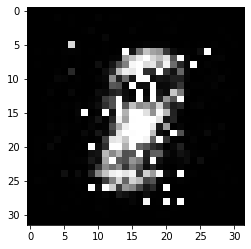

-------------------------------------


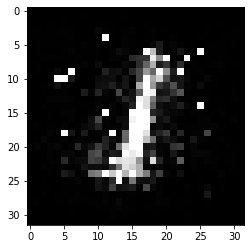

-------------------------------------


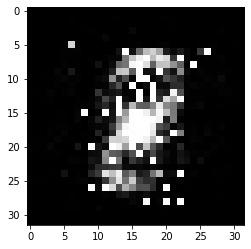

-------------------------------------


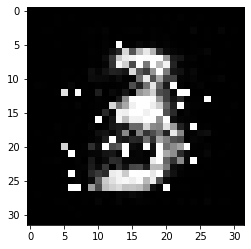

-------------------------------------


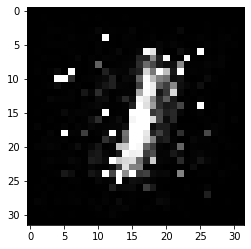

-------------------------------------


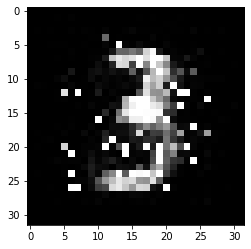

-------------------------------------


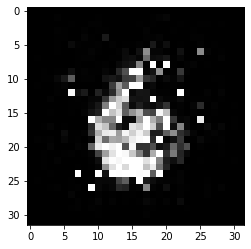

-------------------------------------


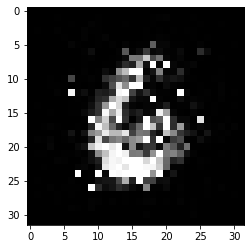

-------------------------------------


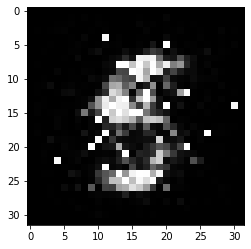

-------------------------------------


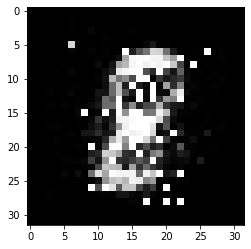

-------------------------------------


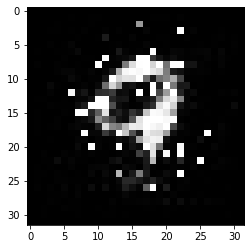

-------------------------------------


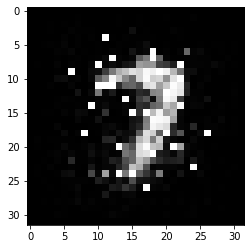

-------------------------------------


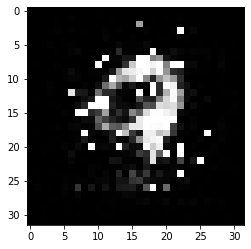

-------------------------------------


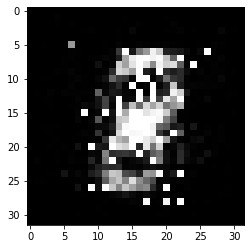

-------------------------------------


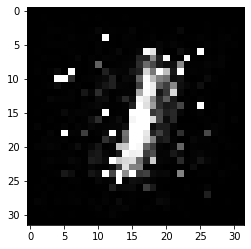

-------------------------------------


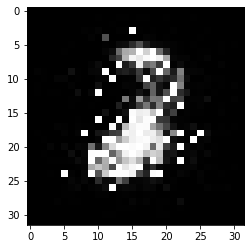

-------------------------------------


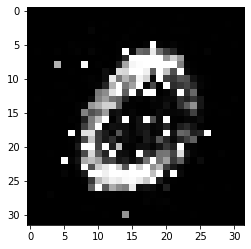

-------------------------------------


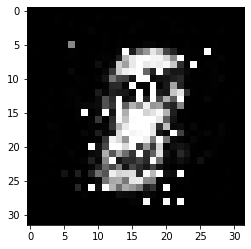

-------------------------------------


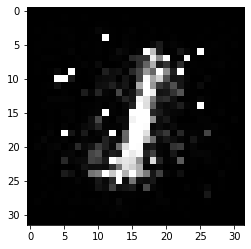

-------------------------------------


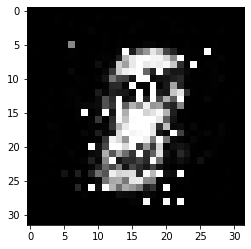

-------------------------------------


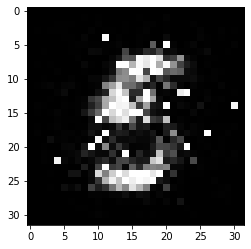

-------------------------------------


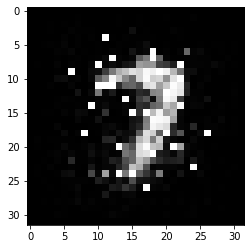

-------------------------------------


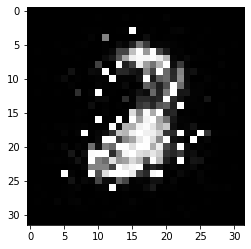

-------------------------------------


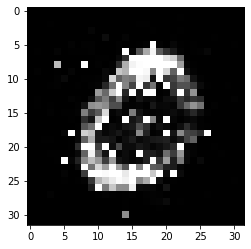

-------------------------------------


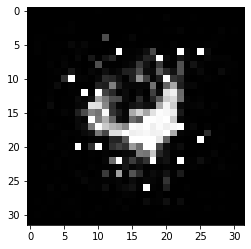

-------------------------------------


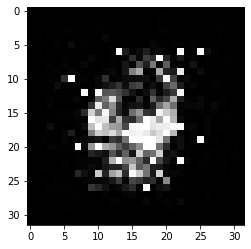

-------------------------------------


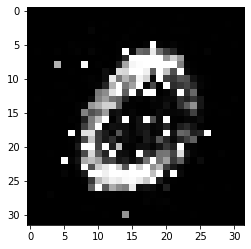

-------------------------------------


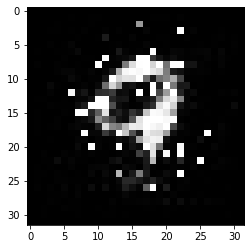

-------------------------------------


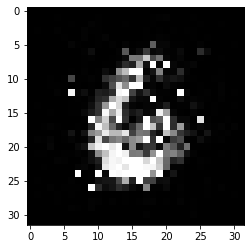

-------------------------------------


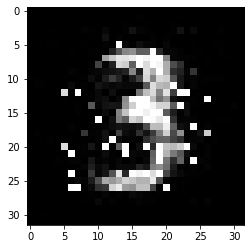

-------------------------------------


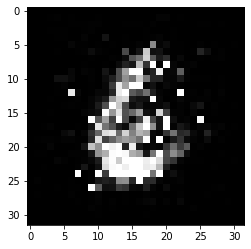

-------------------------------------


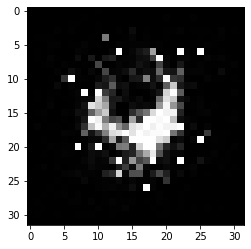

-------------------------------------


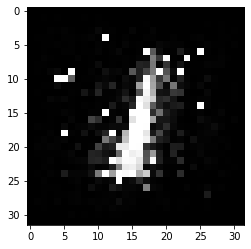

-------------------------------------


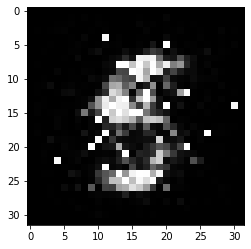

-------------------------------------


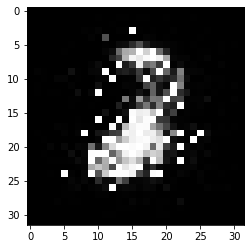

-------------------------------------


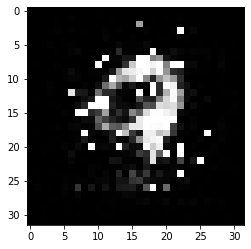

-------------------------------------


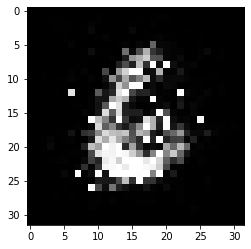

-------------------------------------


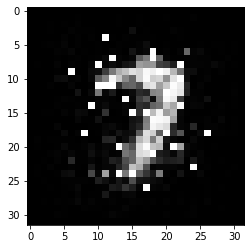

-------------------------------------


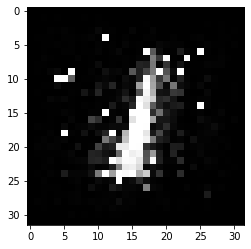

-------------------------------------


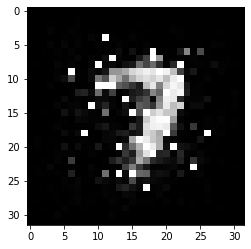

-------------------------------------


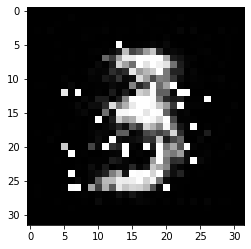

-------------------------------------


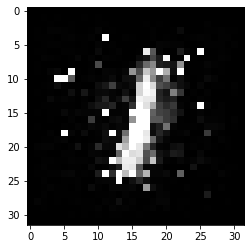

-------------------------------------


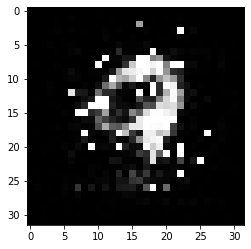

-------------------------------------


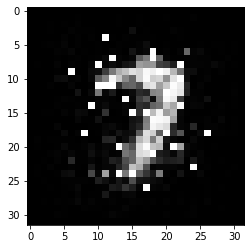

-------------------------------------


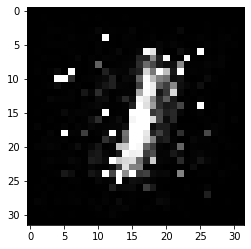

-------------------------------------


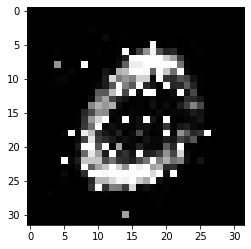

-------------------------------------


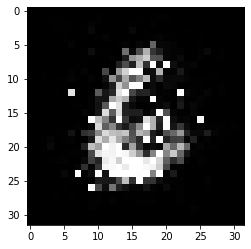

-------------------------------------


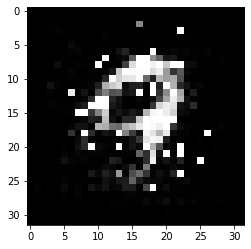

-------------------------------------


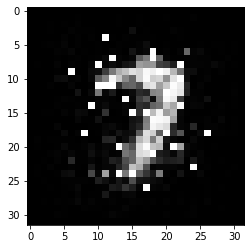

-------------------------------------


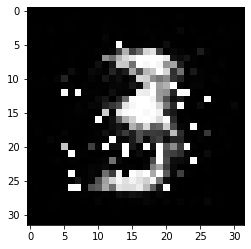

-------------------------------------


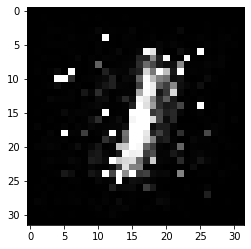

-------------------------------------


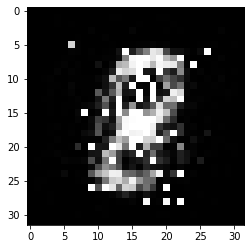

-------------------------------------


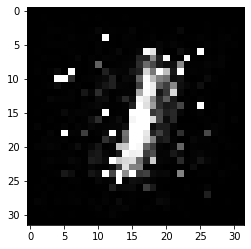

-------------------------------------


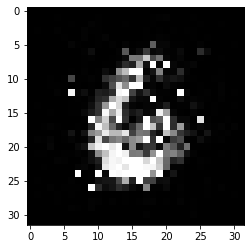

-------------------------------------


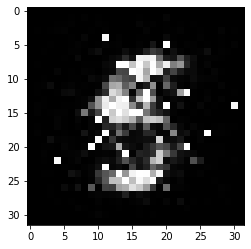

-------------------------------------


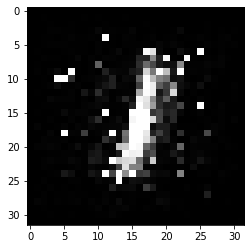

-------------------------------------


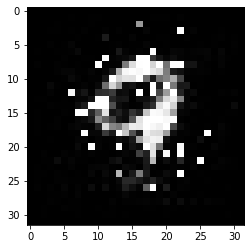

-------------------------------------


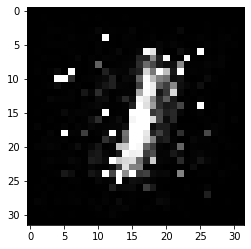

-------------------------------------


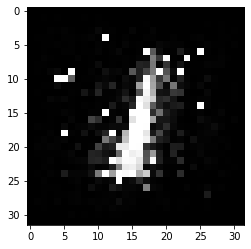

-------------------------------------


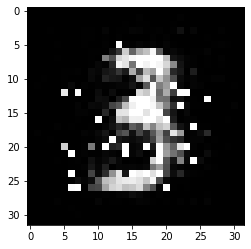

-------------------------------------


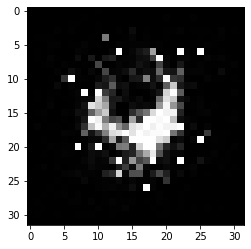

-------------------------------------


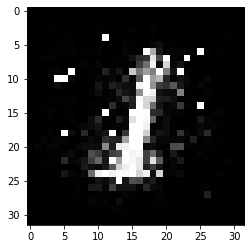

-------------------------------------


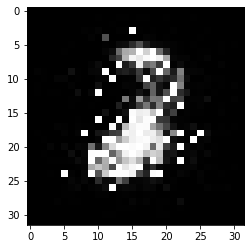

-------------------------------------


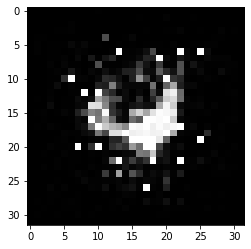

-------------------------------------


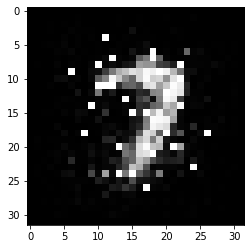

-------------------------------------


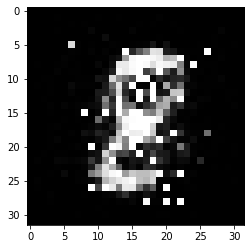

-------------------------------------


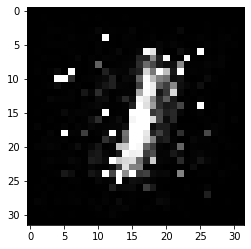

-------------------------------------


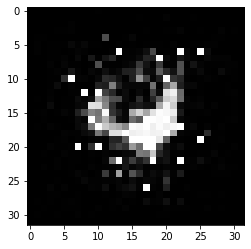

-------------------------------------


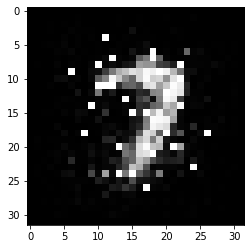

-------------------------------------


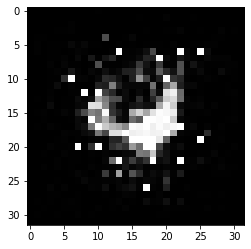

-------------------------------------


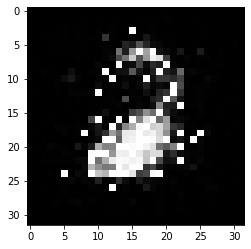

-------------------------------------


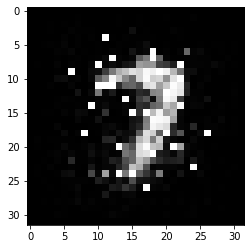

-------------------------------------


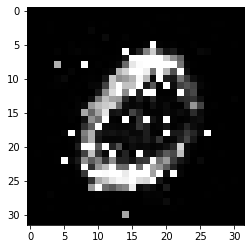

-------------------------------------


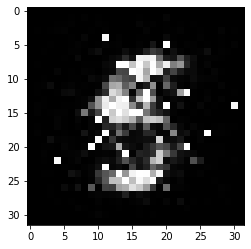

-------------------------------------


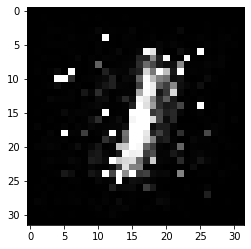

-------------------------------------


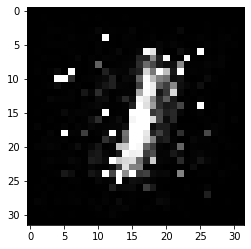

-------------------------------------


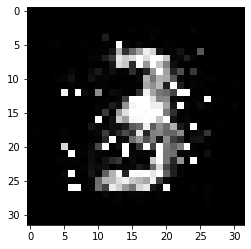

-------------------------------------


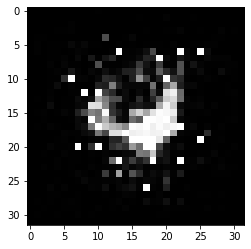

-------------------------------------


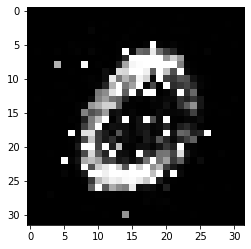

-------------------------------------


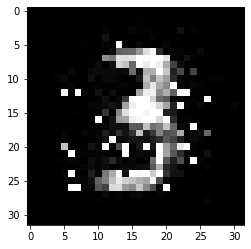

-------------------------------------


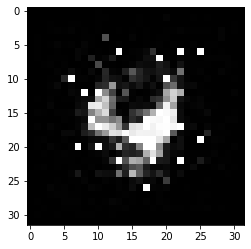

-------------------------------------


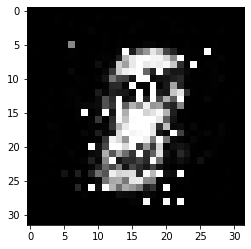

-------------------------------------


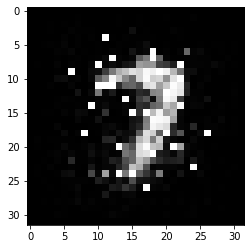

-------------------------------------


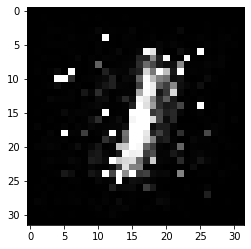

-------------------------------------


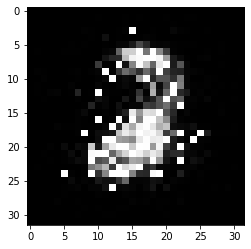

-------------------------------------


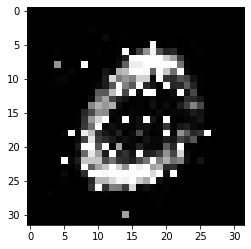

-------------------------------------


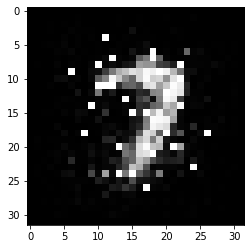

-------------------------------------


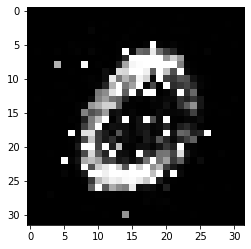

-------------------------------------


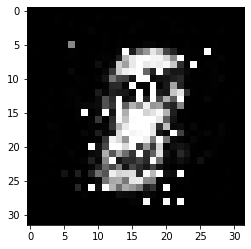

-------------------------------------


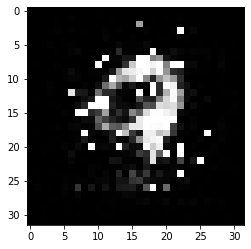

-------------------------------------


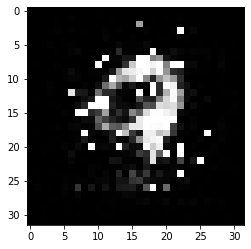

-------------------------------------


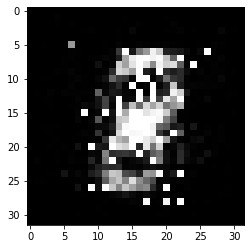

-------------------------------------


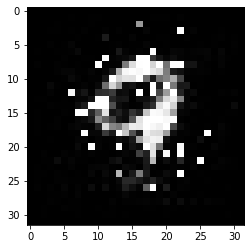

-------------------------------------


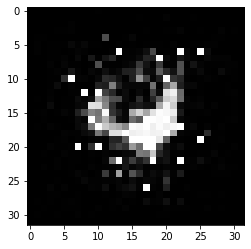

-------------------------------------


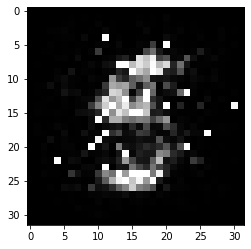

-------------------------------------


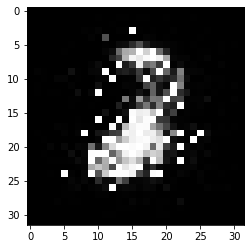

-------------------------------------


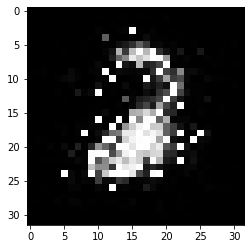

-------------------------------------


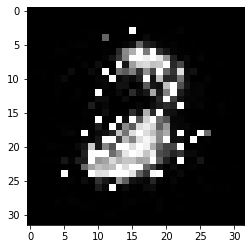

-------------------------------------


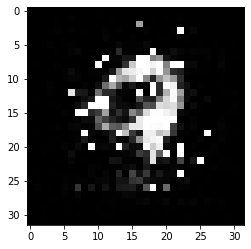

-------------------------------------


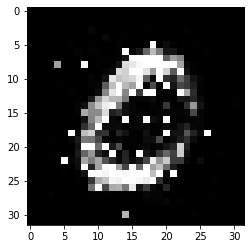

-------------------------------------


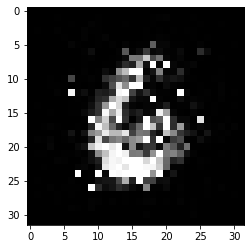

-------------------------------------


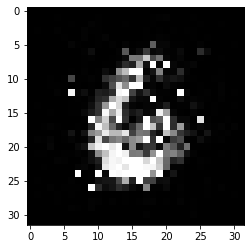

-------------------------------------


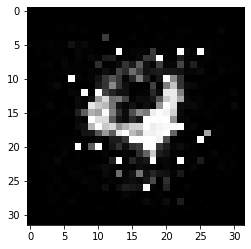

-------------------------------------


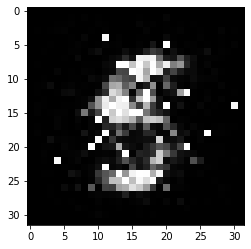

-------------------------------------


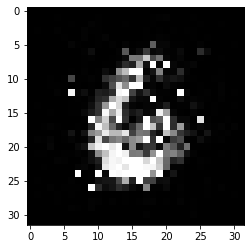

-------------------------------------


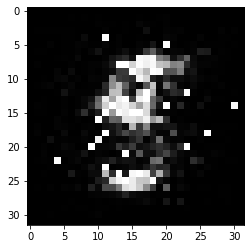

-------------------------------------


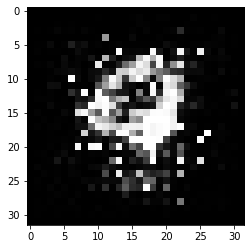

-------------------------------------


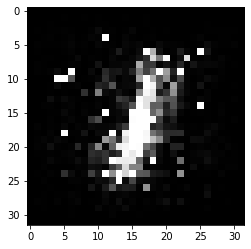

-------------------------------------


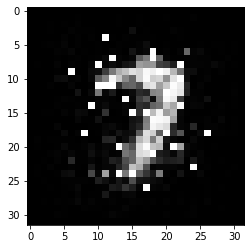

-------------------------------------


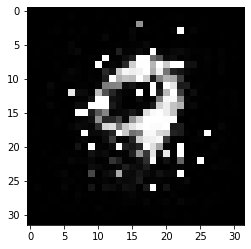

-------------------------------------


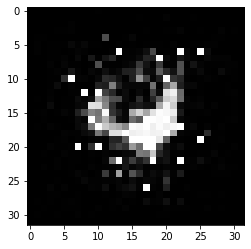

-------------------------------------


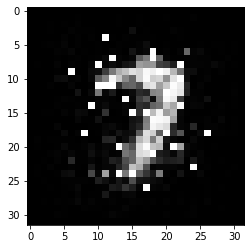

-------------------------------------


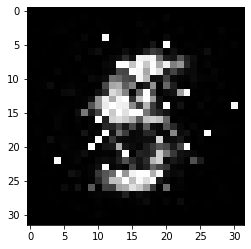

-------------------------------------


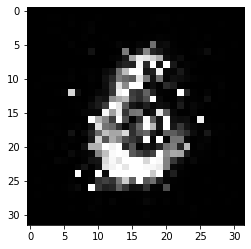

-------------------------------------


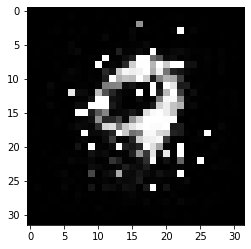

-------------------------------------


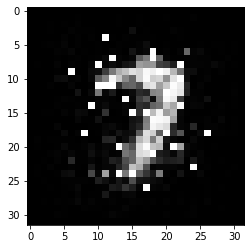

-------------------------------------


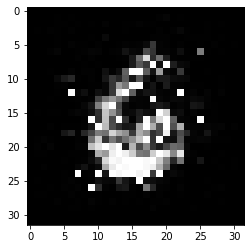

-------------------------------------


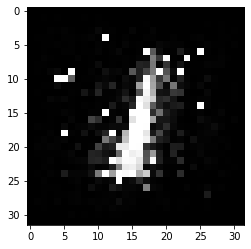

-------------------------------------


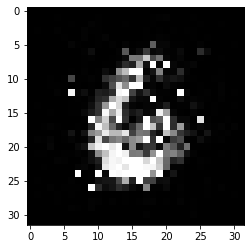

-------------------------------------


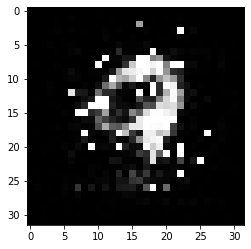

-------------------------------------


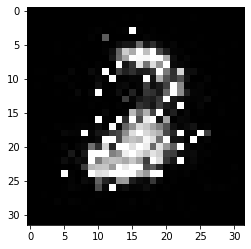

-------------------------------------


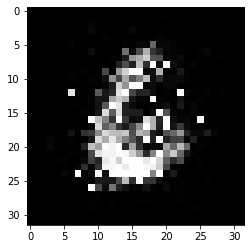

-------------------------------------


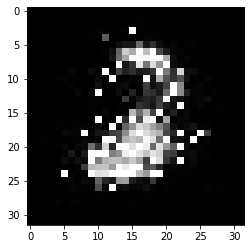

-------------------------------------


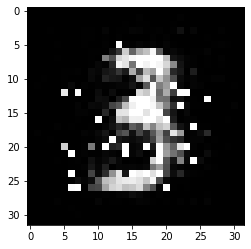

-------------------------------------


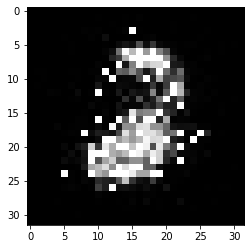

-------------------------------------


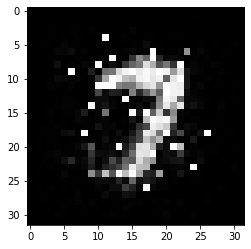

-------------------------------------


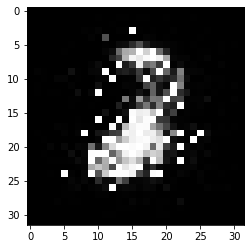

-------------------------------------


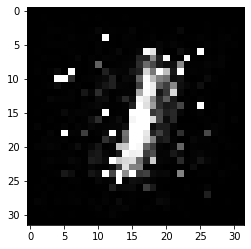

-------------------------------------


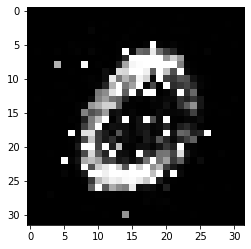

-------------------------------------


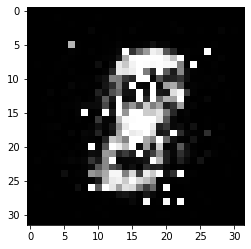

-------------------------------------


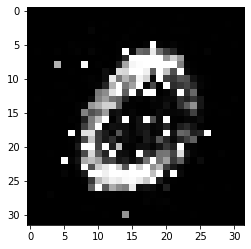

-------------------------------------


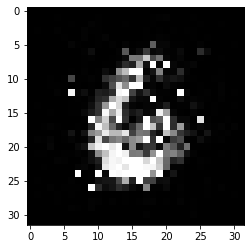

-------------------------------------


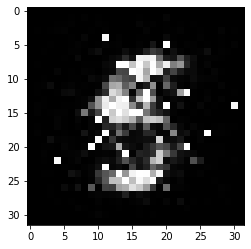

-------------------------------------


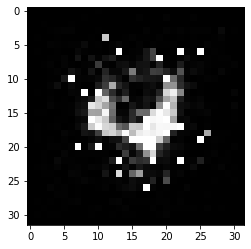

-------------------------------------


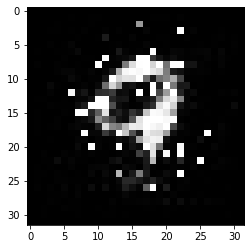

-------------------------------------


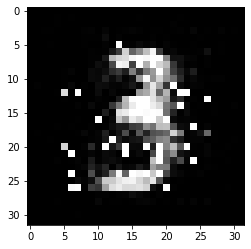

-------------------------------------


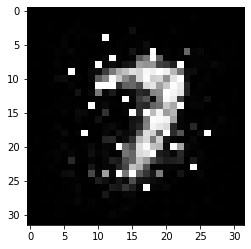

-------------------------------------


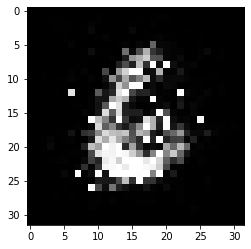

-------------------------------------


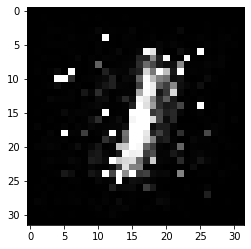

-------------------------------------


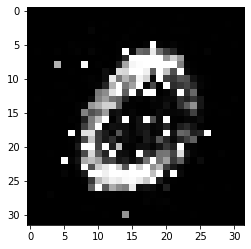

-------------------------------------


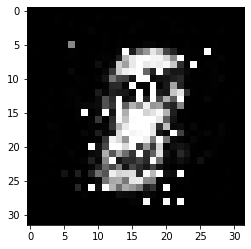

-------------------------------------


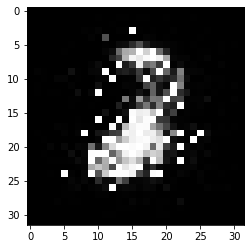

-------------------------------------


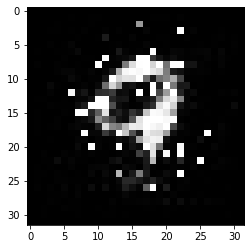

-------------------------------------


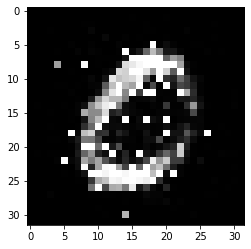

-------------------------------------


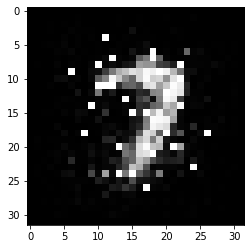

-------------------------------------


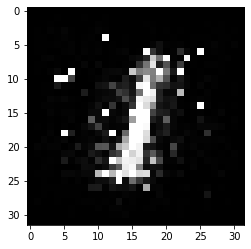

-------------------------------------


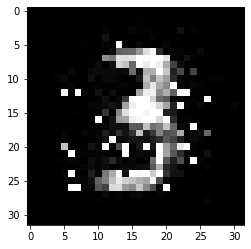

-------------------------------------


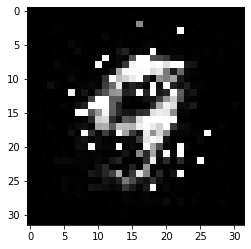

-------------------------------------


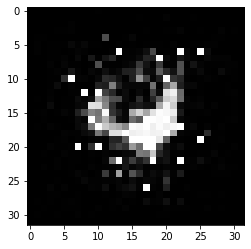

-------------------------------------


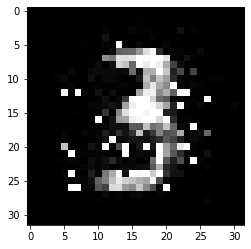

-------------------------------------


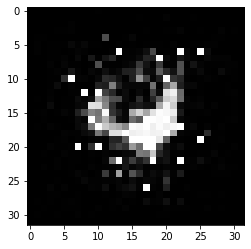

-------------------------------------


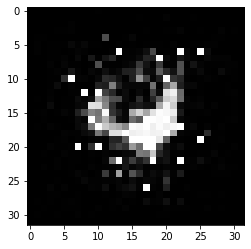

-------------------------------------


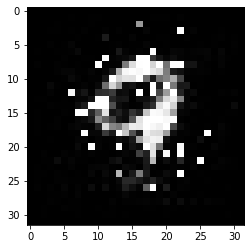

-------------------------------------


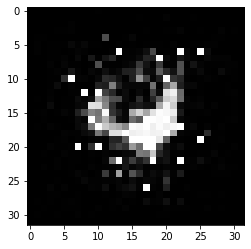

-------------------------------------


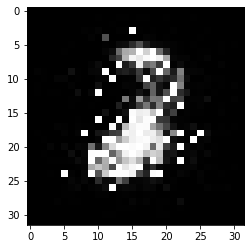

-------------------------------------


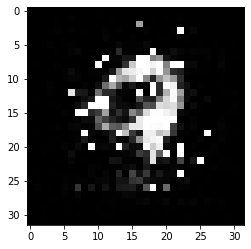

-------------------------------------


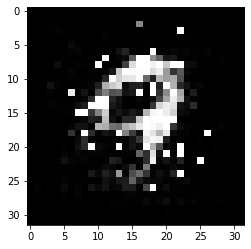

-------------------------------------


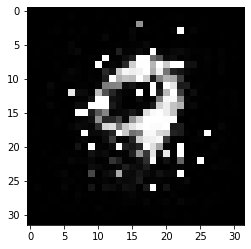

-------------------------------------


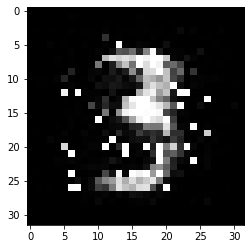

-------------------------------------


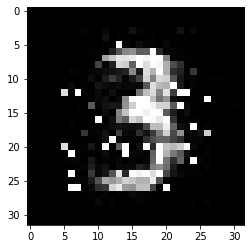

-------------------------------------


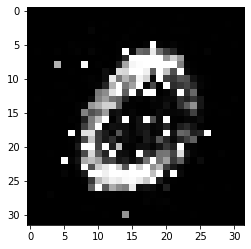

-------------------------------------


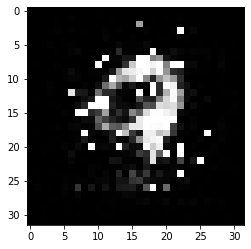

-------------------------------------


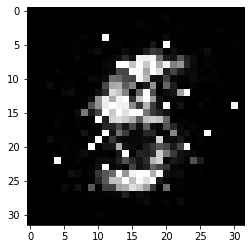

-------------------------------------


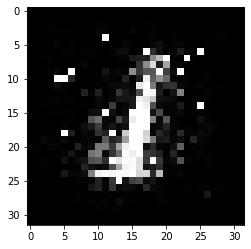

-------------------------------------


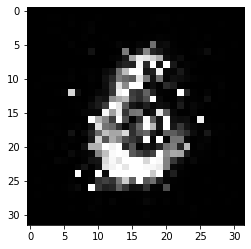

-------------------------------------


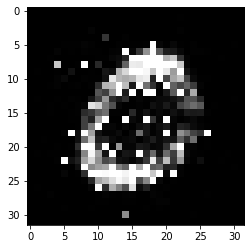

-------------------------------------


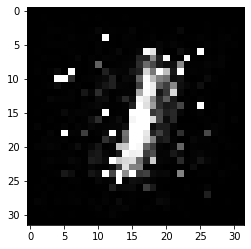

-------------------------------------


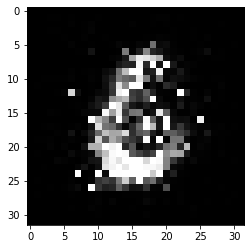

-------------------------------------


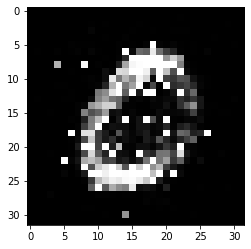

-------------------------------------


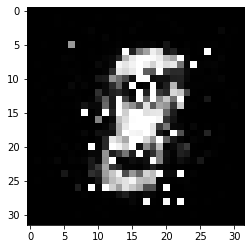

-------------------------------------


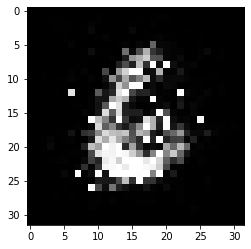

-------------------------------------


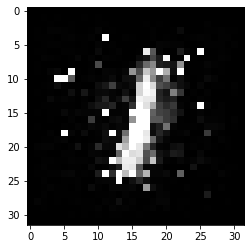

-------------------------------------


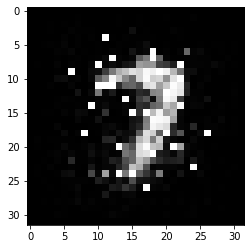

-------------------------------------


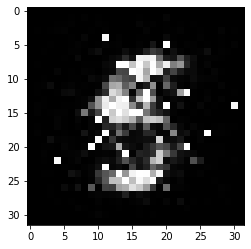

-------------------------------------


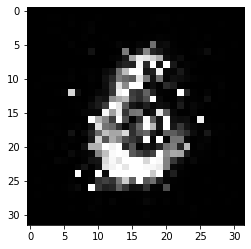

-------------------------------------


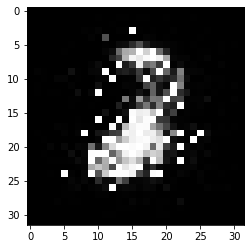

-------------------------------------


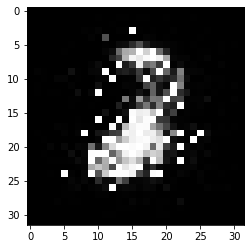

-------------------------------------


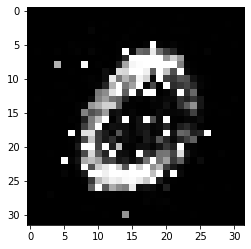

-------------------------------------


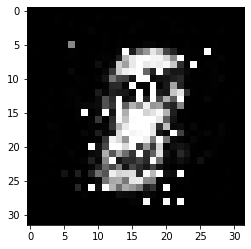

-------------------------------------


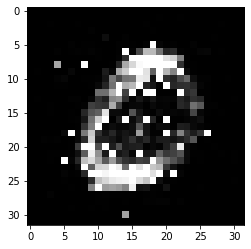

-------------------------------------


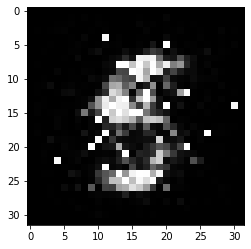

-------------------------------------


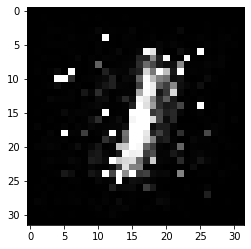

-------------------------------------


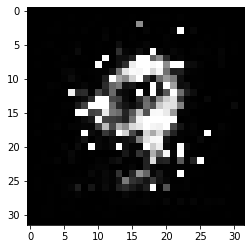

-------------------------------------


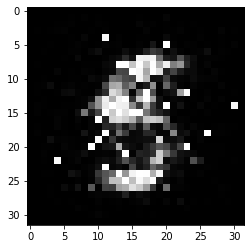

-------------------------------------


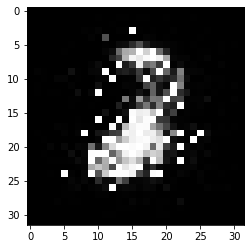

-------------------------------------


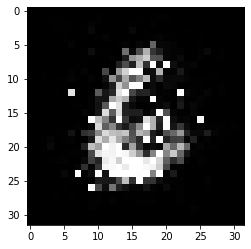

-------------------------------------


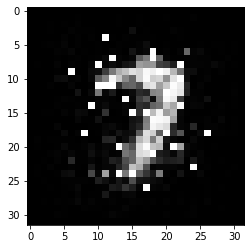

-------------------------------------


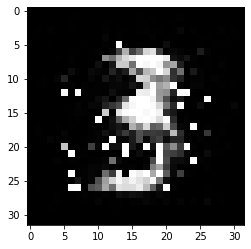

-------------------------------------


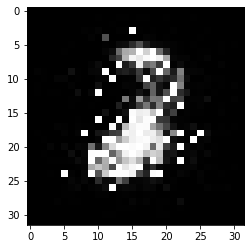

-------------------------------------


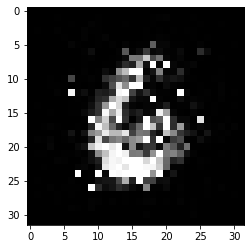

-------------------------------------


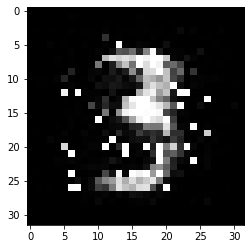

-------------------------------------


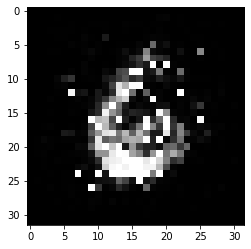

-------------------------------------


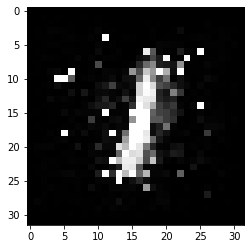

-------------------------------------


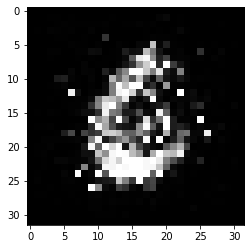

-------------------------------------


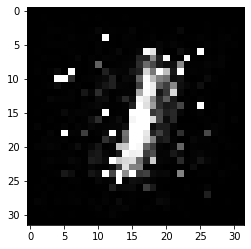

-------------------------------------


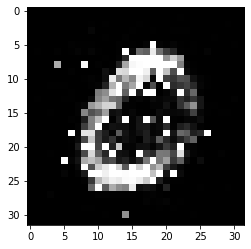

-------------------------------------


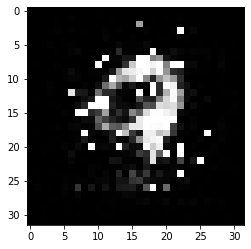

-------------------------------------


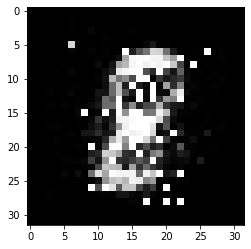

-------------------------------------


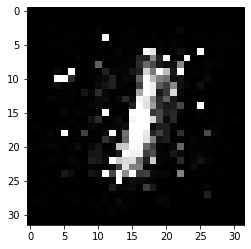

-------------------------------------


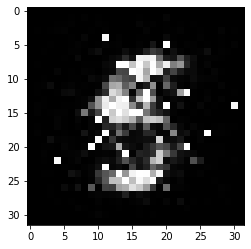

-------------------------------------


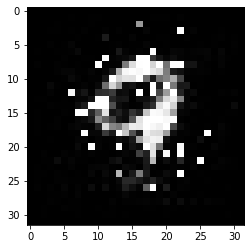

-------------------------------------


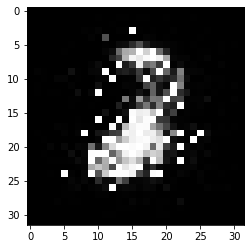

-------------------------------------


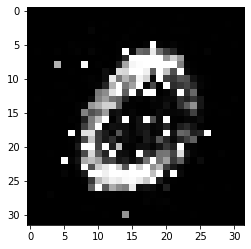

-------------------------------------


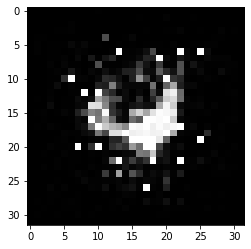

-------------------------------------


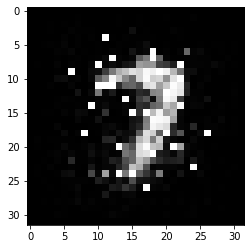

-------------------------------------


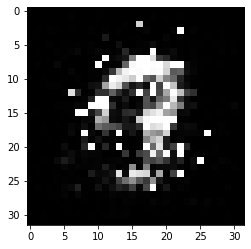

-------------------------------------


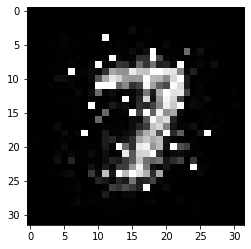

-------------------------------------


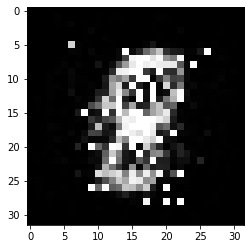

-------------------------------------


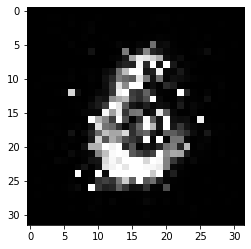

-------------------------------------


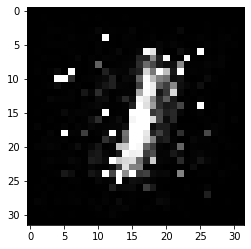

-------------------------------------


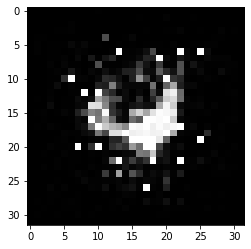

-------------------------------------


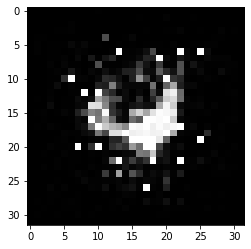

-------------------------------------


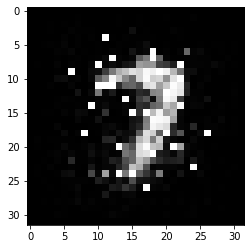

-------------------------------------


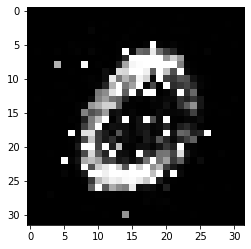

-------------------------------------


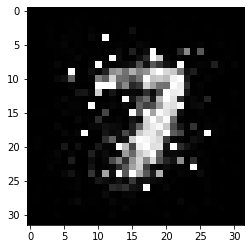

-------------------------------------


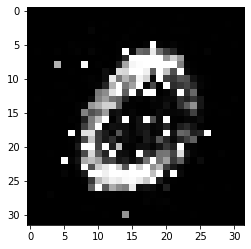

-------------------------------------


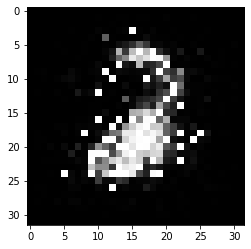

-------------------------------------


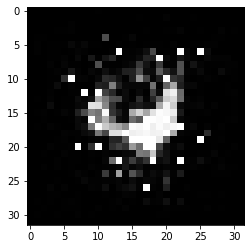

-------------------------------------


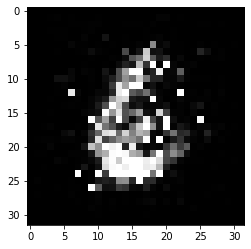

-------------------------------------


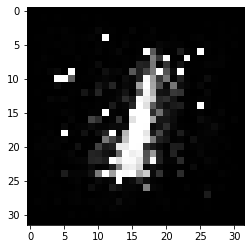

-------------------------------------


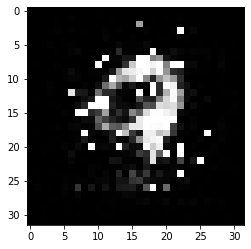

-------------------------------------


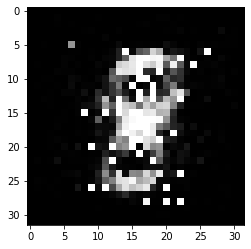

-------------------------------------


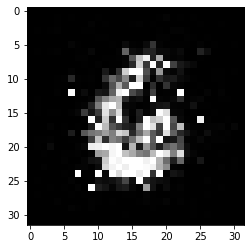

-------------------------------------


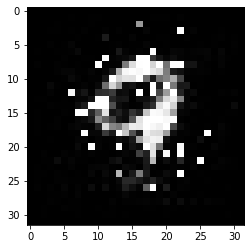

-------------------------------------


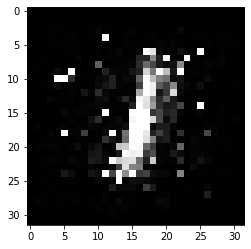

-------------------------------------


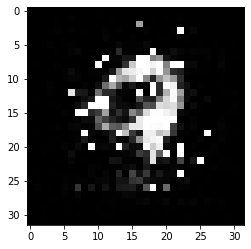

-------------------------------------


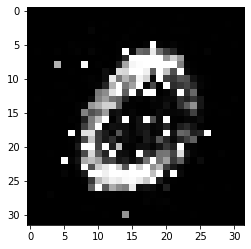

-------------------------------------


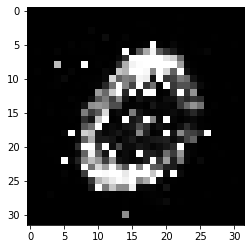

-------------------------------------


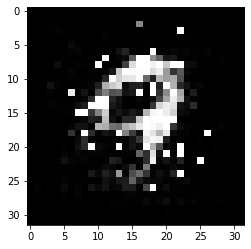

-------------------------------------


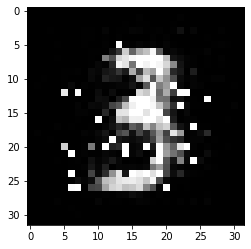

-------------------------------------


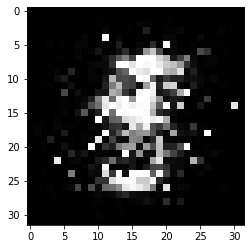

-------------------------------------


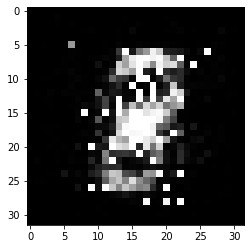

-------------------------------------


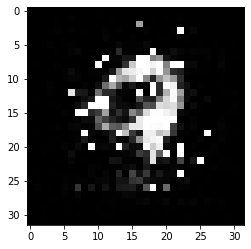

-------------------------------------


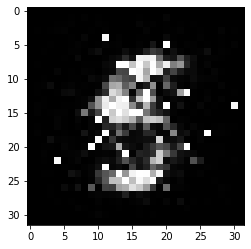

-------------------------------------


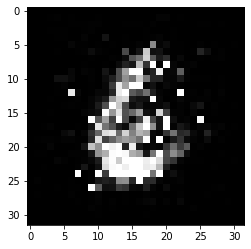

-------------------------------------


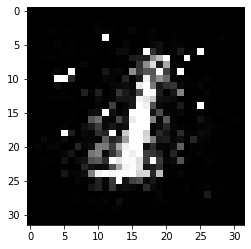

-------------------------------------


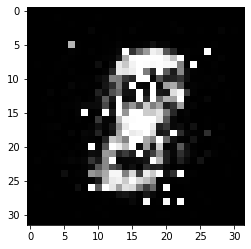

-------------------------------------


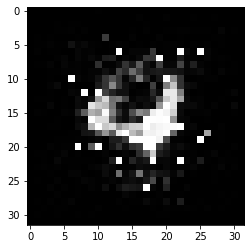

-------------------------------------


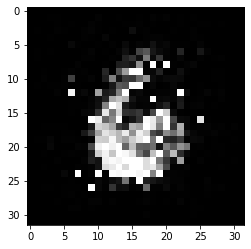

-------------------------------------


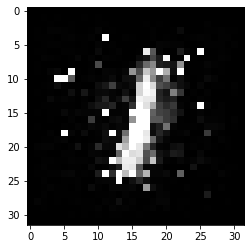

-------------------------------------


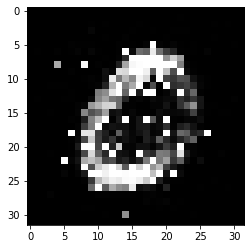

-------------------------------------


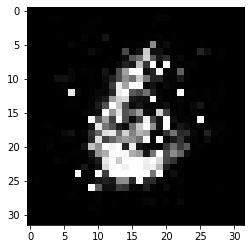

-------------------------------------


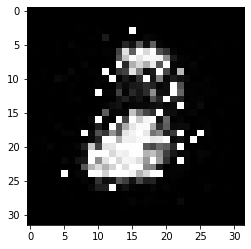

-------------------------------------


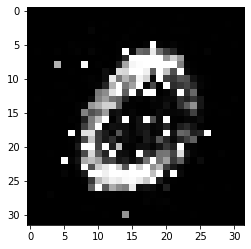

-------------------------------------


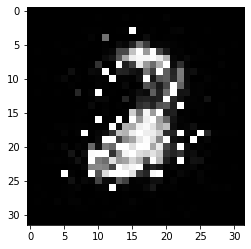

-------------------------------------


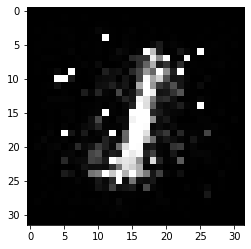

-------------------------------------


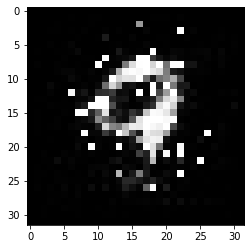

-------------------------------------


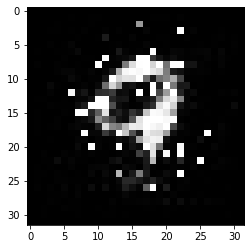

-------------------------------------


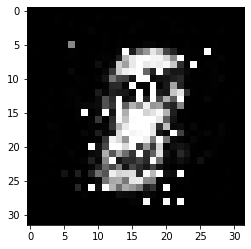

-------------------------------------


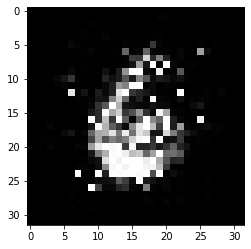

-------------------------------------


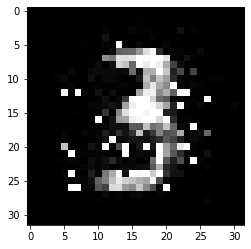

-------------------------------------


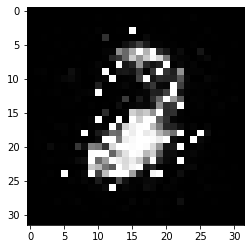

-------------------------------------


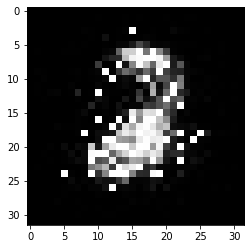

-------------------------------------


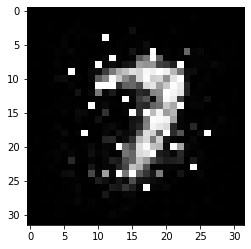

-------------------------------------


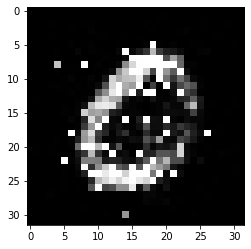

-------------------------------------


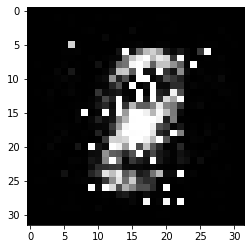

-------------------------------------


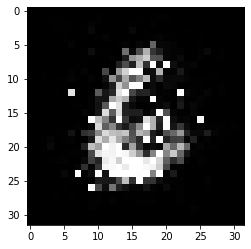

-------------------------------------


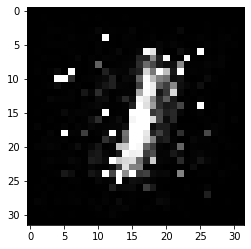

-------------------------------------


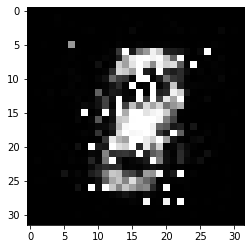

-------------------------------------


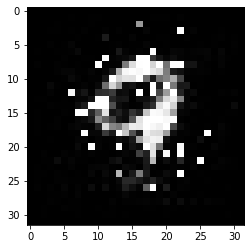

-------------------------------------


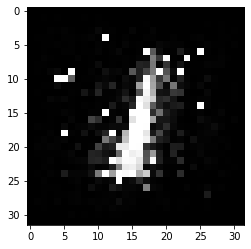

-------------------------------------


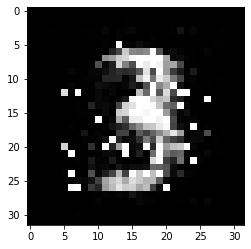

-------------------------------------


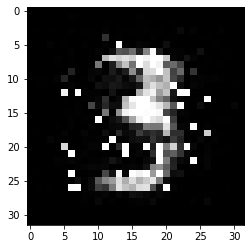

-------------------------------------


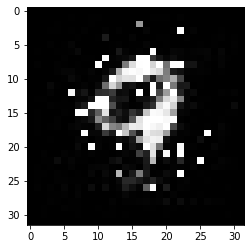

-------------------------------------


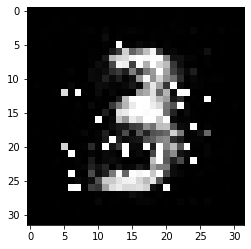

-------------------------------------


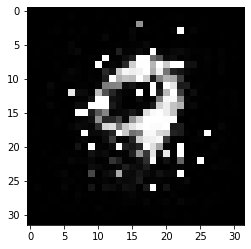

-------------------------------------


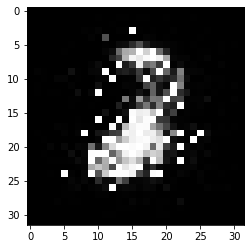

-------------------------------------


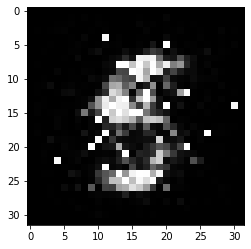

-------------------------------------


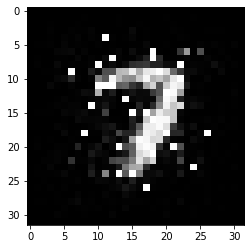

-------------------------------------


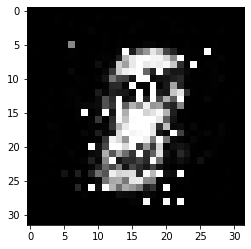

-------------------------------------


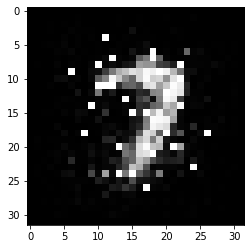

-------------------------------------


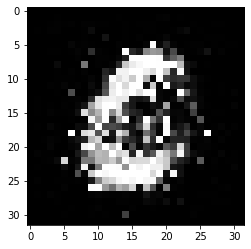

-------------------------------------


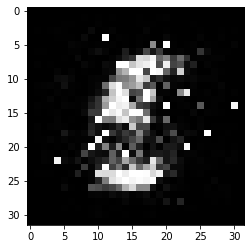

-------------------------------------


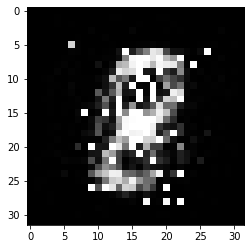

-------------------------------------


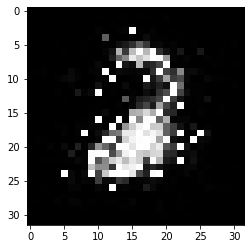

-------------------------------------


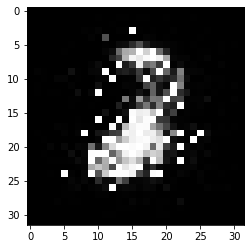

-------------------------------------


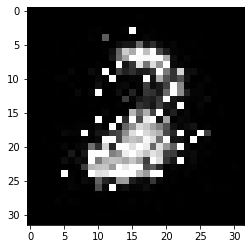

-------------------------------------


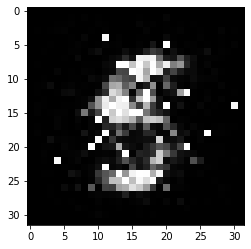

-------------------------------------


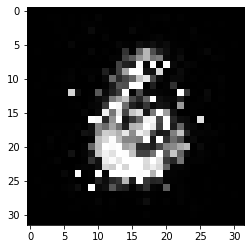

-------------------------------------


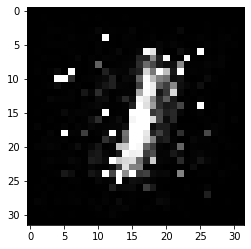

-------------------------------------


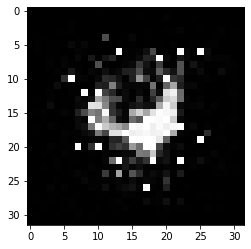

-------------------------------------


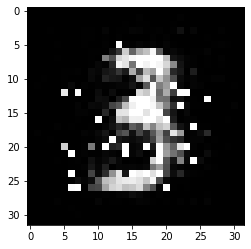

-------------------------------------


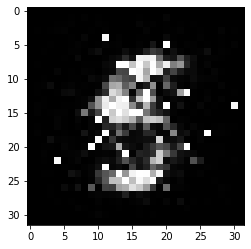

-------------------------------------


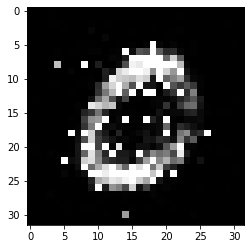

-------------------------------------


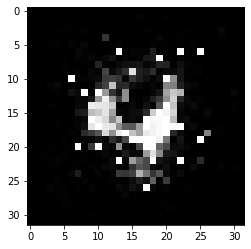

-------------------------------------


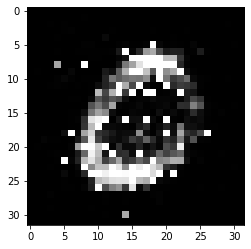

-------------------------------------


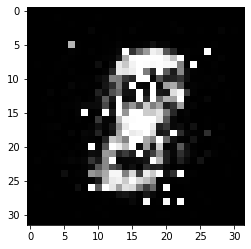

-------------------------------------


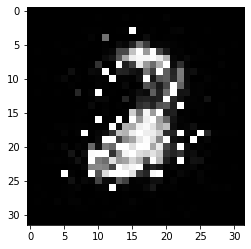

-------------------------------------


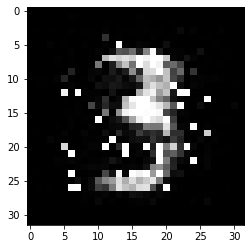

-------------------------------------


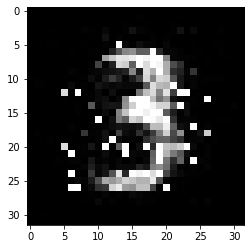

-------------------------------------


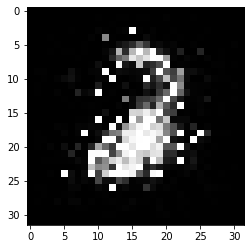

-------------------------------------


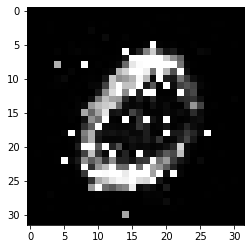

-------------------------------------


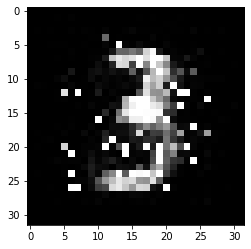

-------------------------------------


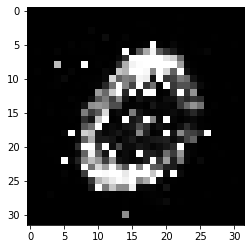

-------------------------------------


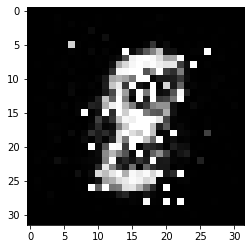

-------------------------------------


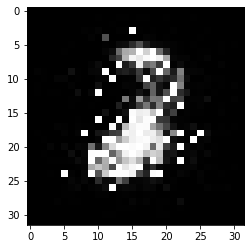

-------------------------------------


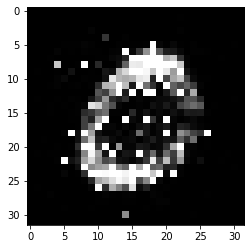

-------------------------------------


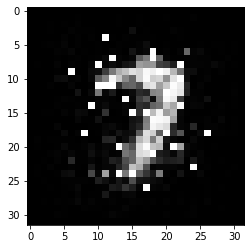

-------------------------------------


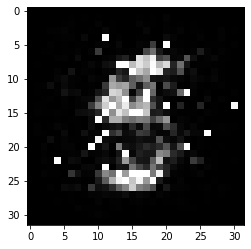

-------------------------------------


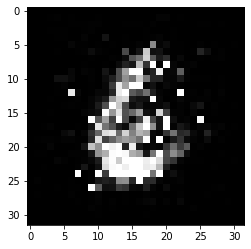

-------------------------------------


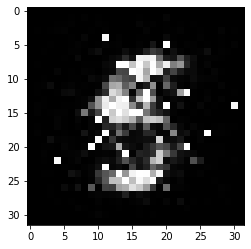

-------------------------------------


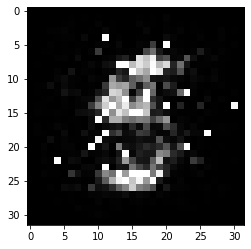

-------------------------------------


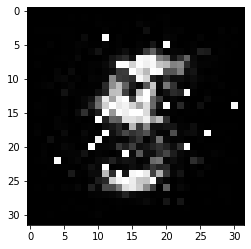

-------------------------------------


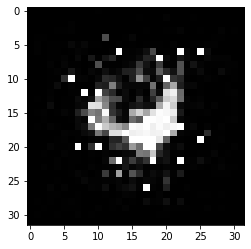

-------------------------------------


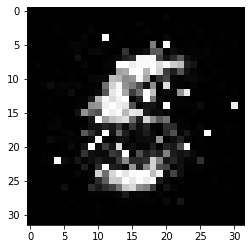

-------------------------------------


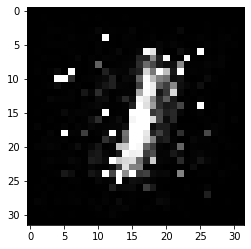

-------------------------------------


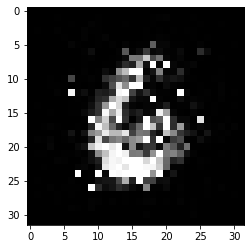

-------------------------------------


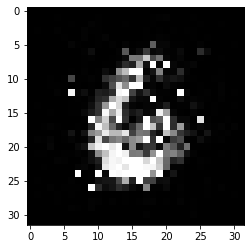

-------------------------------------


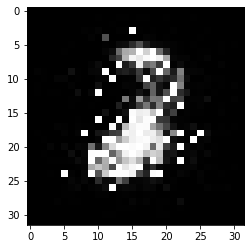

-------------------------------------


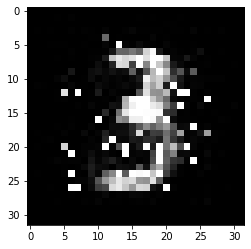

-------------------------------------


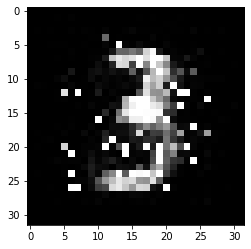

-------------------------------------


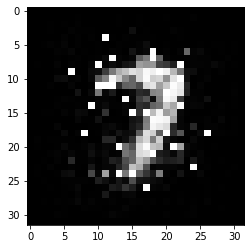

-------------------------------------


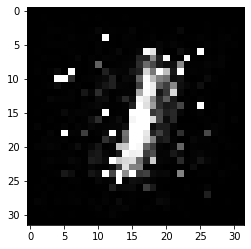

-------------------------------------


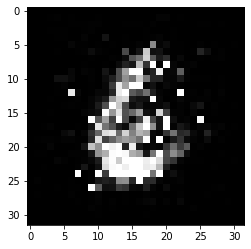

-------------------------------------


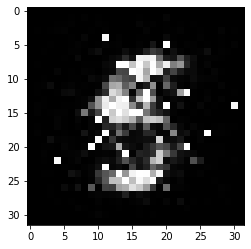

-------------------------------------


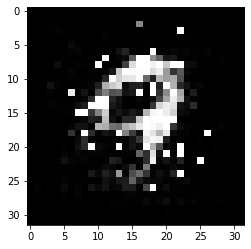

-------------------------------------


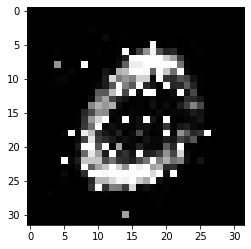

-------------------------------------


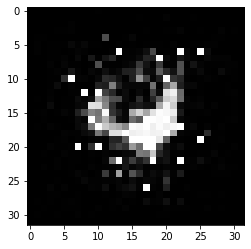

-------------------------------------


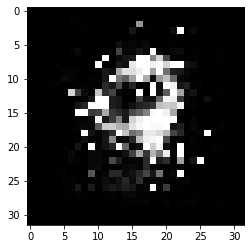

-------------------------------------


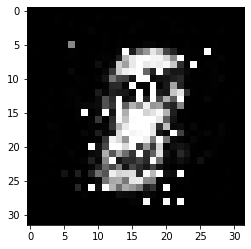

-------------------------------------


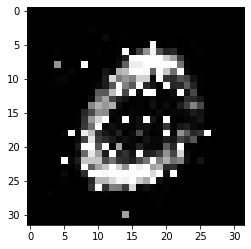

-------------------------------------


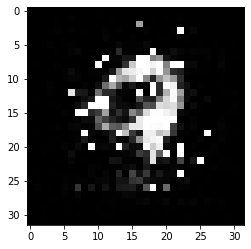

-------------------------------------


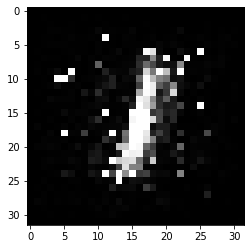

-------------------------------------


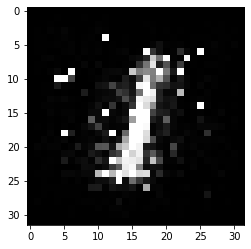

-------------------------------------


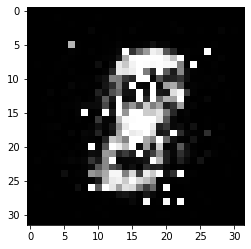

-------------------------------------


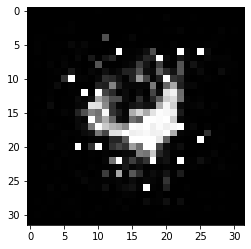

-------------------------------------


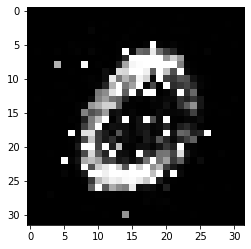

-------------------------------------


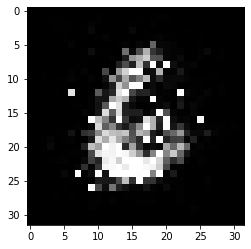

-------------------------------------


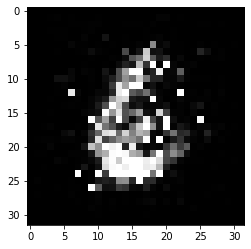

-------------------------------------


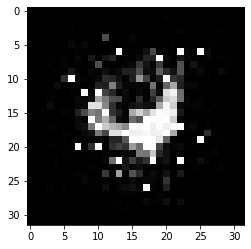

-------------------------------------


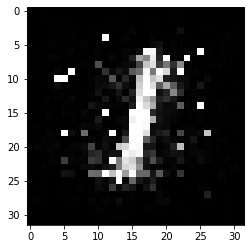

-------------------------------------


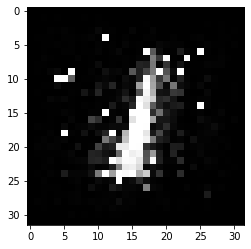

-------------------------------------


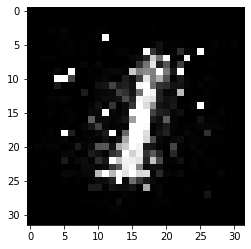

-------------------------------------


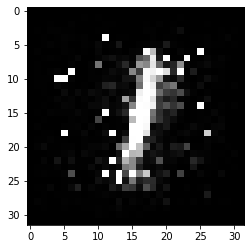

-------------------------------------


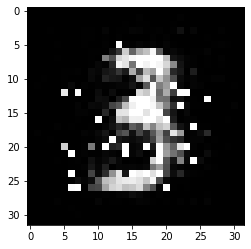

-------------------------------------


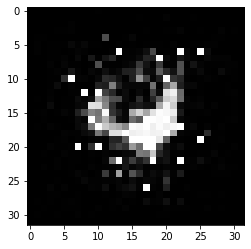

-------------------------------------


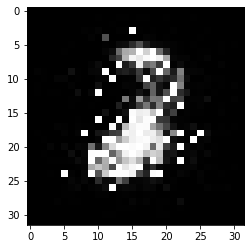

-------------------------------------


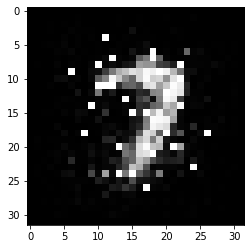

-------------------------------------


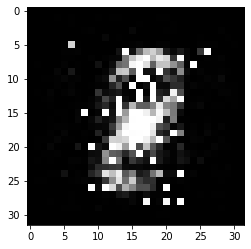

-------------------------------------


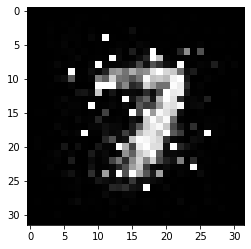

-------------------------------------


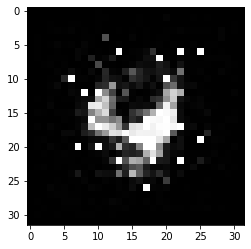

-------------------------------------


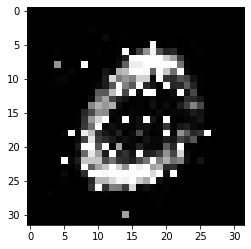

-------------------------------------


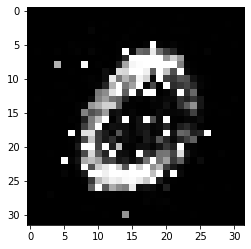

-------------------------------------


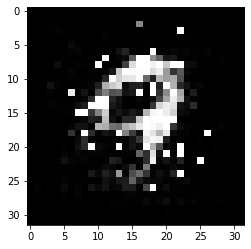

-------------------------------------


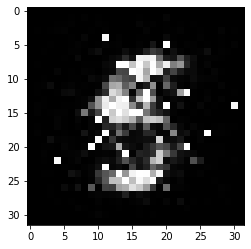

-------------------------------------


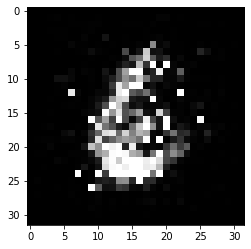

-------------------------------------


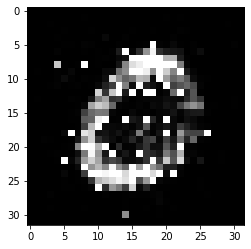

-------------------------------------


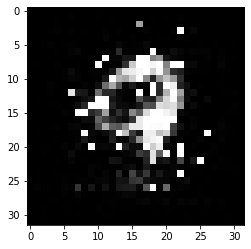

-------------------------------------


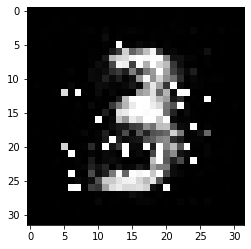

-------------------------------------


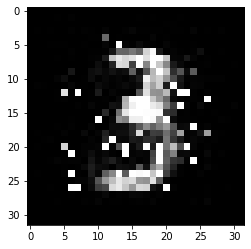

-------------------------------------


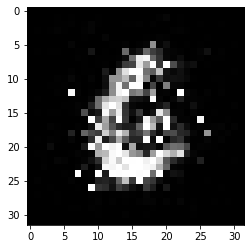

-------------------------------------


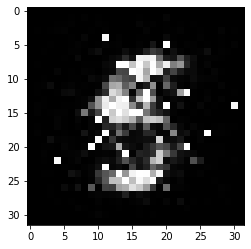

-------------------------------------


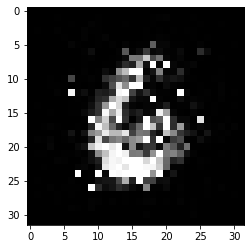

-------------------------------------


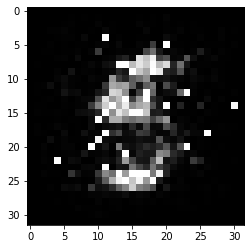

-------------------------------------


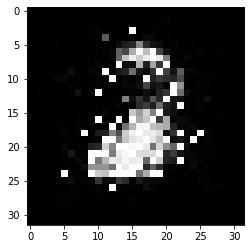

-------------------------------------


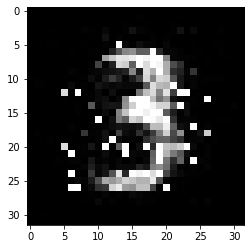

-------------------------------------


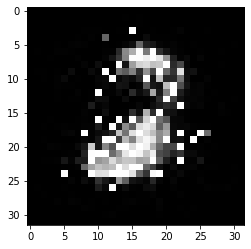

-------------------------------------


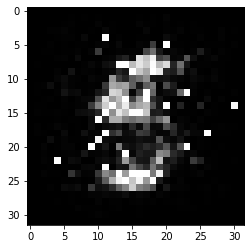

-------------------------------------


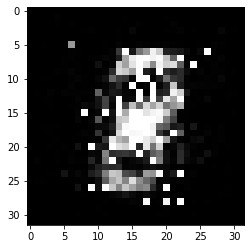

-------------------------------------


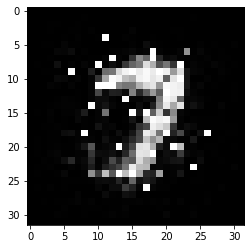

-------------------------------------


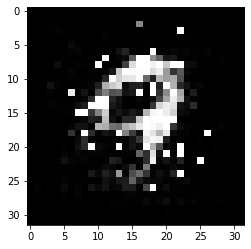

-------------------------------------


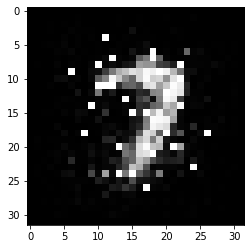

-------------------------------------


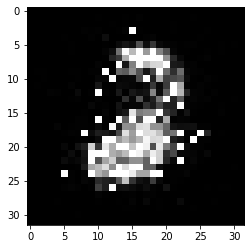

-------------------------------------


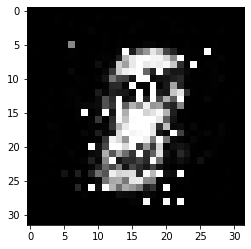

-------------------------------------


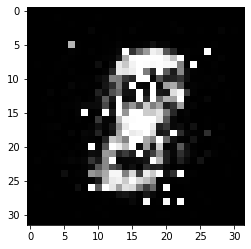

-------------------------------------


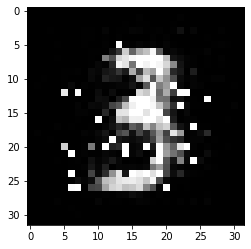

-------------------------------------


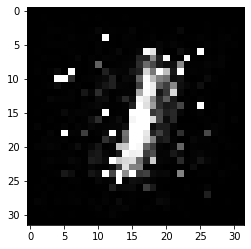

-------------------------------------


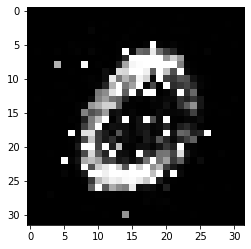

-------------------------------------


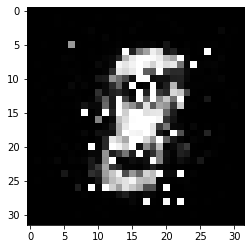

-------------------------------------


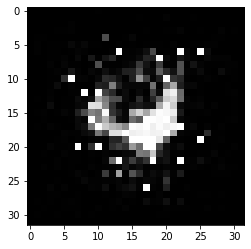

-------------------------------------


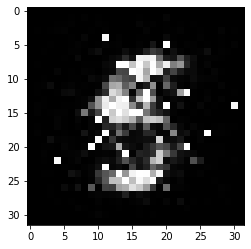

-------------------------------------


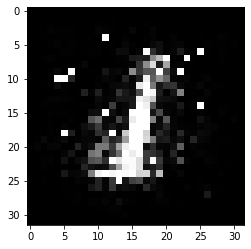

-------------------------------------


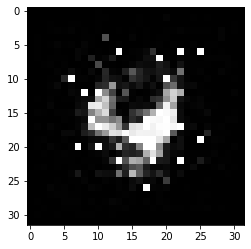

-------------------------------------


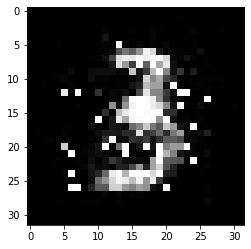

-------------------------------------


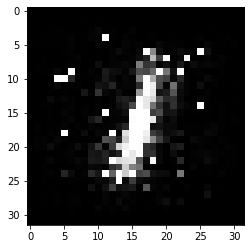

-------------------------------------


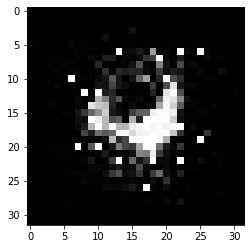

-------------------------------------


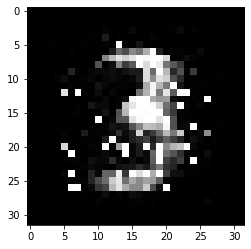

-------------------------------------


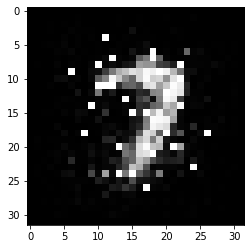

-------------------------------------


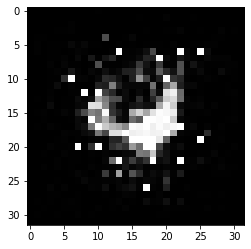

-------------------------------------


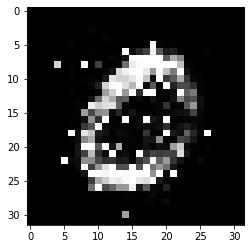

-------------------------------------


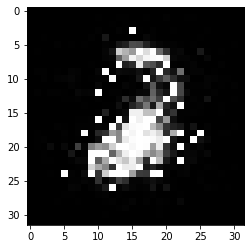

-------------------------------------


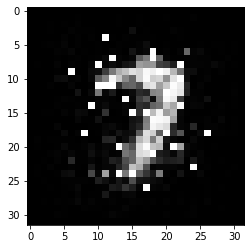

-------------------------------------


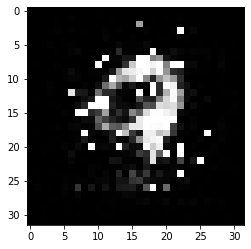

-------------------------------------


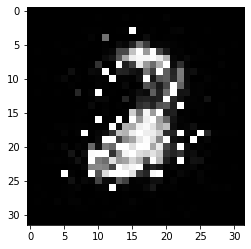

-------------------------------------


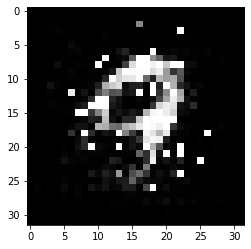

-------------------------------------


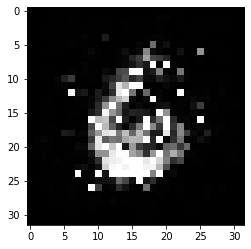

-------------------------------------


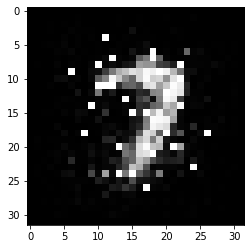

-------------------------------------


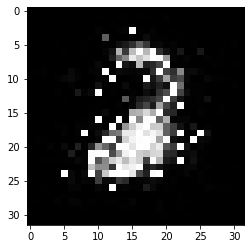

-------------------------------------


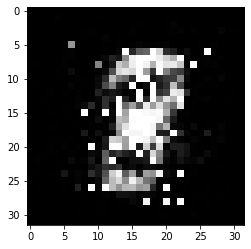

-------------------------------------


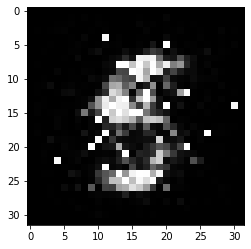

-------------------------------------


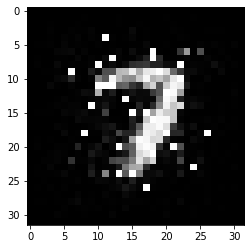

-------------------------------------


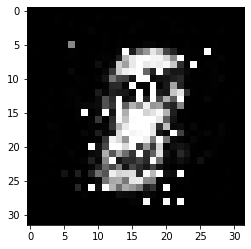

-------------------------------------


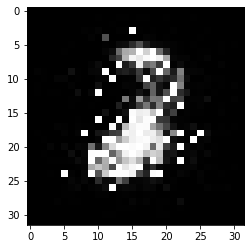

-------------------------------------


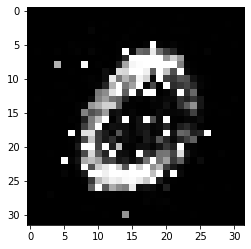

-------------------------------------


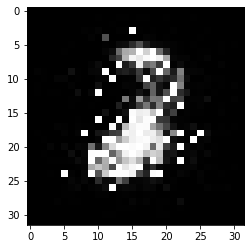

-------------------------------------


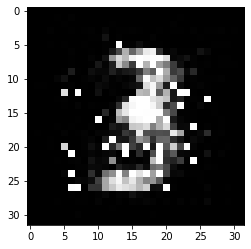

-------------------------------------


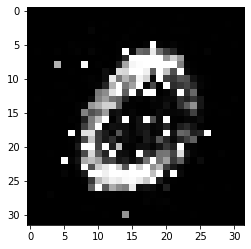

-------------------------------------


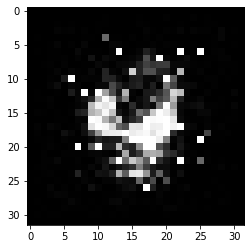

-------------------------------------


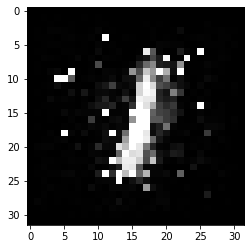

-------------------------------------


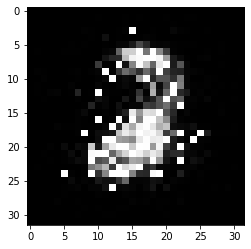

-------------------------------------


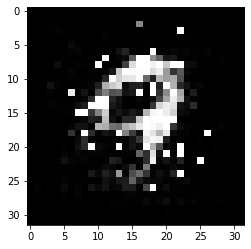

-------------------------------------


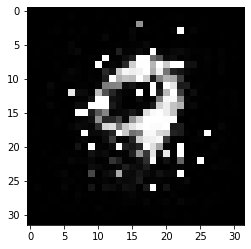

-------------------------------------


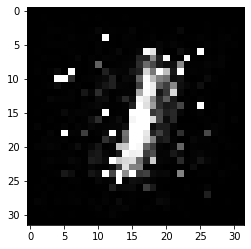

-------------------------------------


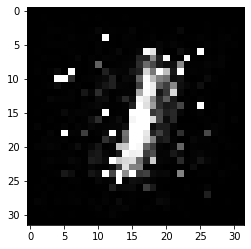

-------------------------------------


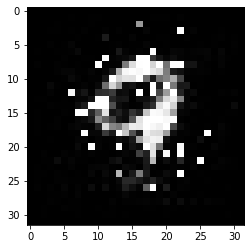

-------------------------------------


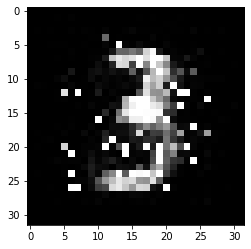

-------------------------------------


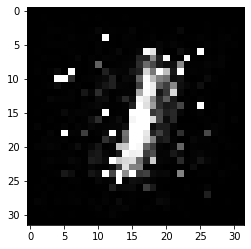

-------------------------------------


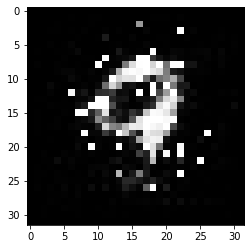

-------------------------------------


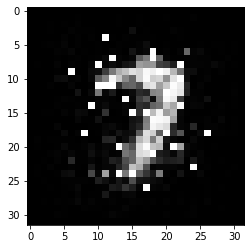

-------------------------------------


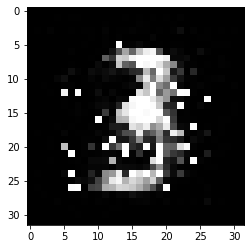

-------------------------------------


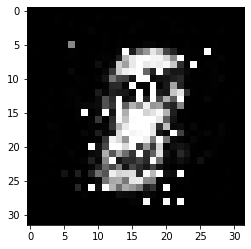

-------------------------------------


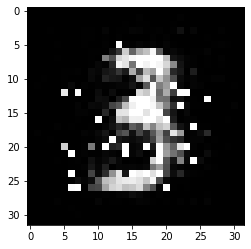

-------------------------------------


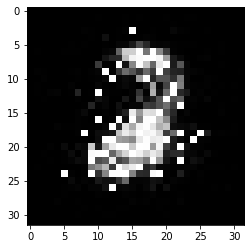

-------------------------------------


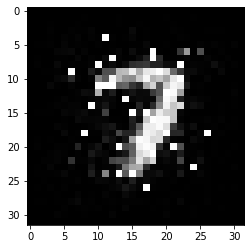

-------------------------------------


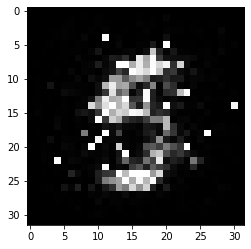

-------------------------------------


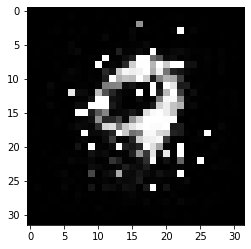

-------------------------------------


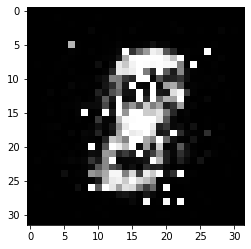

-------------------------------------


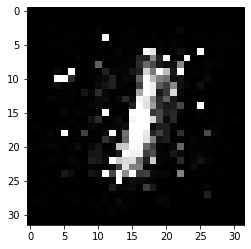

-------------------------------------


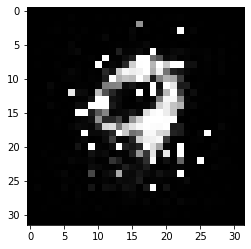

-------------------------------------


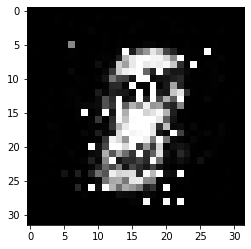

-------------------------------------


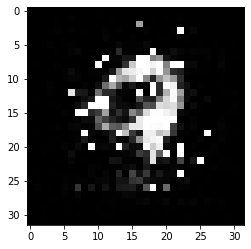

-------------------------------------


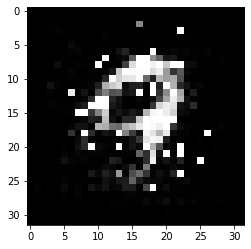

-------------------------------------


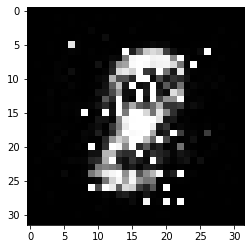

-------------------------------------


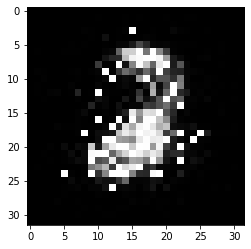

-------------------------------------


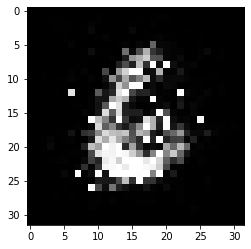

-------------------------------------


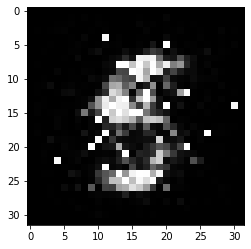

-------------------------------------


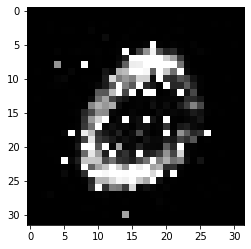

-------------------------------------


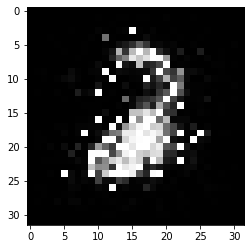

-------------------------------------


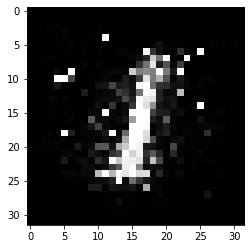

-------------------------------------


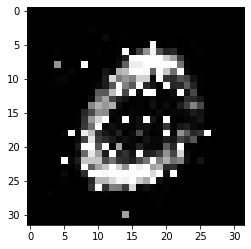

-------------------------------------


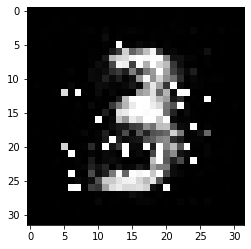

-------------------------------------


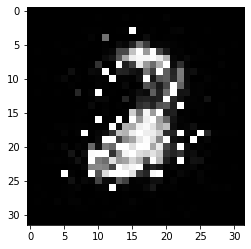

-------------------------------------


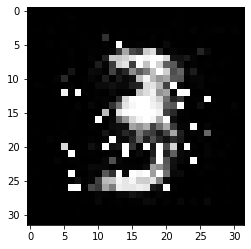

-------------------------------------


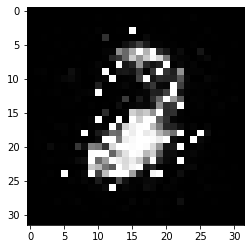

-------------------------------------


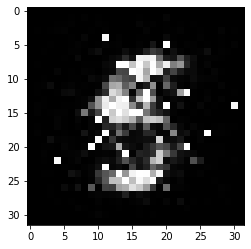

-------------------------------------


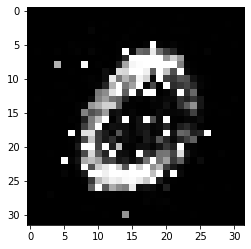

-------------------------------------


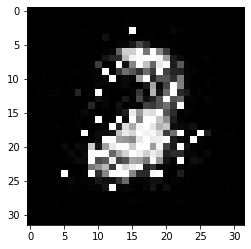

-------------------------------------


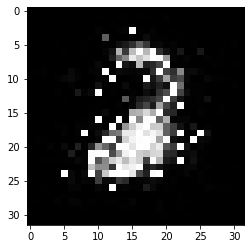

-------------------------------------


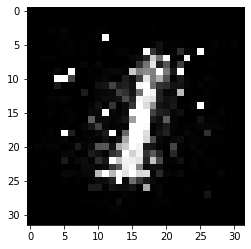

-------------------------------------


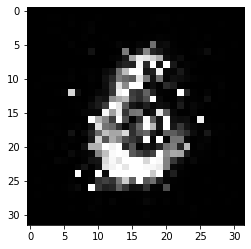

-------------------------------------


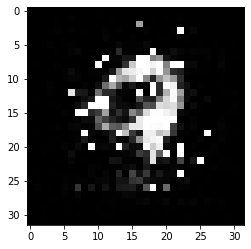

-------------------------------------


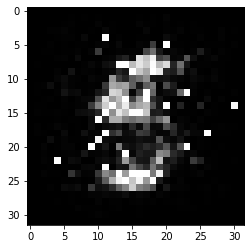

-------------------------------------


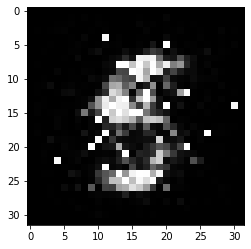

-------------------------------------


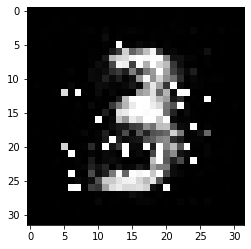

-------------------------------------


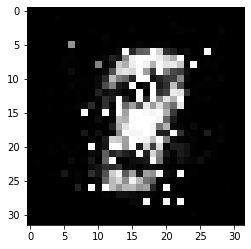

-------------------------------------


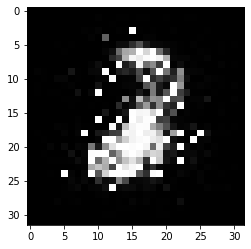

-------------------------------------


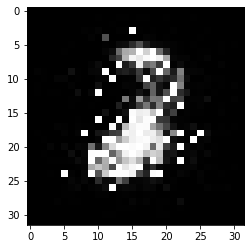

-------------------------------------


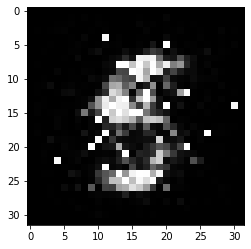

-------------------------------------


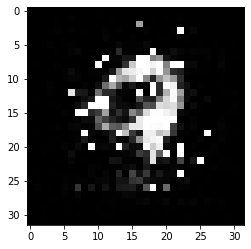

-------------------------------------


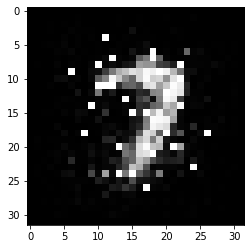

-------------------------------------


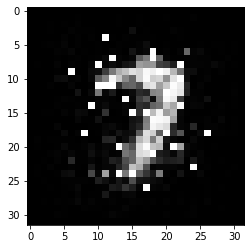

-------------------------------------


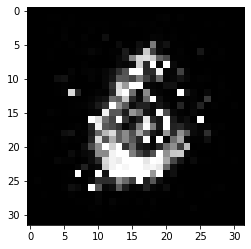

-------------------------------------


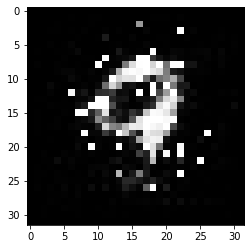

-------------------------------------


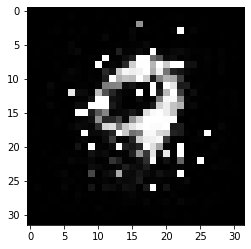

-------------------------------------


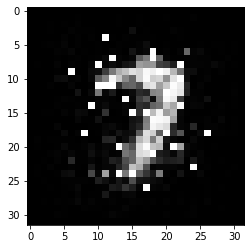

-------------------------------------


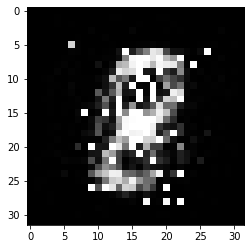

-------------------------------------


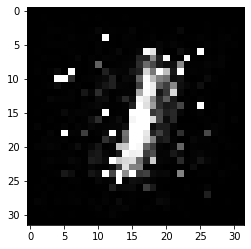

-------------------------------------


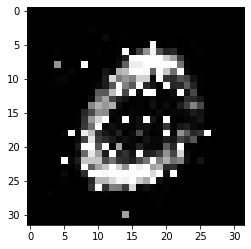

-------------------------------------


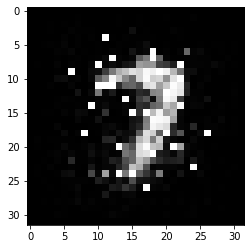

-------------------------------------


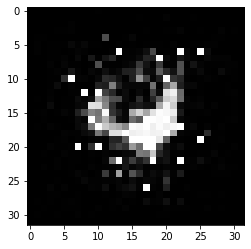

-------------------------------------


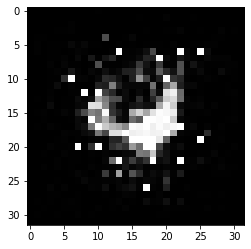

-------------------------------------


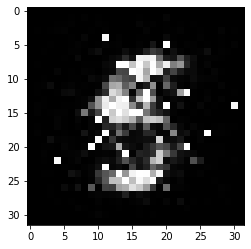

-------------------------------------


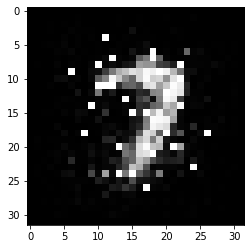

-------------------------------------


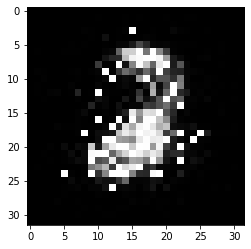

-------------------------------------


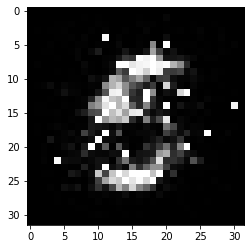

-------------------------------------


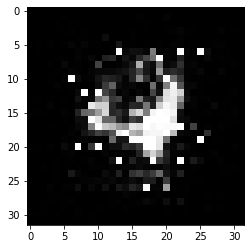

-------------------------------------


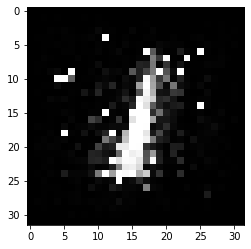

-------------------------------------


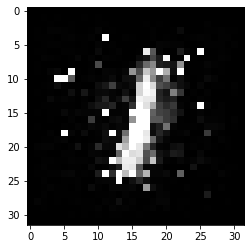

-------------------------------------


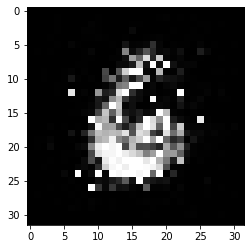

-------------------------------------


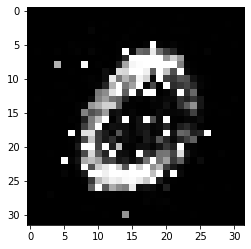

-------------------------------------


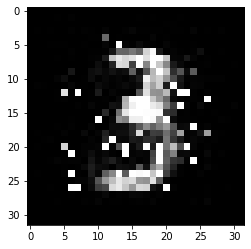

-------------------------------------


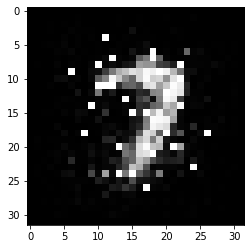

-------------------------------------


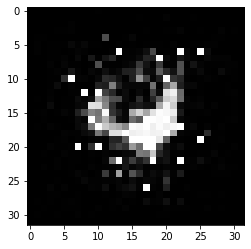

-------------------------------------


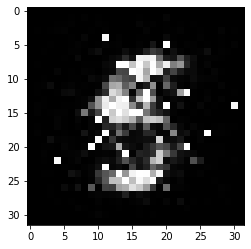

-------------------------------------


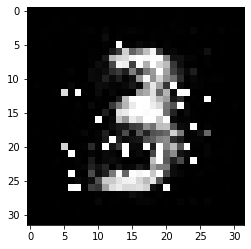

-------------------------------------


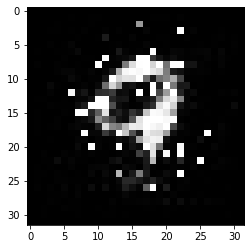

-------------------------------------


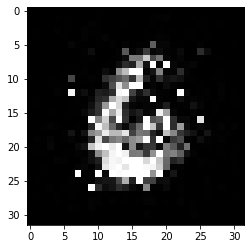

-------------------------------------


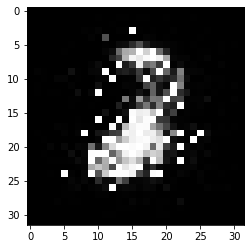

-------------------------------------


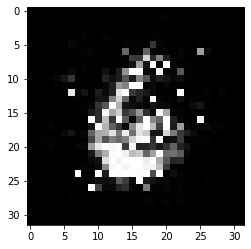

-------------------------------------


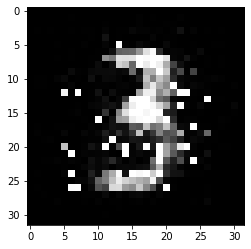

-------------------------------------


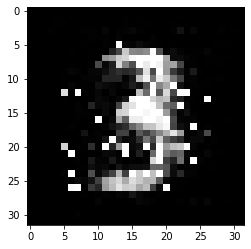

-------------------------------------


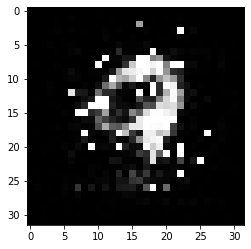

-------------------------------------


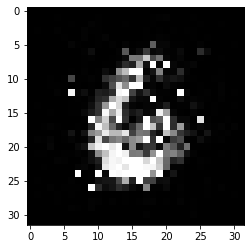

-------------------------------------


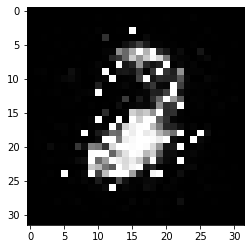

-------------------------------------


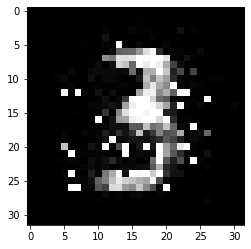

-------------------------------------


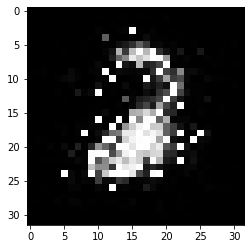

-------------------------------------


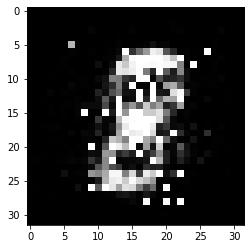

-------------------------------------


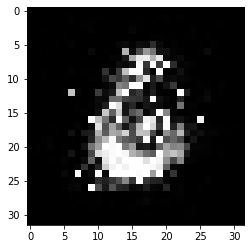

-------------------------------------


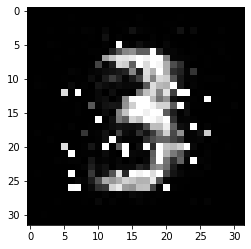

-------------------------------------


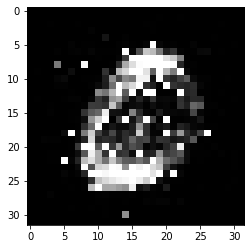

-------------------------------------


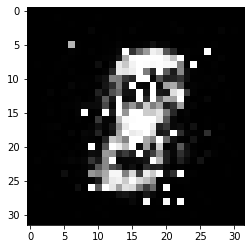

-------------------------------------


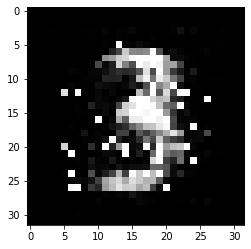

-------------------------------------


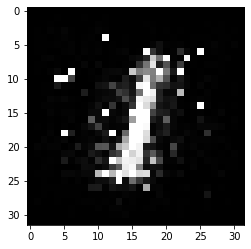

-------------------------------------


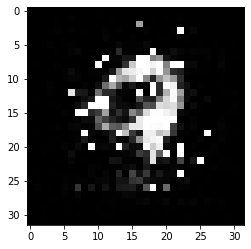

-------------------------------------


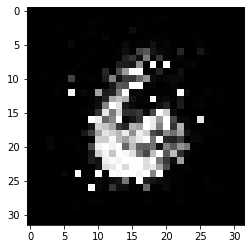

-------------------------------------


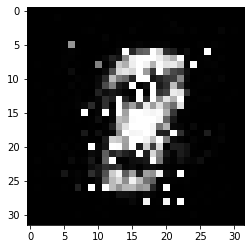

-------------------------------------


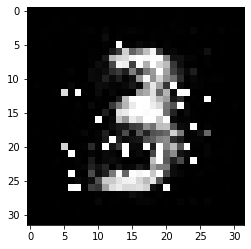

-------------------------------------


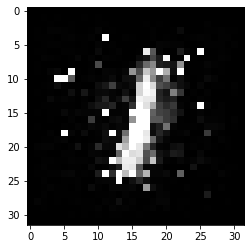

-------------------------------------


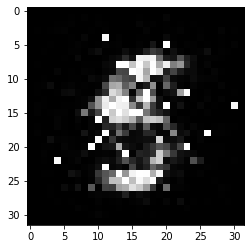

-------------------------------------


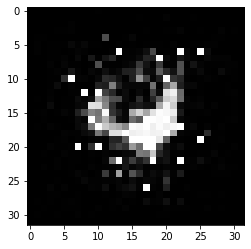

-------------------------------------


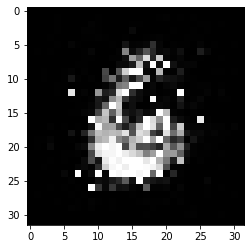

-------------------------------------


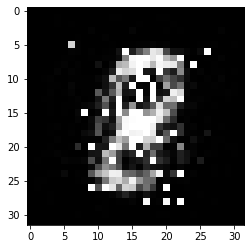

-------------------------------------


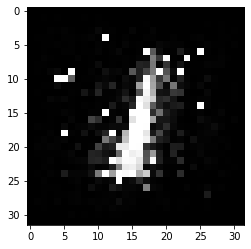

-------------------------------------


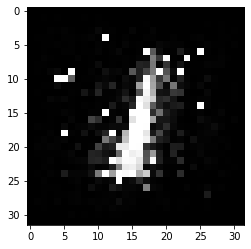

-------------------------------------


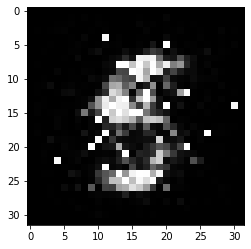

-------------------------------------


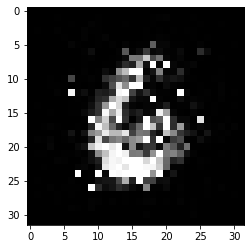

-------------------------------------


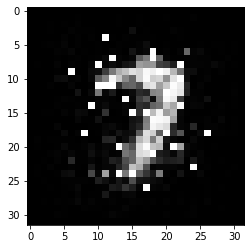

-------------------------------------


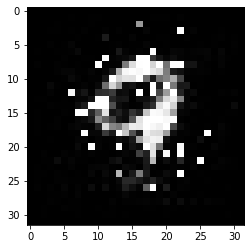

-------------------------------------


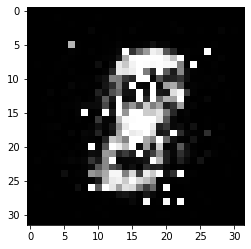

-------------------------------------


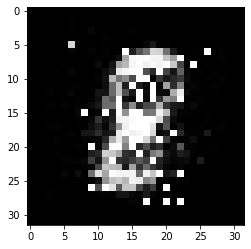

-------------------------------------


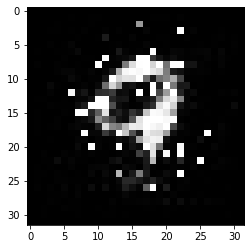

-------------------------------------


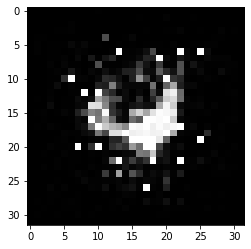

-------------------------------------


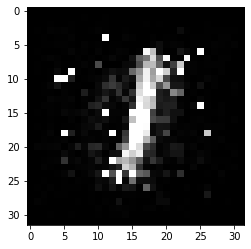

-------------------------------------


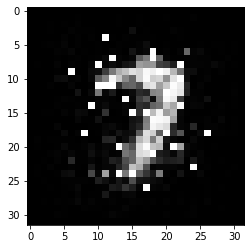

-------------------------------------


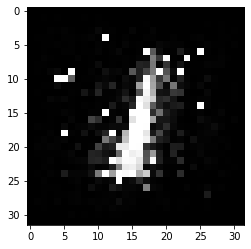

-------------------------------------


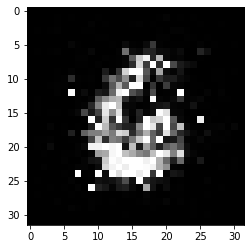

-------------------------------------


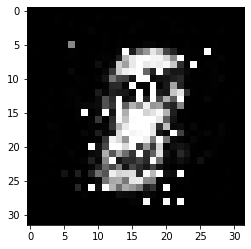

-------------------------------------


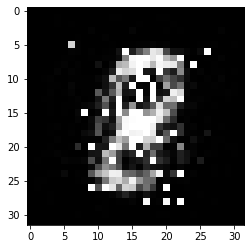

-------------------------------------


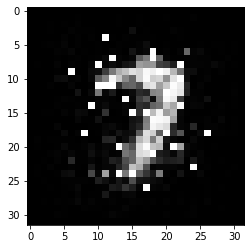

-------------------------------------


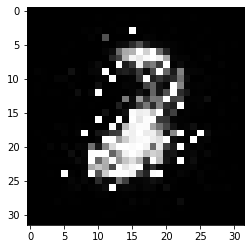

-------------------------------------


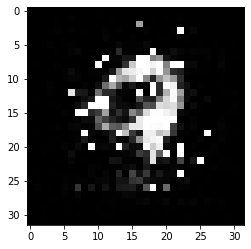

-------------------------------------


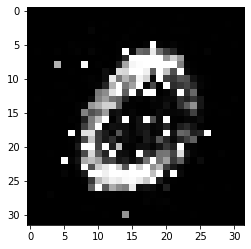

-------------------------------------


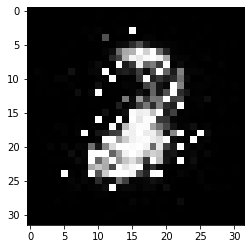

-------------------------------------


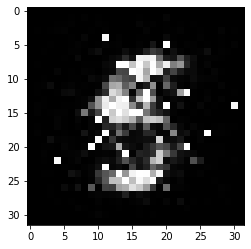

-------------------------------------


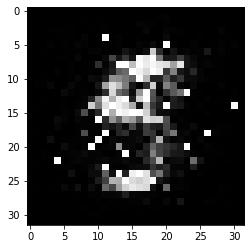

-------------------------------------


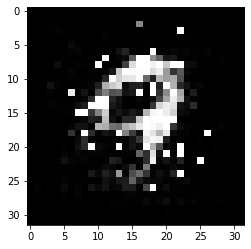

-------------------------------------


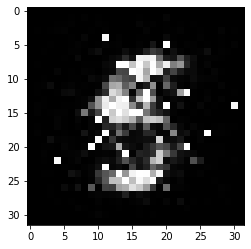

-------------------------------------


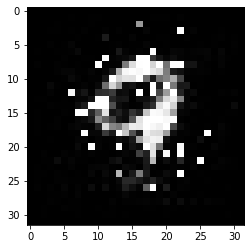

-------------------------------------


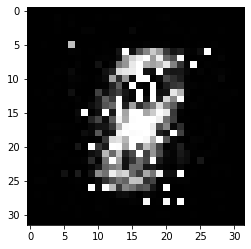

-------------------------------------


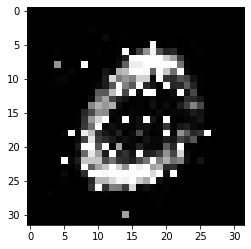

-------------------------------------


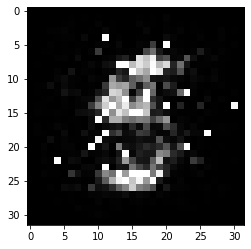

-------------------------------------


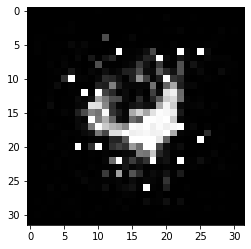

-------------------------------------


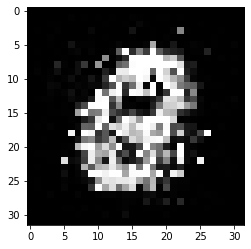

-------------------------------------


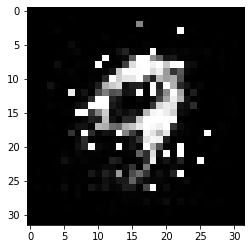

-------------------------------------


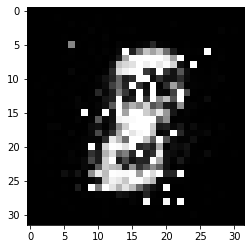

-------------------------------------


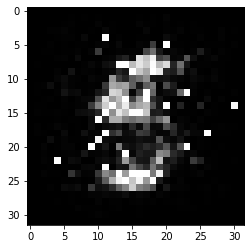

-------------------------------------


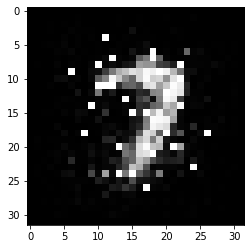

-------------------------------------


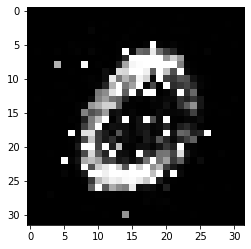

-------------------------------------


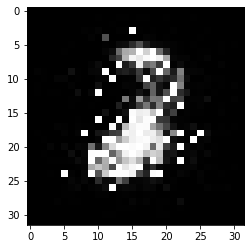

-------------------------------------


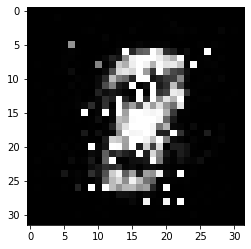

-------------------------------------


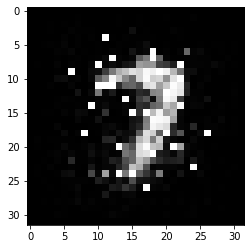

-------------------------------------


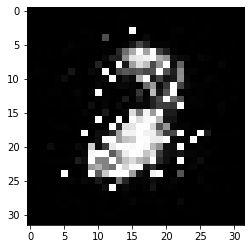

-------------------------------------


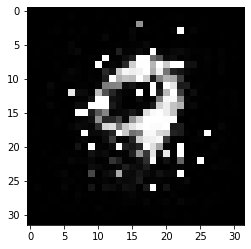

-------------------------------------


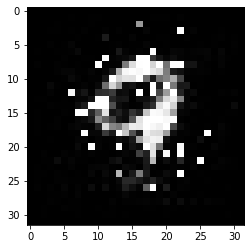

-------------------------------------


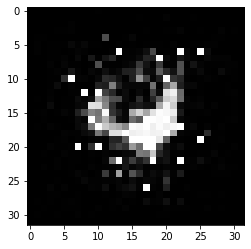

-------------------------------------


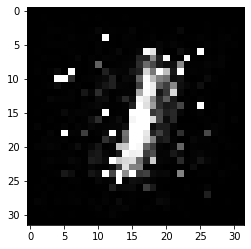

-------------------------------------


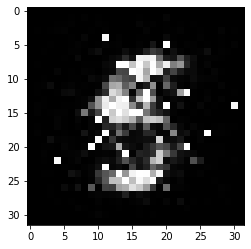

-------------------------------------


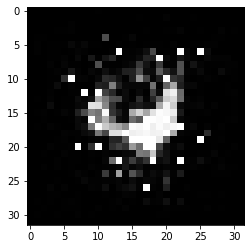

-------------------------------------


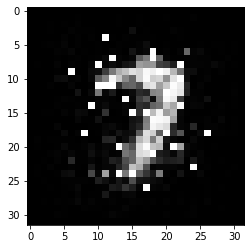

-------------------------------------


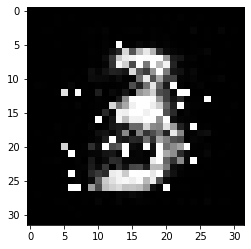

-------------------------------------


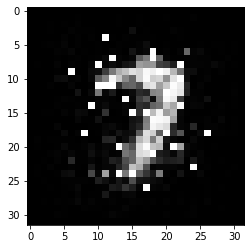

-------------------------------------


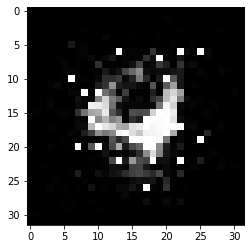

-------------------------------------


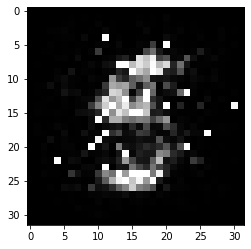

-------------------------------------


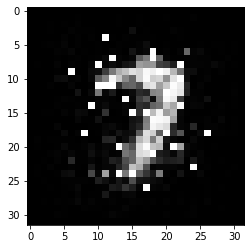

-------------------------------------


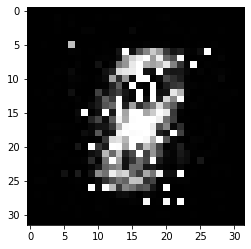

-------------------------------------


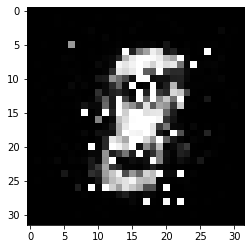

-------------------------------------


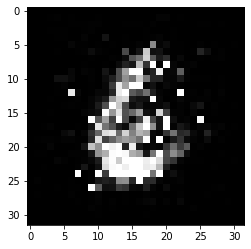

-------------------------------------


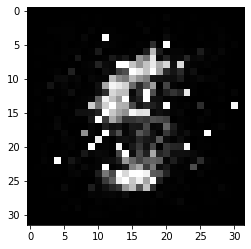

-------------------------------------


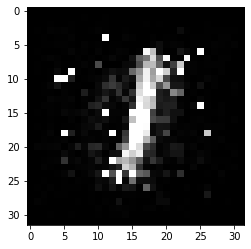

-------------------------------------


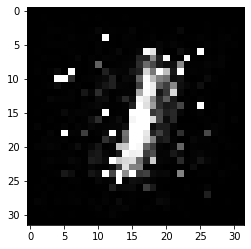

-------------------------------------


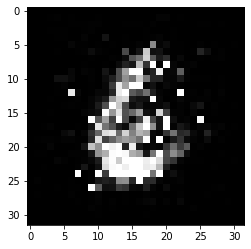

-------------------------------------


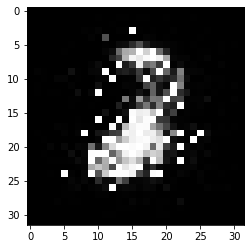

-------------------------------------


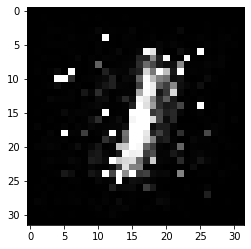

-------------------------------------


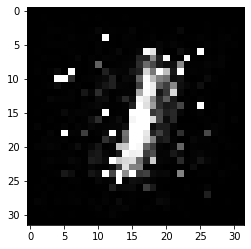

-------------------------------------


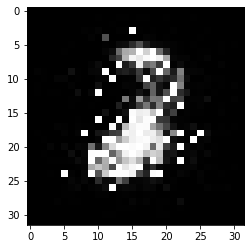

-------------------------------------


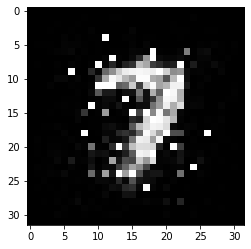

-------------------------------------


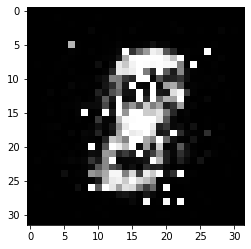

-------------------------------------


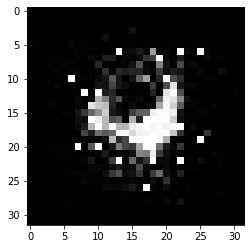

-------------------------------------


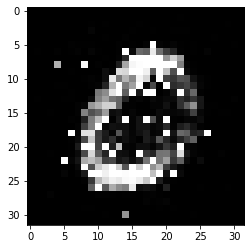

-------------------------------------


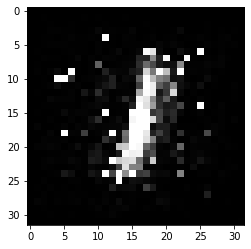

-------------------------------------


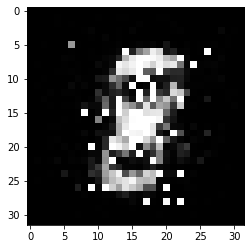

-------------------------------------


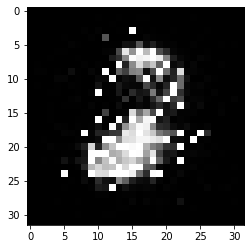

-------------------------------------


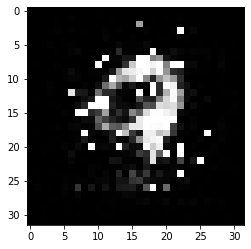

-------------------------------------


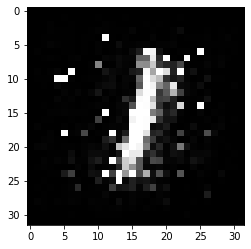

-------------------------------------


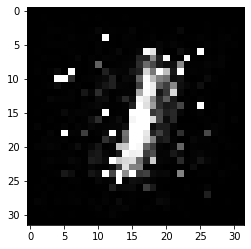

-------------------------------------


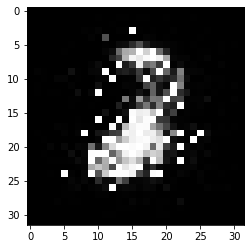

-------------------------------------


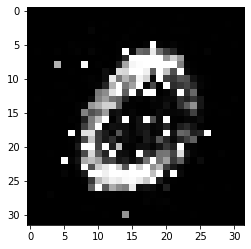

-------------------------------------


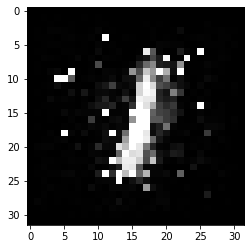

-------------------------------------


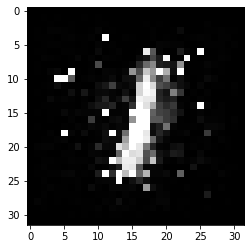

-------------------------------------


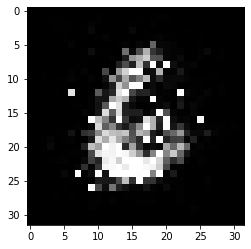

-------------------------------------


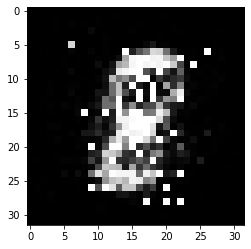

-------------------------------------


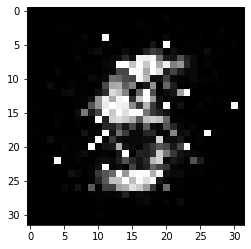

-------------------------------------


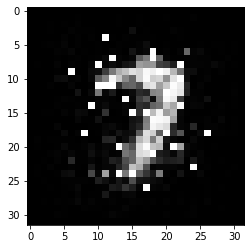

-------------------------------------


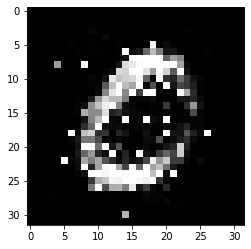

-------------------------------------


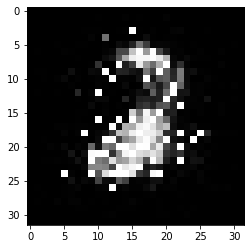

-------------------------------------


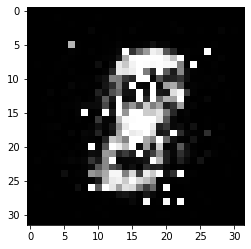

-------------------------------------


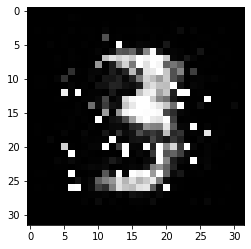

-------------------------------------


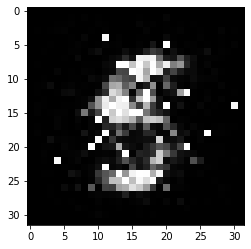

-------------------------------------


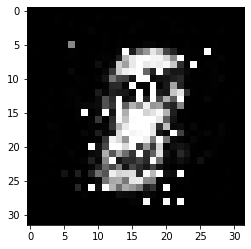

-------------------------------------


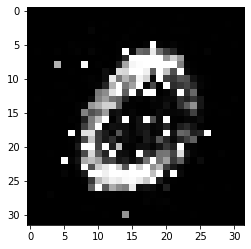

-------------------------------------


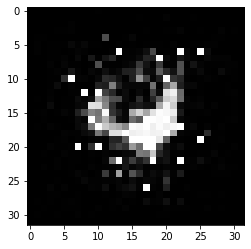

-------------------------------------


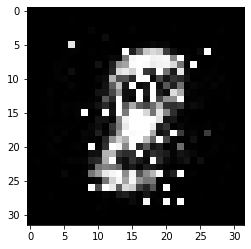

-------------------------------------


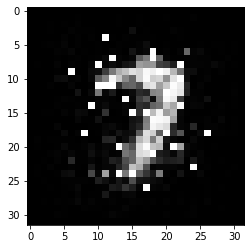

-------------------------------------


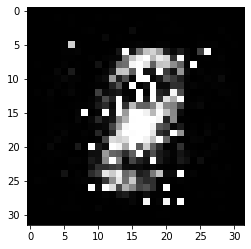

-------------------------------------


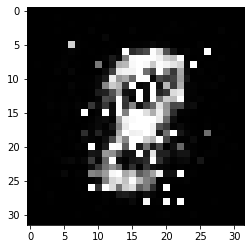

-------------------------------------


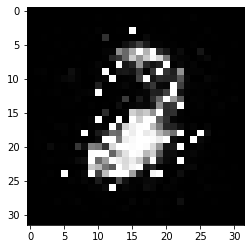

-------------------------------------


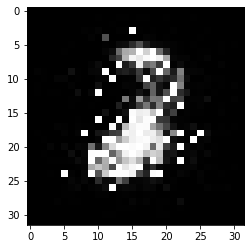

-------------------------------------


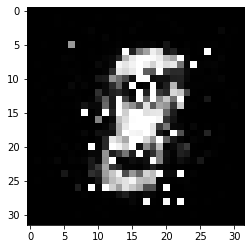

-------------------------------------


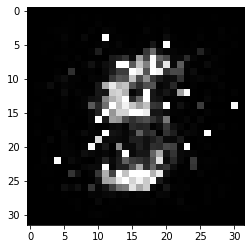

-------------------------------------


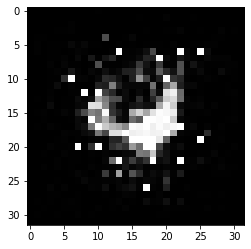

-------------------------------------


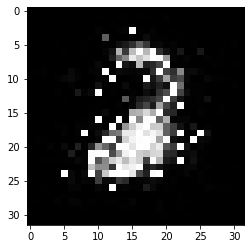

-------------------------------------


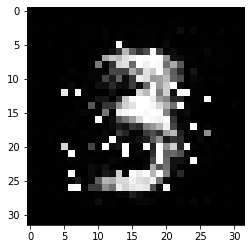

-------------------------------------


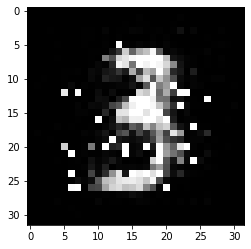

-------------------------------------


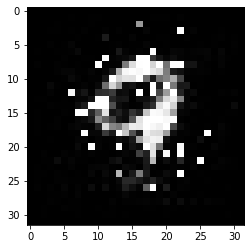

-------------------------------------


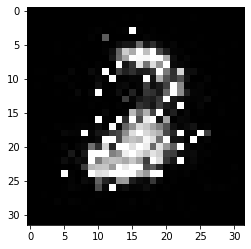

-------------------------------------


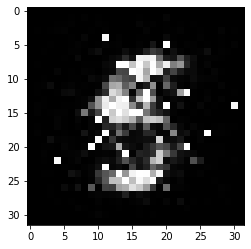

-------------------------------------


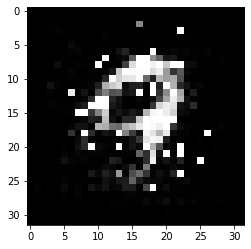

-------------------------------------


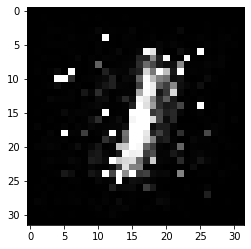

-------------------------------------


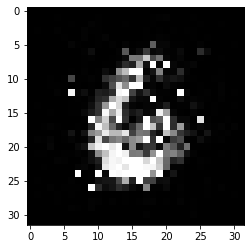

-------------------------------------


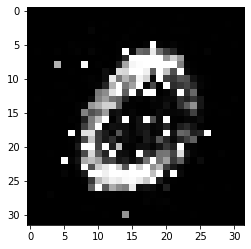

-------------------------------------


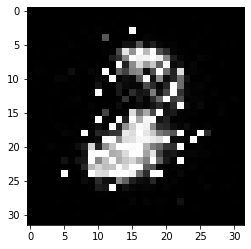

-------------------------------------


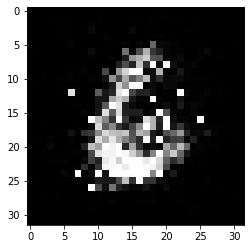

-------------------------------------


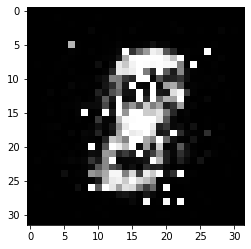

-------------------------------------


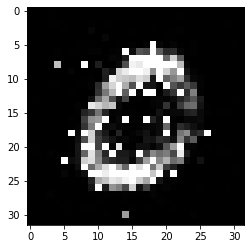

-------------------------------------


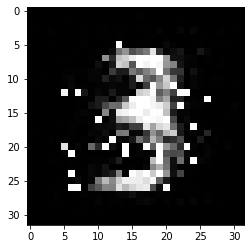

-------------------------------------


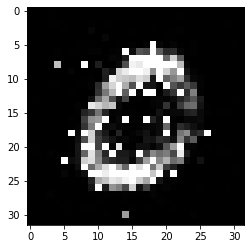

-------------------------------------


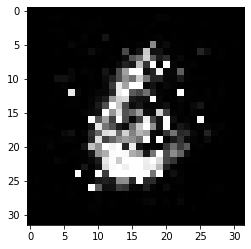

-------------------------------------


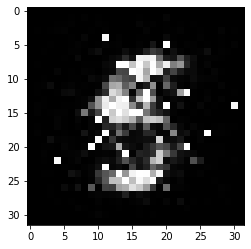

-------------------------------------


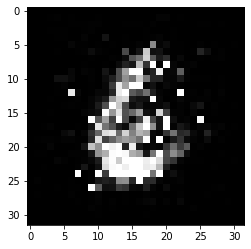

-------------------------------------


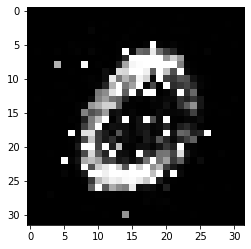

-------------------------------------


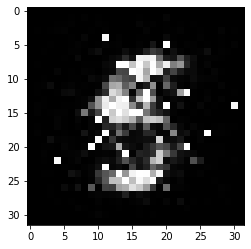

-------------------------------------


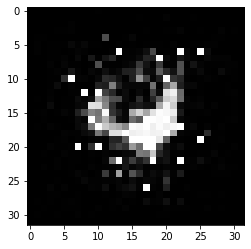

-------------------------------------


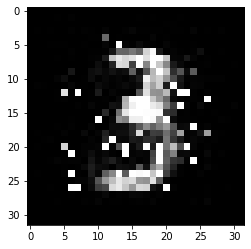

-------------------------------------


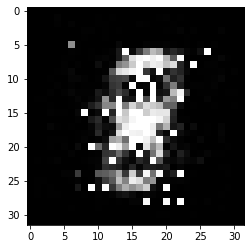

-------------------------------------


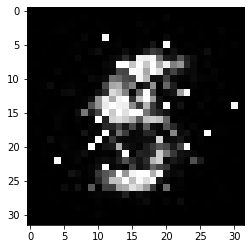

-------------------------------------


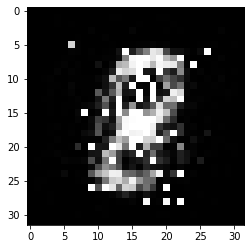

-------------------------------------


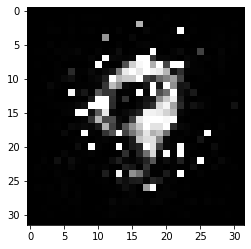

-------------------------------------


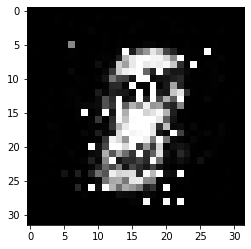

-------------------------------------


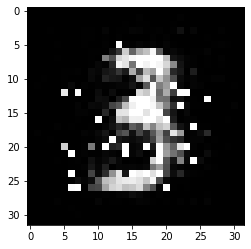

-------------------------------------


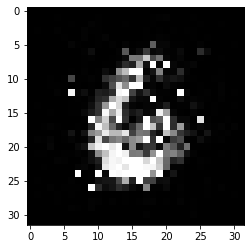

-------------------------------------


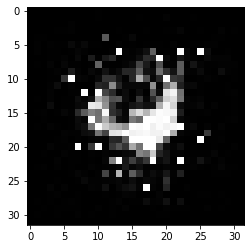

-------------------------------------


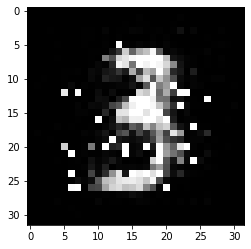

-------------------------------------


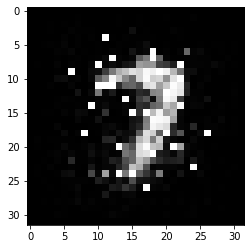

-------------------------------------


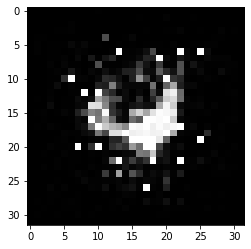

-------------------------------------


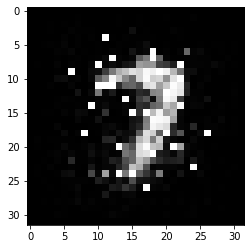

-------------------------------------


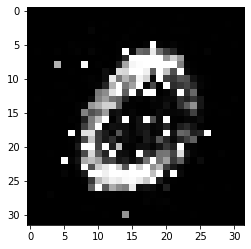

-------------------------------------


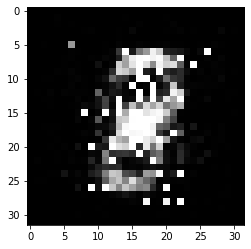

-------------------------------------


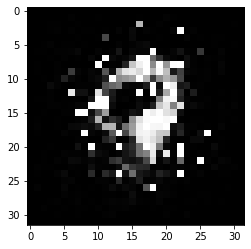

-------------------------------------


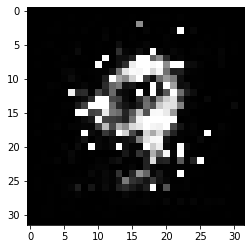

-------------------------------------


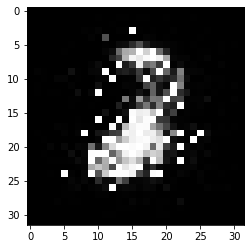

-------------------------------------


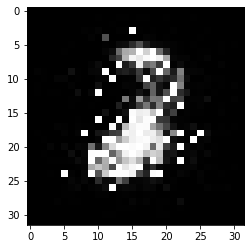

-------------------------------------


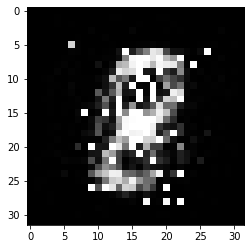

-------------------------------------


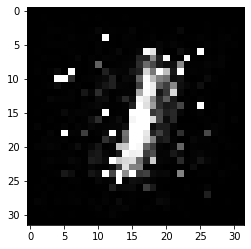

-------------------------------------


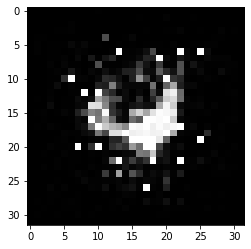

-------------------------------------


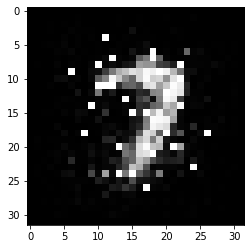

-------------------------------------


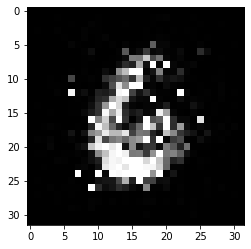

-------------------------------------


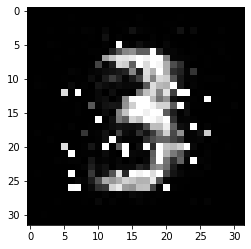

-------------------------------------


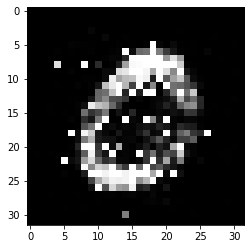

-------------------------------------


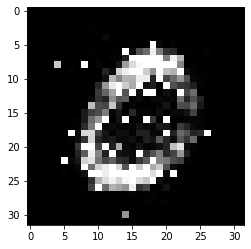

-------------------------------------


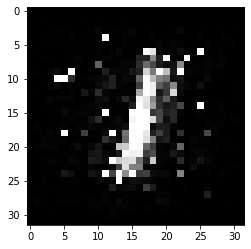

-------------------------------------


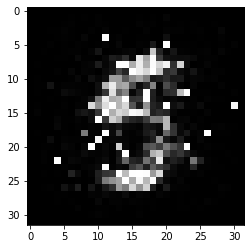

-------------------------------------


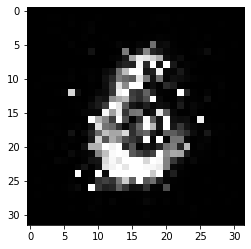

-------------------------------------


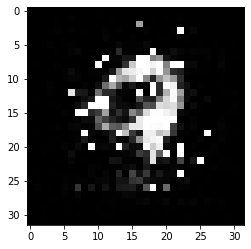

-------------------------------------


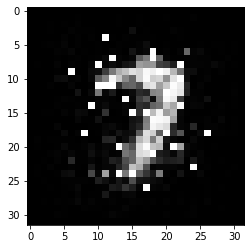

-------------------------------------


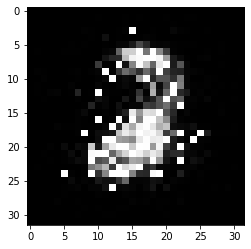

-------------------------------------


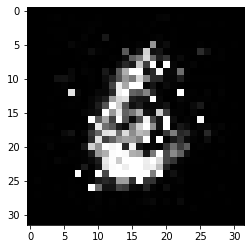

-------------------------------------


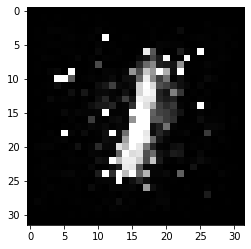

-------------------------------------


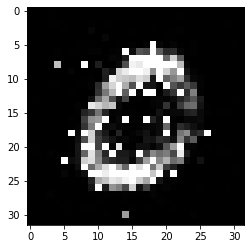

-------------------------------------


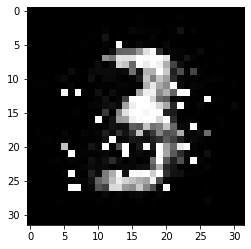

-------------------------------------


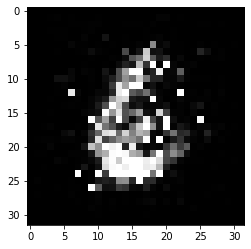

-------------------------------------


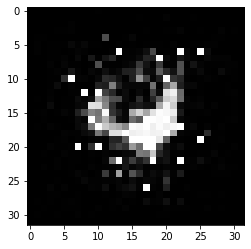

-------------------------------------


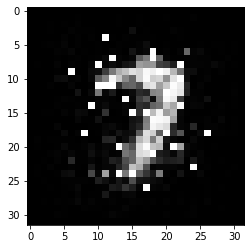

-------------------------------------


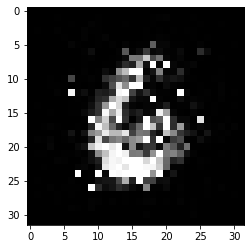

-------------------------------------


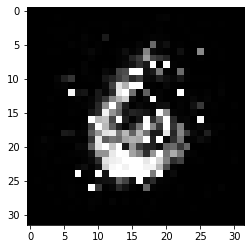

-------------------------------------


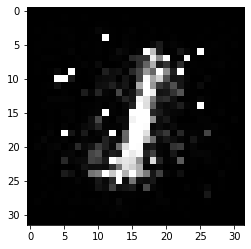

-------------------------------------


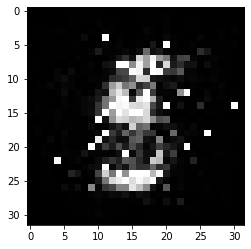

-------------------------------------


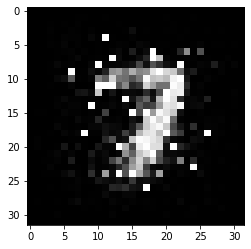

-------------------------------------


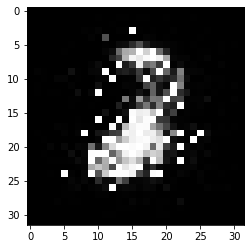

-------------------------------------


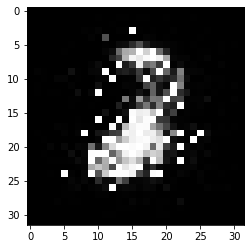

-------------------------------------


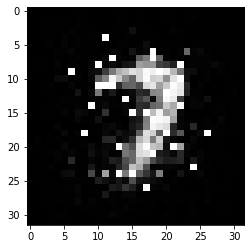

-------------------------------------


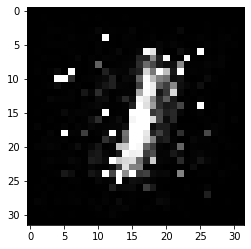

-------------------------------------


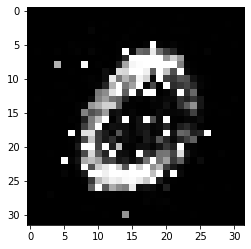

-------------------------------------


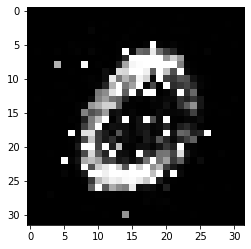

-------------------------------------


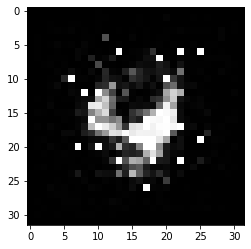

-------------------------------------


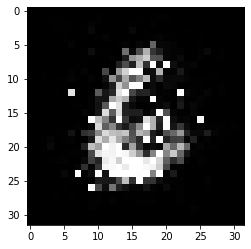

-------------------------------------


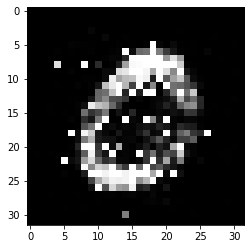

-------------------------------------


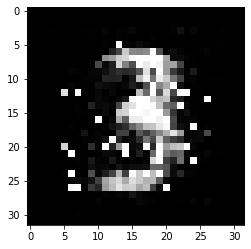

-------------------------------------


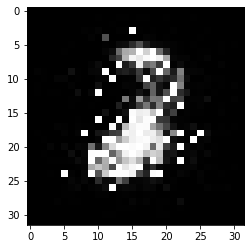

-------------------------------------


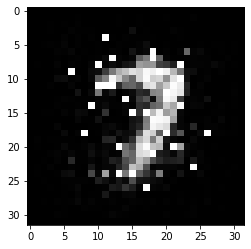

-------------------------------------


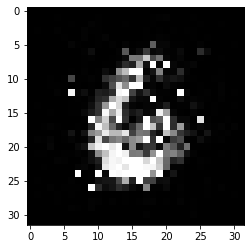

-------------------------------------


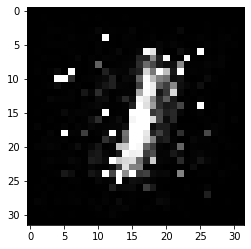

-------------------------------------


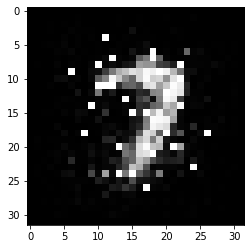

-------------------------------------


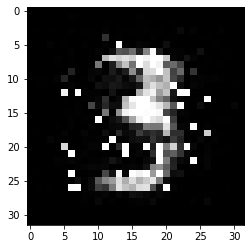

-------------------------------------


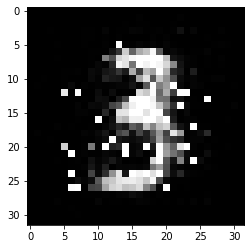

-------------------------------------


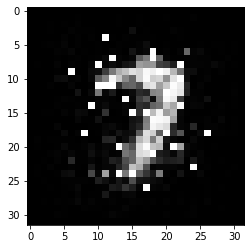

-------------------------------------


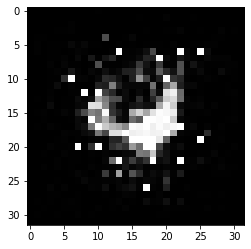

-------------------------------------


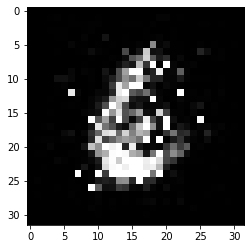

-------------------------------------


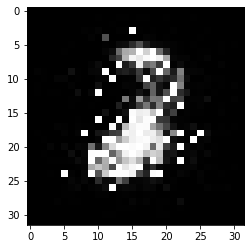

-------------------------------------


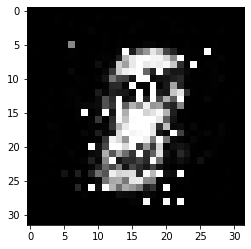

-------------------------------------


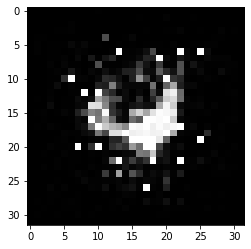

-------------------------------------


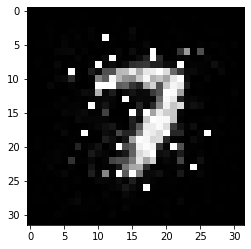

-------------------------------------


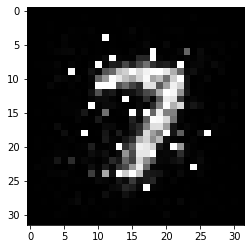

-------------------------------------


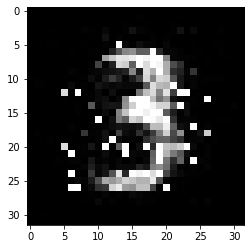

-------------------------------------


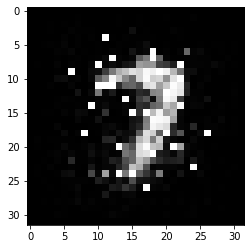

-------------------------------------


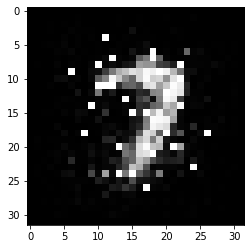

-------------------------------------


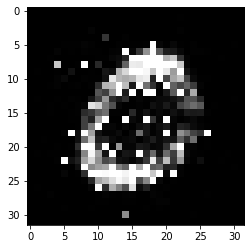

-------------------------------------


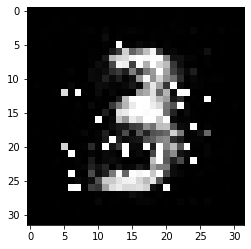

-------------------------------------


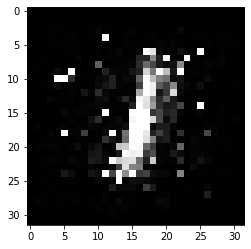

-------------------------------------


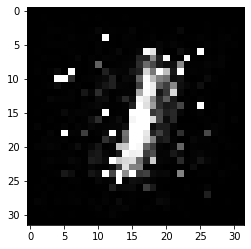

-------------------------------------


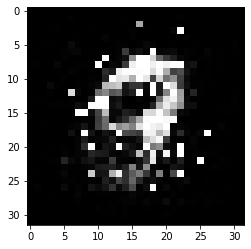

-------------------------------------


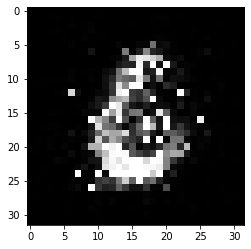

-------------------------------------


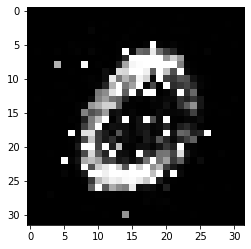

-------------------------------------


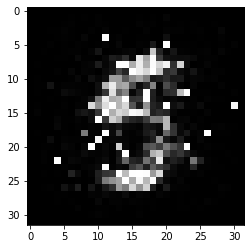

-------------------------------------


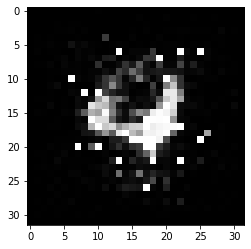

-------------------------------------


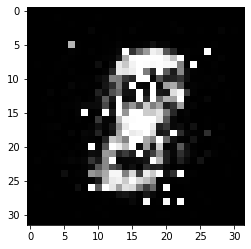

-------------------------------------


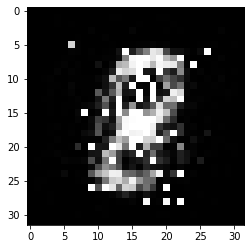

-------------------------------------


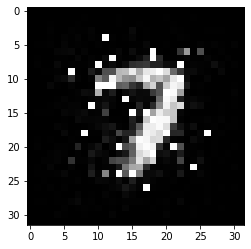

-------------------------------------


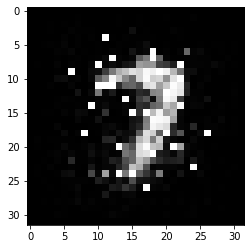

-------------------------------------


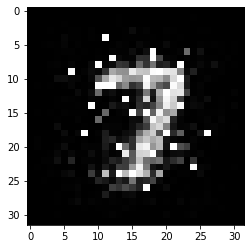

-------------------------------------


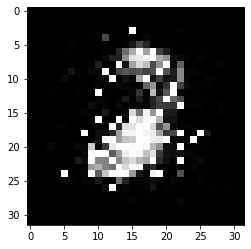

-------------------------------------


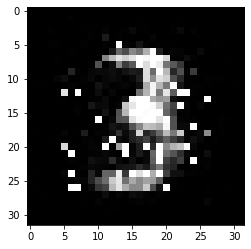

-------------------------------------


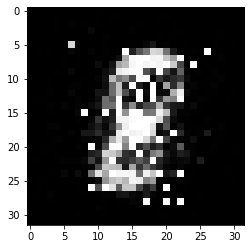

-------------------------------------


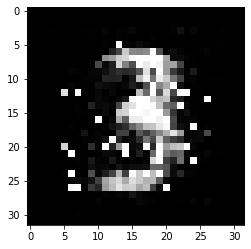

-------------------------------------


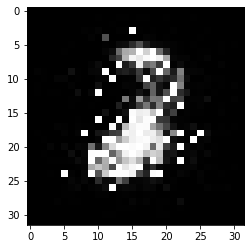

-------------------------------------


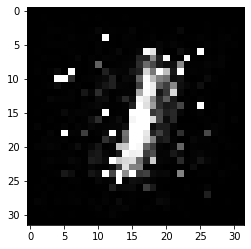

-------------------------------------


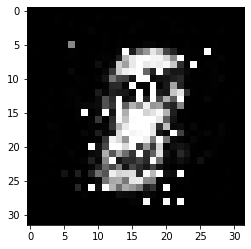

-------------------------------------


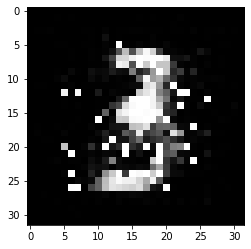

-------------------------------------


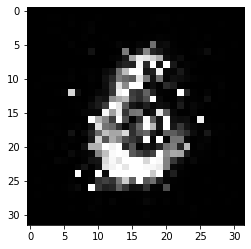

-------------------------------------


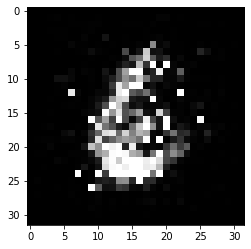

-------------------------------------


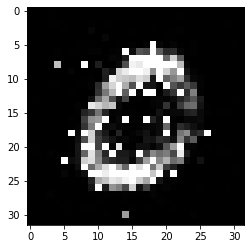

-------------------------------------


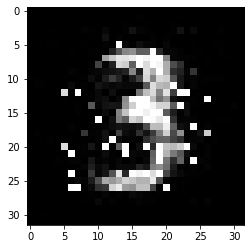

-------------------------------------


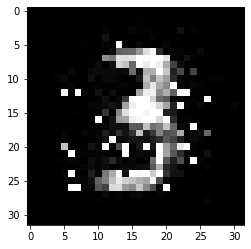

-------------------------------------


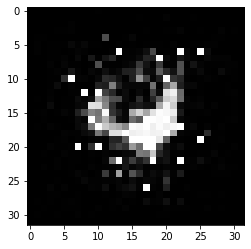

-------------------------------------


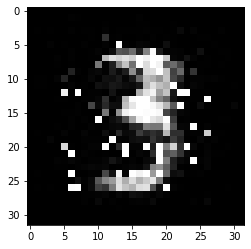

-------------------------------------


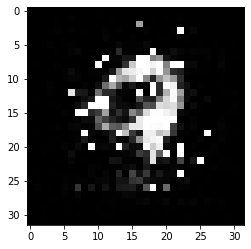

-------------------------------------


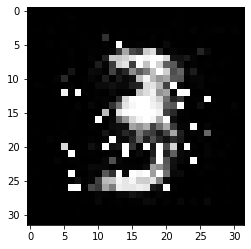

-------------------------------------


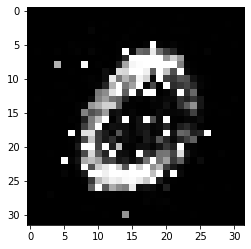

-------------------------------------


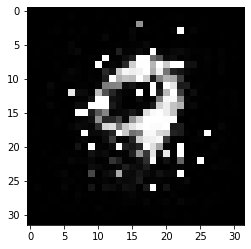

-------------------------------------


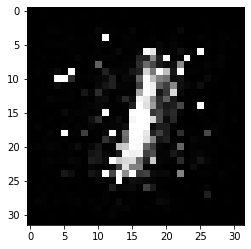

-------------------------------------


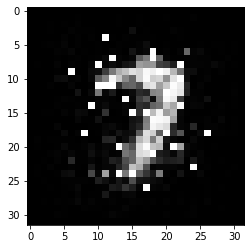

-------------------------------------


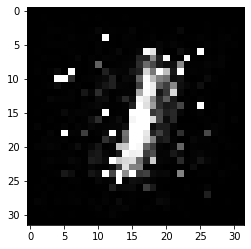

-------------------------------------


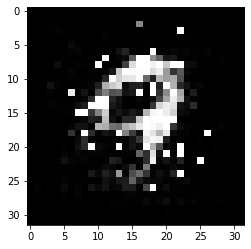

-------------------------------------


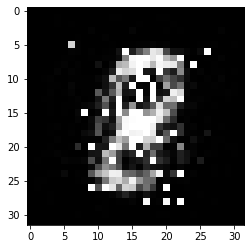

-------------------------------------


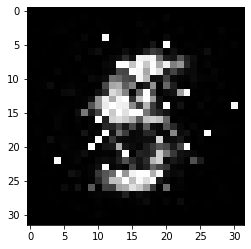

-------------------------------------


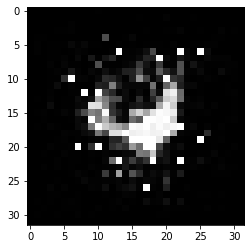

-------------------------------------


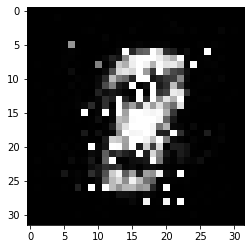

-------------------------------------


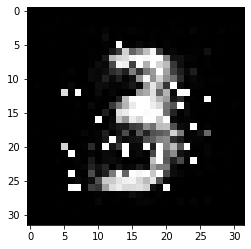

-------------------------------------


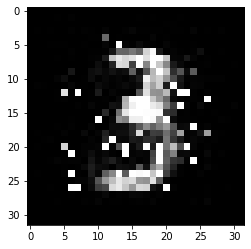

-------------------------------------


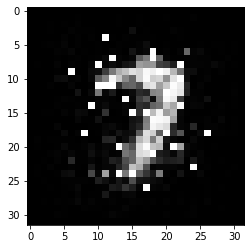

-------------------------------------


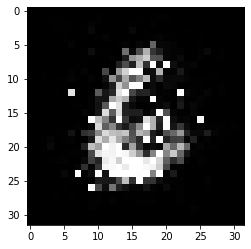

-------------------------------------


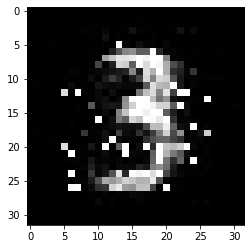

-------------------------------------


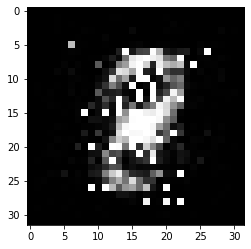

-------------------------------------


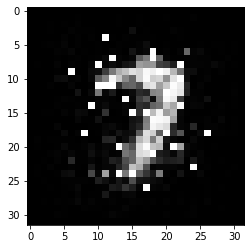

-------------------------------------


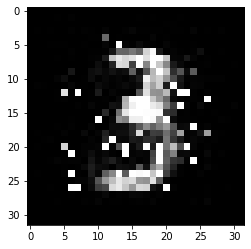

-------------------------------------


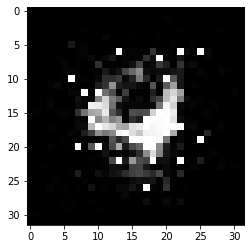

-------------------------------------


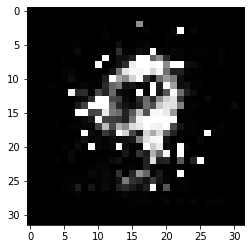

-------------------------------------


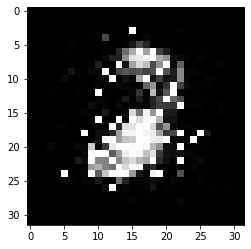

-------------------------------------


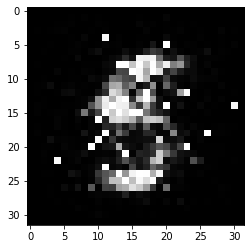

-------------------------------------


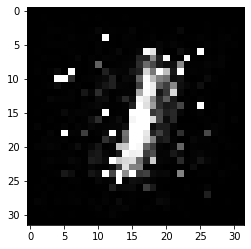

-------------------------------------


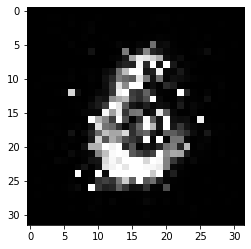

-------------------------------------


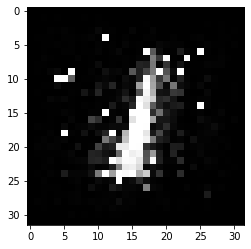

-------------------------------------


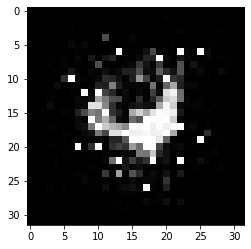

-------------------------------------


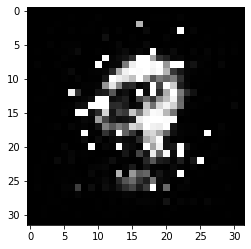

-------------------------------------


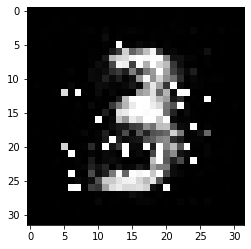

-------------------------------------


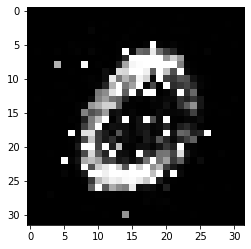

-------------------------------------


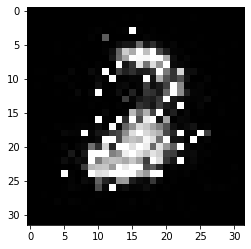

-------------------------------------


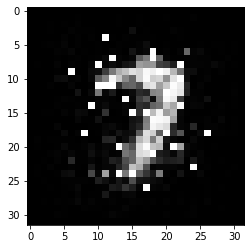

-------------------------------------


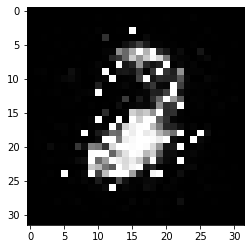

-------------------------------------


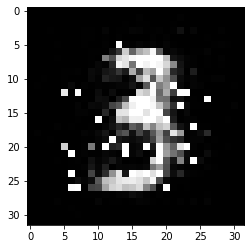

-------------------------------------


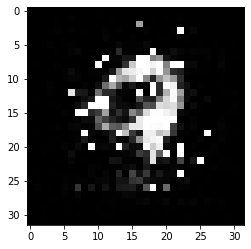

-------------------------------------


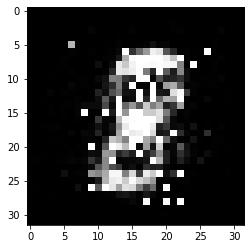

-------------------------------------


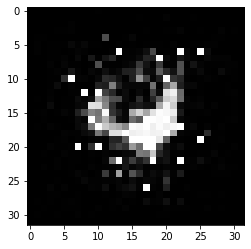

-------------------------------------


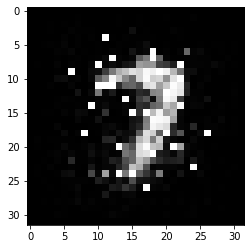

-------------------------------------


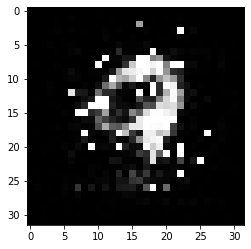

-------------------------------------


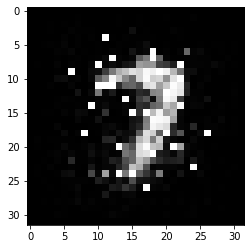

-------------------------------------


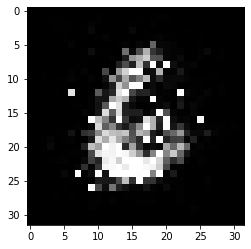

-------------------------------------


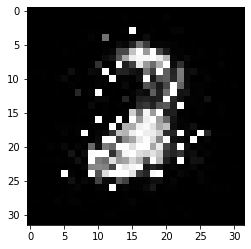

-------------------------------------


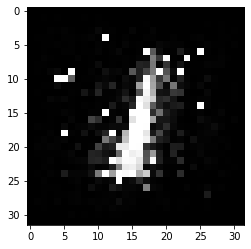

-------------------------------------


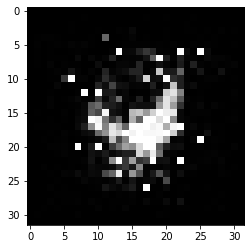

-------------------------------------


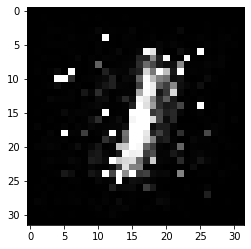

-------------------------------------


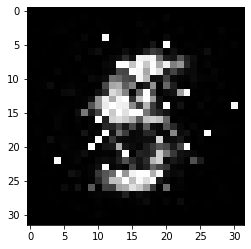

-------------------------------------


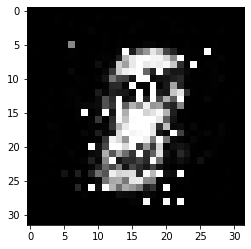

-------------------------------------


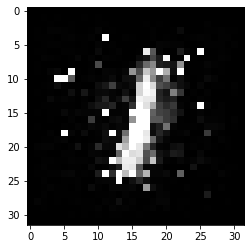

-------------------------------------


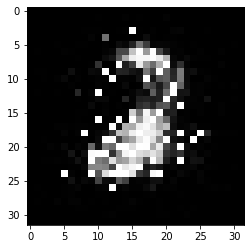

-------------------------------------


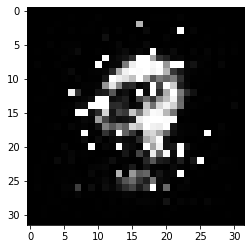

-------------------------------------


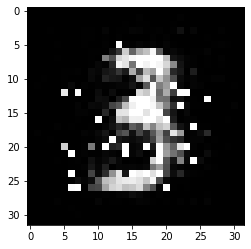

-------------------------------------


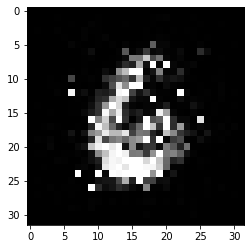

-------------------------------------


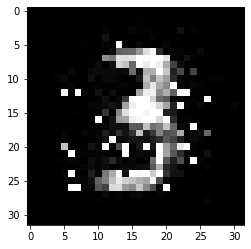

-------------------------------------


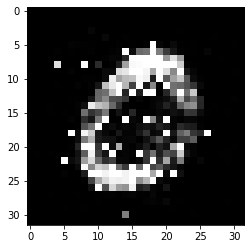

-------------------------------------


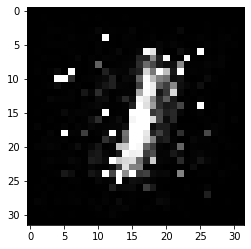

-------------------------------------


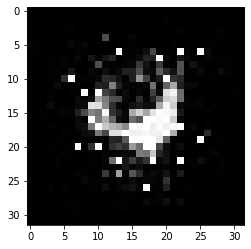

-------------------------------------


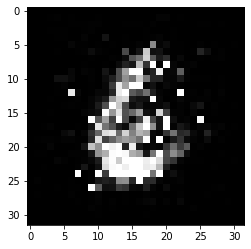

-------------------------------------


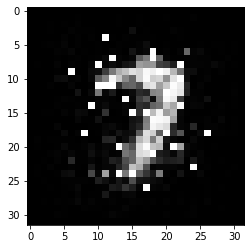

-------------------------------------


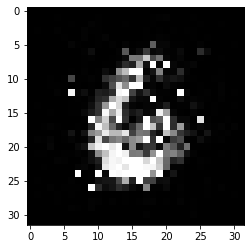

-------------------------------------


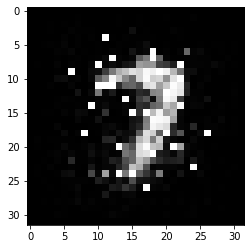

-------------------------------------


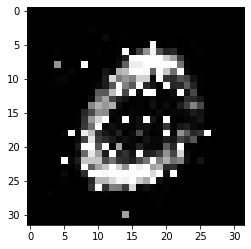

-------------------------------------


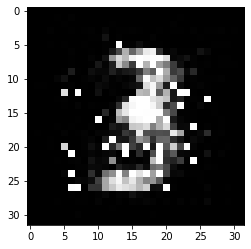

-------------------------------------


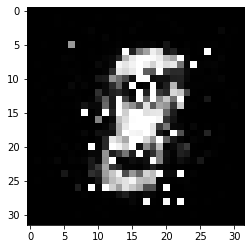

-------------------------------------


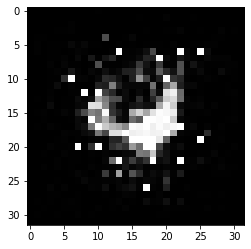

-------------------------------------


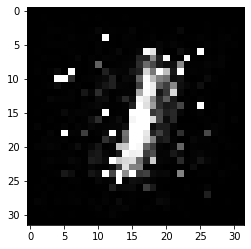

-------------------------------------


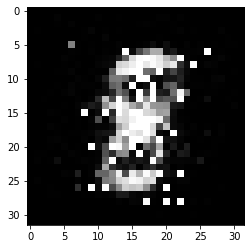

-------------------------------------


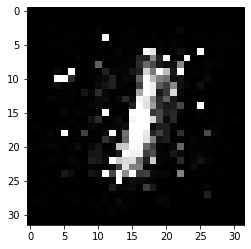

-------------------------------------


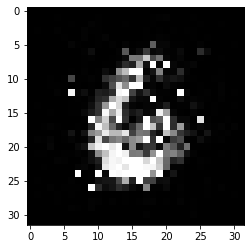

-------------------------------------


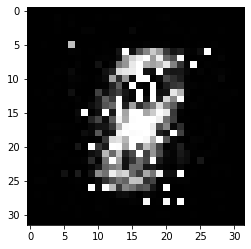

-------------------------------------


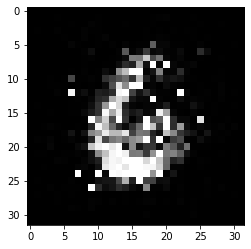

-------------------------------------


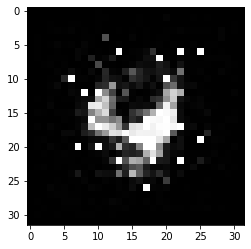

-------------------------------------


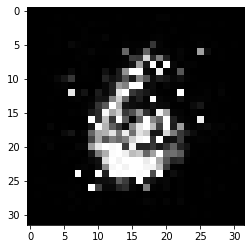

-------------------------------------


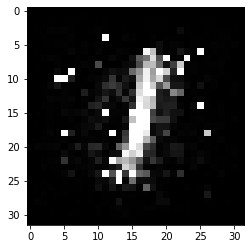

-------------------------------------


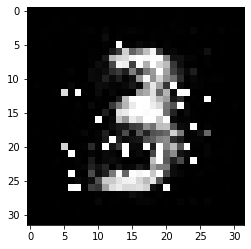

-------------------------------------


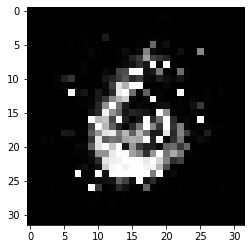

-------------------------------------


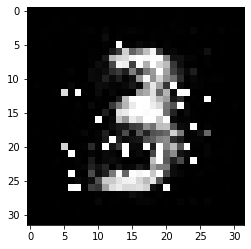

-------------------------------------


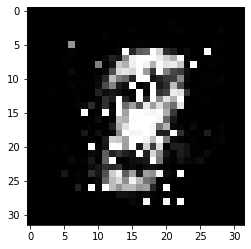

-------------------------------------


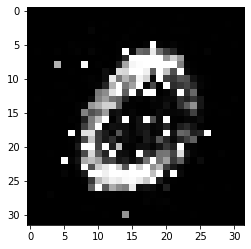

-------------------------------------


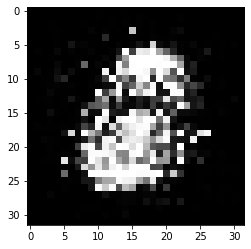

-------------------------------------


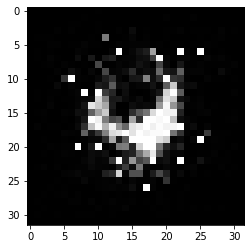

-------------------------------------


In [90]:
import matplotlib.pyplot as plt
for i, data in enumerate(testData1):
    data = torch.tensor(data, dtype = torch.float32)
    data = Variable(data)
    outputs = cnnDecoder(data)
    outputs = outputs.squeeze(0)
    outputs = outputs.squeeze(0)
    outputs = outputs.tolist()
    outputs = np.array(outputs, dtype = 'float32')
    plt.imshow(outputs, cmap = 'gray')
    name = './Mnist/Defense30/'+ classes[labelsList[i]] + str(i) + ".jpg"
    plt.savefig(name)
    plt.show()
    print("-------------------------------------")